In [1]:
import torch
print("Version PyTorch :", torch.__version__)
print("Version CUDA utilisée par PyTorch :", torch.version.cuda)

print(torch.cuda.is_available())
print(torch.backends.cudnn.version())

Version PyTorch : 2.1.2+cu118
Version CUDA utilisée par PyTorch : 11.8
True
8700


In [2]:
print(torch.cuda.is_available())
print(torch.cuda.current_device())
print(torch.cuda.device(0))
print(torch.cuda.get_device_name())

True
0
NVIDIA A40


In [4]:
# mim install mmcv==2.1.0
# pip install mmaction2
# pip install timm
# pip install pytorchvideo

In [5]:
##########################################
############ TEST MAMBA LAYER  ###########
##########################################

import torch
from mamba_ssm import Mamba

batch, length, dim = 2, 64, 16
x = torch.randn(batch, length, dim).to("cuda")
model = Mamba(
    # This module uses roughly 3 * expand * d_model^2 parameters
    d_model=dim, # Model dimension d_model
    d_state=16,  # SSM state expansion factor
    d_conv=4,    # Local convolution width
    expand=2,    # Block expansion factor
).to("cuda")
y = model(x)
assert y.shape == x.shape
print("input", x.shape)
print("output", y.shape)

input torch.Size([2, 64, 16])
output torch.Size([2, 64, 16])


In [6]:
import mmcv
print(mmcv.__version__)  # 2.1.0

2.1.0


In [7]:
import mmaction
print(mmaction.__version__)  # 1.2.0

1.2.0


In [8]:
# Copyright (c) OpenMMLab. All rights reserved.
from typing import Sequence

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from mmcv.cnn.bricks.transformer import FFN, PatchEmbed
from mmengine.model import BaseModule, ModuleList
from mmengine.model.weight_init import trunc_normal_
from mmcv.cnn import build_norm_layer
from mmengine.utils import to_2tuple
from typing import Tuple
from prettytable import PrettyTable

MambaND = nn.Identity # TODO: cleanup and release
# from ..utils import (MultiheadAttention, SwiGLUFFNFused, build_norm_layer,
#                      resize_pos_embed, to_2tuple)

def resize_pos_embed(pos_embed: torch.Tensor,
                     src_shape: Tuple[int],
                     dst_shape: Tuple[int],
                     mode = 'trilinear',
                     num_extra_tokens: int = 1) -> torch.Tensor:
    """Resize pos_embed weights.

    Args:
        pos_embed (torch.Tensor): Position embedding weights with shape
            [1, L, C].
        src_shape (tuple): The resolution of downsampled origin training
            image, in format (T, H, W).
        dst_shape (tuple): The resolution of downsampled new training
            image, in format (T, H, W).
        mode (str): Algorithm used for upsampling. Choose one from 'nearest',
            'linear', 'bilinear', 'bicubic' and 'trilinear'.
            Defaults to 'trilinear'.
        num_extra_tokens (int): The number of extra tokens, such as cls_token.
            Defaults to 1.

    Returns:
        torch.Tensor: The resized pos_embed of shape [1, L_new, C]
    """
    if src_shape[0] == dst_shape[0] and src_shape[1] == dst_shape[1] \
            and src_shape[2] == dst_shape[2]:
        return pos_embed
    assert pos_embed.ndim == 3, 'shape of pos_embed must be [1, L, C]'
    _, L, C = pos_embed.shape
    src_t, src_h, src_w = src_shape
    assert L == src_t * src_h * src_w + num_extra_tokens, \
        f"The length of `pos_embed` ({L}) doesn't match the expected " \
        f'shape ({src_t}*{src_h}*{src_w}+{num_extra_tokens}).' \
        'Please check the `img_size` argument.'
    extra_tokens = pos_embed[:, :num_extra_tokens]

    src_weight = pos_embed[:, num_extra_tokens:]
    src_weight = src_weight.reshape(1, src_t, src_h, src_w,
                                    C).permute(0, 4, 1, 2, 3)

    dst_weight = F.interpolate(
        src_weight, size=dst_shape, align_corners=False, mode=mode)
    dst_weight = torch.flatten(dst_weight, 2).transpose(1, 2)

    return torch.cat((extra_tokens, dst_weight), dim=1)



# from .base_backbone import BaseBackbone
from mamba_ssm import Mamba
from torch import Tensor
from typing import Optional
from mamba_ssm.ops.triton.layernorm import RMSNorm, layer_norm_fn, rms_norm_fn
from functools import partial
#from .ssm2d import Block2D,Mamba2D,SplitHead2D
Block2D = Mamba2D = SplitHead2D = nn.Identity
from einops import rearrange
from mmengine.logging import MMLogger

from mmcv.cnn.bricks.drop import build_dropout

class Block(nn.Module):
    def __init__(
        self, dim, mixer_cls, norm_cls=nn.LayerNorm, fused_add_norm=False, residual_in_fp32=False,reverse=False,
        transpose=False,split_head=False,
        drop_path_rate=0.0,drop_rate=0.0,use_mlp=False,
    ):
        """
        Simple block wrapping a mixer class with LayerNorm/RMSNorm and residual connection"

        This Block has a slightly different structure compared to a regular
        prenorm Transformer block.
        The standard block is: LN -> MHA/MLP -> Add.
        [Ref: https://arxiv.org/abs/2002.04745]
        Here we have: Add -> LN -> Mixer, returning both
        the hidden_states (output of the mixer) and the residual.
        This is purely for performance reasons, as we can fuse add and LayerNorm.
        The residual needs to be provided (except for the very first block).
        """
        super().__init__()
        self.residual_in_fp32 = residual_in_fp32
        self.fused_add_norm = fused_add_norm
        self.mixer = mixer_cls(dim)
        self.norm = norm_cls(dim)
        self.split_head = split_head
        self.reverse = reverse
        self.transpose = transpose
        self.drop_path = build_dropout(
            dict(type='DropPath', drop_prob=drop_path_rate)
        )
        self.dropout = build_dropout(
            dict(type='Dropout', drop_prob=drop_rate)
        )
        if use_mlp:
            self.ffn = SwiGLUFFNFused(
                    embed_dims=dim,
                    feedforward_channels=int(dim*4),
                    layer_scale_init_value=0.0)
            self.ln2 = build_norm_layer(dict(type='LN'), dim)
        else:
            self.ffn = None
        if self.fused_add_norm:
            assert RMSNorm is not None, "RMSNorm import fails"
            assert isinstance(
                self.norm, (nn.LayerNorm, RMSNorm)
            ), "Only LayerNorm and RMSNorm are supported for fused_add_norm"

    def forward(
        self, hidden_states: Tensor, residual: Optional[Tensor] = None, inference_params=None,order='t l h w',
        shape=None,skip=True,n_dim_pos=4
    ):
        r"""Pass the input through the encoder layer.

        Args:
            hidden_states: the sequence to the encoder layer (required).
            residual: hidden_states = Mixer(LN(residual))
        """
        h = w = 0
        assert shape is not None
        t,l,h,w = shape
        if n_dim_pos != 4:
            order = order.split(' ')
            assert len(order) == 4
            trunc_n = 4 - n_dim_pos
            tgt_order = f"(n {' '.join(order[:trunc_n])}) ({' '.join(order[trunc_n:])}) c"
        else:
            tgt_order = f'n ({order}) c'
        hidden_states =  rearrange(hidden_states,f'n (t l h w ) c -> {tgt_order}',t=t,l=l,h=h,w=w)

        # if self.transpose:
        #     l = hidden_states.shape[1]
        #     h = w = int(np.sqrt(l))
        #     # assert h * w == l
        #     hidden_states = rearrange(hidden_states,'n (h w) c -> n (w h) c',h=h,w=w)
        #     if residual is not None:
        #         residual = rearrange(residual,'n (h w) c -> n (w h) c',h=h,w=w)
        if self.reverse:
            hidden_states = hidden_states.flip(1)
            # print("reverse")
            if residual is not None:
                residual = residual.flip(1)
        if not self.fused_add_norm:
            hidden_states = self.norm(hidden_states)
            # residual = (hidden_states + residual) if residual is not None else hidden_states
            # hidden_states = self.norm(residual.to(dtype=self.norm.weight.dtype))
            # if self.residual_in_fp32:
            #     residual = residual.to(torch.float32)
            if self.split_head:
                l = hidden_states.shape[1]
                h = w = int(np.sqrt(l))
                hidden_states = SplitHead2D.apply(hidden_states,4,h,w)
            if skip:
                hidden_states = hidden_states + self.drop_path(self.dropout(self.mixer(hidden_states, inference_params=inference_params)))
            else:
                hidden_states = self.drop_path(self.dropout(self.mixer(hidden_states, inference_params=inference_params)))
            if self.split_head:
                hidden_states = SplitHead2D.apply(hidden_states,4,h,w)
        else:
            fused_add_norm_fn = rms_norm_fn if isinstance(self.norm, RMSNorm) else layer_norm_fn
            hidden_states, residual = fused_add_norm_fn(
                hidden_states,
                self.norm.weight,
                self.norm.bias,
                residual=residual,
                prenorm=True,
                residual_in_fp32=self.residual_in_fp32,
                eps=self.norm.eps,
            )
            hidden_states = self.drop_path(self.mixer(hidden_states, inference_params=inference_params))
        if self.ffn is not None:
            hidden_states = self.ffn(self.ln2(hidden_states),identity=hidden_states)
        if self.reverse:
            hidden_states = hidden_states.flip(1)
            if residual is not None:
                residual = residual.flip(1)
        hidden_states =  rearrange(hidden_states,f'{tgt_order}->n (t l h w ) c ',t=t,l=l,h=h,w=w)
        # if self.transpose:
        #     hidden_states = rearrange(hidden_states,'n (w h) c -> n (h w) c',h=h,w=w)
        #     if residual is not None:
        #         residual = rearrange(residual,'n (w h) c -> n (h w) c',h=h,w=w)

        
        # print("shape : ", hidden_states.shape)
        
        return hidden_states

    def allocate_inference_cache(self, batch_size, max_seqlen, dtype=None, **kwargs):
        return self.mixer.allocate_inference_cache(batch_size, max_seqlen, dtype=dtype, **kwargs)

def create_block(
    d_model,
    ssm_cfg=None,
    norm_epsilon=1e-5,
    rms_norm=False,
    residual_in_fp32=False,
    fused_add_norm=False,
    layer_idx=None,
    device=None,
    dtype=None,
    reverse=None,
    is_2d=False,
    drop_rate=0.1,
    drop_path_rate=0.1,
    use_mlp=False,
    transpose=False,
    split_head=False,
    use_nd=False,
):
    if ssm_cfg is None:
        ssm_cfg = {}
    factory_kwargs = {"device": device, "dtype": dtype}
    if use_nd:
        transpose = False
        reverse = False
        mixer_cls = partial(MambaND , layer_idx=layer_idx, n_dim=3,**ssm_cfg, **factory_kwargs)
    mixer_cls = partial(Mamba2D if is_2d else Mamba, layer_idx=layer_idx, **ssm_cfg, **factory_kwargs)
    norm_cls = partial(
        nn.LayerNorm if not rms_norm else RMSNorm, eps=norm_epsilon, **factory_kwargs
    )
    if is_2d:
        block = Block2D(
            d_model,
            mixer_cls,
            norm_cls=norm_cls,
            fused_add_norm=fused_add_norm,
            residual_in_fp32=residual_in_fp32,
            reverse=reverse,
            drop_rate=drop_rate,
            transpose=transpose,
            drop_path_rate=drop_path_rate,
        )
    else:
        block = Block(
            d_model,
            mixer_cls,
            norm_cls=norm_cls,
            fused_add_norm=fused_add_norm,
            residual_in_fp32=residual_in_fp32,
            reverse=reverse,
            transpose=transpose,
            drop_rate=drop_rate,
            use_mlp=use_mlp,
            drop_path_rate=drop_path_rate,
            split_head=split_head,
        )
    block.layer_idx = layer_idx
    return block 


In [9]:
from mmaction.registry import MODELS
from mmaction.utils import ConfigType, OptConfigType
from mmengine.runner.checkpoint import _load_checkpoint
import re


@MODELS.register_module()
class Mamba3DModel(BaseModule):
    """Vision Transformer.

    A PyTorch implement of : `An Image is Worth 16x16 Words: Transformers
    for Image Recognition at Scale <https://arxiv.org/abs/2010.11929>`_

    Args:
        arch (str | dict): Vision Transformer architecture. If use string,
            choose from 'small', 'base', 'large', 'deit-tiny', 'deit-small'
            and 'deit-base'. If use dict, it should have below keys:

            - **embed_dims** (int): The dimensions of embedding.
            - **num_layers** (int): The number of transformer encoder layers.
            - **num_heads** (int): The number of heads in attention modules.
            - **feedforward_channels** (int): The hidden dimensions in
              feedforward modules.

            Defaults to 'base'.
        img_size (int | tuple): The expected input image shape. Because we
            support dynamic input shape, just set the argument to the most
            common input image shape. Defaults to 224.
        patch_size (int | tuple): The patch size in patch embedding.
            Defaults to 16.
        in_channels (int): The num of input channels. Defaults to 3.
        out_indices (Sequence | int): Output from which stages.
            Defaults to -1, means the last stage.
        drop_rate (float): Probability of an element to be zeroed.
            Defaults to 0.
        drop_path_rate (float): stochastic depth rate. Defaults to 0.
        qkv_bias (bool): Whether to add bias for qkv in attention modules.
            Defaults to True.
        norm_cfg (dict): Config dict for normalization layer.
            Defaults to ``dict(type='LN')``.
        final_norm (bool): Whether to add a additional layer to normalize
            final feature map. Defaults to True.
        out_type (str): The type of output features. Please choose from

            - ``"cls_token"``: The class token tensor with shape (B, C).
            - ``"featmap"``: The feature map tensor from the patch tokens
              with shape (B, C, H, W).
            - ``"avg_featmap"``: The global averaged feature map tensor
              with shape (B, C).
            - ``"raw"``: The raw feature tensor includes patch tokens and
              class tokens with shape (B, L, C).

            Defaults to ``"cls_token"``.
        with_cls_token (bool): Whether concatenating class token into image
            tokens as transformer input. Defaults to True.
        frozen_stages (int): Stages to be frozen (stop grad and set eval mode).
            -1 means not freezing any parameters. Defaults to -1.
        interpolate_mode (str): Select the interpolate mode for position
            embeding vector resize. Defaults to "bicubic".
        layer_scale_init_value (float or torch.Tensor): Init value of layer
            scale. Defaults to 0.
        patch_cfg (dict): Configs of patch embeding. Defaults to an empty dict.
        layer_cfgs (Sequence | dict): Configs of each transformer layer in
            encoder. Defaults to an empty dict.
        init_cfg (dict, optional): Initialization config dict.
            Defaults to None.
    """
    arch_zoo = {
       **dict.fromkeys(
            ['small'], {
                'embed_dims': 384,
                'num_layers': 12,
                'num_heads': 6,
                'feedforward_channels': 384 * 4
            }),
   }
    num_extra_tokens = 1  # class token
    OUT_TYPES = {'raw', 'cls_token', 'featmap', 'avg_featmap'}

    def __init__(self,
                 arch='base',
                 img_size=224,
                 patch_size=16,
                 patch_size_temporal=2,
                 in_channels=3,
                 out_indices=-1,
                 drop_rate=0.,
                 drop_path_rate=0.,
                 qkv_bias=True,
                 norm_cfg=dict(type='LN', eps=1e-6),
                 norm_cfg_2=dict(type='LN', eps=1e-6),
                 final_norm=True,
                 out_type='featmap',
                 with_cls_token=True,
                 frozen_stages=-1,
                 interpolate_mode='trilinear',
                 layer_scale_init_value=0.,
                 patch_cfg=dict(),
                 layer_cfgs=dict(),
                 pre_norm=False,
                 init_cfg=None,
                 num_frames: int = 16,
                 inflate_len=False,
                 is_1d=False,
                 is_2d=True,
                 use_v2=False,
                 force_a2=False,
                 has_transpose=True,
                 fused_add_norm=True,
                 use_mlp=False,
                 split_head=False,
                 pretrained=None,
                 pretrained2d=True,
                 dt_scale=0.0,
                 dt_scale_tmp=0.0,
                 use_nd=False,
                 force_2d=False,
                 update_interval=None,
                 copy_weight=False,
                 factorization=None,
                 inlfate_policy=None,
                 n_dim_pos=4,
                 d_state=16):
        super(Mamba3DModel, self).__init__(init_cfg)
        self.force_2d = force_2d
        self.use_nd = use_nd
        self.inlfate_policy = inlfate_policy
        self.pretrained2d = pretrained2d
        self.pretrained = pretrained
        self.n_dim_pos = n_dim_pos
        self.factorization = factorization
        self.inflate_len = inflate_len
        self.update_interval = update_interval
        self.copy_weight = copy_weight
        if pretrained:
            self.init_cfg = dict(type='Pretrained', checkpoint=pretrained)
        if isinstance(arch, str):
            arch = arch.lower()
            assert arch in set(self.arch_zoo), \
                f'Arch {arch} is not in default archs {set(self.arch_zoo)}'
            self.arch_settings = self.arch_zoo[arch]
        else:
            essential_keys = {
                'embed_dims', 'num_layers', 'num_heads', 'feedforward_channels'
            }
            assert isinstance(arch, dict) and essential_keys <= set(arch), \
                f'Custom arch needs a dict with keys {essential_keys}'
            self.arch_settings = arch

        self.embed_dims = self.arch_settings['embed_dims']
        if self.inflate_len == 4:
            self.num_layers = self.arch_settings['num_layers'] * 4
        elif self.inflate_len:
            self.num_layers = self.arch_settings['num_layers'] * 3
        
        else:
            self.num_layers = self.arch_settings['num_layers'] * (2 if not use_mlp else 1)
        self.img_size = (num_frames,img_size,img_size)
        self.is_2d = is_2d

        # Set patch embedding
        _patch_cfg = dict(
            in_channels=in_channels,
            input_size=self.img_size,
            embed_dims=self.embed_dims,
            conv_type='Conv3d',
            kernel_size=(patch_size_temporal, patch_size, patch_size),
            stride=(patch_size_temporal, patch_size, patch_size),
            bias=not pre_norm,  # disable bias if pre_norm is used(e.g., CLIP)
            padding=(0, 0, 0),
            dilation=(1, 1, 1)
        )
            #         in_channels=in_channels,
            # embed_dims=embed_dims,
            # conv_type='Conv3d',
            # kernel_size=(tubelet_size, patch_size, patch_size),
            # stride=(tubelet_size, patch_size, patch_size),
            # padding=(0, 0, 0),
            # dilation=(1, 1, 1)
        _patch_cfg.update(patch_cfg)
        self.patch_embed = PatchEmbed(**_patch_cfg)
        self.patch_resolution = self.patch_embed.init_out_size
        self.patch_resolution = (self.patch_resolution[0],self.patch_resolution[1],self.patch_resolution[1])
        num_patches = self.patch_resolution[0] * self.patch_resolution[1]  * self.patch_resolution[1]
        self.is_1d = is_1d
        # Set out type
        if out_type not in self.OUT_TYPES:
            raise ValueError(f'Unsupported `out_type` {out_type}, please '
                             f'choose from {self.OUT_TYPES}')
        self.out_type = out_type

        # Set cls token
        self.with_cls_token = with_cls_token
        if with_cls_token:
            self.cls_token = nn.Parameter(torch.zeros(1, 1, self.embed_dims))
        elif out_type != 'cls_token':
            self.cls_token = None
            self.num_extra_tokens = 0
        else:
            raise ValueError(
                'with_cls_token must be True when `out_type="cls_token"`.')

        # Set position embedding
        self.interpolate_mode = interpolate_mode
        self.pos_embed = nn.Parameter(
            torch.zeros(1, num_patches + self.num_extra_tokens,
                        self.embed_dims))
        self._register_load_state_dict_pre_hook(self._prepare_pos_embed)

        self.drop_after_pos = nn.Dropout(p=drop_rate)

        if isinstance(out_indices, int):
            out_indices = [out_indices]
        assert isinstance(out_indices, Sequence), \
            f'"out_indices" must by a sequence or int, ' \
            f'get {type(out_indices)} instead.'
        for i, index in enumerate(out_indices):
            if index < 0:
                out_indices[i] = self.num_layers + index
            assert 0 <= out_indices[i] <= self.num_layers, \
                f'Invalid out_indices {index}'
        self.out_indices = out_indices

        # stochastic depth decay rule
        dpr = np.linspace(0, drop_path_rate, self.num_layers)

        self.layers = ModuleList()
        if isinstance(layer_cfgs, dict):
            layer_cfgs = [layer_cfgs] * self.num_layers
        ssm_cfg={"d_state":d_state}
        if use_v2 and is_2d:
            ssm_cfg['use_v2'] = use_v2
        if force_a2:
            ssm_cfg['force_a2'] = force_a2
        if dt_scale > 0:
            ssm_cfg['dt_scale'] = dt_scale
        if dt_scale_tmp > 0 and (i//2)%3==2:
            ssm_cfg['dt_scale'] = dt_scale
        for i in range(self.num_layers):
            _layer_cfg = dict(
                embed_dims=self.embed_dims,
                num_heads=self.arch_settings['num_heads'],
                feedforward_channels=self.
                arch_settings['feedforward_channels'],
                layer_scale_init_value=layer_scale_init_value,
                drop_rate=drop_rate,
                drop_path_rate=dpr[i],
                qkv_bias=qkv_bias,
                norm_cfg=norm_cfg)
            _layer_cfg.update(layer_cfgs[i])
            #self.layers.append(TransformerEncoderLayer(**_layer_cfg))
            self.layers.append(
                create_block(
                d_model=self.embed_dims,
                ssm_cfg=ssm_cfg,
                fused_add_norm=fused_add_norm,
                residual_in_fp32=True,
                drop_rate=drop_rate,
                drop_path_rate=dpr[i],
                reverse= (not split_head ) and (i % 2) > 0,
                transpose = (not split_head ) and has_transpose and ( i % 4) >=2,
                use_mlp=use_mlp,
                is_2d=is_2d,
                rms_norm=False,
                split_head=split_head,
                use_nd=self.use_nd
                )
            )
        self.frozen_stages = frozen_stages
        if pre_norm:
            self.pre_norm = build_norm_layer(norm_cfg, self.embed_dims)
        else:
            self.pre_norm = nn.Identity()

        self.final_norm = final_norm
        if self.out_type == 'avg_featmap':
            self.ln1 = nn.Identity()
            self.ln2 = build_norm_layer(norm_cfg_2, self.embed_dims)
        elif final_norm:
            self.ln1 = build_norm_layer(norm_cfg, self.embed_dims)
        # if self.out_type == 'avg_featmap':
        #     self.ln2 = build_norm_layer(norm_cfg_2, self.embed_dims)

        # freeze stages only when self.frozen_stages > 0
        if self.frozen_stages > 0:
            self._freeze_stages()
        self.count_parameters()
        

    @property
    def norm1(self):
        return self.ln1

    @property
    def norm2(self):
        return self.ln2

    def init_weights(self):

        if not (isinstance(self.init_cfg, dict)
                and self.init_cfg['type'] == 'Pretrained'):
            if self.pos_embed is not None:
                trunc_normal_(self.pos_embed, std=0.02)
        if self.pretrained2d:
            logger = MMLogger.get_current_instance()
            logger.info(f'load model from: {self.pretrained}')
            # Inflate 2D model into 3D model.
            self.inflate_weights(logger)
        else:
            if self.pretrained:
                self.init_cfg = dict(
                    type='Pretrained', checkpoint=self.pretrained)
            super().init_weights()

    def _prepare_pos_embed(self, state_dict, prefix, *args, **kwargs):
        name = prefix + 'pos_embed'
        if name not in state_dict.keys():
            return

        ckpt_pos_embed_shape = state_dict[name].shape
        if (not self.with_cls_token
                and ckpt_pos_embed_shape[1] == self.pos_embed.shape[1] + 1):
            # Remove cls token from state dict if it's not used.
            state_dict[name] = state_dict[name][:, 1:]
            ckpt_pos_embed_shape = state_dict[name].shape

        if self.pos_embed.shape != ckpt_pos_embed_shape:
            from mmengine.logging import MMLogger
            logger = MMLogger.get_current_instance()
            logger.info(
                f'Resize the pos_embed shape from {ckpt_pos_embed_shape} '
                f'to {self.pos_embed.shape}.')

            ckpt_pos_embed_shape = to_2tuple(
                int(np.sqrt(ckpt_pos_embed_shape[1] - self.num_extra_tokens)))
            pos_embed_shape = self.patch_embed.init_out_size

            state_dict[name] = resize_pos_embed(state_dict[name],
                                                ckpt_pos_embed_shape,
                                                pos_embed_shape,
                                                self.interpolate_mode,
                                                self.num_extra_tokens)

    @staticmethod
    def resize_pos_embed(*args, **kwargs):
        """Interface for backward-compatibility."""
        return resize_pos_embed(*args, **kwargs)

    def _freeze_stages(self):
        # freeze position embedding
        if self.pos_embed is not None:
            self.pos_embed.requires_grad = False
        # set dropout to eval model
        self.drop_after_pos.eval()
        # freeze patch embedding
        self.patch_embed.eval()
        for param in self.patch_embed.parameters():
            param.requires_grad = False
        # freeze pre-norm
        for param in self.pre_norm.parameters():
            param.requires_grad = False
        # freeze cls_token
        if self.cls_token is not None:
            self.cls_token.requires_grad = False
        # freeze layers
        for i in range(1, self.frozen_stages + 1):
            m = self.layers[i - 1]
            m.eval()
            for param in m.parameters():
                param.requires_grad = False
        # freeze the last layer norm
        if self.frozen_stages == len(self.layers):
            if self.final_norm:
                self.ln1.eval()
                for param in self.ln1.parameters():
                    param.requires_grad = False

            if self.out_type == 'avg_featmap':
                self.ln2.eval()
                for param in self.ln2.parameters():
                    param.requires_grad = False

    def forward(self, x):
        B = x.shape[0]
        b, _, _, h, w = x.shape
        # h //= self.patch_size
        # w //= self.patch_size
        
        #print("entrée shape", x.shape)
        
        x, patch_resolution = self.patch_embed(x)
        
        #print("patch shape", x.shape)
        
        patch_resolution = (patch_resolution[0],patch_resolution[1],patch_resolution[1])

        x = x + resize_pos_embed(
            self.pos_embed,
            self.patch_resolution,
            patch_resolution,
            mode=self.interpolate_mode,
            num_extra_tokens=self.num_extra_tokens)[:,self.num_extra_tokens:]
        if self.is_2d:
            assert self.cls_token is  None
            x = rearrange(x,'n (h w) c-> n c h w',h=patch_resolution[0],w=patch_resolution[1])
        if self.cls_token is not None:
            # stole cls_tokens impl from Phil Wang, thanks
            cls_token = self.cls_token.expand(B, -1, -1)
            x = torch.cat((x,cls_token), dim=1) # append last
        x = self.drop_after_pos(x)

        x = self.pre_norm(x)

        outs = []
        residual = None
        orders = (
                't l h w',
                't l w h',
                'w h t l'
        )
        if self.is_1d:
            orders = (
                't l h w',
                't l h w',
                't l h w',
            )
        if self.force_2d:
            orders = (
                't l h w',
                't l w h',
                't l h w',
            )
            
        n_dim_pos = [self.n_dim_pos ] * 3

        if self.factorization is not None:
            if self.factorization == 'hw_t':
                n_dim_pos = (2,2,4)
            elif self.factorization == 'h_w_t':
                n_dim_pos = (1,1,2)
        shape = (patch_resolution[0],1,patch_resolution[1],patch_resolution[2])
        raw_x = 0
        if self.update_interval:
            raw_x = x
            for i,blk in enumerate(self.layers):
                z = i // 2
                d = z % len(orders)
                x = x + blk(raw_x,order=orders[d],shape=shape,skip=False,n_dim_pos=n_dim_pos[d])
                if (i+1) % self.update_interval == 0 or i == len(self.layers) - 1:
                    raw_x = x
                #x = raw_x
                if i == len(self.layers) - 1:
                    x = (x + residual) if residual is not None else x
                if i == len(self.layers) - 1 and self.final_norm:
                    x = self.ln1(x)

                if i in self.out_indices:
                    outs.append(self._format_output(x, patch_resolution))
        else:
            
            # print("x shape avant layer", x.shape)
            
            for i,blk in enumerate(self.layers):
                z = i // 2
                d = z % len(orders)

                # print(i)
                # print("orders", orders[d])
                x = blk(x,order=orders[d],shape=shape,n_dim_pos=n_dim_pos[d])
                    
            # for i, layer in enumerate(self.layers):
            #     x,residual = layer(x,residual)

                if i == len(self.layers) - 1:
                    x = (x + residual) if residual is not None else x
                if i == len(self.layers) - 1 and self.final_norm:
                    x = self.ln1(x)

                if i in self.out_indices:
                    outs.append(self._format_output(x, patch_resolution))
        return outs[-1]
    
    def count_parameters(self,model=None):
        if model is None:
            model = self
        table = PrettyTable(["Modules", "Parameters"])
        total_params = 0
        for name, parameter in model.named_parameters():
            if not parameter.requires_grad:
                continue
            params = parameter.numel()
            table.add_row([name, params])
            total_params += params
        self.total_parms = total_params
        print(table)
        print(f"Total Trainable Params: {total_params}")
        return total_params

    def inflate_weights(self, logger: MMLogger) -> None:
        """Inflate the swin2d parameters to swin3d.

        The differences between swin3d and swin2d mainly lie in an extra
        axis. To utilize the pretrained parameters in 2d model, the weight
        of swin2d models should be inflated to fit in the shapes of the
        3d counterpart.

        Args:
            logger (MMLogger): The logger used to print debugging information.
        """
        if not self.pretrained:
            return
        checkpoint = _load_checkpoint(self.pretrained, map_location='cpu')
        state_dict = checkpoint['state_dict']
        state_dict = {k.replace('backbone.',''):v for k,v in state_dict.items()}
        curr_state_dict = self.state_dict()
        if self.inflate_len:
            new_weights = {}
            for k,v in state_dict.items():
                if 'layer' in k:
                    i_layer = int(re.compile('layers.([0-9]+).').findall(k)[0])
                    # 0 1 2 3 x x 4 5 6 7 x x
                    n_blk = i_layer // 4
                    n_idx = i_layer % 4
                    new_idx = n_blk * 6 + n_idx
                    k1 = k.replace(f'layers.{i_layer}',f'layers.{new_idx}')
                    assert k1 not in new_weights
                    new_weights[k1] = v
                    if self.copy_weight:
                        if  n_idx in [2,3]:
                            k2 = k.replace(f'layers.{i_layer}',f'layers.{new_idx+2}')
                            new_weights[k2] = v
                else:
                    new_weights[k] = v
            state_dict = new_weights
        for k in curr_state_dict:
            if k in state_dict:
                if (shape_1:=curr_state_dict[k].shape) != (shape_2:=state_dict[k].shape):
                    if 'patch_embed' in k:
                        state_dict[k] = state_dict[k].unsqueeze(-3).repeat(1,1,shape_1[2],1,1) / shape_1[2]
                        assert state_dict[k].shape ==shape_1
                    elif 'pos_embed' in k:
                        old_len = state_dict[k].shape[1]
                        state_dict[k] = state_dict[k].repeat(1,self.patch_resolution[0],1) #/ self.patch_resolution[0]
                        idxes = torch.arange(self.patch_resolution[0]).view(1,-1,1).repeat(1,1,old_len).view(1,-1,1).float()
                        if self.inlfate_policy == 'cosine':
                            state_dict[k]  = state_dict[k]  * torch.cos(idxes / self.patch_resolution[0] * np.pi)
                        elif self.inlfate_policy == 'single':
                            state_dict[k]  = state_dict[k]  * (idxes ==( self.patch_resolution[0]//2))
                        assert state_dict[k].shape ==shape_1,(state_dict[k].shape,shape_1)
                    else:
                        print(k,shape_1,shape_2)
            else:
                print(k)
                #re.compile('')
        # delete relative_position_index since we always re-init it
        
        # bicubic interpolate relative_position_bias_table if not match
        # relative_position_bias_table_keys = [
        #     k for k in state_dict.keys() if 'relative_position_bias_table' in k
        # ]
        # for k in relative_position_bias_table_keys:
        #     relative_position_bias_table_pretrained = state_dict[k]
        #     relative_position_bias_table_current = self.state_dict()[k]
        #     L1, nH1 = relative_position_bias_table_pretrained.size()
        #     L2, nH2 = relative_position_bias_table_current.size()
        #     L2 = (2 * self.window_size[1] - 1) * (2 * self.window_size[2] - 1)
        #     wd = self.window_size[0]
        #     if nH1 != nH2:
        #         logger.warning(f'Error in loading {k}, passing')
        #     else:
        #         if L1 != L2:
        #             S1 = int(L1**0.5)
        #             relative_position_bias_table_pretrained_resized = \
        #                 torch.nn.functional.interpolate(
        #                     relative_position_bias_table_pretrained.permute(
        #                         1, 0).view(1, nH1, S1, S1),
        #                     size=(2 * self.window_size[1] - 1,
        #                           2 * self.window_size[2] - 1),
        #                     mode='bicubic')
        #             relative_position_bias_table_pretrained = \
        #                 relative_position_bias_table_pretrained_resized. \
        #                 view(nH2, L2).permute(1, 0)
        #     state_dict[k] = relative_position_bias_table_pretrained.repeat(
        #         2 * wd - 1, 1)

        # In the original swin2d checkpoint, the last layer of the
        # backbone is the norm layer, and the original attribute
        # name is `norm`. We changed it to `norm3` which means it
        # is the last norm layer of stage 4.
        # if hasattr(self, 'norm3'):
        #     state_dict['norm3.weight'] = state_dict['norm.weight']
        #     state_dict['norm3.bias'] = state_dict['norm.bias']
        #     del state_dict['norm.weight']
        #     del state_dict['norm.bias']

        msg = self.load_state_dict(state_dict, strict=False)
        logger.info(msg)

    def _format_output(self, x, hw):
        if self.out_type == 'raw':
            return x
        if self.out_type == 'cls_token':
            return x[:, -1]
        if not self.is_2d:
            patch_token = x[:, self.num_extra_tokens:]
        else:
            patch_token = x
        if self.out_type == 'featmap':
            B = x.size(0)
            # (B, N, C) -> (B, H, W, C) -> (B, C, H, W)
            if self.is_2d:
                return patch_token
            else:
                return patch_token.reshape(B, *hw, -1).permute(0, 4, 1, 2,3)
        if self.out_type == 'avg_featmap':
            if self.is_2d:
                return self.ln2(patch_token.mean(dim=1))
            else:
                return self.ln2(patch_token.mean(dim=1))

    def get_layer_depth(self, param_name: str, prefix: str = ''):
        """Get the layer-wise depth of a parameter.

        Args:
            param_name (str): The name of the parameter.
            prefix (str): The prefix for the parameter.
                Defaults to an empty string.

        Returns:
            Tuple[int, int]: The layer-wise depth and the num of layers.

        Note:
            The first depth is the stem module (``layer_depth=0``), and the
            last depth is the subsequent module (``layer_depth=num_layers-1``)
        """
        num_layers = self.num_layers + 2

        if not param_name.startswith(prefix):
            # For subsequent module like head
            return num_layers - 1, num_layers

        param_name = param_name[len(prefix):]

        if param_name in ('cls_token', 'pos_embed'):
            layer_depth = 0
        elif param_name.startswith('patch_embed'):
            layer_depth = 0
        elif param_name.startswith('layers'):
            layer_id = int(param_name.split('.')[1])
            layer_depth = layer_id + 1
        else:
            layer_depth = num_layers - 1

        return layer_depth, num_layers

In [10]:
# pip install tonic
# pip install dv

In [11]:
import tonic
print(tonic.__version__)

1.4.3


In [1]:
import dv

ModuleNotFoundError: No module named 'dv'

In [13]:
# import os
# import numpy as np
# from typing import Tuple, Any
# from tonic.dataset import Dataset
# import matplotlib.pyplot as plt
# import logging
# import struct
# import tonic

# logging.basicConfig(level=logging.DEBUG)

# V2 = "aedat"  # current 32bit file format

# EVT_DVS = 0  # DVS event type
# EVT_APS = 1  # APS event


# def loadaerdat(datafile='/tmp/aerout.dat', length=0, version=V2, debug=1, camera='DVS128'):
#     """    
#     load AER data file and parse these properties of AE events:
#     - timestamps (in us), 
#     - x,y-position [0..127]
#     - polarity (0/1)

#     @param datafile - path to the file to read
#     @param length - how many bytes(B) should be read; default 0=whole file
#     @param version - which file format version is used: "aedat" = v2, "dat" = v1 (old)
#     @param debug - 0 = silent, 1 (default) = print summary, >=2 = print all debug
#     @param camera='DVS128' or 'DAVIS240'
#     @return (ts, xpos, ypos, pol) 4-tuple of lists containing data of all events;
#     """
#     # constants
#     aeLen = 8  # 1 AE event takes 8 bytes
#     readMode = '>II'  # struct.unpack(), 2x ulong, 4B+4B
#     td = 0.000001  # timestep is 1us   
#     if(camera == 'DVS128'):
#         xmask = 0x00fe
#         xshift = 1
#         ymask = 0x7f00
#         yshift = 8
#         pmask = 0x1
#         pshift = 0
#     elif(camera == 'DAVIS240'):  # values take from scripts/matlab/getDVS*.m
#         xmask = 0x003ff000
#         xshift = 12
#         ymask = 0x7fc00000
#         yshift = 22
#         pmask = 0x800
#         pshift = 11
#         eventtypeshift = 31
#     else:
#         raise ValueError("Unsupported camera: %s" % (camera))

#     if (version == V1):
#         print ("using the old .dat format")
#         aeLen = 6
#         readMode = '>HI'  # ushot, ulong = 2B+4B

#     aerdatafh = open(datafile, 'rb')
#     k = 0  # line number
#     p = 0  # pointer, position on bytes
#     statinfo = os.stat(datafile)
#     if length == 0:
#         length = statinfo.st_size    
#     print ("file size", length)
    
#     # header
#     lt = aerdatafh.readline()
#     while lt and lt[0] == "#":
#         p += len(lt)
#         k += 1
#         lt = aerdatafh.readline() 
#         if debug >= 2:
#             print (str(lt))
#         continue
    
#     # variables to parse
#     timestamps = []
#     xaddr = []
#     yaddr = []
#     pol = []
    
#     # read data-part of file
#     aerdatafh.seek(p)
#     s = aerdatafh.read(aeLen)
#     p += aeLen
    
#     print (xmask, xshift, ymask, yshift, pmask, pshift)    
#     while p < length:
#         addr, ts = struct.unpack(readMode, s)
#         # parse event type
#         if(camera == 'DAVIS240'):
#             eventtype = (addr >> eventtypeshift)
#         else:  # DVS128
#             eventtype = EVT_DVS
        
#         # parse event's data
#         if(eventtype == EVT_DVS):  # this is a DVS event
#             x_addr = (addr & xmask) >> xshift
#             y_addr = (addr & ymask) >> yshift
#             a_pol = (addr & pmask) >> pshift

#             if debug >= 3: 
#                 print("ts->", ts)  # ok
#                 print("x-> ", x_addr)
#                 print("y-> ", y_addr)
#                 print("pol->", a_pol)

#             timestamps.append(ts)
#             xaddr.append(x_addr)
#             yaddr.append(y_addr)
#             pol.append(a_pol)
                  
#         aerdatafh.seek(p)
#         s = aerdatafh.read(aeLen)
#         p += aeLen        

#     if debug > 0:
#         try:
#             print ("read %i (~ %.2fM) AE events, duration= %.2fs" % (len(timestamps), len(timestamps) / float(10 ** 6), (timestamps[-1] - timestamps[0]) * td))
#         except:
#             print ("failed to print statistics")

#     return timestamps, xaddr, yaddr, pol


# class HMDBDVS(Dataset):
#     """HMDB-DVS dataset with AEDAT file support.
    
#     Parameters:
#         save_to (string): Location to save files to on disk.
#         transform (callable, optional): A callable of transforms to apply to the data.
#         target_transform (callable, optional): A callable of transforms to apply to the targets/labels.
#     """

#     sensor_size = (240, 180, 2)
#     dtype = np.dtype([("t", int), ("x", int), ("y", int), ("p", int)])
#     ordering = dtype.names

#     def __init__(self, save_to, transform=None, target_transform=None):
#         super(HMDBDVS, self).__init__(
#             save_to, transform=transform, target_transform=target_transform
#         )

#         self.data = []
#         self.targets = []

#         if not self._check_exists():
#             raise NotImplementedError(
#                 'Please manually download the dataset from'
#                 ' https://www.dropbox.com/sh/ie75dn246cacf6n/AACoU-_zkGOAwj51lSCM0JhGa?dl=0 '
#                 'and extract it to {}'.format(self.location_on_system))

#         classes = os.listdir(self.location_on_system)
#         self.int_classes = dict(zip(classes, range(len(classes))))

#         for path, dirs, files in os.walk(self.location_on_system):
#             dirs.sort()
#             files.sort()
#             for file in files:
#                 if file.endswith("aedat"):
#                     self.data.append(path + "/" + file)
#                     self.targets.append(self.int_classes[path.split('/')[-1]])

#         self.length = self.__len__()
#         self.cls_count = np.bincount(self.targets)

#     def __getitem__(self, index: int) -> Tuple[Any, Any]:
#         """
#         Returns:
#             (events, target) where target is index of the target class.
#         """
#         file_path = self.data[index]
#         target = self.targets[index]
        
#         events = self._load_aedat_events(file_path)
        
#         if self.transform is not None:
#             events = self.transform(events)
#         if self.target_transform is not None:
#             target = self.target_transform(target)
#         return events, target

#     def _load_aedat_events(self, file_path):
#         timestamps, xaddr, yaddr, pol = loadaerdat(datafile=file_path, length=0, version=V2, debug=1, camera='DAVIS240')
#         events_list = list(zip(timestamps, xaddr, yaddr, pol))
#         events = np.array(events_list, dtype=self.dtype)
#         return events

#     def __len__(self):
#         return len(self.data)

#     def _check_exists(self):
#         return self._folder_contains_at_least_n_files_of_type(
#             6765, ".aedat"
#         )

#     def _folder_contains_at_least_n_files_of_type(self, n, filetype):
#         count = 0
#         for path, dirs, files in os.walk(self.location_on_system):
#             for file in files:
#                 if file.endswith(filetype):
#                     count += 1
#                 if count >= n:
#                     return True
#         return False


# # Path to the HMDB-DVS dataset
# save_to = '/home/jovyan/mamba/data/hmdb-dvs'


# ####### TEST CHARGEMENT aedat FILE #############
# dataset = HMDBDVS(save_to)

# events, label = dataset[440]

# print(events)
# print(label)


# transform = tonic.transforms.Compose(
#     [
#         # tonic.transforms.Denoise(filter_time=100000),
#         tonic.transforms.RandomFlipUD(sensor_size=dataset.sensor_size, p=1),
#         tonic.transforms.RandomFlipLR(sensor_size=dataset.sensor_size, p=1),
#         #tonic.transforms.ToFrame(sensor_size=dataset.sensor_size,time_window=10000000), # temps en micro seconde ici 100ms,

#         tonic.transforms.ToVoxelGrid(sensor_size=dataset.sensor_size, n_time_bins=10),
#     ]
# )

# frames = transform(events)
# print(f"Output tensor shape: {frames.shape}")

# # for i in range (75,100):
# ani = tonic.utils.plot_animation(frames[6])

# ################################################


In [14]:
# import dv

# # Ouvrir le fichier AEDAT avec la classe LegacyAedatFile
# aedat_file=dv.LegacyAedatFile("/home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/brush_hair/brush_hair_1.aedat")
# #aedat_file=dv.LegacyAedatFile("/home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/clap/clap_110.aedat")
# #aedat_file=dv.LegacyAedatFile("/home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/walk/walk_406.aedat")

# try:
#     events = []
#     max_x = 0
#     max_y = 0
    
#     for event in aedat_file:
#         events.append((event.timestamp, event.x, event.y, event.polarity))
#         if event.x > max_x:
#             max_x = event.x
#         if event.y > max_y:
#             max_y = event.y
        

# finally:
        
#     # Afficher un résumé des événements
#     print(f"Total events: {len(events)}")
#     print(f"First 10 events: {events[400000:400100]}")
#     print(f"Maximum x value: {max_x}")
#     print(f"Maximum y value: {max_y}")


In [15]:
# import ctypes
# import os
# import warnings

# import numpy as np

# class DVSEvents:
#     """
#     A group of events from a Dynamic Vision Sensor (DVS) spiking camera.

#     Attributes
#     ----------
#     events : structured `numpy.ndarray`
#         A structured array with the following fields:

#           * "y": The vertical coordinate of the event.
#           * "x": The horizontal coordinate of the event.
#           * "p": The polarity of the event (``0`` for off, ``1`` for on).
#           * "v": The event trigger (``0`` for DVS events, ``1`` for external events).
#           * "t": The event timestamp in microseconds.

#     n_events : int
#         The number of events.
#     """

#     events_dtype = np.dtype(
#         [("y", "u2"), ("x", "u2"), ("p", "u1"), ("v", "u1"), ("t", "u4")]
#     )

#     def __init__(self):
#         self.events = None

#     @property
#     def n_events(self):
#         """The number of events (equals ``len(self.events)``)."""
#         return len(self.events)

#     @staticmethod
#     def from_file(file_path, **kwargs):
#         """
#         Create a new `.DVSEvents` object with events from a file.

#         Parameters
#         ----------
#         file_path : str
#             The path to the events file.
#         **kwargs
#             Additional keyword arguments to pass to `.DVSEvents.read_file`.
#         """
#         events = DVSEvents()
#         events.read_file(file_path, **kwargs)
#         return events

#     def init_events(self, event_data=None, n_events=None):
#         """
#         Initialize ``events`` array.

#         Only required if configuring events manually (i.e. not reading from a file).

#         Parameters
#         ----------
#         event_data : list of tuples, optional
#             Each tuple is of the form ``(y, x, p, v, t)``. See `.DVSEvents` for the
#             definitions of these fields.
#         n_events : int, optional
#             The number of events in the new (empty) events array, in the case that
#             ``event_data`` is not provided.
#         """
#         assert (event_data is not None) or (n_events is not None)

#         if event_data is not None:
#             n_events = len(event_data) if n_events is None else n_events
#             assert n_events == len(
#                 event_data
#             ), "Specified number of events (%d) does not match length of data (%d)" % (
#                 n_events,
#                 len(event_data),
#             )

#         if self.events is not None:
#             warnings.warn("`events` has already been initialized. Overwriting.")

#         if event_data is not None:
#             self.events = np.array(event_data, dtype=self.events_dtype)
#         else:
#             self.events = np.zeros(n_events, dtype=self.events_dtype)

#     def read_file(self, file_path, file_fmt=None, rel_time=None):
#         """
#         Read events from a file.

#         Parameters
#         ----------
#         file_path : str
#             The path to the events file.
#         file_fmt : "aedat" or "events" or None, optional
#             The file format of the events file. If ``None``, will be detected
#             based on the file extension.
#         rel_time : bool, optional
#             Whether timestamps should be relative to the first event, or absolute.
#         """
#         assert os.path.exists(file_path), "File does not exist: %r" % (file_path,)

#         if file_fmt is None:
#             file_fmt = self._get_extension(file_path)
#             if file_fmt == "":
#                 raise ValueError(
#                     "Events file %r has no extension. Could not detect file format. "
#                     "Please pass a value for `file_fmt` to specify the format."
#                     % (file_path,)
#                 )

#         if file_fmt == "aedat":
#             io = AEDatFileIO(file_path)
#             io.read_events(dvs_events=self, rel_time=rel_time)
#         elif file_fmt == "events":
#             io = EventsFileIO(file_path)
#             io.read_events(dvs_events=self, rel_time=rel_time)
#         else:
#             raise ValueError(
#                 "Unrecognized file format %r for file %r" % (file_fmt, file_path)
#             )

#     def write_file(self, file_path):
#         """
#         Write events to a file.

#         Currently only supports the ``.events`` file format.

#         Parameters
#         ----------
#         file_path : str
#             The path to the events file.
#         """

#         file_fmt = self._get_extension(file_path)
#         if file_fmt == "":
#             raise ValueError(
#                 "The provided path %r has no extension. Please use the '.events' "
#                 "extension." % (file_path,)
#             )

#         if file_fmt == "events":
#             io = EventsFileIO(file_path)
#             io.write_events(self)
#         else:
#             raise ValueError(
#                 "Unsupported file format %r for writing events files" % (file_fmt,)
#             )

#     def _get_extension(self, file_path):
#         _, ext = os.path.splitext(file_path)
#         ext = ext.lower()
#         return ext[1:] if len(ext) > 0 and ext[0] == "." else ext

# class DVSFileIO:
#     """Abstract base class for reading DVS event files."""

#     def __init__(self, file_path, rel_time):
#         self.file_path = file_path
#         self.rel_time = rel_time

#     def read_events(self, rel_time=None):
#         raise NotImplementedError()

#     def write_events(self, dvs_events):
#         raise NotImplementedError()
        

# class AEDatFileIO(DVSFileIO):
#     """Reader for events files using the AEDat file format."""

#     class AEDatEvent(ctypes.BigEndianStructure):
#         """
#         Class for parsing AEDat event entries.

#         Based on the format spec [1]_.

#         References
#         ----------
#         .. [1] "AEDat file formats", inivation-docs,
#            https://inivation.github.io/inivation-docs/Software%20user%20guides/AEDAT_file_formats.html
#         """

#         _fields_ = [
#             ("type", ctypes.c_uint64, 1),
#             ("y", ctypes.c_uint64, 9),
#             ("x", ctypes.c_uint64, 10),
#             ("polarity", ctypes.c_uint64, 1),
#             ("trigger", ctypes.c_uint64, 1),
#             ("adc_sample", ctypes.c_uint64, 10),
#             ("t", ctypes.c_uint64, 32),
#         ]

#     def __init__(self, file_path):
#         super().__init__(file_path, rel_time=True)

#     def _read_header(self, fh):
#         header = []
#         buf = fh.read(1024)
#         while buf[0] == ord("#"):
#             end = buf.find(b"\n")
#             if end > 0:
#                 header.append(buf[1 : end + 1])
#                 buf = buf[end + 1 :]

#             if len(buf) == 0 or end < 0:
#                 buf = buf + fh.read(1024)

#         assert len(header) > 0, "AEDat missing header in file %r" % self.file_path
#         header0 = header[0].decode("ascii").strip()
#         assert header0.startswith("!AER-DAT")

#         version = header0[8:]
#         assert version == "2.0", "Only AEDat format version 2.0 is currently supported"

#         return buf

#     # def read_events(self, rel_time=None, dvs_events=None):
#     #     rel_time = self.rel_time if rel_time is None else rel_time

#     #     with open(self.file_path, "rb") as fh:
#     #         buf = self._read_header(fh)
#     #         buf = buf + fh.read(1024)

#     #         raw_events = []
#     #         while len(buf) >= 8:
#     #             b, buf = buf[:8], buf[8:]
#     #             e = self.AEDatEvent.from_buffer_copy(b)
#     #             raw_events.append(e)

#     #             if len(buf) < 8:
#     #                 buf = buf + fh.read(1024)

#     #     if len(buf) > 0:
#     #         warnings.warn("Mangled event at end of %r" % (self.file_path,))

#     #     def etuple(e):
#     #         return (e.y, e.x, e.polarity, e.trigger, e.t)

#     #     dvs_events = DVSEvents() if dvs_events is None else dvs_events
#     #     dvs_events.init_events(event_data=[etuple(e) for e in raw_events])

#     #     # should be sorted, but make sure
#     #     dvs_events.events.sort(order="t", kind="stable")

#     #     if rel_time and len(dvs_events.events) > 0:
#     #         dvs_events.events[:]["t"] -= dvs_events.events[0]["t"]

#     #     return dvs_events


#     def read_events(self, rel_time=None, dvs_events=None, num_events=None):
#         rel_time = self.rel_time if rel_time is None else rel_time

#         with open(self.file_path, "rb") as fh:
#             buf = self._read_header(fh)
#             buf = buf + fh.read(1024)

#             raw_events = []
#             while len(buf) >= 8 and (num_events is None or len(raw_events) < num_events):
#                 b, buf = buf[:8], buf[8:]
#                 e = self.AEDatEvent.from_buffer_copy(b)
#                 raw_events.append(e)

#                 if len(buf) < 8:
#                     buf = buf + fh.read(1024)

#         if len(buf) > 0 and (num_events is None or len(raw_events) < num_events):
#             warnings.warn("Mangled event at end of %r" % (self.file_path,))

#         def etuple(e):
#             return (e.y, e.x, e.polarity, e.trigger, e.t)

#         def etuple(e):
#             return (e.y, e.x, e.polarity, e.trigger, e.t)

#         event_data = [etuple(e) for e in raw_events]
#         return event_data


#     def write_events(self, dvs_events):
#         raise NotImplementedError("Writing AEDat files not yet supported")


# # Script principal pour afficher les 100 premiers événements
# file_path = "/home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/clap/clap_110.aedat"
# aedat_reader = AEDatFileIO(file_path)
# events = aedat_reader.read_events(num_events=100)

# # Afficher les 100 premiers événements
# for i, event in enumerate(events):
#     print(f"Event {i+1}: y={event[0]}, x={event[1]}, polarity={event[2]}, trigger={event[3]}, t={event[4]}")


On a en tout 6765 fichier aedat sur 51 classes

Voila la liste de fichier corrompu avec l'erreur : unpack requires a buffer of 4 

| No. | Error Message |
|-----|---------------|
| 1   | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/brush_hair/brush_hair_37.aedat |
| 2   | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/cartwheel/cartwheel_49.aedat |
| 3   | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/catch/catch_82.aedat |
| 4   | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/catch/catch_91.aedat |
| 5   | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/chew/chew_7.aedat |
| 6   | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/chew/chew_71.aedat |
| 7   | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/clap/clap_107.aedat |
| 8   | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/clap/clap_110.aedat |
| 9   | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/clap/clap_114.aedat |
| 10  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/clap/clap_88.aedat |
| 11  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/climb/climb_21.aedat |
| 12  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/climb/climb_60.aedat |
| 13  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/climb/climb_98.aedat |
| 14  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/climb_stairs/climb_stairs_14.aedat |
| 15  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/climb_stairs/climb_stairs_93.aedat |
| 16  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/dive/dive_102.aedat |
| 17  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/dribble/dribble_46.aedat |
| 18  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/drink/drink_101.aedat |
| 19  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/eat/eat_21.aedat |
| 20  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/eat/eat_69.aedat |
| 21  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/eat/eat_87.aedat |
| 22  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/fall_floor/fall_floor_121.aedat |
| 23  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/fencing/fencing_106.aedat |
| 24  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/fencing/fencing_44.aedat |
| 25  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/fencing/fencing_49.aedat |
| 26  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/fencing/fencing_69.aedat |
| 27  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/fencing/fencing_8.aedat |
| 28  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/flic_flac/flic_flac_19.aedat |
| 29  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/flic_flac/flic_flac_51.aedat |
| 30  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/golf/golf_102.aedat |
| 31  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/golf/golf_44.aedat |
| 32  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/golf/golf_61.aedat |
| 33  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/golf/golf_62.aedat |
| 34  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/golf/golf_74.aedat |
| 35  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/golf/golf_95.aedat |
| 36  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/handstand/handstand_93.aedat |
| 37  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/hit/hit_122.aedat |
| 38  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/hit/hit_46.aedat |
| 39  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/hug/hug_30.aedat |
| 40  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/hug/hug_52.aedat |
| 41  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/jump/jump_106.aedat |
| 42  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/jump/jump_121.aedat |
| 43  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/kick/kick_117.aedat |
| 44  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/kick/kick_25.aedat |
| 45  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/kick_ball/kick_ball_12.aedat |
| 46  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/kick_ball/kick_ball_35.aedat |
| 47  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/kick_ball/kick_ball_44.aedat |
| 48  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/kiss/kiss_18.aedat |
| 49  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/kiss/kiss_54.aedat |
| 50  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/kiss/kiss_55.aedat |
| 51  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/laugh/laugh_1.aedat |
| 52  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/laugh/laugh_95.aedat |
| 53  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/pick/pick_57.aedat |
| 54  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/pick/pick_8.aedat |
| 55  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/pullup/pullup_6.aedat |
| 56  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/punch/punch_13.aedat |
| 57  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/punch/punch_40.aedat |
| 58  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/punch/punch_41.aedat |
| 59  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/push/push_11.aedat |
| 60  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/push/push_53.aedat |
| 61  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/pushup/pushup_86.aedat |
| 62  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/ride_bike/ride_bike_10.aedat |
| 63  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/ride_bike/ride_bike_40.aedat |
| 64  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/ride_bike/ride_bike_49.aedat |
| 65  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/ride_bike/ride_bike_79.aedat |
| 66  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/ride_horse/ride_horse_93.aedat |
| 67  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/run/run_157.aedat |
| 68  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/run/run_204.aedat |
| 69  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/run/run_41.aedat |
| 70  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/run/run_73.aedat |
| 71  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/shake_hands/shake_hands_114.aedat |
| 72  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/shake_hands/shake_hands_93.aedat |
| 73  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/shoot_ball/shoot_ball_3.aedat |
| 74  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/shoot_bow/shoot_bow_38.aedat |
| 75  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/shoot_gun/shoot_gun_39.aedat |
| 76  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/shoot_gun/shoot_gun_48.aedat |
| 77  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/shoot_gun/shoot_gun_86.aedat |
| 78  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/shoot_gun/shoot_gun_90.aedat |
| 79  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/sit/sit_102.aedat |
| 80  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/sit/sit_44.aedat |
| 81  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/sit/sit_8.aedat |
| 82  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/situp/situp_18.aedat |
| 83  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/situp/situp_69.aedat |
| 84  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/situp/situp_85.aedat |
| 85  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/smoke/smoke_61.aedat |
| 86  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/stand/stand_113.aedat |
| 87  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/stand/stand_130.aedat |
| 88  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/stand/stand_25.aedat |
| 89  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/stand/stand_31.aedat |
| 90  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/stand/stand_63.aedat |
| 91  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/swing_baseball/swing_baseball_121.aedat |
| 92  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/swing_baseball/swing_baseball_49.aedat  |
| 93  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/swing_baseball/swing_baseball_61.aedat  |
| 94  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/swing_baseball/swing_baseball_7.aedat   |
| 95  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/swing_baseball/swing_baseball_71.aedat  |
| 96  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/sword/sword_109.aedat                   |
| 97  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/sword/sword_28.aedat                    |
| 98  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/sword_exercise/sword_exercise_40.aedat  |
| 99  | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/sword_exercise/sword_exercise_87.aedat  |
| 100 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/talk/talk_25.aedat                      |
| 101 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/talk/talk_85.aedat                      |
| 102 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/turn/turn_107.aedat                     |
| 103 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/turn/turn_136.aedat                     |
| 104 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/turn/turn_14.aedat                      |
| 105 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/turn/turn_186.aedat                     |
| 106 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/turn/turn_215.aedat                     |
| 107 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/turn/turn_29.aedat                      |
| 108 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/turn/turn_48.aedat                      |
| 109 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/walk/walk_134.aedat                     |
| 110 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/walk/walk_270.aedat                     |
| 111 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/walk/walk_311.aedat                     |
| 112 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/walk/walk_470.aedat                     |
| 113 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/walk/walk_473.aedat                     |
| 114 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/walk/walk_542.aedat                     |
| 115 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/walk/walk_74.aedat                      |
| 116 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/walk/walk_80.aedat                      |
| 117 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/wave/wave_24.aedat                      |
| 118 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/wave/wave_28.aedat                      |
| 119 | WARNING:root:Error unpacking event in file /home/jovyan/mamba/data/hmdb-dvs/HMDBDVS/wave/wave_50.aedat                      |



Total AEDAT files with unpacking errors: 119 out of 6765 = 1.76 % 



In [16]:
# import os
# import numpy as np
# from numpy.lib import recfunctions
# import dv
# from typing import Tuple, Any
# from tonic.dataset import Dataset
# import matplotlib.pyplot as plt
# import logging
# import struct
# import tonic

# logging.basicConfig(level=logging.DEBUG)

# class HMDBDVS(Dataset):
#     """HMDB-DVS dataset with AEDAT file support.
    
#     Parameters:
#         save_to (string): Location to save files to on disk.
#         transform (callable, optional): A callable of transforms to apply to the data.
#         target_transform (callable, optional): A callable of transforms to apply to the targets/labels.
#     """

#     sensor_size = (240, 180, 2)
#     dtype = np.dtype([("t", int), ("x", int), ("y", int), ("p", int)])
#     ordering = dtype.names

#     def __init__(self, save_to, transform=None, target_transform=None):
#         super(HMDBDVS, self).__init__(
#             save_to, transform=transform, target_transform=target_transform
#         )

#         self.data = []
#         self.targets = []

#         if not self._check_exists():
#             raise NotImplementedError(
#                 'Please manually download the dataset from'
#                 ' https://www.dropbox.com/sh/ie75dn246cacf6n/AACoU-_zkGOAwj51lSCM0JhGa?dl=0 '
#                 'and extract it to {}'.format(self.location_on_system))

#         classes = os.listdir(self.location_on_system)
#         self.int_classes = dict(zip(classes, range(len(classes))))

#         for path, dirs, files in os.walk(self.location_on_system):
#             dirs.sort()
#             files.sort()
#             for file in files:
#                 if file.endswith("aedat"):
#                     self.data.append(path + "/" + file)
#                     self.targets.append(self.int_classes[path.split('/')[-1]])

#         self.length = self.__len__()
#         self.cls_count = np.bincount(self.targets)

#     def __getitem__(self, index: int) -> Tuple[Any, Any]:
#         """
#         Returns:
#             (events, target) where target is index of the target class.
#         """
#         file_path = self.data[index]
#         target = self.targets[index]
        
#         events = self._load_aedat_events(file_path)
        
#         if self.transform is not None:
#             events = self.transform(events)
#         if self.target_transform is not None:
#             target = self.target_transform(target)
#         return events, target

#     def _load_aedat_events(self, file_path):
#         with dv.LegacyAedatFile(file_path) as f:
#             events_list = []
#             #logging.info(f"file : {file_path}")
#             try:
#                 for event in f:
#                     events_list.append((event.timestamp, event.x, event.y, event.polarity))
#             except struct.error as e:
#                 logging.warning(f"Error unpacking event in file {file_path}: {e}")
#                 raise e  # Raise the exception to be caught in the main loop
            
#         events = np.array(events_list, dtype=self.dtype)
#         return events

#     def __len__(self):
#         return len(self.data)

#     def _check_exists(self):
#         return self._folder_contains_at_least_n_files_of_type(
#             6765, ".aedat"
#         )

#     def _folder_contains_at_least_n_files_of_type(self, n, filetype):
#         count = 0
#         for path, dirs, files in os.walk(self.location_on_system):
#             for file in files:
#                 if file.endswith(filetype):
#                     count += 1
#                 if count >= n:
#                     return True
#         return False

# # Path to the HMDB-DVS dataset
# save_to = '/home/jovyan/mamba/data/hmdb-dvs'

# # Initialisation du dataset
# dataset = HMDBDVS(save_to)

# # Parcourir tous les fichiers et compter les erreurs
# error_count = 0
# total_files = len(dataset)

# for i in range(total_files):
#     try:
#         events, label = dataset[i]
#     except struct.error:
#         error_count += 1

# print(f"Total AEDAT files with unpacking errors: {error_count} out of {total_files}")

# #Total AEDAT files with unpacking errors: 119 out of 6765


In [17]:
# import os
# import numpy as np
# from numpy.lib import recfunctions
# import dv
# from typing import Tuple, Any
# from tonic.dataset import Dataset
# import matplotlib.pyplot as plt
# import logging
# import struct
# import tonic

# logging.basicConfig(level=logging.DEBUG)

# class HMDBDVS(Dataset):
#     """HMDB-DVS dataset with AEDAT file support.
    
#     Parameters:
#         save_to (string): Location to save files to on disk.
#         transform (callable, optional): A callable of transforms to apply to the data.
#         target_transform (callable, optional): A callable of transforms to apply to the targets/labels.
#     """

#     sensor_size = (240, 180, 2)
#     dtype = np.dtype([("t", int), ("x", int), ("y", int), ("p", int)])
#     ordering = dtype.names

#     def __init__(self, save_to, transform=None, target_transform=None):
#         super(HMDBDVS, self).__init__(
#             save_to, transform=transform, target_transform=target_transform
#         )

#         self.data = []
#         self.targets = []

#         if not self._check_exists():
#             raise NotImplementedError(
#                 'Please manually download the dataset from'
#                 ' https://www.dropbox.com/sh/ie75dn246cacf6n/AACoU-_zkGOAwj51lSCM0JhGa?dl=0 '
#                 'and extract it to {}'.format(self.location_on_system))

#         classes = os.listdir(self.location_on_system)
#         self.int_classes = dict(zip(classes, range(len(classes))))

#         for path, dirs, files in os.walk(self.location_on_system):
#             dirs.sort()
#             files.sort()
#             for file in files:
#                 if file.endswith("aedat"):
#                     self.data.append(path + "/" + file)
#                     self.targets.append(self.int_classes[path.split('/')[-1]])

#         self.length = self.__len__()
#         self.cls_count = np.bincount(self.targets)

#     def __getitem__(self, index: int) -> Tuple[Any, Any]:
#         """
#         Returns:
#             (events, target) where target is index of the target class.
#         """
#         file_path = self.data[index]
#         target = self.targets[index]
        
#         events = self._load_aedat_events(file_path)
        
#         if self.transform is not None:
#             events = self.transform(events)
#         if self.target_transform is not None:
#             target = self.target_transform(target)
#         return events, target

#     def _load_aedat_events(self, file_path):
#         with dv.LegacyAedatFile(file_path) as f:
#             events_list = []
#             j=0
#             logging.info(f"file : {file_path}")
#             try:
#                 for event in f:
#                     events_list.append((event.timestamp, event.x, event.y, event.polarity))
#             except struct.error as e:
#                     j=j+1
#                     logging.warning(f"Error unpacking event in file {file_path}: {e}")
            
#         events = np.array(events_list, dtype=self.dtype)
#         print(j)
#         return events

#     def __len__(self):
#         return len(self.data)

#     def _check_exists(self):
#         return self._folder_contains_at_least_n_files_of_type(
#             6765, ".aedat"
#         )

#     def _folder_contains_at_least_n_files_of_type(self, n, filetype):
#         count = 0
#         for path, dirs, files in os.walk(self.location_on_system):
#             for file in files:
#                 if file.endswith(filetype):
#                     count += 1
#                 if count >= n:
#                     return True
#         return False


# # Path to the HMDB-DVS dataset
# save_to = '/home/jovyan/mamba/data/hmdb-dvs'


# ####### TEST CHARGEMENT aedat FILE #############
# dataset= HMDBDVS(save_to)

# # 0 à 6764
# events, label = dataset[2]

# print(events)
# print(label)



# ### frames transformation ###

# transform = tonic.transforms.Compose(
#     [
#         tonic.transforms.Denoise(filter_time=10000),
#         tonic.transforms.RandomFlipUD(sensor_size=dataset.sensor_size, p=1),
#         tonic.transforms.RandomFlipLR(sensor_size=dataset.sensor_size, p=1),
#         tonic.transforms.ToFrame(sensor_size=dataset.sensor_size,time_window=50000), # temps en micro seconde ici 50ms,
#     ]
# )

# frames = transform(events)
# print(f"Output tensor shape: {frames.shape}")


# ani = tonic.utils.plot_animation(frames=frames[150,:,:,:])

# ### Voxel trnasformation ###

# transform = tonic.transforms.Compose(
#     [
#         tonic.transforms.RandomFlipUD(sensor_size=dataset.sensor_size, p=1),
#         tonic.transforms.RandomFlipLR(sensor_size=dataset.sensor_size, p=1),
#         tonic.transforms.ToVoxelGrid(sensor_size=dataset.sensor_size, n_time_bins=20)
#     ]
# )


# voxel = transform(events)
# print(f"Output tensor shape: {voxel.shape}")

# ani = tonic.utils.plot_animation(voxel[10,:,:,:])



### DATALOADING

In [18]:
import os
import numpy as np
from numpy.lib import recfunctions
import dv
import torch
from typing import Tuple, Any
from tonic.dataset import Dataset
from torch.utils.data import DataLoader, Subset
import matplotlib.pyplot as plt
import logging
import struct
import tonic
import random
from sklearn.model_selection import train_test_split


logging.basicConfig(level=logging.DEBUG)

class DataSample:
    def __init__(self, gt_label):
        self.gt_label = torch.tensor([gt_label])  # Assurez-vous que gt_label est un tenseur 1D
        self.pred_score = None
        self.pred_label = None

    def set_pred_score(self, score):
       self.pred_score = score
       return self

    def set_pred_label(self, label):
        self.pred_label = label
        return self

    def __getitem__(self, key):
        return getattr(self, key)
        

class HMDBDVS(Dataset):
    """HMDB-DVS dataset with AEDAT file support.
    
    Parameters:
        save_to (string): Location to save files to on disk.
        transform (callable, optional): A callable of transforms to apply to the data.
        target_transform (callable, optional): A callable of transforms to apply to the targets/labels.
        corrupted_files (list, optional): A list of corrupted files to be excluded.
    """

    sensor_size = (240, 180, 2)
    dtype = np.dtype([("t", int), ("x", int), ("y", int), ("p", int)])
    ordering = dtype.names

    def __init__(self, save_to, transform=None, target_transform=None, corrupted_files=None):
        super(HMDBDVS, self).__init__(
            save_to, transform=transform, target_transform=target_transform
        )

        self.data = []
        self.targets = []
        self.corrupted_files = set(corrupted_files) if corrupted_files else set()

        if not self._check_exists():
            raise NotImplementedError(
                'Please manually download the dataset from'
                ' https://www.dropbox.com/sh/ie75dn246cacf6n/AACoU-_zkGOAwj51lSCM0JhGa?dl=0 '
                'and extract it to {}'.format(self.location_on_system))

        classes = os.listdir(self.location_on_system)
        self.int_classes = dict(zip(classes, range(len(classes))))

        for path, dirs, files in os.walk(self.location_on_system):
            dirs.sort()
            files.sort()
            for file in files:
                if file.endswith("aedat"):
                    file_path = os.path.join(path, file)
                    if file_path not in self.corrupted_files:
                        self.data.append(file_path)
                        self.targets.append(self.int_classes[os.path.basename(path)])

        self.length = self.__len__()
        self.cls_count = np.bincount(self.targets)

    def __getitem__(self, index: int) -> Tuple[Any, Any]:
        """
        Returns:
            (events, target) where target is index of the target class.
        """
        file_path = self.data[index]
        target = self.targets[index]
        
        events = self._load_aedat_events(file_path)
        
        if self.transform is not None:

            try:
                events = self.transform(events)
            except TypeError as e:
                logging.warning(f"Error processing file {file_path}: {e}")
                # Return None or empty tensor if the transformation fails
                events = None

        if self.target_transform is not None:
            target = self.target_transform(target)
        # Vérifier les labels et leur paths
        #print(f"info :  target: {target}, file : {file_path}") 
        return events, target

    def _load_aedat_events(self, file_path):
        with dv.LegacyAedatFile(file_path) as f:
            events_list = []
            # Permet d'afficher le path du fichier évènementiel
            #logging.info(f"file : {file_path}")
            try:
                for event in f:
                    events_list.append((event.timestamp, event.x, event.y, event.polarity))
            except struct.error as e:
                logging.warning(f"Error unpacking event in file {file_path}: {e}")
                raise e  # Raise the exception to be caught in the main loop
            
        events = np.array(events_list, dtype=self.dtype)
        return events

    def __len__(self):
        return len(self.data)

    def _check_exists(self):
        return self._folder_contains_at_least_n_files_of_type(
            6765, ".aedat"
        )

    def _folder_contains_at_least_n_files_of_type(self, n, filetype):
        count = 0
        for path, dirs, files in os.walk(self.location_on_system):
            for file in files:
                if file.endswith(filetype):
                    count += 1
                if count >= n:
                    return True
        return False


# Liste des fichiers corrompus
corrupted_files = [
    './'
]

# Path to the HMDB-DVS dataset
save_to = './'


import torchvision.transforms as transforms

# Fonction pour créer les voxels
def create_voxels(events, sensor_size, n_time_bins):
    transform = tonic.transforms.Compose([
         tonic.transforms.DropEvent(p=0.2),
         tonic.transforms.RandomFlipUD(sensor_size=sensor_size, p=1),
         tonic.transforms.RandomFlipLR(sensor_size=sensor_size, p=0.5),
         tonic.transforms.ToVoxelGrid(sensor_size=sensor_size, n_time_bins=n_time_bins),
         tonic.transforms.NumpyAsType(np.float32),  # Assurez-vous que les données sont converties en float32
    ])
    
    voxel_grid = transform(events)
    
    return voxel_grid


def prepare_data(events):
    sensor_size = (240, 180, 2)
    num_windows = 32
    n_time_bins = 3
    
    # Trouver le premier timestamp non nul
    first_non_zero_t = events['t'][events['t'] > 0].min()
    
    # Définir la fenêtre de temps pour chaque segment
    time_window = 100000  # Ajustez cette valeur selon vos besoins
    offset = 2000000 # choisi à 2000000
    
    voxels = []
    
    for i in range(num_windows):
        start_time = first_non_zero_t + offset + i * time_window
        end_time = start_time + time_window
        window_events = events[(events['t'] >= start_time) & (events['t'] < end_time)]
  
        voxel = create_voxels(window_events, sensor_size, n_time_bins)

        # Convertir en tableau NumPy standard s'il ne l'est pas déjà
        voxel = np.asarray(voxel, dtype=np.float32)

        # Convertir en tenseur PyTorch
        #voxel = torch.tensor(voxel, dtype=torch.int32)
        voxel = torch.from_numpy(voxel)

        # Supprimer la dimension inutile
        voxel = voxel.squeeze(1)  # Suppression de la dimension 1 inutile

        # Redimensionner les images
        resize_transform = transforms.Resize((224, 224), antialias=True)
        voxel = resize_transform(voxel)
        
        voxels.append(voxel)
    
    # Convertir la liste de voxels en un tenseur PyTorch
    voxels_tensor = torch.stack(voxels)
    
    # Transposer les dimensions de (T, C, H, W) à (C, T, H, W)
    voxels_tensor = torch.permute(voxels_tensor, (1, 0, 2, 3))
    
    if voxels_tensor.ndim == 4:
        voxels_tensor = voxels_tensor.unsqueeze(0)  # Ajouter la dimension des batchs si elle est absente
        
    #print(f"Voxel shape : {voxels_tensor.shape}")
    return voxels_tensor

            
# Initialisation du dataset
dataset = HMDBDVS(save_to, corrupted_files=corrupted_files, transform=prepare_data)



# Vérification et correction des étiquettes
corrected_targets = []
for target in dataset.targets:
    if target == 51:
        #print(f"Étiquette incorrecte trouvée: {target}, corrigée en {9}")
        corrected_targets.append(9)
    else:
        corrected_targets.append(target)
dataset.targets = corrected_targets

# Séparation en ensembles d'entraînement et de validation
train_indices, val_indices = train_test_split(
    np.arange(len(dataset)),
    train_size=3570,
    test_size=1530,
    stratify=dataset.targets,
    random_state=42
)

train_dataset = Subset(dataset, train_indices)
val_dataset = Subset(dataset, val_indices)



# to solve error : "Expected input type to be list of tensor"
def custom_collate_fn(batch):
    inputs = [item[0] for item in batch if item[0] is not None]
    data_samples = [DataSample(item[1]) for item in batch if item[0] is not None]  # Assurez-vous que chaque étiquette est un tensor 1D
    return {'inputs': inputs, 'data_samples': data_samples}



import matplotlib.pyplot as plt
import numpy as np

def show_samples(dataloader, num_samples=5, mode='train'):
    """Affiche des échantillons d'un dataloader avec leurs labels."""
    # Obtenez un itérateur du dataloader
    iterator = iter(dataloader)
    
    for i in range(num_samples):
        # Récupérez le prochain lot
        sample = next(iterator)
        
        # Affichez chaque échantillon dans le lot
        inputs, labels = sample['inputs'], sample['data_samples']
        
        # Si inputs est une liste, prenez le premier élément
        if isinstance(inputs, list):
            inputs = inputs[0]

        # Affichez la forme des données pour débogage
        print(f"Shape of inputs: {inputs.shape}")
        # Shape of inputs: torch.Size([10, 3, 32, 180, 240])
        
        # Sélectionner la première tranche temporelle et le premier canal
        img = inputs[0, 2, 16, :, :]  # (N, C, T, H, W) -> (H, W)
        
        # Convertir le tensor en numpy array
        img = img.numpy()
        
        # Affichez l'image
        plt.figure(figsize=(12, 5))
        plt.imshow(img, cmap='viridis')
        plt.title(f'{mode.capitalize()} Sample {i+1} - Label: {labels[0]}')
        plt.axis('off')
        plt.show()
        


# Créer les dataloaders pour l'entraînement et la validation #
train_dataloader = DataLoader(train_dataset, batch_size=20, shuffle=True, num_workers=12, pin_memory=True, collate_fn=custom_collate_fn) # num_workers=4, pin_memory=True
val_dataloader = DataLoader(val_dataset, batch_size=10, shuffle=False, num_workers=10, pin_memory=True, collate_fn=custom_collate_fn) # num_workers=0, persistent_workers=False

# Affichage de quelques informations
print(f"Total samples: {len(dataset)}")
print(f"Training samples: {len(train_dataset)}, = {train_indices}")
print(f"Validation samples: {len(val_dataset)}, = {val_indices}")



Classes détectées dans le dataset:
0: .ipynb_checkpoints
1: HMDBDVS
Total samples: 6636
Training samples: 3570, = [ 979 5219 3513 ... 3531 2457 5166]
Validation samples: 1530, = [6297 2660 1813 ... 5738 6258  181]


In [19]:
import torch
from mmengine.hooks import Hook
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import pandas as pd
from typing import Any, Dict, List, Optional, Sequence, Tuple

from mmengine.evaluator import BaseMetric
from mmaction.registry import METRICS

def val_step(self, data_batch):
    # Forward pass
    outputs = self(**data_batch)

    # Calculate loss
    loss_fn = torch.nn.CrossEntropyLoss()  # Change this to your loss function
    loss = loss_fn(outputs, data_batch['labels'])

    # Collect other metrics if needed
    metrics = {
        'loss': loss,
        'preds': outputs
    }

    return metrics


# Ajout d'une metric pour le calcul de la loss de validation
@METRICS.register_module()
class LossValMetric(BaseMetric):
    """Loss evaluation metric."""
    default_prefix: Optional[str] = 'loss'

    def __init__(self, collect_device: str = 'cpu', prefix: Optional[str] = None) -> None:
        super().__init__(collect_device=collect_device, prefix=prefix)
        self.loss_fn = torch.nn.CrossEntropyLoss()  # loss function 

    def process(self, data_batch: Sequence[Tuple[Any, Dict]], data_samples: Sequence[Dict]) -> None:
        """Process one batch of data samples and data_samples. The processed
        results should be stored in ``self.results``, which will be used to
        compute the metrics when all batches have been processed.
        """
        outputs = [data_sample['pred_score'].to('cuda') for data_sample in data_samples]
        labels = [data_sample['gt_label'].to('cuda') for data_sample in data_samples]
   
        # Stack outputs and labels to form tensors
        outputs = torch.stack(outputs)
        labels = torch.cat(labels)

        # Calculate loss
        loss = self.loss_fn(outputs, labels).cpu().item()
        self.results.append({'loss': loss})

    def compute_metrics(self, results: List[Dict]) -> Dict:
        """Compute the metrics from processed results."""
        losses = [x['loss'] for x in results]
        avg_loss = sum(losses) / len(losses)
        return {'loss': avg_loss}



class MetricLoggerHook(Hook):
    def __init__(self):
        self.train_loss = []
        self.val_loss = []
        self.train_top1_acc = []
        self.val_top1_acc = []
        self.batch_losses = []  # To store batch losses for averaging
        self.batch_top1_acc = []  # To store batch accuracies for averaging
        self.all_labels = []  # To store true labels for confusion matrix
        self.all_preds = []  # To store predicted labels for confusion matrix
        self.class_names = [
            "drink", "golf", "smoke", "push", "turn", "ride_bike", "catch", "climb", 
            "situp", "clap", "jump", "pick", "dive", "pushup", "somersault", "sword_exercise",
            "brush_hair", "hit", "pullup", "kick", "kick_ball", "wave", "run", "draw_sword",
            "talk", "fall_floor", "climb_stairs", "sword", "pour", "throw", "punch", "smile",
            "hug", "shake_hands", "sit", "flic_flac", "dribble", "shoot_ball", "shoot_bow",
            "chew", "stand", "cartwheel", "fencing", "walk", "eat", "swing_baseball", "kiss",
            "shoot_gun", "ride_horse", "laugh", "handstand"
        ]

    def after_train_epoch(self, runner):
        if self.batch_losses:
            avg_loss = sum(self.batch_losses) / len(self.batch_losses)
            self.train_loss.append(avg_loss)
            self.batch_losses = []  # Reset batch losses for the next epoch
        else:
            self.train_loss.append(None)


        if self.batch_top1_acc:
            avg_acc = sum(self.batch_top1_acc) / len(self.batch_top1_acc)
            self.train_top1_acc.append(avg_acc)
            self.batch_top1_acc = []  # Reset batch accuracies for the next epoch
        else:
            self.train_top1_acc.append(None)
    

    def after_val_epoch(self, runner, metrics=None):
        if metrics and 'acc/top1' in metrics:
            self.val_top1_acc.append(metrics['acc/top1'])
        else:
            self.val_top1_acc.append(None)

        if metrics and 'loss/loss' in metrics:
            self.val_loss.append(metrics['loss/loss'])
        else:
            self.val_loss.append(None)

        self.save_to_csv('metrics.csv')
            
        self.plot_metrics()  # Plot metrics after each validation epoch
        self.plot_confusion_matrix()  # Plot confusion matrix after each validation epoch
        self.all_labels = []  # Reset labels for the next epoch
        self.all_preds = []  # Reset predictions for the next epoch

    def after_train_iter(self, runner, batch_idx, data_batch=None, outputs=None):
        self.batch_losses.append(outputs['loss'].item())
        runner.message_hub.update_scalar('loss', outputs['loss'].item())

        self.batch_top1_acc.append(outputs['top1_acc'].item())
        runner.message_hub.update_scalar('top1_acc', outputs['top1_acc'].item())

    def after_val_iter(self, runner, batch_idx, data_batch=None, outputs=None):
        true_labels = [sample.gt_label.item() for sample in data_batch['data_samples']]
        pred_labels = [output.pred_label.item() for output in outputs]

        self.all_labels.extend(true_labels)
        self.all_preds.extend(pred_labels)

    def plot_metrics(self):
        epochs = range(1, len(self.train_loss) + 1)

        plt.figure(figsize=(12, 5))

        # Courbe de perte d'entraînement
        plt.subplot(1, 2, 1)
        if len(self.train_loss) > 0:
            plt.plot(epochs, self.train_loss, label='Training loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.title('Training Loss over Epochs')
        plt.legend()

        # Courbe d'accuracy de validation
        plt.subplot(1, 2, 2)
        if len(self.val_top1_acc) > 0:
            plt.plot(epochs, self.val_top1_acc, label='Validation Top-1 Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy')
        plt.title('Validation Accuracy over Epochs')
        plt.legend()

        plt.show()


    def plot_confusion_matrix(self):
        cm = confusion_matrix(self.all_labels, self.all_preds, normalize='true')
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=self.class_names)
        
        fig, ax = plt.subplots(figsize=(25, 25))  # Adjust the figure size as needed
        disp.plot(ax=ax, cmap=plt.cm.Blues, xticks_rotation=90, values_format='.1f')
        
        plt.title('Confusion Matrix')
        plt.xlabel('Predicted Labels')
        plt.ylabel('True Labels')
        
        # Ajuster la taille de la police
        plt.xticks(fontsize=20) 
        plt.yticks(fontsize=20)  
        
        plt.show()

    def save_to_csv(self, filename):
        epochs = range(1, len(self.train_loss) + 1)

        #print(f"epoch : {epochs}, train_loss : {self.train_loss}, val_acc : {self.val_top1_acc}")
        data = {
            'Epoch': epochs,
            'Training Loss': self.train_loss,
            'Validation Loss': self.val_loss,
            'Training Top-1 Accuracy': self.train_top1_acc,
            'Validation Top-1 Accuracy': self.val_top1_acc
        }
        df = pd.DataFrame(data)
        df.to_csv(filename, index=False)

Train dataloader: <torch.utils.data.dataloader.DataLoader object at 0x7f772abb79d0>
Validation dataloader: <torch.utils.data.dataloader.DataLoader object at 0x7f7735f82640>
Validation evaluator: [{'type': 'AccMetric'}, {'type': 'LossValMetric'}]
07/23 10:30:01 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.9.19 | packaged by conda-forge | (main, Mar 20 2024, 12:50:21) [GCC 12.3.0]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 1980747534
    GPU 0: NVIDIA A40
    CUDA_HOME: /home/jovyan/envs/s4nd
    NVCC: Cuda compilation tools, release 11.6, V11.6.124
    GCC: n/a
    PyTorch: 2.1.2+cu118
    PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2022.2-Product Build 20220804 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.1.1 (Git Hash 64f6bcbcbab628e96f33a62c3e975f8535a7b

/bin/sh: 1: gcc: not found
DEBUG:git.cmd:Popen(['git', 'version'], cwd=/home/jovyan/mamba, stdin=None, shell=False, universal_newlines=False)
DEBUG:git.cmd:Popen(['git', 'version'], cwd=/home/jovyan/mamba, stdin=None, shell=False, universal_newlines=False)
DEBUG:wandb.docker.auth:Trying paths: ['/home/jovyan/.docker/config.json', '/home/jovyan/.dockercfg']
DEBUG:wandb.docker.auth:No config file found
DEBUG:matplotlib.font_manager:findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/jovyan/envs/s4nd/lib/python3.9/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf', name='DejaVu Sans', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 1.05
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/jovyan/envs/s4nd/lib/python3.9/site-packages/matplotlib/mpl-data/fonts/ttf/STIXSizTwoSymReg.ttf', name='STIXSizeTwoSym'

+---------------------------------+------------+
|             Modules             | Parameters |
+---------------------------------+------------+
|            pos_embed            |  1204224   |
|  patch_embed.projection.weight  |   589824   |
|   patch_embed.projection.bias   |    384     |
|       layers.0.mixer.A_log      |   12288    |
|         layers.0.mixer.D        |    768     |
|  layers.0.mixer.in_proj.weight  |   589824   |
|   layers.0.mixer.conv1d.weight  |    3072    |
|    layers.0.mixer.conv1d.bias   |    768     |
|   layers.0.mixer.x_proj.weight  |   43008    |
|  layers.0.mixer.dt_proj.weight  |   18432    |
|   layers.0.mixer.dt_proj.bias   |    768     |
|  layers.0.mixer.out_proj.weight |   294912   |
|       layers.0.norm.weight      |    384     |
|        layers.0.norm.bias       |    384     |
|       layers.1.mixer.A_log      |   12288    |
|         layers.1.mixer.D        |    768     |
|  layers.1.mixer.in_proj.weight  |   589824   |
|   layers.1.mixer.c

DEBUG:matplotlib.pyplot:Loaded backend module://matplotlib_inline.backend_inline version unknown.
DEBUG:matplotlib.pyplot:Loaded backend module://matplotlib_inline.backend_inline version unknown.


Shape of inputs: torch.Size([1, 3, 32, 224, 224])


DEBUG:matplotlib.font_manager:findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=12.0.
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/jovyan/envs/s4nd/lib/python3.9/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf', name='DejaVu Sans', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 1.05
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/jovyan/envs/s4nd/lib/python3.9/site-packages/matplotlib/mpl-data/fonts/ttf/STIXSizTwoSymReg.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/jovyan/envs/s4nd/lib/python3.9/site-packages/matplotlib/mpl-data/fonts/ttf/STIXNonUniIta.ttf', name='STIXNonUnicode', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
DEBUG:matplotlib.font_manager:findf

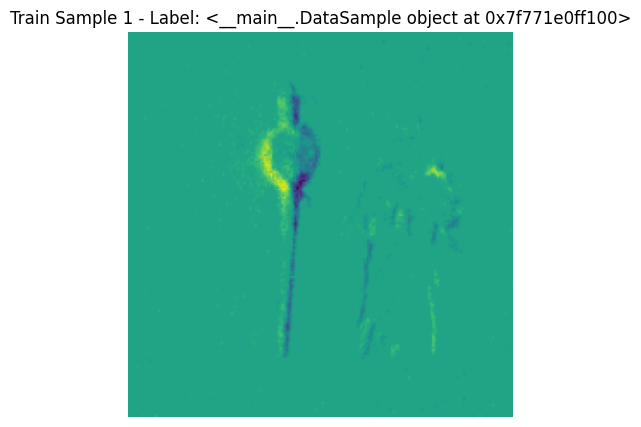

Validation Samples:
07/23 10:32:26 - mmengine - WARNING - Dataset Subset has no metainfo. ``dataset_meta`` in evaluator, metric and visualizer will be None.
Shape of inputs: torch.Size([1, 3, 32, 224, 224])


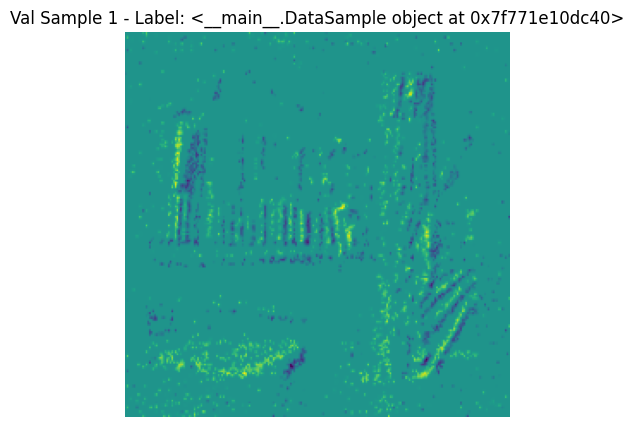

INFO:__main__:Starting training...


07/23 10:33:38 - mmengine - INFO - paramwise_options -- base.backbone.pos_embed: lr = 6e-05
07/23 10:33:38 - mmengine - INFO - paramwise_options -- base.backbone.pos_embed: weight_decay = 0.02
07/23 10:33:38 - mmengine - INFO - paramwise_options -- base.backbone.patch_embed.projection.weight: lr = 6e-05
07/23 10:33:38 - mmengine - INFO - paramwise_options -- base.backbone.patch_embed.projection.weight: weight_decay = 0.02
07/23 10:33:38 - mmengine - INFO - paramwise_options -- base.backbone.patch_embed.projection.bias: lr = 6e-05
07/23 10:33:38 - mmengine - INFO - paramwise_options -- base.backbone.patch_embed.projection.bias: weight_decay = 0.02
07/23 10:33:38 - mmengine - INFO - paramwise_options -- base.backbone.layers.0.mixer.A_log: lr = 6e-05
07/23 10:33:38 - mmengine - INFO - paramwise_options -- base.backbone.layers.0.mixer.A_log: weight_decay = 0.02
07/23 10:33:38 - mmengine - INFO - paramwise_options -- base.backbone.layers.0.mixer.D: lr = 6e-05
07/23 10:33:38 - mmengine - INF

/home/jovyan/envs/s4nd/lib/python3.9/site-packages/torch/nn/modules/conv.py:605: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv3d(


07/23 10:36:57 - mmengine - INFO - Epoch(train)  [1][ 20/179]  base_lr: 7.1477e-05 lr: 7.1477e-06  eta: 1 day, 9:01:40  time: 5.8737  data_time: 2.3017  memory: 34294  loss: 3.9443  top1_acc: 0.0500  top5_acc: 0.1500  loss_cls: 3.9443
07/23 10:39:17 - mmengine - INFO - Epoch(train)  [1][ 40/179]  base_lr: 8.3557e-05 lr: 8.3557e-06  eta: 1 day, 4:34:18  time: 7.4562  data_time: 3.8852  memory: 34294  loss: 3.9206  top1_acc: 0.2000  top5_acc: 0.2500  loss_cls: 3.9206
07/23 10:41:12 - mmengine - INFO - Epoch(train)  [1][ 60/179]  base_lr: 9.5638e-05 lr: 9.5638e-06  eta: 1 day, 1:42:16  time: 3.5605  data_time: 0.0045  memory: 34294  loss: 3.9105  top1_acc: 0.0000  top5_acc: 0.1000  loss_cls: 3.9105
07/23 10:43:39 - mmengine - INFO - Epoch(train)  [1][ 80/179]  base_lr: 1.0772e-04 lr: 1.0772e-05  eta: 1 day, 1:33:45  time: 7.7270  data_time: 4.1526  memory: 34294  loss: 3.9232  top1_acc: 0.0500  top5_acc: 0.1500  loss_cls: 3.9232
07/23 10:45:49 - mmengine - INFO - Epoch(train)  [1][100/179

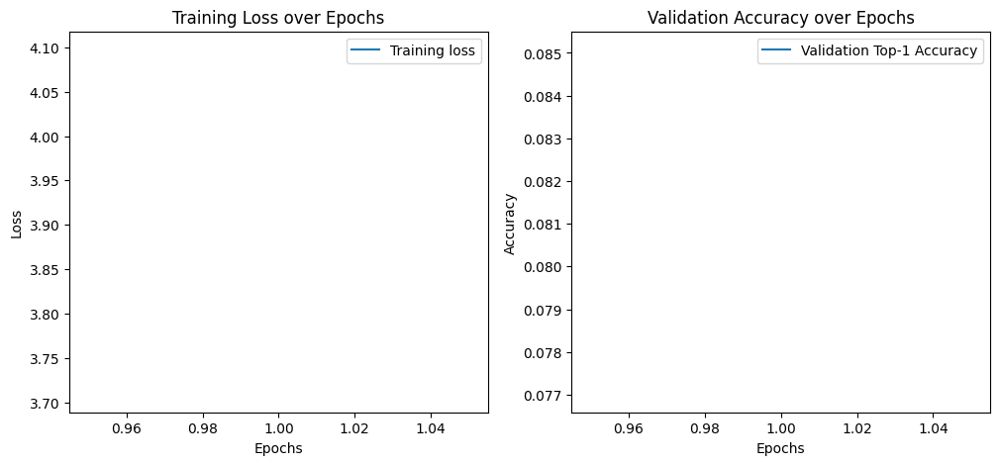

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77196334c0>
DEBUG:matplotlib.font_manager:findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=20.0.
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/jovyan/envs/s4nd/lib/python3.9/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf', name='DejaVu Sans', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 1.05
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/jovyan/envs/s4nd/lib/python3.9/site-packages/matplotlib/mpl-data/fonts/ttf/STIXSizTwoSymReg.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/jovyan/envs/s4nd/lib/python3.9/site-packages/matplotlib/mpl-data/fonts/ttf/STIXNonUniIta.ttf', name='STIXNonUnicode', style='italic', variant='normal',

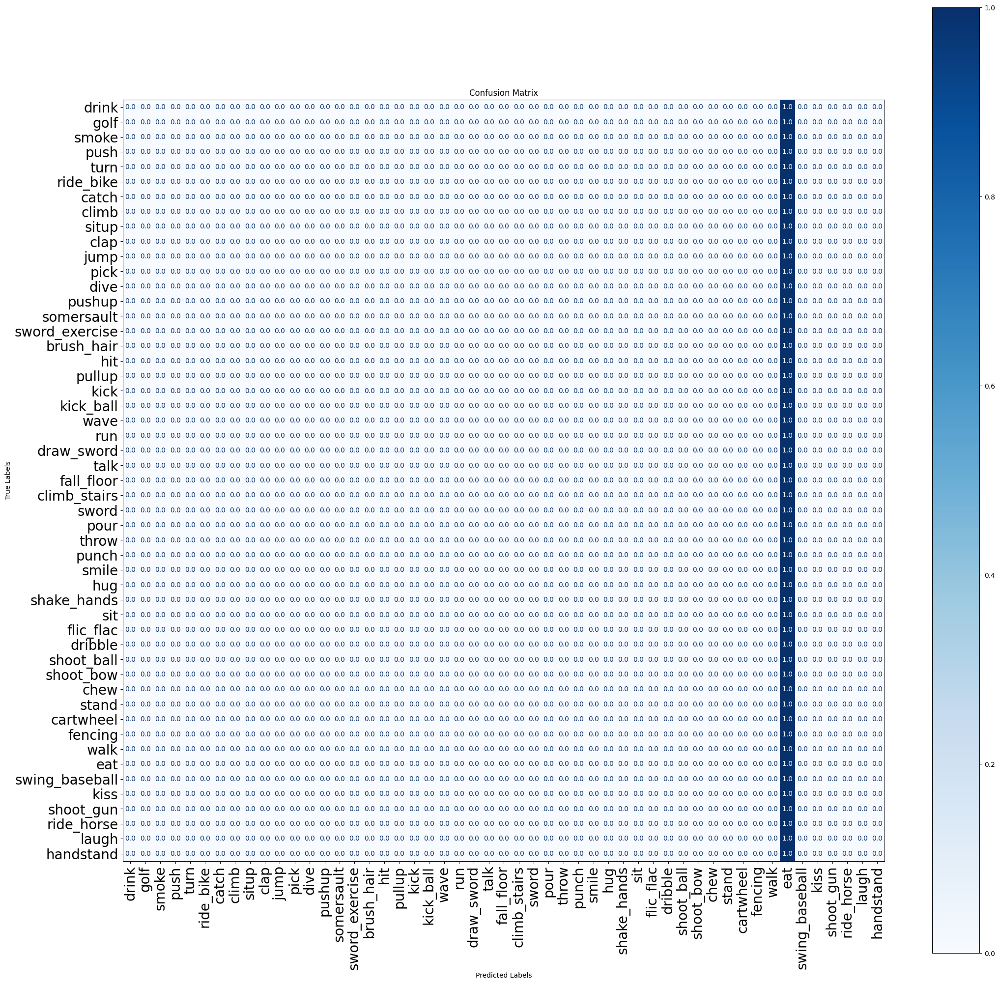

07/23 11:03:45 - mmengine - INFO - Epoch(val) [1][153/153]    acc/top1: 0.0810  acc/top5: 0.2150  acc/mean1: 0.0196  loss/loss: 3.9251  data_time: 3.5518  time: 3.8974
07/23 11:03:46 - mmengine - INFO - The best checkpoint with 0.0810 acc/top1 at 1 epoch is saved to best_acc_top1_epoch_1.pth.
07/23 11:06:55 - mmengine - INFO - Epoch(train)  [2][ 20/179]  base_lr: 1.7960e-04 lr: 1.7960e-05  eta: 23:51:03  time: 7.3441  data_time: 3.7660  memory: 34294  loss: 3.7581  top1_acc: 0.2500  top5_acc: 0.4500  loss_cls: 3.7581
07/23 11:09:20 - mmengine - INFO - Epoch(train)  [2][ 40/179]  base_lr: 1.9168e-04 lr: 1.9168e-05  eta: 23:54:15  time: 7.0862  data_time: 3.4630  memory: 34294  loss: 3.8162  top1_acc: 0.0500  top5_acc: 0.2500  loss_cls: 3.8162
07/23 11:10:56 - mmengine - INFO - Epoch(train)  [2][ 60/179]  base_lr: 2.0376e-04 lr: 2.0376e-05  eta: 23:14:17  time: 3.5588  data_time: 0.0041  memory: 34294  loss: 3.8122  top1_acc: 0.0500  top5_acc: 0.1000  loss_cls: 3.8122
07/23 11:13:20 - mm

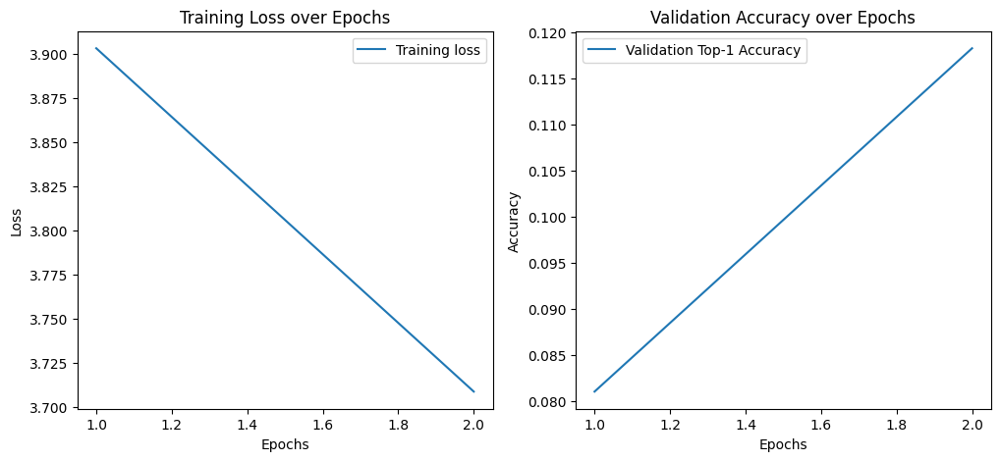

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a24d640>


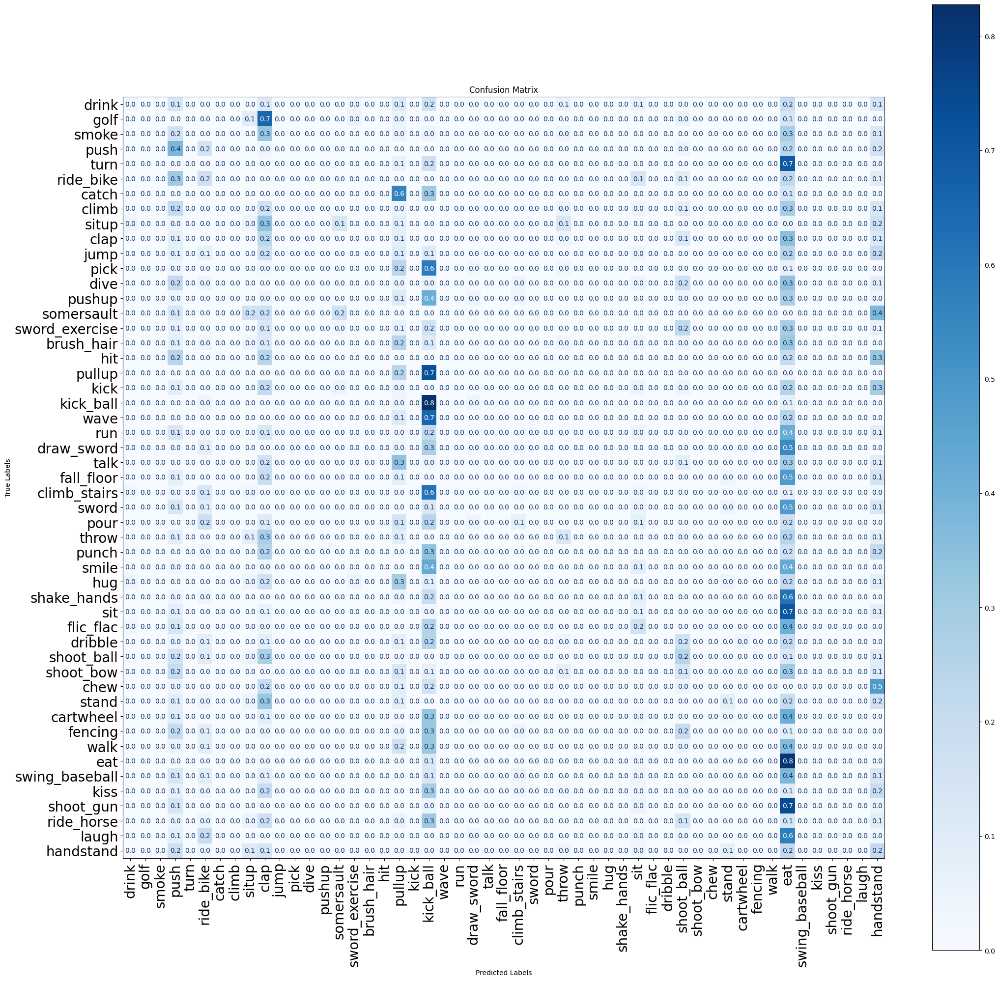

07/23 11:34:49 - mmengine - INFO - Epoch(val) [2][153/153]    acc/top1: 0.1183  acc/top5: 0.3588  acc/mean1: 0.0718  loss/loss: 3.9148  data_time: 3.6994  time: 4.0449
07/23 11:34:49 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_1.pth is removed
07/23 11:34:49 - mmengine - INFO - The best checkpoint with 0.1183 acc/top1 at 2 epoch is saved to best_acc_top1_epoch_2.pth.
07/23 11:37:55 - mmengine - INFO - Epoch(train)  [3][ 20/179]  base_lr: 2.8772e-04 lr: 2.8772e-05  eta: 23:21:33  time: 7.3355  data_time: 3.7719  memory: 34294  loss: 3.4923  top1_acc: 0.1000  top5_acc: 0.2500  loss_cls: 3.4923
07/23 11:40:11 - mmengine - INFO - Epoch(train)  [3][ 40/179]  base_lr: 2.9980e-04 lr: 2.9980e-05  eta: 23:18:15  time: 6.6407  data_time: 3.0704  memory: 34294  loss: 3.4342  top1_acc: 0.1500  top5_acc: 0.3500  loss_cls: 3.4342
07/23 11:42:03 - mmengine - INFO - Epoch(train)  [3][ 60/179]  base_lr: 3.1188e-04 lr: 3.1188e-05  

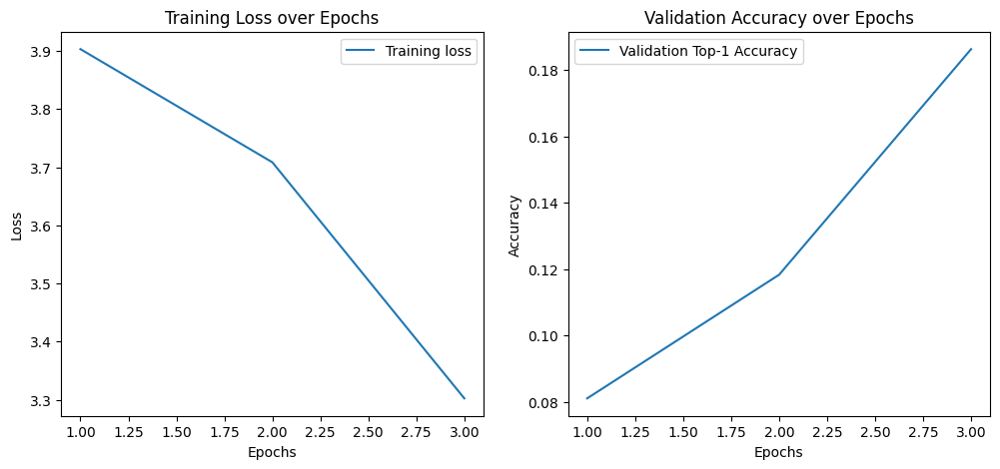

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a85b490>


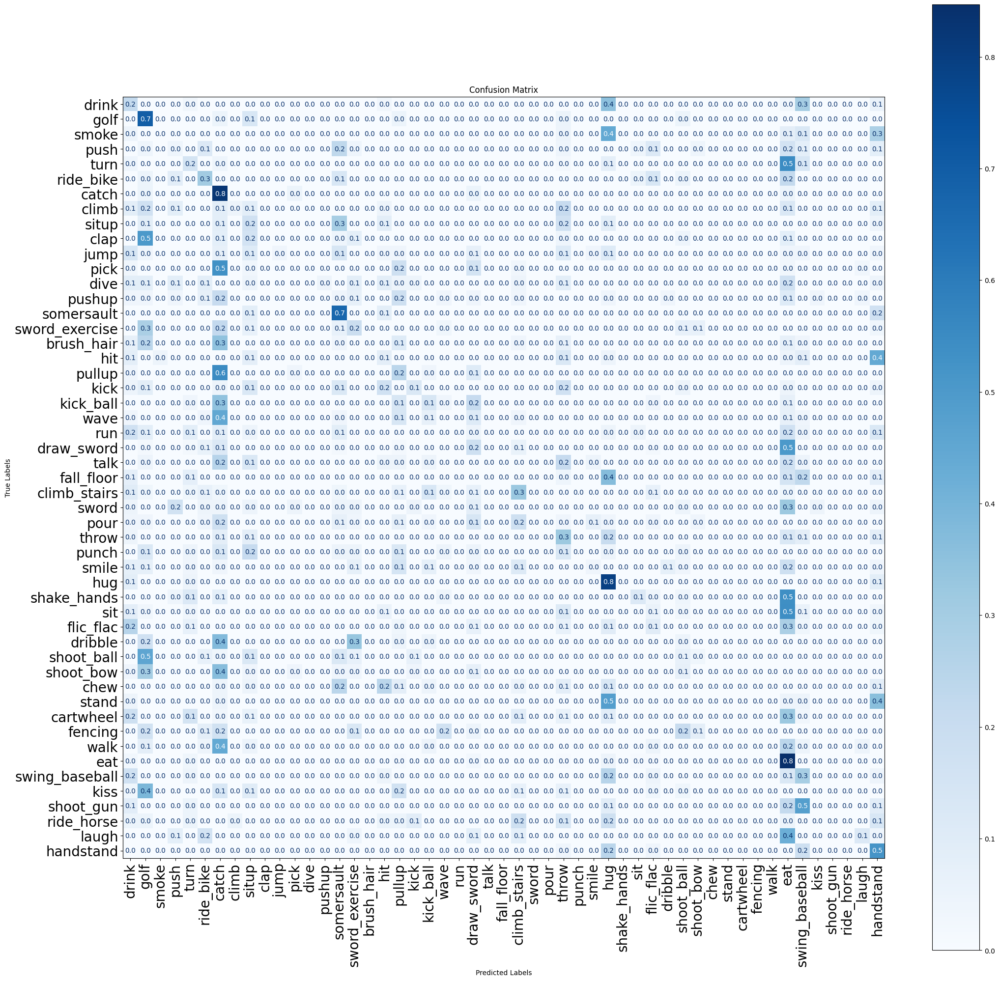

07/23 12:05:22 - mmengine - INFO - Epoch(val) [3][153/153]    acc/top1: 0.1863  acc/top5: 0.5098  acc/mean1: 0.1467  loss/loss: 3.8955  data_time: 3.6931  time: 4.0400
07/23 12:05:22 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_2.pth is removed
07/23 12:05:23 - mmengine - INFO - The best checkpoint with 0.1863 acc/top1 at 3 epoch is saved to best_acc_top1_epoch_3.pth.
07/23 12:08:44 - mmengine - INFO - Epoch(train)  [4][ 20/179]  base_lr: 3.9584e-04 lr: 3.9584e-05  eta: 22:52:34  time: 7.4610  data_time: 3.8982  memory: 34294  loss: 2.8713  top1_acc: 0.1500  top5_acc: 0.5500  loss_cls: 2.8713
07/23 12:11:19 - mmengine - INFO - Epoch(train)  [4][ 40/179]  base_lr: 4.0792e-04 lr: 4.0792e-05  eta: 22:56:06  time: 7.8683  data_time: 4.2789  memory: 34294  loss: 2.9529  top1_acc: 0.1000  top5_acc: 0.4000  loss_cls: 2.9529
07/23 12:13:05 - mmengine - INFO - Epoch(train)  [4][ 60/179]  base_lr: 4.2000e-04 lr: 4.2000e-05  

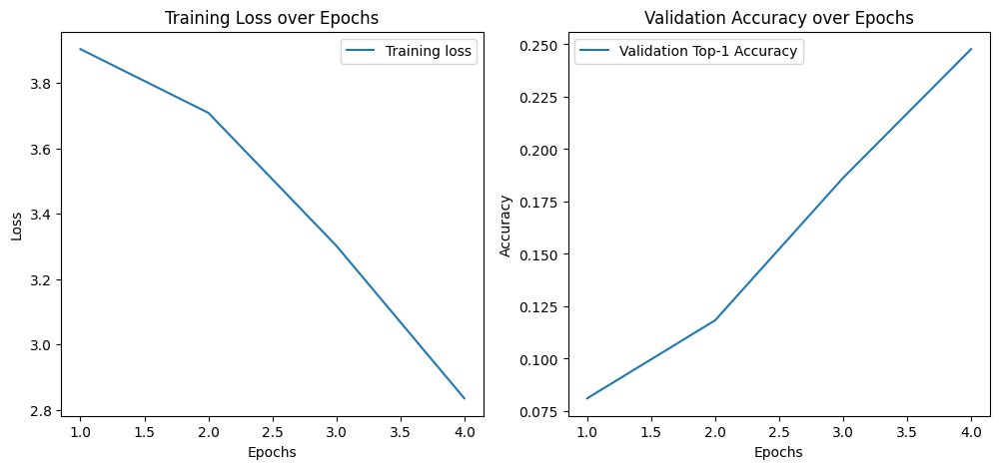

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771932a520>


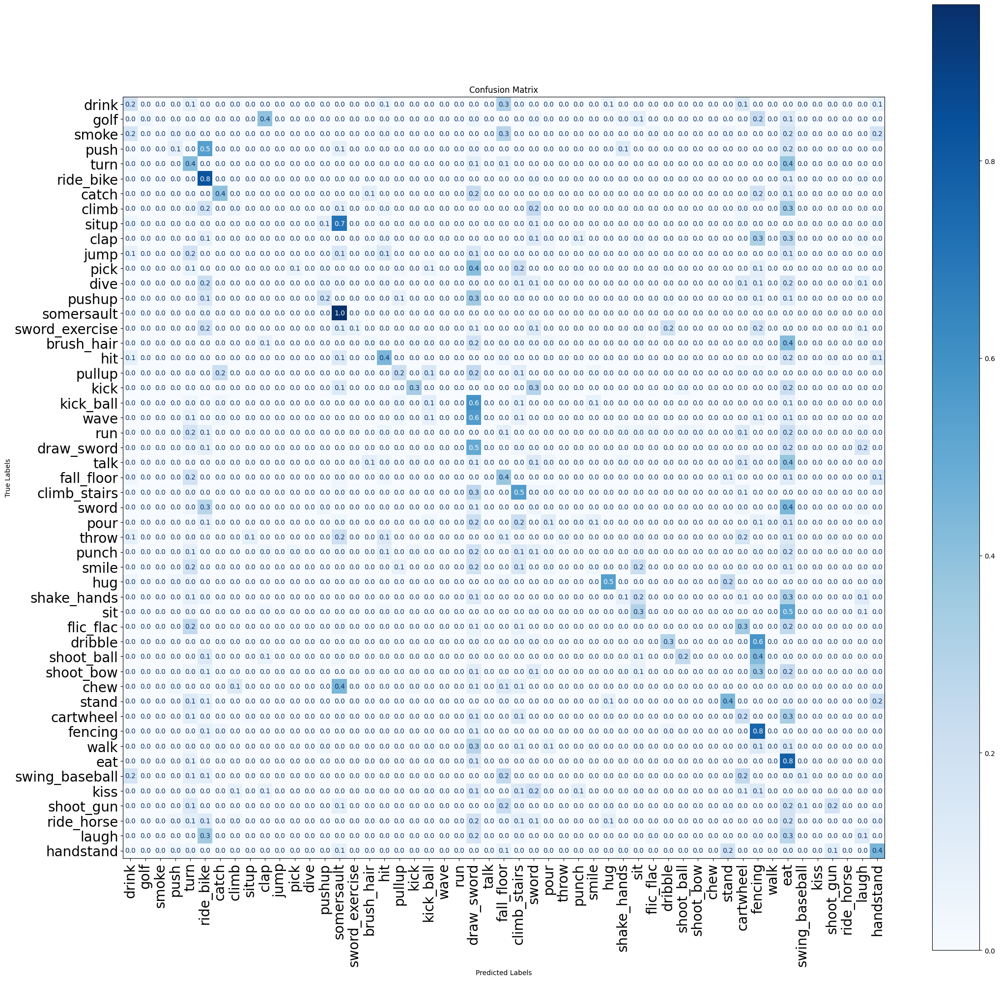

07/23 12:38:10 - mmengine - INFO - Epoch(val) [4][153/153]    acc/top1: 0.2477  acc/top5: 0.6190  acc/mean1: 0.2057  loss/loss: 3.8719  data_time: 4.0411  time: 4.3868
07/23 12:38:10 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_3.pth is removed
07/23 12:38:11 - mmengine - INFO - The best checkpoint with 0.2477 acc/top1 at 4 epoch is saved to best_acc_top1_epoch_4.pth.
07/23 12:41:27 - mmengine - INFO - Epoch(train)  [5][ 20/179]  base_lr: 5.0396e-04 lr: 5.0396e-05  eta: 22:44:34  time: 8.0657  data_time: 4.5070  memory: 34294  loss: 2.5862  top1_acc: 0.2500  top5_acc: 0.8000  loss_cls: 2.5862
07/23 12:43:45 - mmengine - INFO - Epoch(train)  [5][ 40/179]  base_lr: 5.1604e-04 lr: 5.1604e-05  eta: 22:42:04  time: 7.0246  data_time: 3.4360  memory: 34294  loss: 2.5213  top1_acc: 0.3000  top5_acc: 0.6500  loss_cls: 2.5213
07/23 12:45:41 - mmengine - INFO - Epoch(train)  [5][ 60/179]  base_lr: 5.2812e-04 lr: 5.2812e-05  

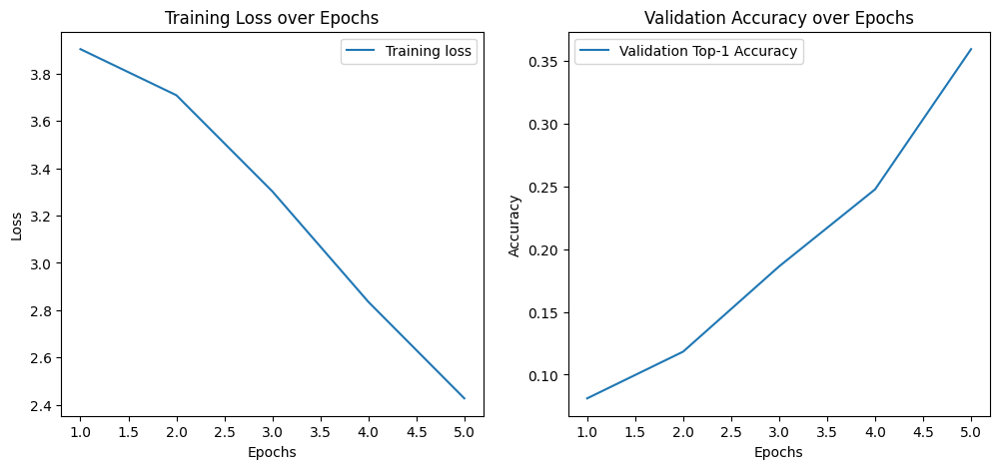

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719e52e80>


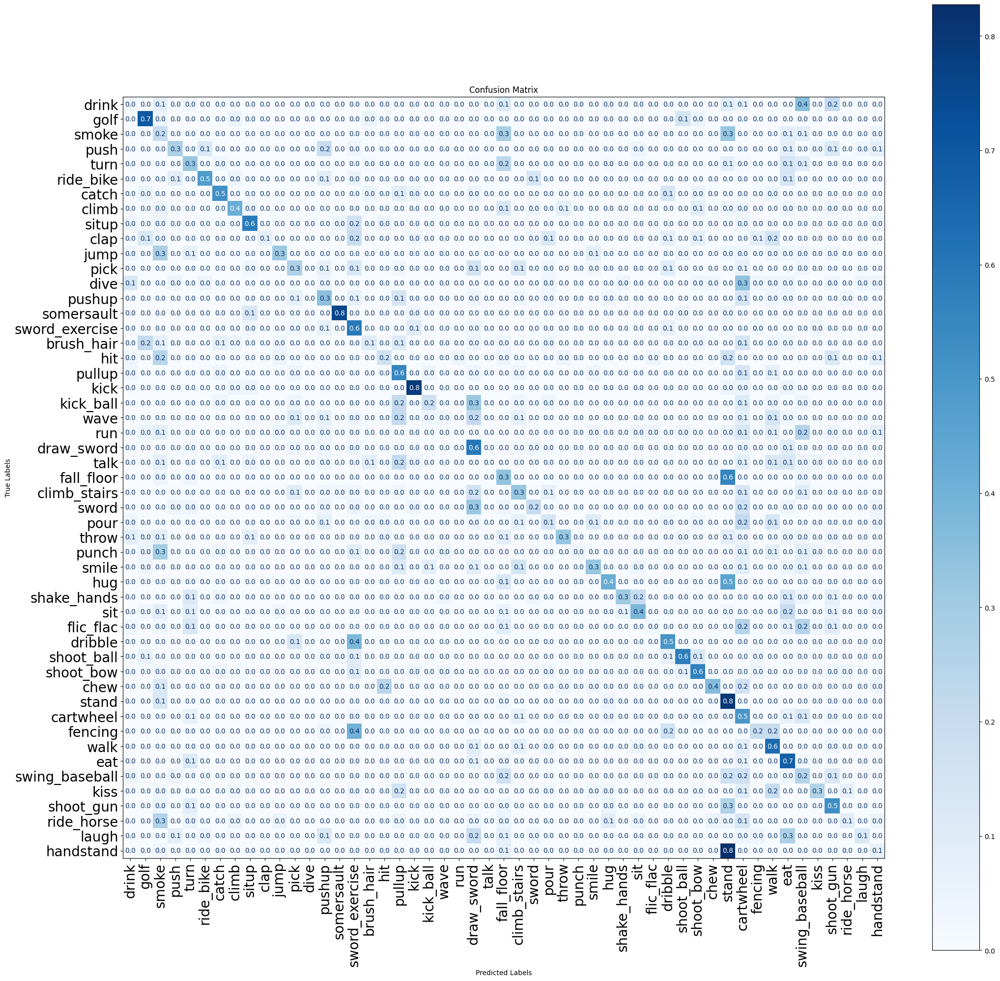

07/23 13:08:55 - mmengine - INFO - Epoch(val) [5][153/153]    acc/top1: 0.3595  acc/top5: 0.7013  acc/mean1: 0.3372  loss/loss: 3.8460  data_time: 3.8093  time: 4.1550
07/23 13:08:55 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_4.pth is removed
07/23 13:08:56 - mmengine - INFO - The best checkpoint with 0.3595 acc/top1 at 5 epoch is saved to best_acc_top1_epoch_5.pth.
07/23 13:12:19 - mmengine - INFO - Epoch(train)  [6][ 20/179]  base_lr: 6.0000e-04 lr: 6.0000e-05  eta: 22:19:15  time: 7.6392  data_time: 4.0515  memory: 34294  loss: 1.9809  top1_acc: 0.5500  top5_acc: 0.9500  loss_cls: 1.9809
07/23 13:14:49 - mmengine - INFO - Epoch(train)  [6][ 40/179]  base_lr: 6.0000e-04 lr: 6.0000e-05  eta: 22:19:19  time: 7.1891  data_time: 3.5902  memory: 34294  loss: 2.0571  top1_acc: 0.4500  top5_acc: 0.7500  loss_cls: 2.0571
07/23 13:16:37 - mmengine - INFO - Epoch(train)  [6][ 60/179]  base_lr: 6.0000e-04 lr: 6.0000e-05  

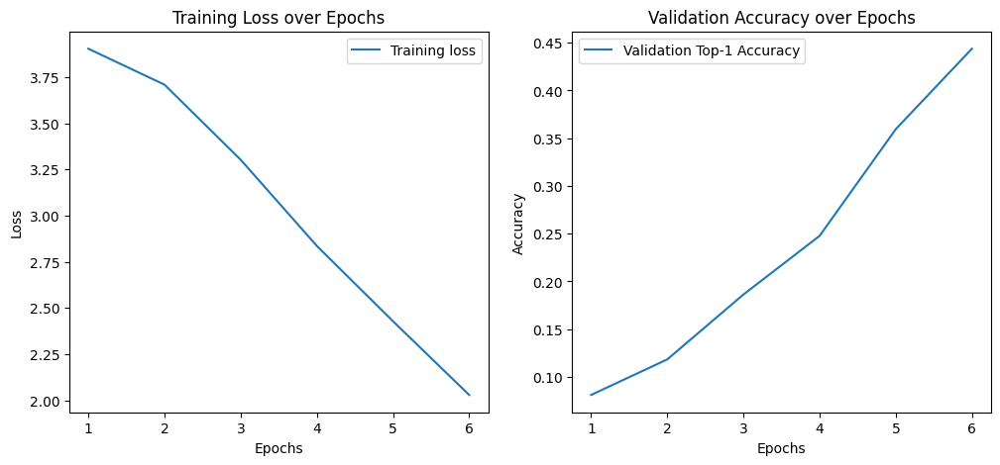

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77193c11c0>


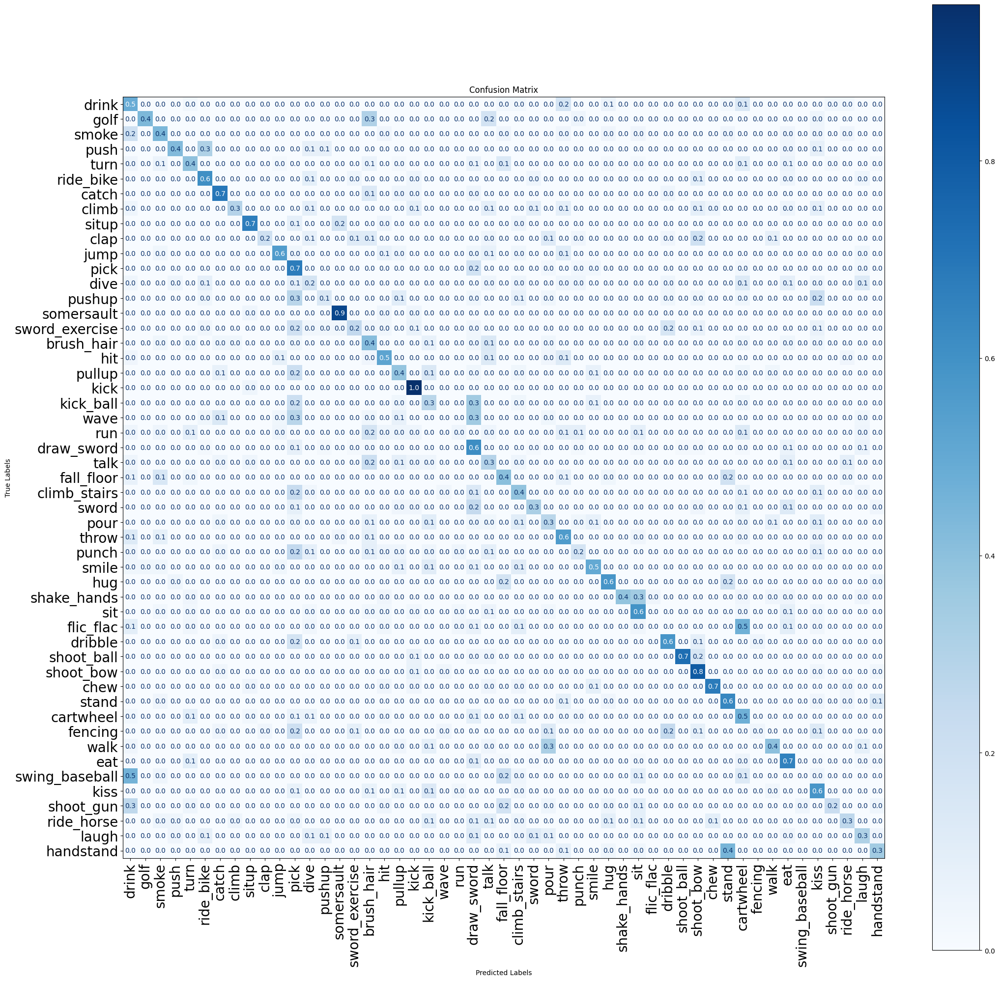

07/23 13:41:09 - mmengine - INFO - Epoch(val) [6][153/153]    acc/top1: 0.4438  acc/top5: 0.7935  acc/mean1: 0.4250  loss/loss: 3.8155  data_time: 3.9633  time: 4.3088
07/23 13:41:09 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_5.pth is removed
07/23 13:41:10 - mmengine - INFO - The best checkpoint with 0.4438 acc/top1 at 6 epoch is saved to best_acc_top1_epoch_6.pth.
07/23 13:44:29 - mmengine - INFO - Epoch(train)  [7][ 20/179]  base_lr: 5.9970e-04 lr: 5.9970e-05  eta: 22:01:50  time: 7.9870  data_time: 4.4109  memory: 34294  loss: 1.8733  top1_acc: 0.4500  top5_acc: 0.9500  loss_cls: 1.8733
07/23 13:47:12 - mmengine - INFO - Epoch(train)  [7][ 40/179]  base_lr: 5.9970e-04 lr: 5.9970e-05  eta: 22:03:33  time: 8.6546  data_time: 5.0754  memory: 34294  loss: 1.6483  top1_acc: 0.5500  top5_acc: 0.9000  loss_cls: 1.6483
07/23 13:48:55 - mmengine - INFO - Epoch(train)  [7][ 60/179]  base_lr: 5.9970e-04 lr: 5.9970e-05  

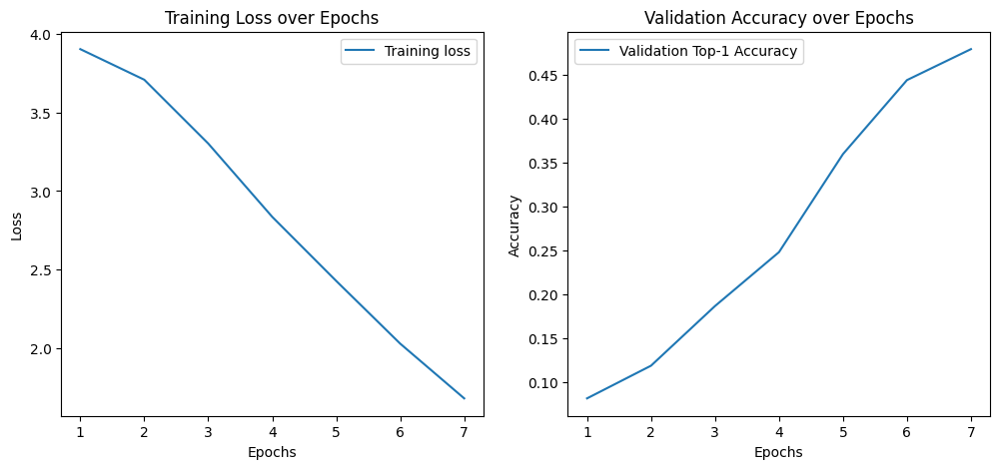

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77192cfa60>


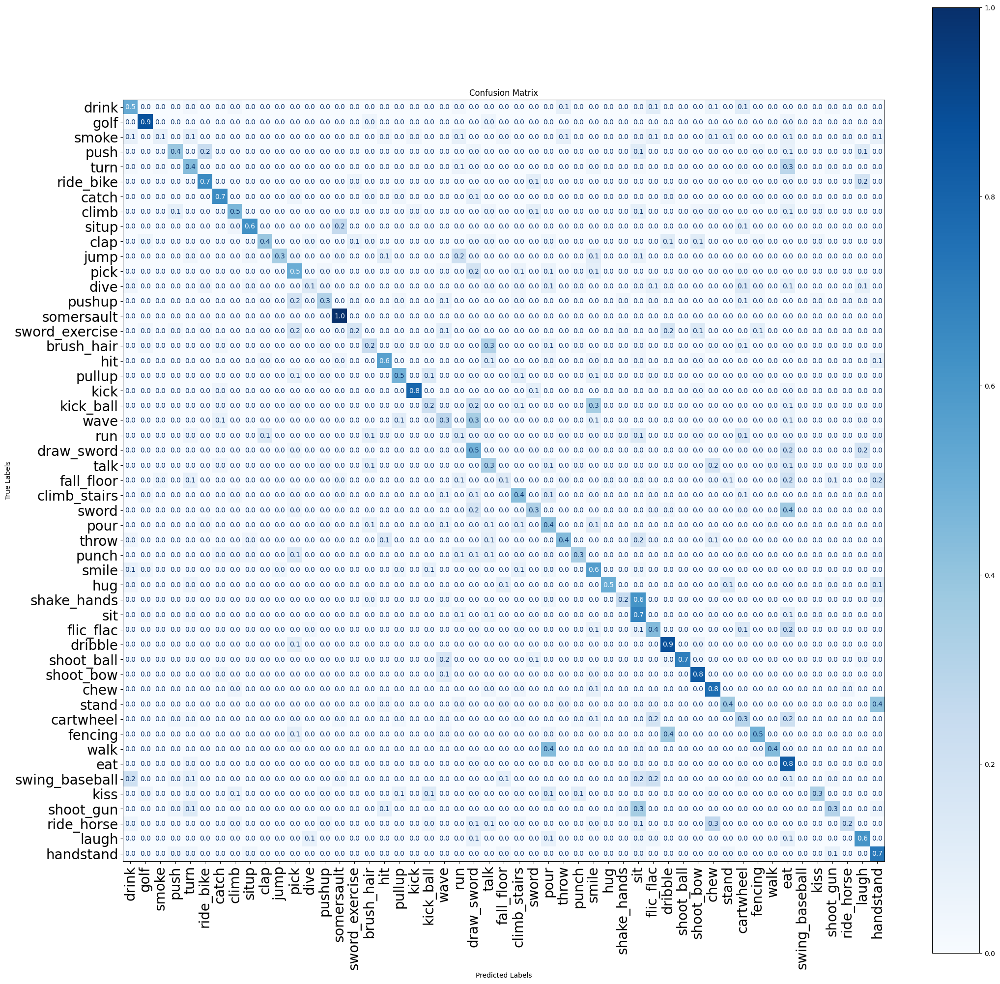

07/23 14:12:53 - mmengine - INFO - Epoch(val) [7][153/153]    acc/top1: 0.4791  acc/top5: 0.8046  acc/mean1: 0.4550  loss/loss: 3.7841  data_time: 3.7953  time: 4.1407
07/23 14:12:53 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_6.pth is removed
07/23 14:12:54 - mmengine - INFO - The best checkpoint with 0.4791 acc/top1 at 7 epoch is saved to best_acc_top1_epoch_7.pth.
07/23 14:16:18 - mmengine - INFO - Epoch(train)  [8][ 20/179]  base_lr: 5.9879e-04 lr: 5.9881e-05  eta: 21:44:15  time: 7.1535  data_time: 3.5866  memory: 34294  loss: 1.4885  top1_acc: 0.5000  top5_acc: 0.8500  loss_cls: 1.4885
07/23 14:18:37 - mmengine - INFO - Epoch(train)  [8][ 40/179]  base_lr: 5.9879e-04 lr: 5.9881e-05  eta: 21:41:55  time: 6.6373  data_time: 3.0308  memory: 34294  loss: 1.3198  top1_acc: 0.5000  top5_acc: 0.9500  loss_cls: 1.3198
07/23 14:20:21 - mmengine - INFO - Epoch(train)  [8][ 60/179]  base_lr: 5.9879e-04 lr: 5.9881e-05  

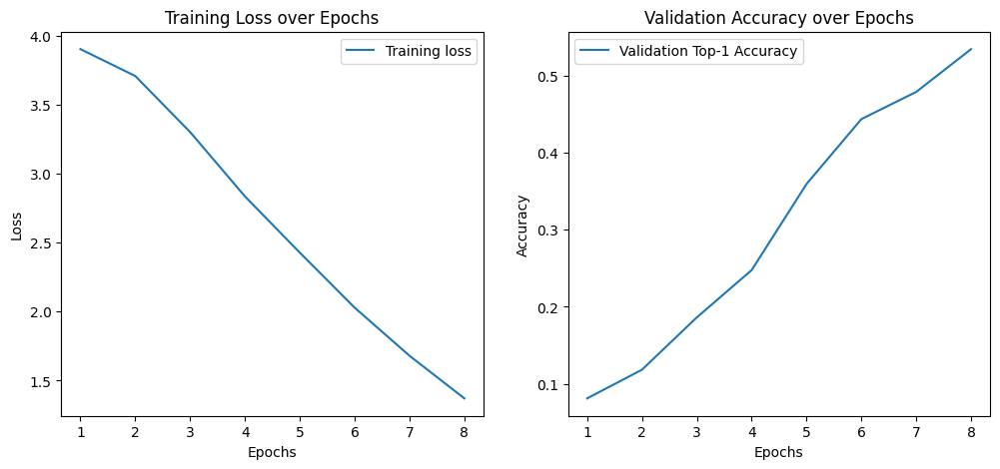

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719e01430>


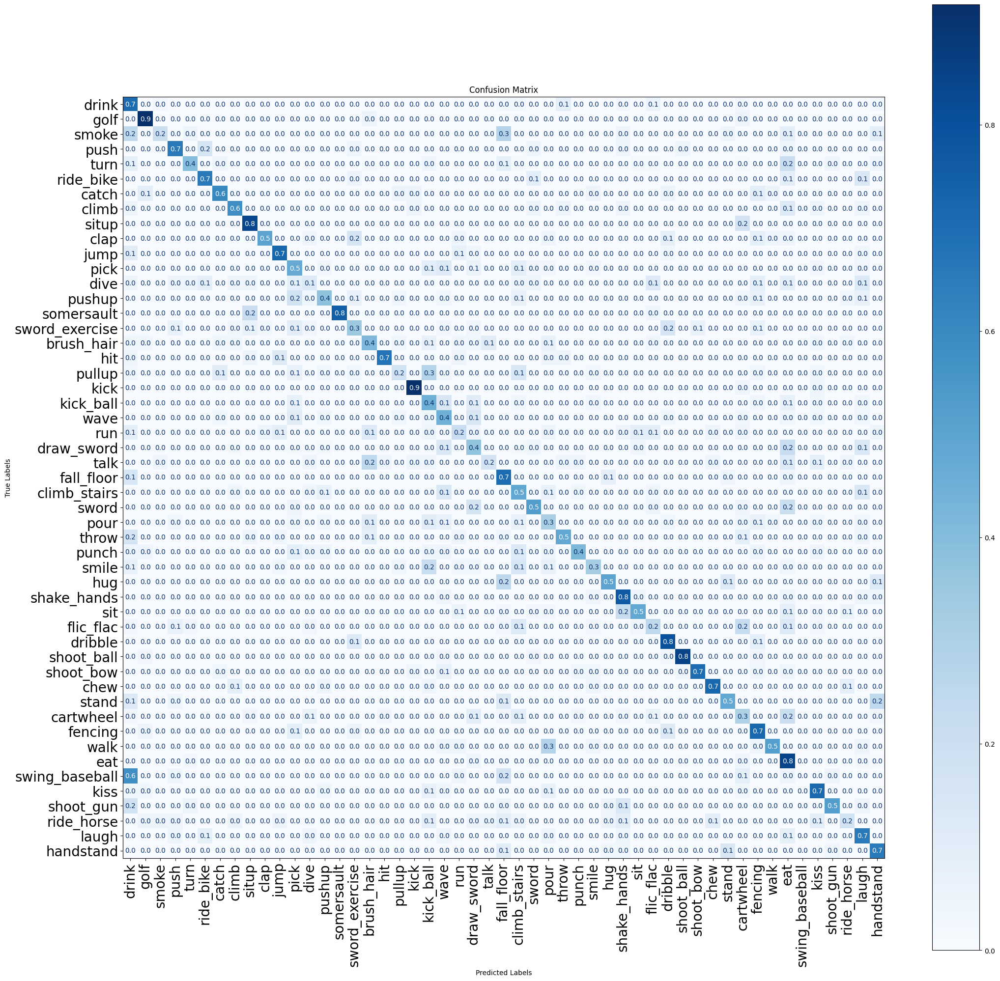

07/23 14:45:12 - mmengine - INFO - Epoch(val) [8][153/153]    acc/top1: 0.5346  acc/top5: 0.8438  acc/mean1: 0.5201  loss/loss: 3.7505  data_time: 4.1540  time: 4.4983
07/23 14:45:12 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_7.pth is removed
07/23 14:45:12 - mmengine - INFO - The best checkpoint with 0.5346 acc/top1 at 8 epoch is saved to best_acc_top1_epoch_8.pth.
07/23 14:48:48 - mmengine - INFO - Epoch(train)  [9][ 20/179]  base_lr: 5.9729e-04 lr: 5.9733e-05  eta: 21:26:23  time: 8.0348  data_time: 4.4676  memory: 34294  loss: 0.9859  top1_acc: 0.6000  top5_acc: 1.0000  loss_cls: 0.9859
07/23 14:51:05 - mmengine - INFO - Epoch(train)  [9][ 40/179]  base_lr: 5.9729e-04 lr: 5.9733e-05  eta: 21:23:49  time: 6.9666  data_time: 3.3915  memory: 34294  loss: 1.0709  top1_acc: 0.6500  top5_acc: 0.9000  loss_cls: 1.0709
07/23 14:53:03 - mmengine - INFO - Epoch(train)  [9][ 60/179]  base_lr: 5.9729e-04 lr: 5.9733e-05  

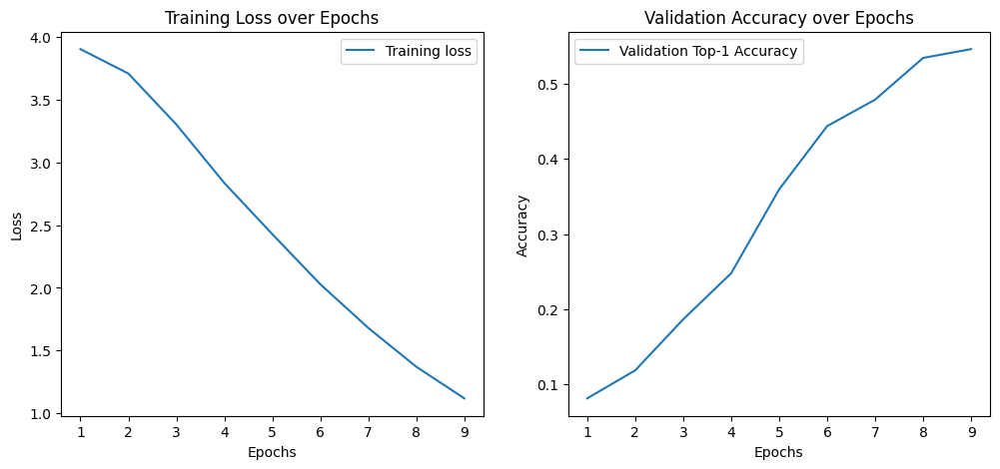

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771aaa1910>


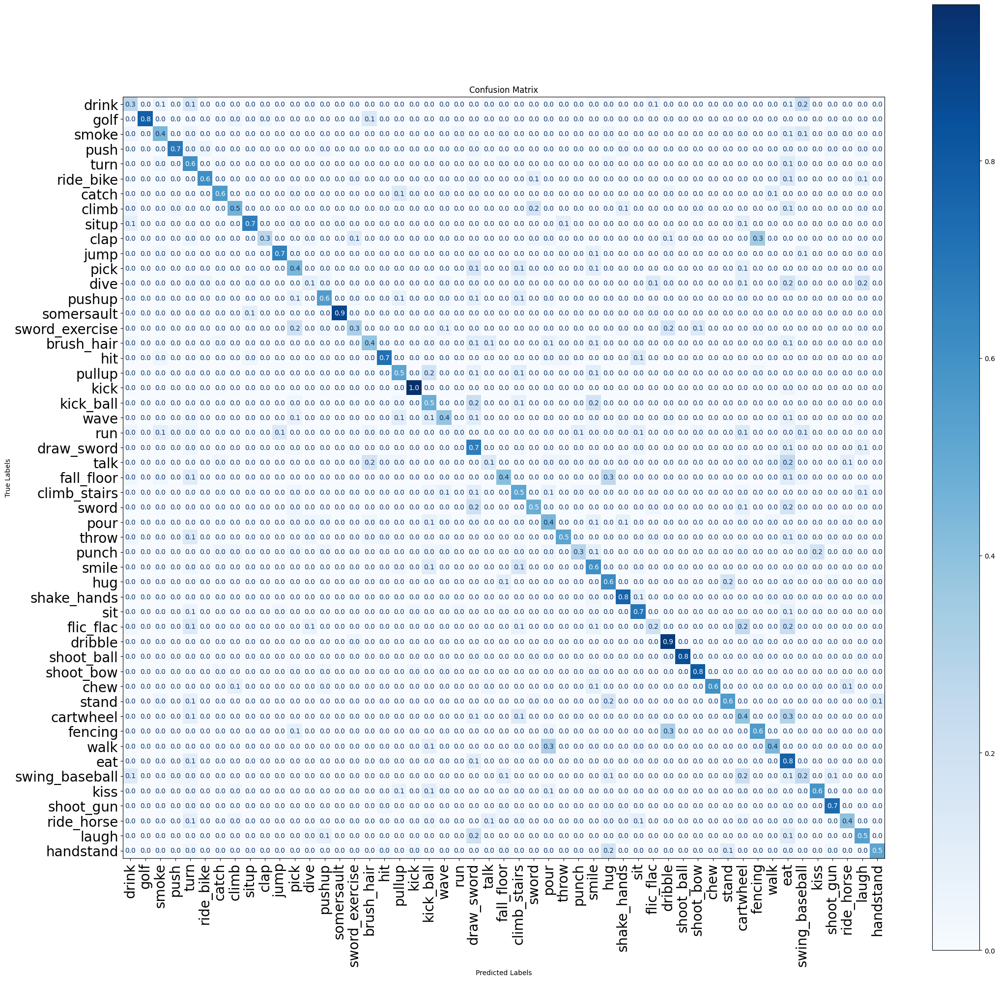

07/23 15:16:45 - mmengine - INFO - Epoch(val) [9][153/153]    acc/top1: 0.5464  acc/top5: 0.8314  acc/mean1: 0.5295  loss/loss: 3.7217  data_time: 3.7146  time: 4.0583
07/23 15:16:45 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_8.pth is removed
07/23 15:16:45 - mmengine - INFO - The best checkpoint with 0.5464 acc/top1 at 9 epoch is saved to best_acc_top1_epoch_9.pth.
07/23 15:20:13 - mmengine - INFO - Epoch(train) [10][ 20/179]  base_lr: 5.9519e-04 lr: 5.9526e-05  eta: 21:05:55  time: 7.2704  data_time: 3.6945  memory: 34294  loss: 1.1499  top1_acc: 0.7500  top5_acc: 0.9000  loss_cls: 1.1499
07/23 15:22:36 - mmengine - INFO - Epoch(train) [10][ 40/179]  base_lr: 5.9519e-04 lr: 5.9526e-05  eta: 21:04:00  time: 7.2240  data_time: 3.6451  memory: 34294  loss: 1.0703  top1_acc: 0.7000  top5_acc: 1.0000  loss_cls: 1.0703
07/23 15:24:34 - mmengine - INFO - Epoch(train) [10][ 60/179]  base_lr: 5.9519e-04 lr: 5.9526e-05  

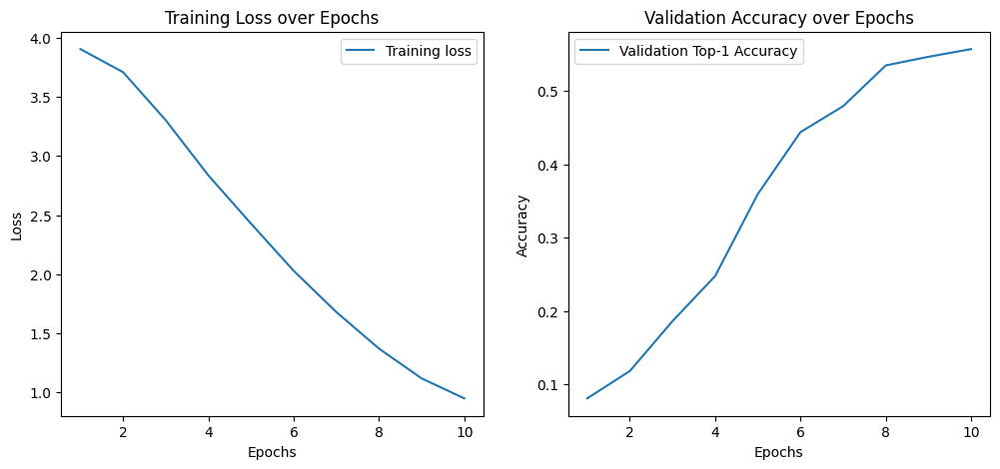

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719f71100>


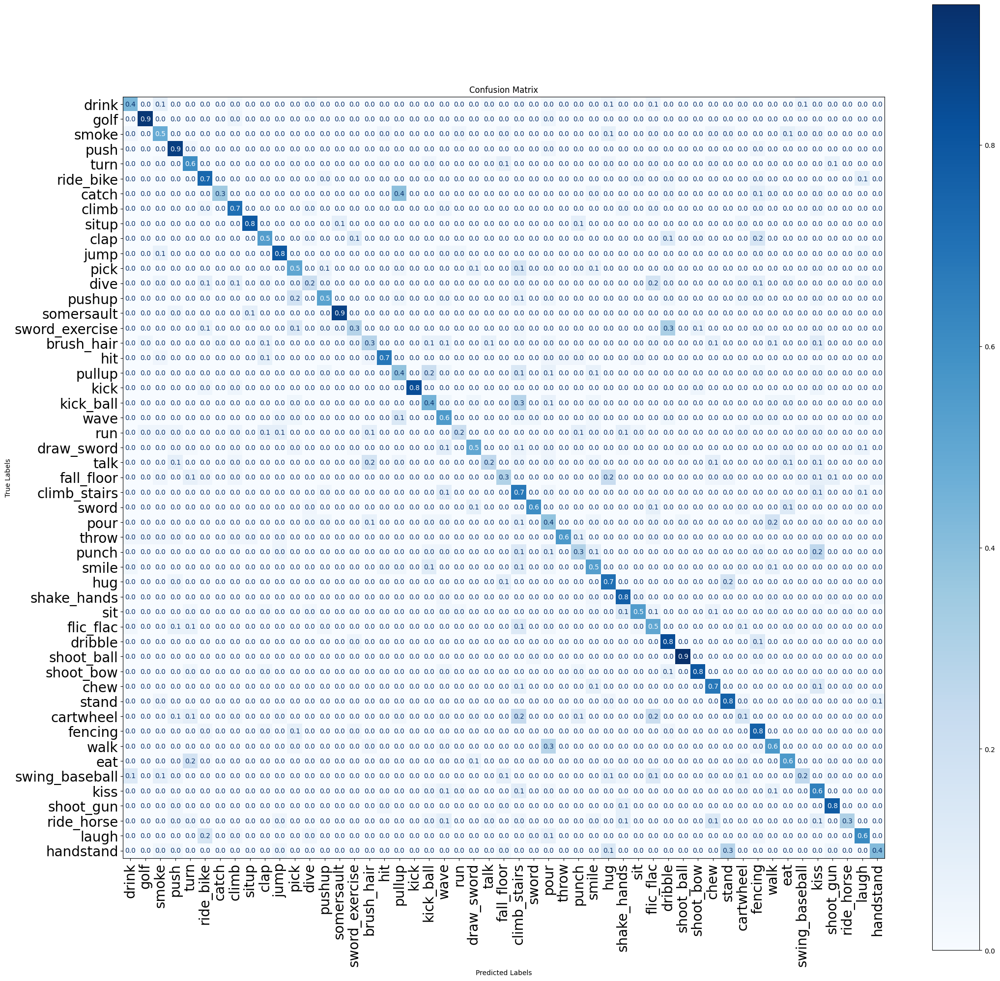

07/23 15:49:22 - mmengine - INFO - Epoch(val) [10][153/153]    acc/top1: 0.5569  acc/top5: 0.8229  acc/mean1: 0.5617  loss/loss: 3.6968  data_time: 4.0458  time: 4.3898
07/23 15:49:22 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_9.pth is removed
07/23 15:49:23 - mmengine - INFO - The best checkpoint with 0.5569 acc/top1 at 10 epoch is saved to best_acc_top1_epoch_10.pth.
07/23 15:52:50 - mmengine - INFO - Epoch(train) [11][ 20/179]  base_lr: 5.9249e-04 lr: 5.9260e-05  eta: 20:47:46  time: 7.5097  data_time: 3.9473  memory: 34294  loss: 0.7431  top1_acc: 0.8000  top5_acc: 1.0000  loss_cls: 0.7431
07/23 15:55:01 - mmengine - INFO - Epoch(train) [11][ 40/179]  base_lr: 5.9249e-04 lr: 5.9260e-05  eta: 20:44:41  time: 6.7933  data_time: 3.2259  memory: 34294  loss: 0.6922  top1_acc: 0.7500  top5_acc: 0.9500  loss_cls: 0.6922
07/23 15:56:47 - mmengine - INFO - Epoch(train) [11][ 60/179]  base_lr: 5.9249e-04 lr: 5.9260e-0

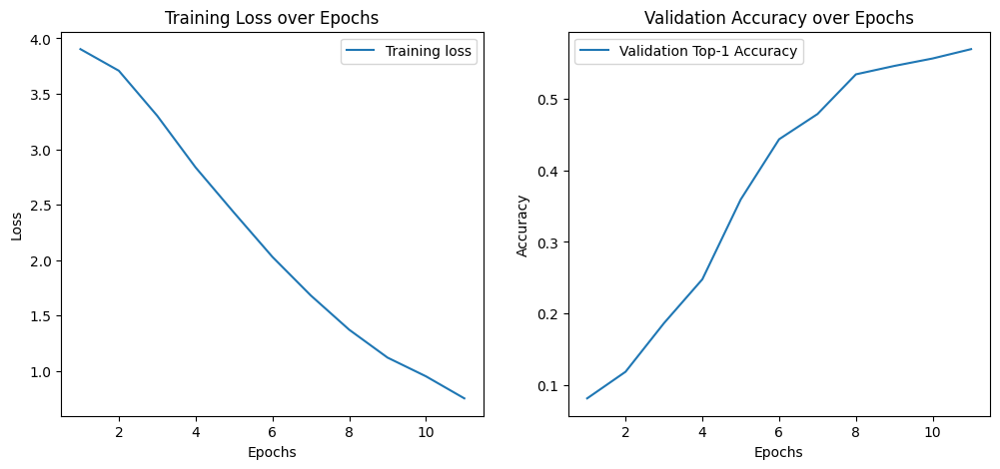

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719df99d0>


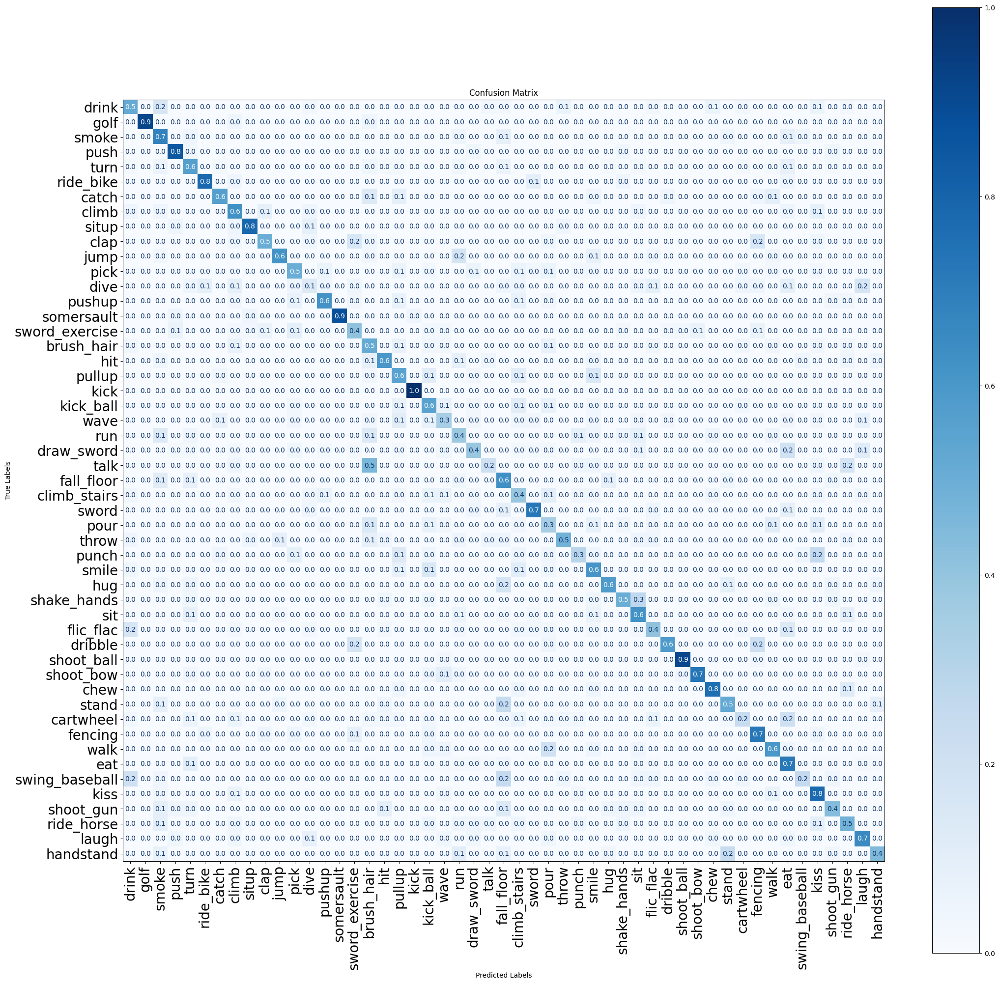

07/23 16:21:24 - mmengine - INFO - Epoch(val) [11][153/153]    acc/top1: 0.5699  acc/top5: 0.8425  acc/mean1: 0.5658  loss/loss: 3.6482  data_time: 4.0220  time: 4.3646
07/23 16:21:24 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_10.pth is removed
07/23 16:21:25 - mmengine - INFO - The best checkpoint with 0.5699 acc/top1 at 11 epoch is saved to best_acc_top1_epoch_11.pth.
07/23 16:24:47 - mmengine - INFO - Epoch(train) [12][ 20/179]  base_lr: 5.8921e-04 lr: 5.8937e-05  eta: 20:27:17  time: 6.9451  data_time: 3.3562  memory: 34294  loss: 0.4787  top1_acc: 0.7500  top5_acc: 1.0000  loss_cls: 0.4787
07/23 16:26:10 - mmengine - INFO - Exp name: 20240723_102956
07/23 16:27:34 - mmengine - INFO - Epoch(train) [12][ 40/179]  base_lr: 5.8921e-04 lr: 5.8937e-05  eta: 20:27:19  time: 8.7804  data_time: 5.1877  memory: 34294  loss: 0.5814  top1_acc: 0.8500  top5_acc: 1.0000  loss_cls: 0.5814
07/23 16:29:28 - mmengine - INFO -

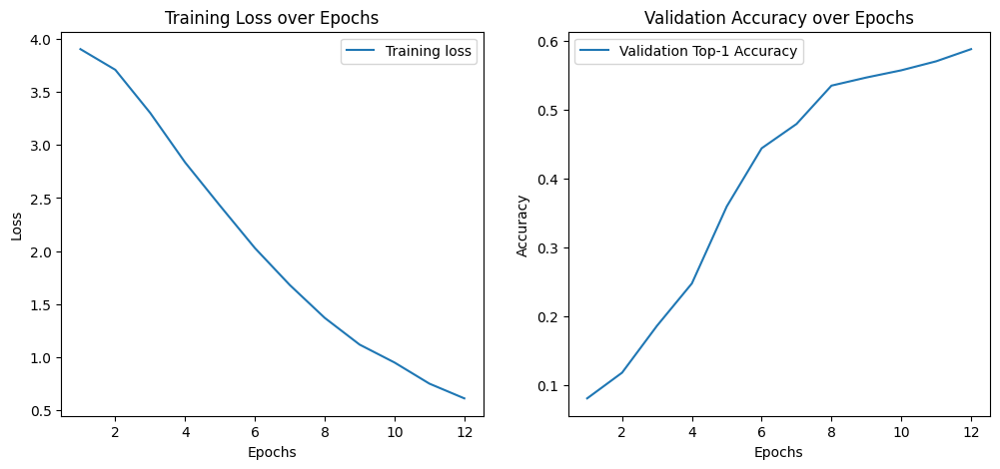

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f778aea3d30>


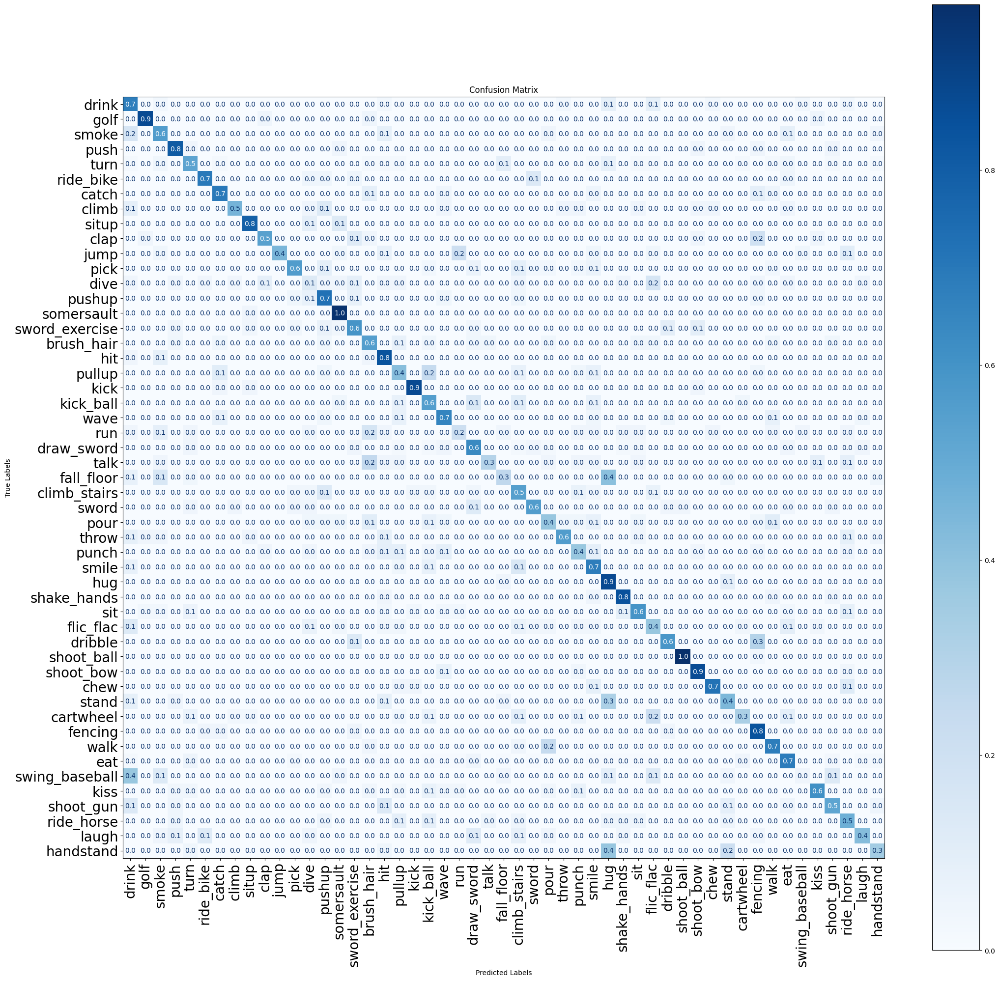

07/23 16:53:34 - mmengine - INFO - Epoch(val) [12][153/153]    acc/top1: 0.5876  acc/top5: 0.8542  acc/mean1: 0.5811  loss/loss: 3.5998  data_time: 3.9059  time: 4.2500
07/23 16:53:34 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_11.pth is removed
07/23 16:53:34 - mmengine - INFO - The best checkpoint with 0.5876 acc/top1 at 12 epoch is saved to best_acc_top1_epoch_12.pth.
07/23 16:56:47 - mmengine - INFO - Epoch(train) [13][ 20/179]  base_lr: 5.8534e-04 lr: 5.8556e-05  eta: 20:06:43  time: 7.4186  data_time: 3.8657  memory: 34294  loss: 0.4799  top1_acc: 0.8000  top5_acc: 0.9500  loss_cls: 0.4799
07/23 16:59:18 - mmengine - INFO - Epoch(train) [13][ 40/179]  base_lr: 5.8534e-04 lr: 5.8556e-05  eta: 20:05:17  time: 7.6156  data_time: 4.0359  memory: 34294  loss: 0.4876  top1_acc: 0.8500  top5_acc: 1.0000  loss_cls: 0.4876
07/23 17:01:21 - mmengine - INFO - Epoch(train) [13][ 60/179]  base_lr: 5.8534e-04 lr: 5.8556e-

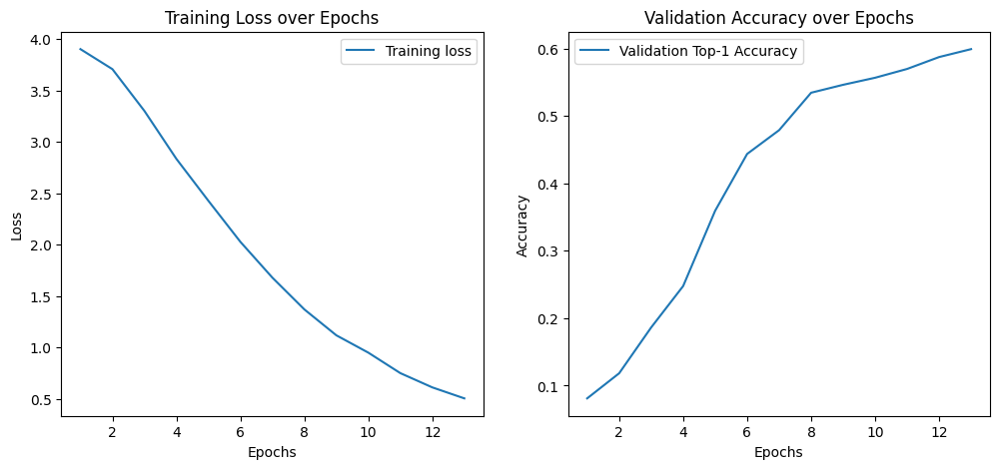

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719537f40>


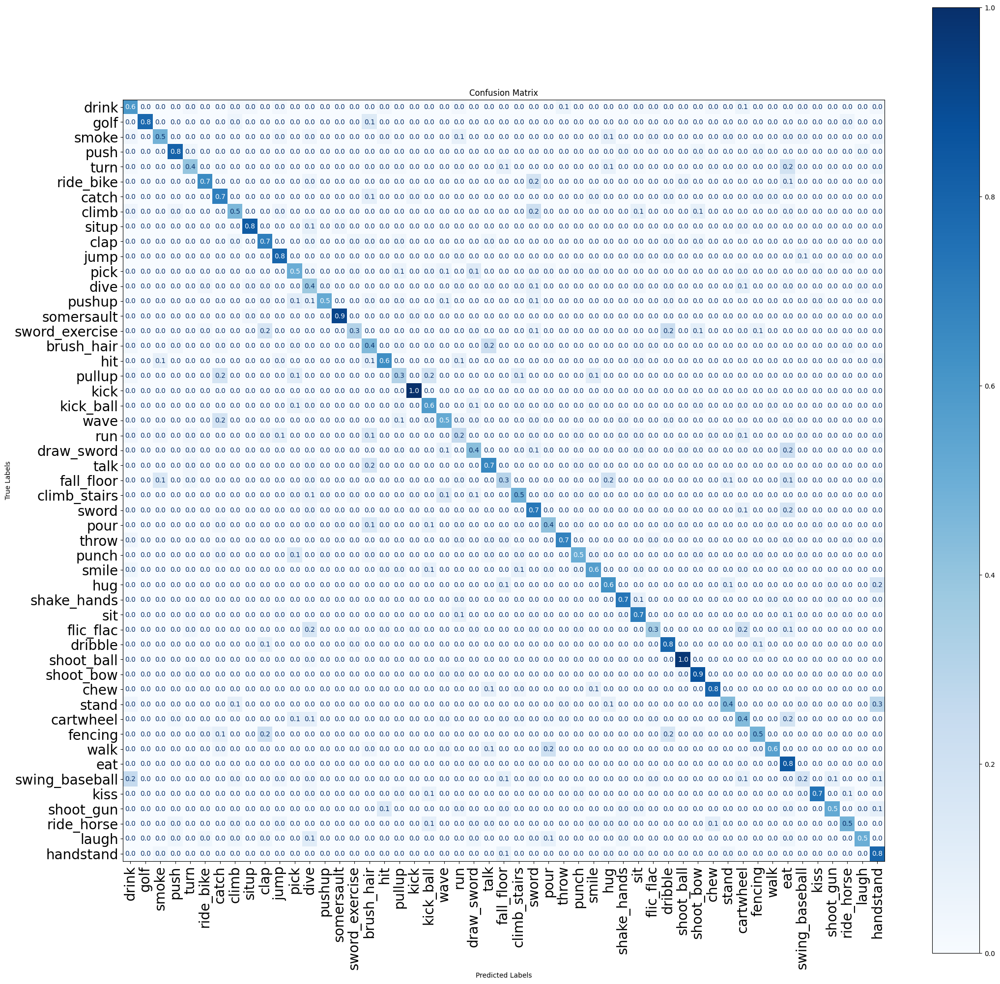

07/23 17:26:19 - mmengine - INFO - Epoch(val) [13][153/153]    acc/top1: 0.5993  acc/top5: 0.8523  acc/mean1: 0.5905  loss/loss: 3.5548  data_time: 4.0006  time: 4.3447
07/23 17:26:20 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_12.pth is removed
07/23 17:26:20 - mmengine - INFO - The best checkpoint with 0.5993 acc/top1 at 13 epoch is saved to best_acc_top1_epoch_13.pth.
07/23 17:29:39 - mmengine - INFO - Epoch(train) [14][ 20/179]  base_lr: 5.8090e-04 lr: 5.8119e-05  eta: 19:49:00  time: 7.6257  data_time: 4.0457  memory: 34294  loss: 0.4985  top1_acc: 0.8500  top5_acc: 0.9500  loss_cls: 0.4985
07/23 17:32:11 - mmengine - INFO - Epoch(train) [14][ 40/179]  base_lr: 5.8090e-04 lr: 5.8119e-05  eta: 19:47:33  time: 7.8242  data_time: 4.2753  memory: 34294  loss: 0.4795  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.4795
07/23 17:33:53 - mmengine - INFO - Epoch(train) [14][ 60/179]  base_lr: 5.8090e-04 lr: 5.8119e-

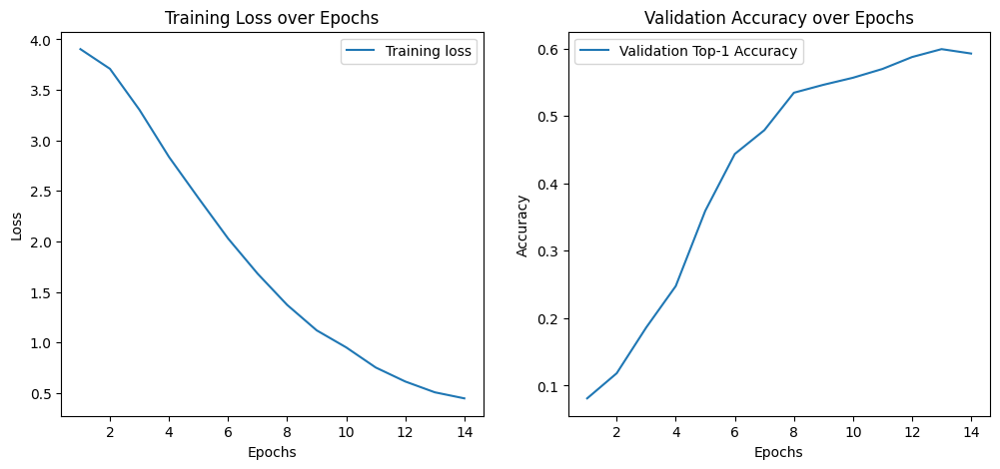

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a3ec8e0>


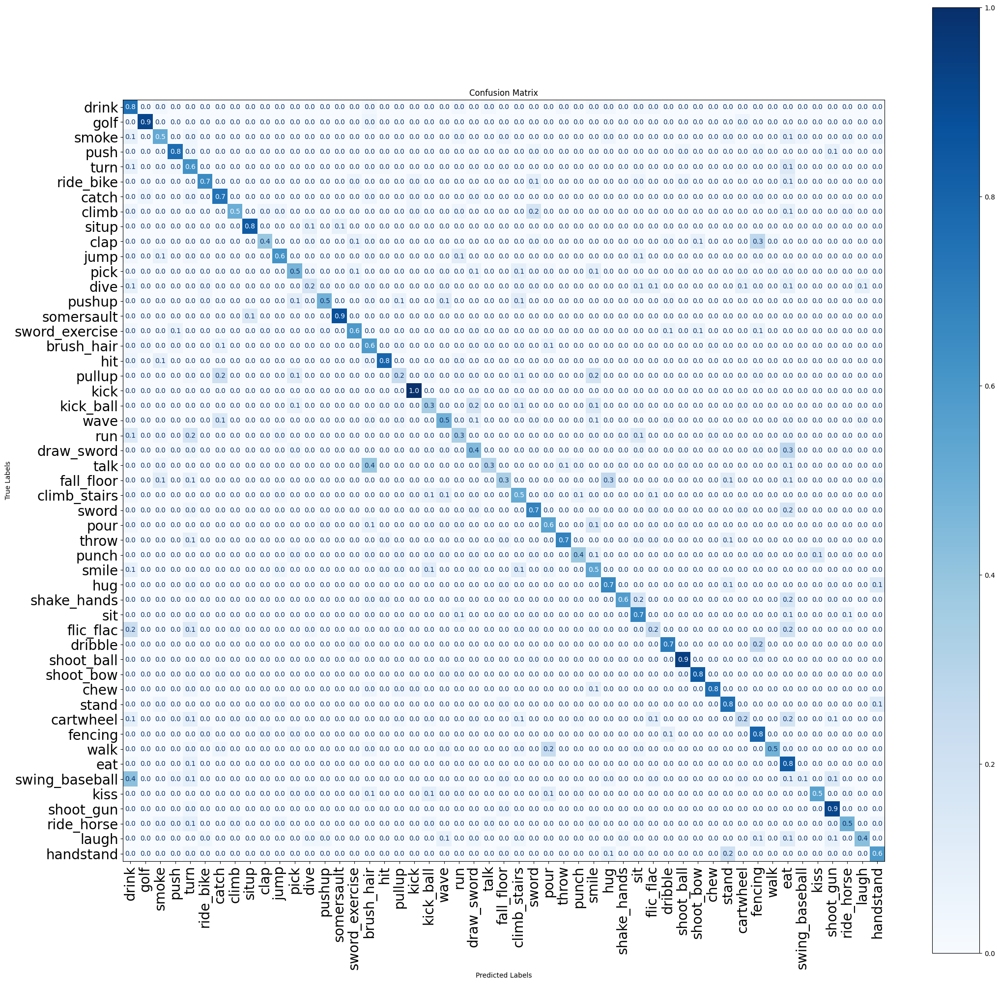

07/23 17:58:50 - mmengine - INFO - Epoch(val) [14][153/153]    acc/top1: 0.5928  acc/top5: 0.8510  acc/mean1: 0.5808  loss/loss: 3.5152  data_time: 3.8858  time: 4.2296
07/23 18:02:19 - mmengine - INFO - Epoch(train) [15][ 20/179]  base_lr: 5.7590e-04 lr: 5.7626e-05  eta: 19:31:21  time: 8.7248  data_time: 5.1723  memory: 34294  loss: 0.4409  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.4409
07/23 18:04:42 - mmengine - INFO - Epoch(train) [15][ 40/179]  base_lr: 5.7590e-04 lr: 5.7626e-05  eta: 19:29:12  time: 7.4738  data_time: 3.8737  memory: 34294  loss: 0.3405  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.3405
07/23 18:06:28 - mmengine - INFO - Epoch(train) [15][ 60/179]  base_lr: 5.7590e-04 lr: 5.7626e-05  eta: 19:24:38  time: 3.5659  data_time: 0.0030  memory: 34294  loss: 0.2589  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.2589
07/23 18:09:05 - mmengine - INFO - Epoch(train) [15][ 80/179]  base_lr: 5.7590e-04 lr: 5.7626e-05  eta: 19:23:20  time: 7.6884  data_time: 4.114

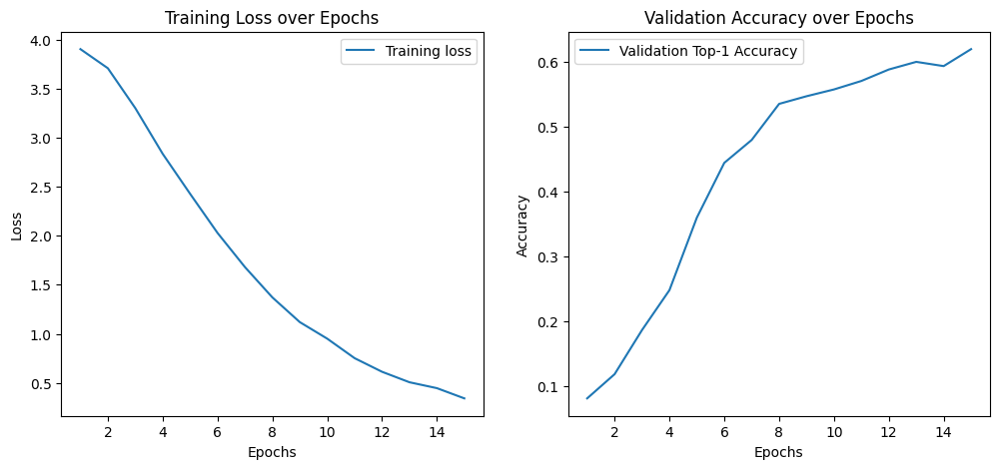

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771939a6a0>


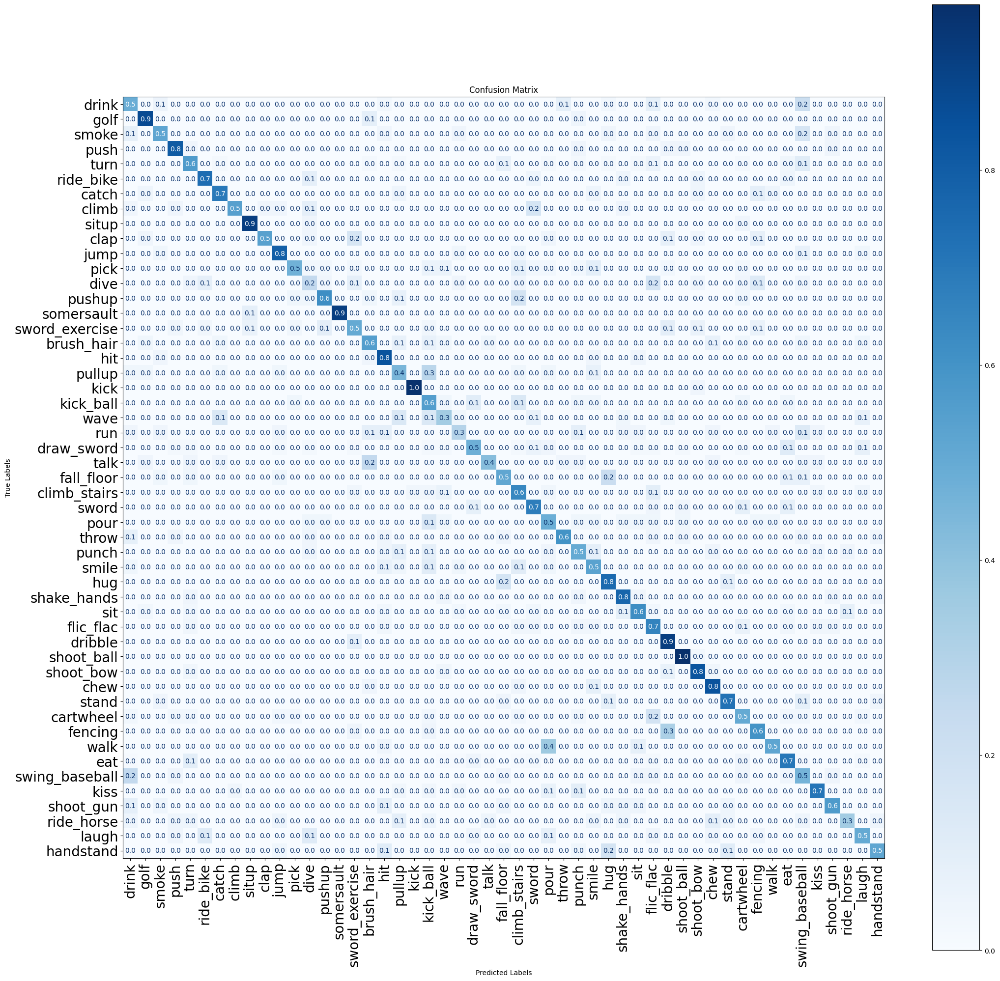

07/23 18:31:31 - mmengine - INFO - Epoch(val) [15][153/153]    acc/top1: 0.6190  acc/top5: 0.8608  acc/mean1: 0.6191  loss/loss: 3.4781  data_time: 3.8969  time: 4.2407
07/23 18:31:31 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_13.pth is removed
07/23 18:31:32 - mmengine - INFO - The best checkpoint with 0.6190 acc/top1 at 15 epoch is saved to best_acc_top1_epoch_15.pth.
07/23 18:34:50 - mmengine - INFO - Epoch(train) [16][ 20/179]  base_lr: 5.7034e-04 lr: 5.7079e-05  eta: 19:12:05  time: 7.1352  data_time: 3.5699  memory: 34294  loss: 0.3095  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.3095
07/23 18:37:07 - mmengine - INFO - Epoch(train) [16][ 40/179]  base_lr: 5.7034e-04 lr: 5.7079e-05  eta: 19:09:28  time: 5.1334  data_time: 1.5090  memory: 34294  loss: 0.2635  top1_acc: 0.8500  top5_acc: 0.9500  loss_cls: 0.2635
07/23 18:39:27 - mmengine - INFO - Epoch(train) [16][ 60/179]  base_lr: 5.7034e-04 lr: 5.7079e-

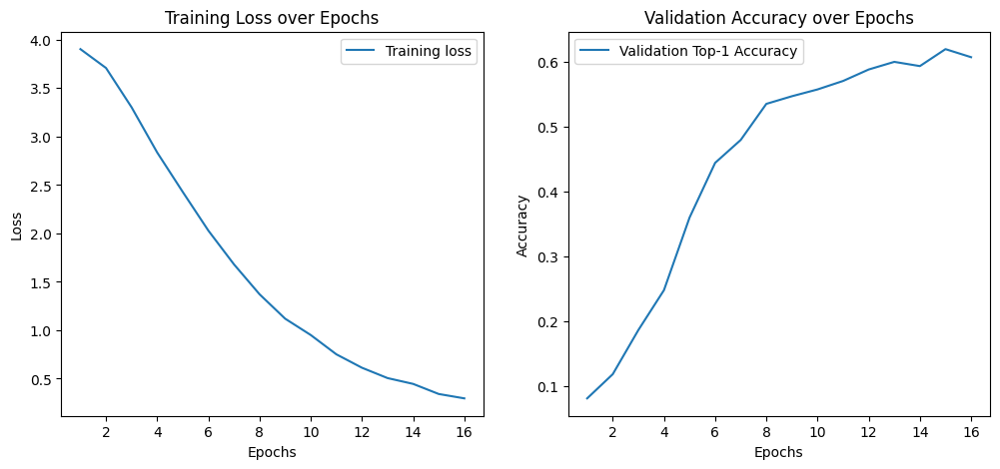

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771e215b20>


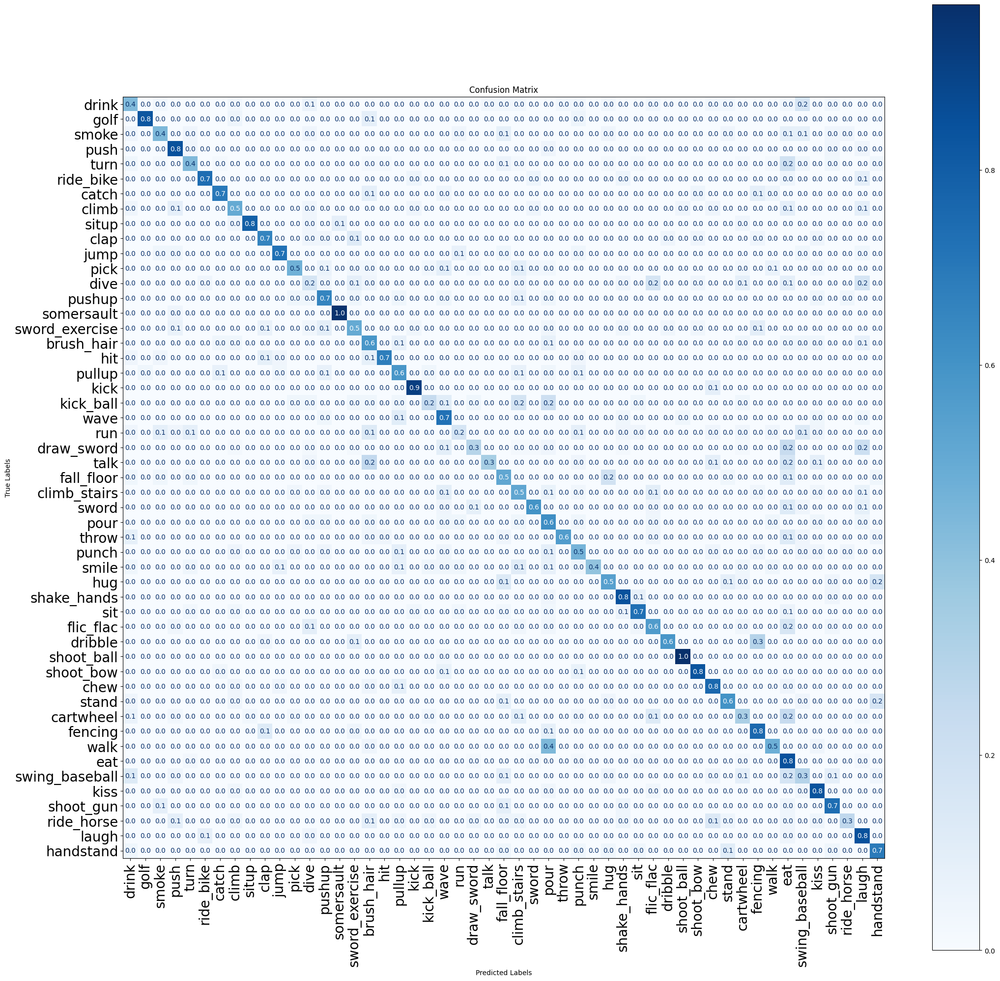

07/23 19:05:26 - mmengine - INFO - Epoch(val) [16][153/153]    acc/top1: 0.6065  acc/top5: 0.8490  acc/mean1: 0.5986  loss/loss: 3.4504  data_time: 4.1851  time: 4.5312
07/23 19:08:44 - mmengine - INFO - Epoch(train) [17][ 20/179]  base_lr: 5.6424e-04 lr: 5.6478e-05  eta: 18:56:08  time: 7.8933  data_time: 4.3327  memory: 34294  loss: 0.3334  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.3334
07/23 19:11:03 - mmengine - INFO - Epoch(train) [17][ 40/179]  base_lr: 5.6424e-04 lr: 5.6478e-05  eta: 18:53:39  time: 6.6351  data_time: 3.0145  memory: 34294  loss: 0.2358  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.2358
07/23 19:13:04 - mmengine - INFO - Epoch(train) [17][ 60/179]  base_lr: 5.6424e-04 lr: 5.6478e-05  eta: 18:50:12  time: 3.9118  data_time: 0.3420  memory: 34294  loss: 0.2062  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.2062
07/23 19:15:40 - mmengine - INFO - Epoch(train) [17][ 80/179]  base_lr: 5.6424e-04 lr: 5.6478e-05  eta: 18:48:39  time: 8.1465  data_time: 4.556

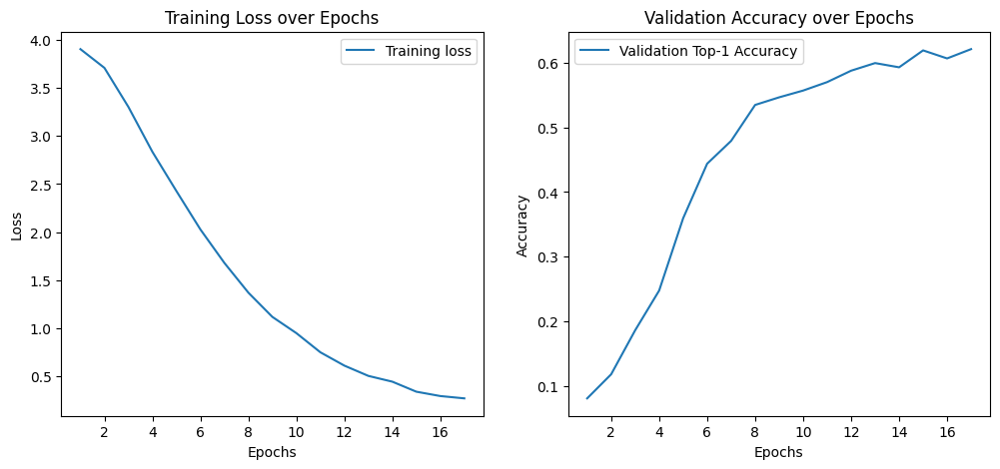

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719595cd0>


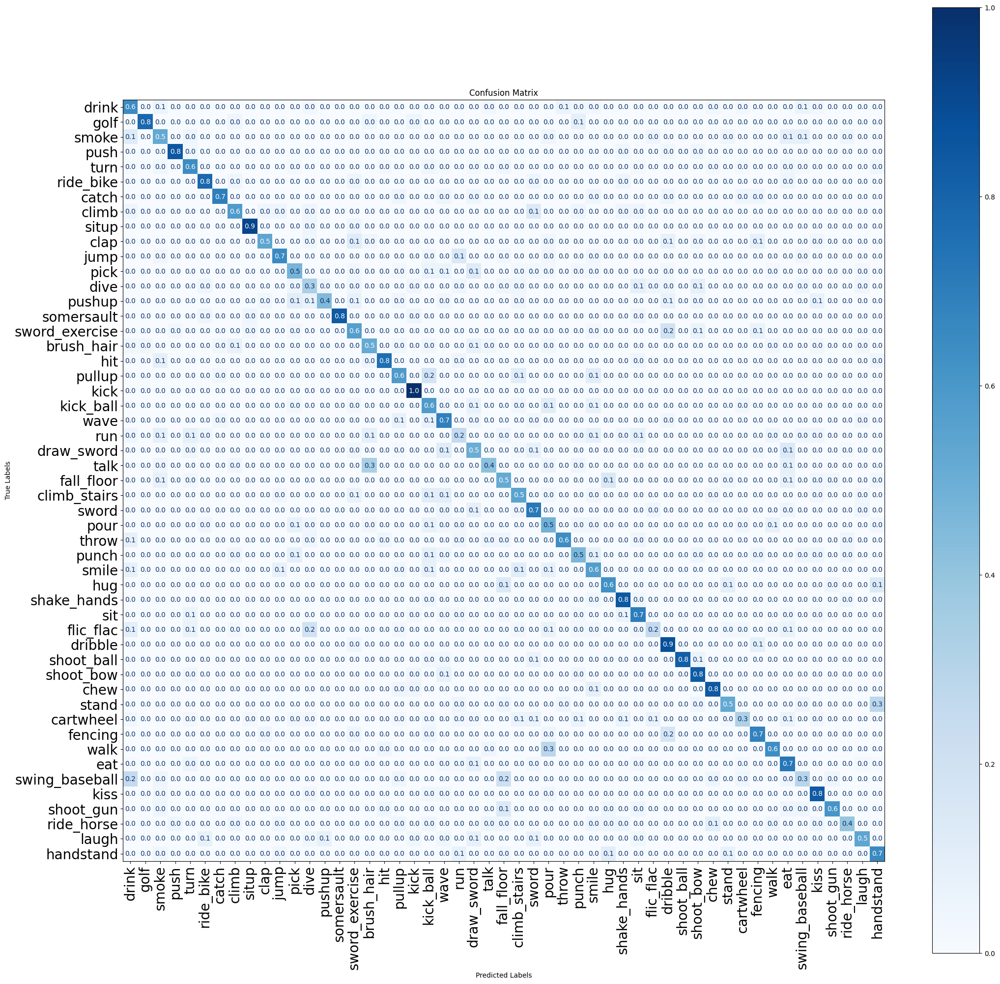

07/23 19:37:54 - mmengine - INFO - Epoch(val) [17][153/153]    acc/top1: 0.6209  acc/top5: 0.8614  acc/mean1: 0.6178  loss/loss: 3.4280  data_time: 3.8088  time: 4.1535
07/23 19:37:54 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_15.pth is removed
07/23 19:37:54 - mmengine - INFO - The best checkpoint with 0.6209 acc/top1 at 17 epoch is saved to best_acc_top1_epoch_17.pth.
07/23 19:41:20 - mmengine - INFO - Epoch(train) [18][ 20/179]  base_lr: 5.5761e-04 lr: 5.5824e-05  eta: 18:37:19  time: 8.1936  data_time: 4.6014  memory: 34294  loss: 0.2696  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.2696
07/23 19:43:40 - mmengine - INFO - Epoch(train) [18][ 40/179]  base_lr: 5.5761e-04 lr: 5.5824e-05  eta: 18:34:53  time: 7.8763  data_time: 4.2513  memory: 34294  loss: 0.2243  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.2243
07/23 19:45:47 - mmengine - INFO - Epoch(train) [18][ 60/179]  base_lr: 5.5761e-04 lr: 5.5824e-

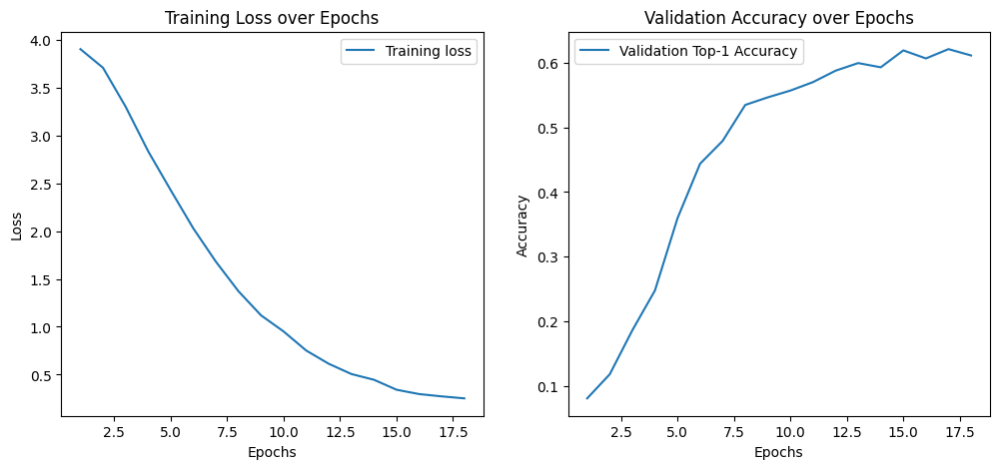

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a7ba250>


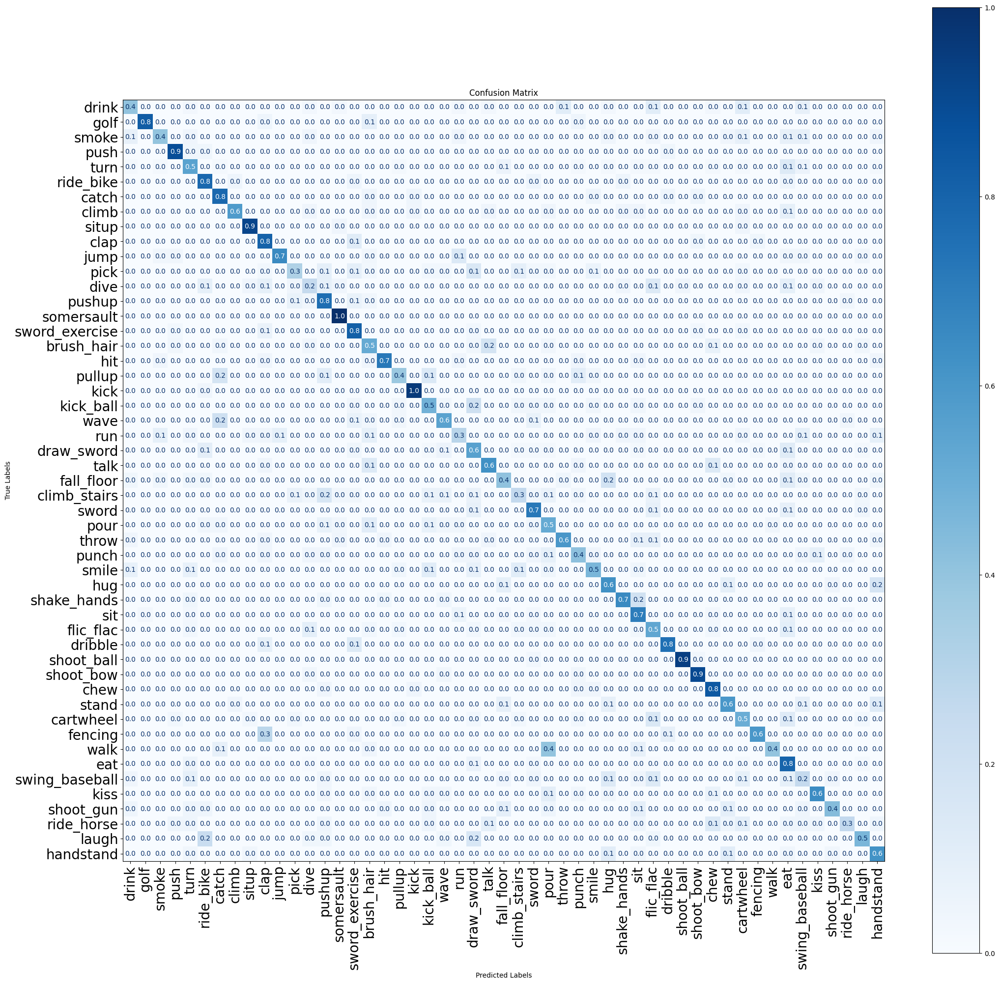

07/23 20:10:29 - mmengine - INFO - Epoch(val) [18][153/153]    acc/top1: 0.6111  acc/top5: 0.8444  acc/mean1: 0.6023  loss/loss: 3.4141  data_time: 4.0084  time: 4.3559
07/23 20:13:53 - mmengine - INFO - Epoch(train) [19][ 20/179]  base_lr: 5.5045e-04 lr: 5.5120e-05  eta: 18:16:35  time: 7.9250  data_time: 4.3467  memory: 34294  loss: 0.1712  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1712
07/23 20:16:31 - mmengine - INFO - Epoch(train) [19][ 40/179]  base_lr: 5.5045e-04 lr: 5.5120e-05  eta: 18:15:00  time: 7.6979  data_time: 4.1085  memory: 34294  loss: 0.1938  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.1938
07/23 20:18:19 - mmengine - INFO - Epoch(train) [19][ 60/179]  base_lr: 5.5045e-04 lr: 5.5120e-05  eta: 18:11:03  time: 3.5851  data_time: 0.0045  memory: 34294  loss: 0.2115  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.2115
07/23 20:20:46 - mmengine - INFO - Epoch(train) [19][ 80/179]  base_lr: 5.5045e-04 lr: 5.5120e-05  eta: 18:08:57  time: 7.2161  data_time: 3.629

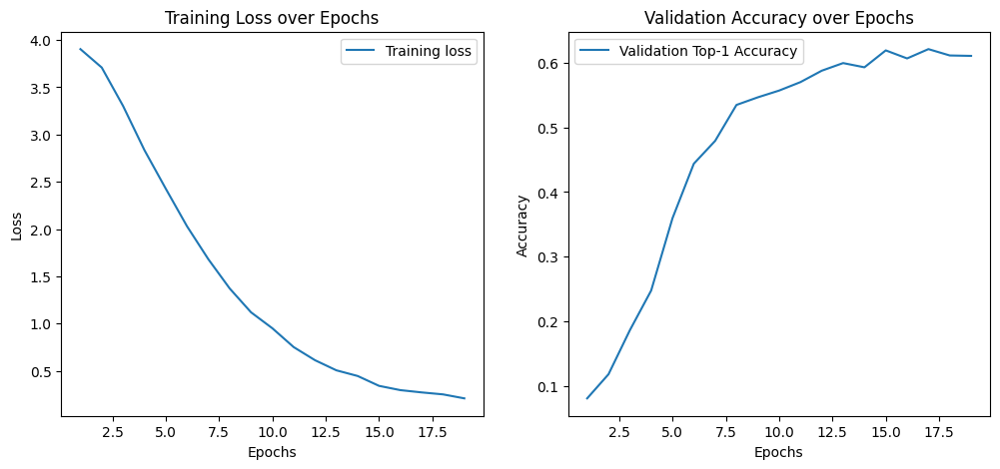

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771adbd7c0>


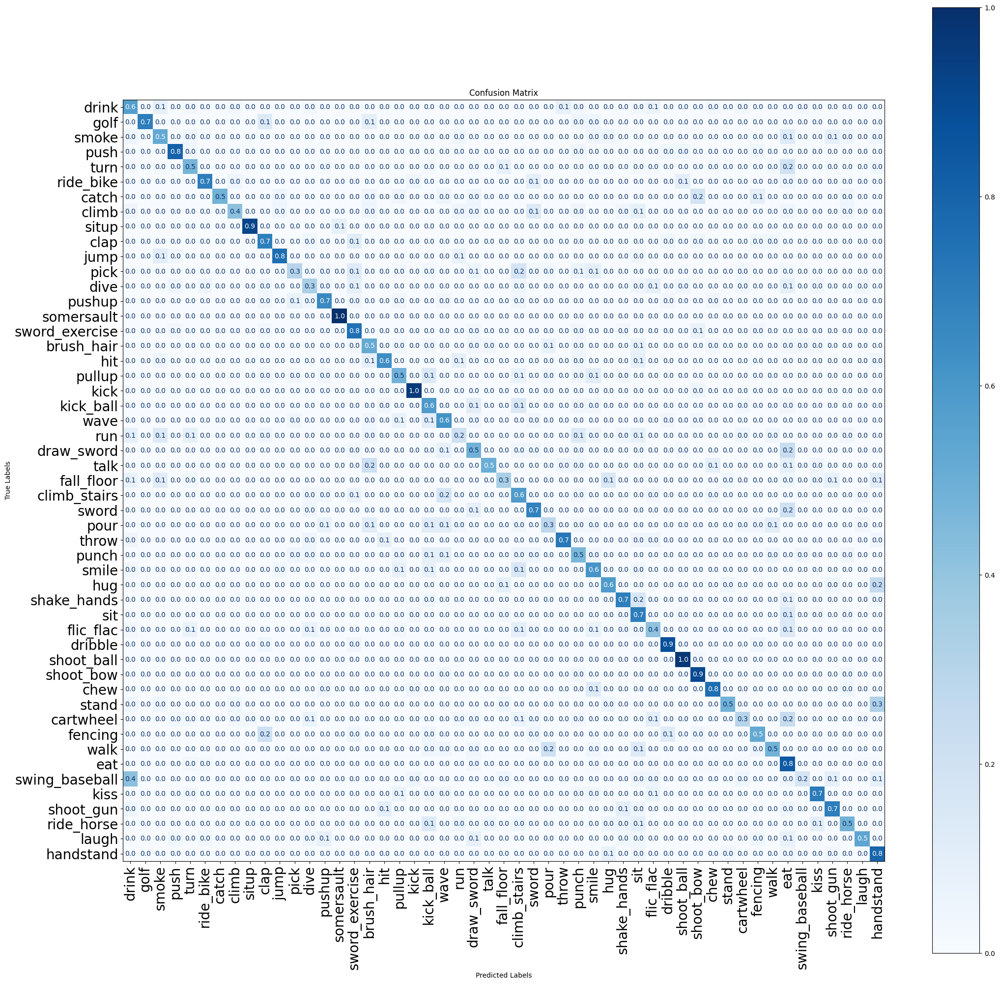

07/23 20:43:29 - mmengine - INFO - Epoch(val) [19][153/153]    acc/top1: 0.6105  acc/top5: 0.8523  acc/mean1: 0.5997  loss/loss: 3.4021  data_time: 4.0400  time: 4.3851
07/23 20:46:35 - mmengine - INFO - Epoch(train) [20][ 20/179]  base_lr: 5.4280e-04 lr: 5.4366e-05  eta: 17:57:01  time: 7.3607  data_time: 3.7808  memory: 34294  loss: 0.1399  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.1399
07/23 20:48:56 - mmengine - INFO - Epoch(train) [20][ 40/179]  base_lr: 5.4280e-04 lr: 5.4366e-05  eta: 17:54:39  time: 6.9844  data_time: 3.3847  memory: 34294  loss: 0.2024  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.2024
07/23 20:50:55 - mmengine - INFO - Epoch(train) [20][ 60/179]  base_lr: 5.4280e-04 lr: 5.4366e-05  eta: 17:51:16  time: 4.8365  data_time: 1.2357  memory: 34294  loss: 0.1940  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.1940
07/23 20:53:28 - mmengine - INFO - Epoch(train) [20][ 80/179]  base_lr: 5.4280e-04 lr: 5.4366e-05  eta: 17:49:23  time: 6.8627  data_time: 3.255

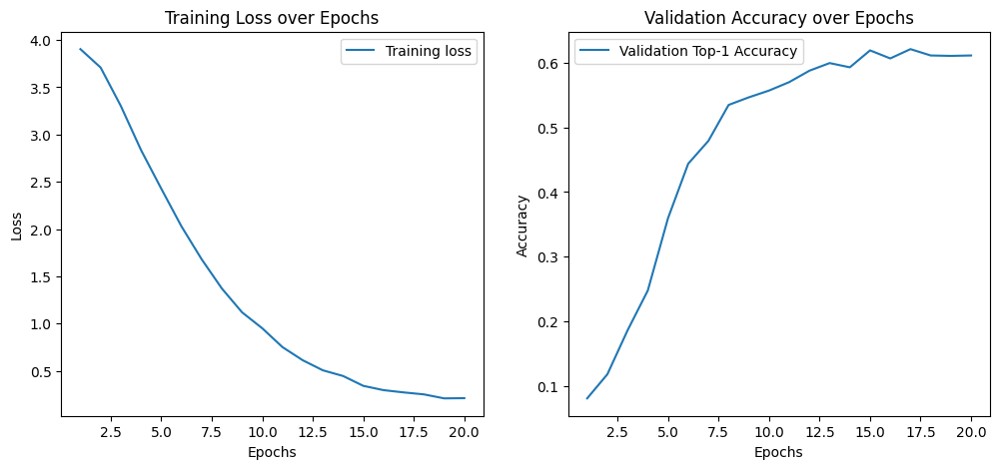

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a154b50>


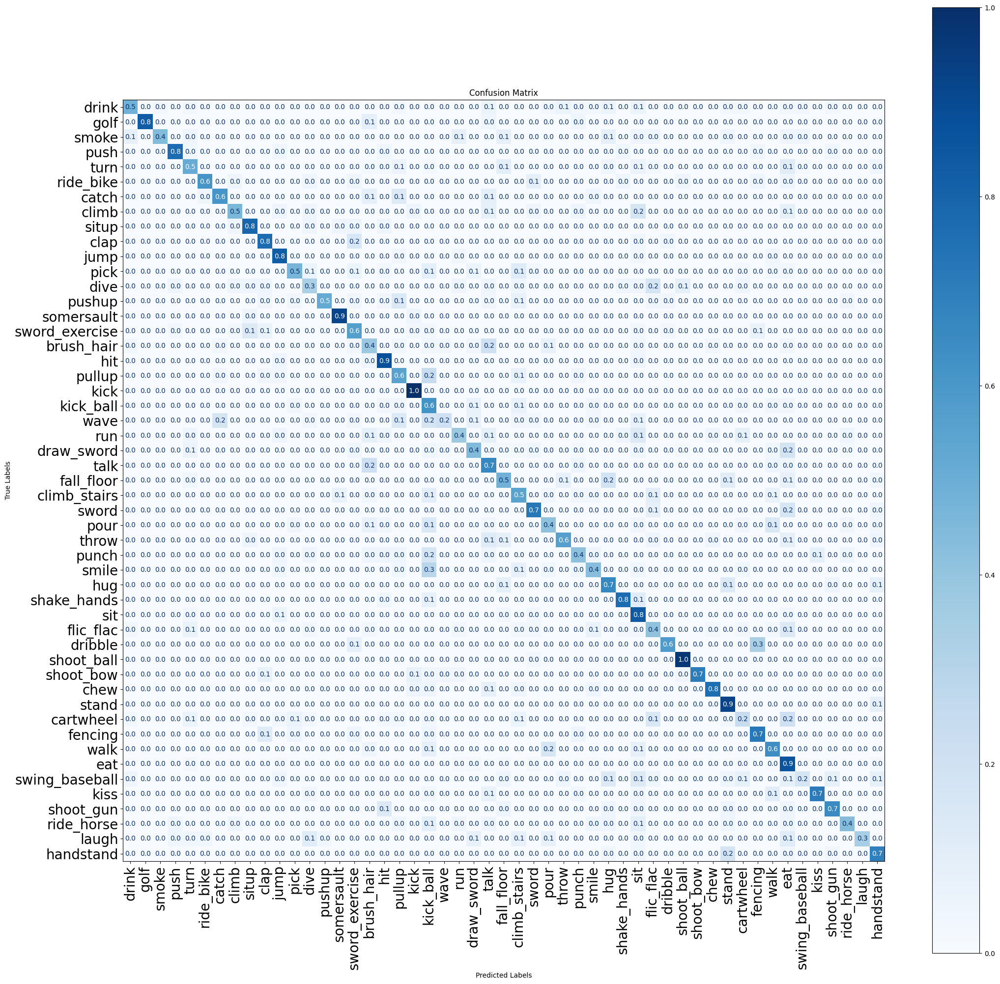

07/23 21:15:50 - mmengine - INFO - Epoch(val) [20][153/153]    acc/top1: 0.6111  acc/top5: 0.8575  acc/mean1: 0.6011  loss/loss: 3.3922  data_time: 3.9982  time: 4.3411
07/23 21:19:00 - mmengine - INFO - Epoch(train) [21][ 20/179]  base_lr: 5.3466e-04 lr: 5.3564e-05  eta: 17:35:51  time: 7.4585  data_time: 3.9019  memory: 34294  loss: 0.2487  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.2487
07/23 21:21:31 - mmengine - INFO - Epoch(train) [21][ 40/179]  base_lr: 5.3466e-04 lr: 5.3564e-05  eta: 17:33:52  time: 6.2651  data_time: 2.6882  memory: 34294  loss: 0.1614  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.1614
07/23 21:23:31 - mmengine - INFO - Epoch(train) [21][ 60/179]  base_lr: 5.3466e-04 lr: 5.3564e-05  eta: 17:30:36  time: 3.9627  data_time: 0.3077  memory: 34294  loss: 0.1303  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1303
07/23 21:25:56 - mmengine - INFO - Epoch(train) [21][ 80/179]  base_lr: 5.3466e-04 lr: 5.3564e-05  eta: 17:28:21  time: 7.0620  data_time: 3.454

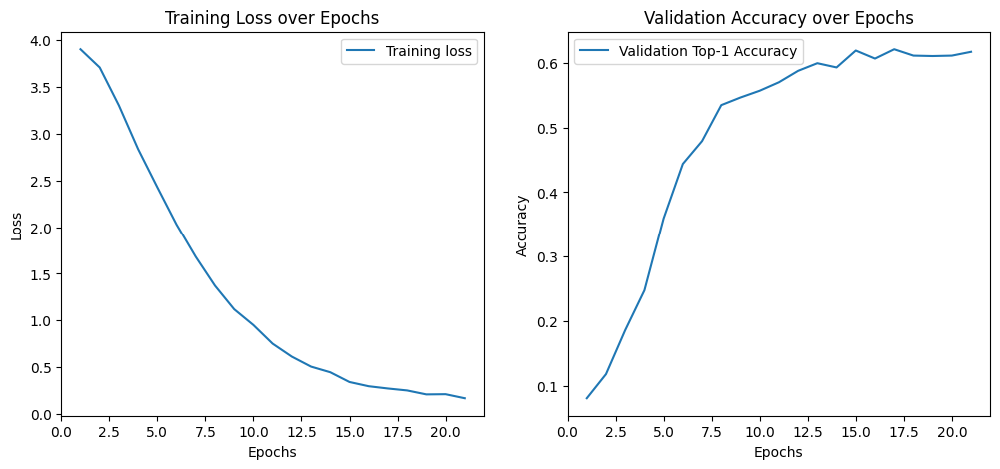

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719170e80>


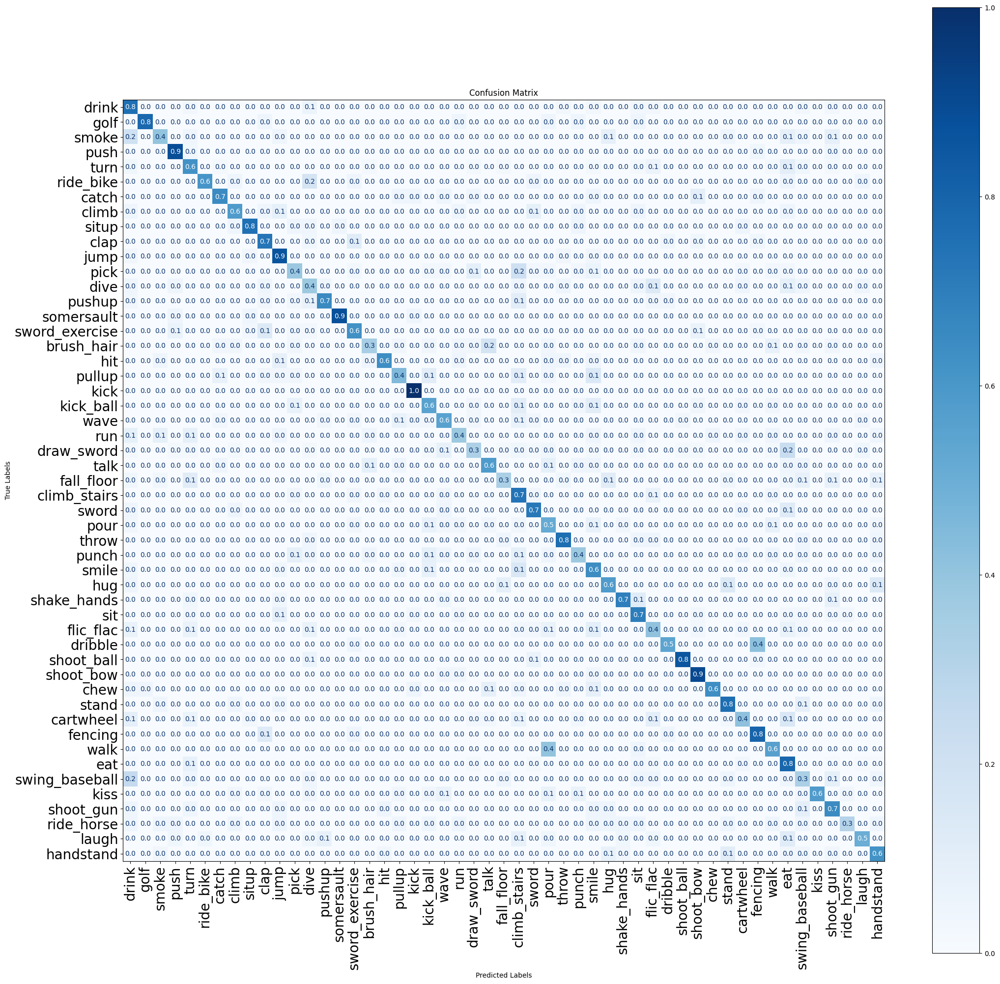

07/23 21:48:23 - mmengine - INFO - Epoch(val) [21][153/153]    acc/top1: 0.6170  acc/top5: 0.8529  acc/mean1: 0.6095  loss/loss: 3.3841  data_time: 3.9461  time: 4.2915
07/23 21:51:40 - mmengine - INFO - Epoch(train) [22][ 20/179]  base_lr: 5.2604e-04 lr: 5.2716e-05  eta: 17:15:25  time: 7.4865  data_time: 3.9094  memory: 34294  loss: 0.1397  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.1397
07/23 21:54:34 - mmengine - INFO - Epoch(train) [22][ 40/179]  base_lr: 5.2604e-04 lr: 5.2716e-05  eta: 17:14:18  time: 9.0782  data_time: 5.4823  memory: 34294  loss: 0.1255  top1_acc: 0.9500  top5_acc: 0.9500  loss_cls: 0.1255
07/23 21:56:31 - mmengine - INFO - Epoch(train) [22][ 60/179]  base_lr: 5.2604e-04 lr: 5.2716e-05  eta: 17:10:57  time: 7.2339  data_time: 3.6390  memory: 34294  loss: 0.1556  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1556
07/23 21:59:11 - mmengine - INFO - Epoch(train) [22][ 80/179]  base_lr: 5.2604e-04 lr: 5.2716e-05  eta: 17:09:16  time: 8.0432  data_time: 4.438

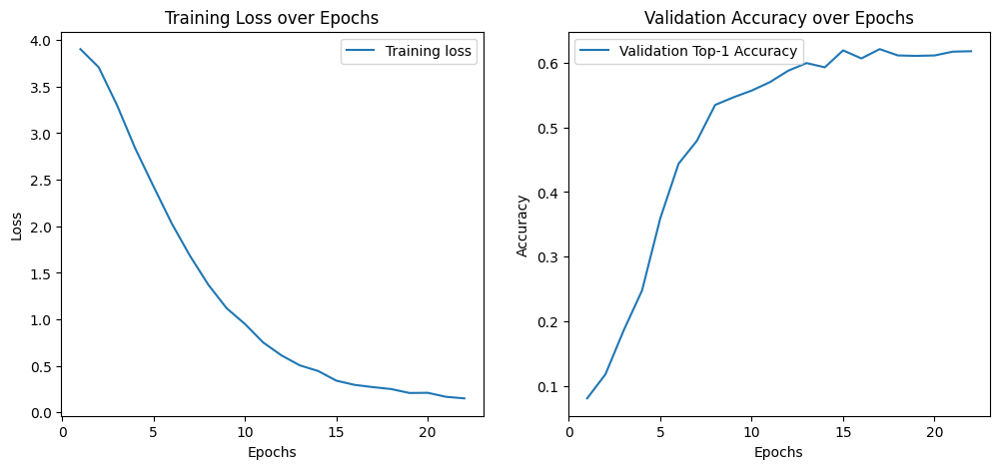

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771946fac0>


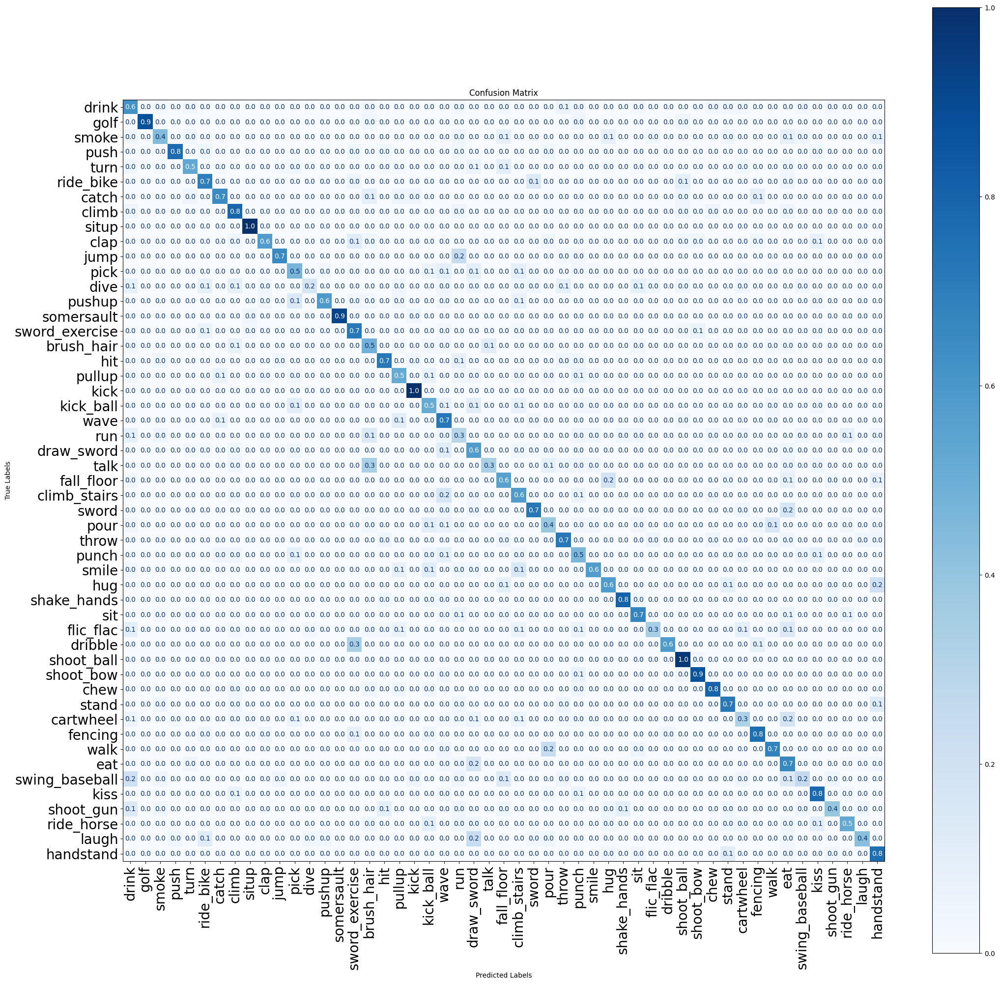

07/23 22:21:21 - mmengine - INFO - Epoch(val) [22][153/153]    acc/top1: 0.6176  acc/top5: 0.8549  acc/mean1: 0.6177  loss/loss: 3.3787  data_time: 4.0169  time: 4.3626
07/23 22:24:40 - mmengine - INFO - Epoch(train) [23][ 20/179]  base_lr: 5.1698e-04 lr: 5.1822e-05  eta: 16:55:25  time: 7.7500  data_time: 4.1939  memory: 34294  loss: 0.1174  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1174
07/23 22:27:00 - mmengine - INFO - Epoch(train) [23][ 40/179]  base_lr: 5.1698e-04 lr: 5.1822e-05  eta: 16:52:57  time: 6.1283  data_time: 2.5455  memory: 34294  loss: 0.1088  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.1088
07/23 22:28:49 - mmengine - INFO - Epoch(train) [23][ 60/179]  base_lr: 5.1698e-04 lr: 5.1822e-05  eta: 16:49:24  time: 3.5930  data_time: 0.0053  memory: 34294  loss: 0.1543  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1543
07/23 22:29:39 - mmengine - INFO - Exp name: 20240723_102956
07/23 22:31:34 - mmengine - INFO - Epoch(train) [23][ 80/179]  base_lr: 5.1698e-04 

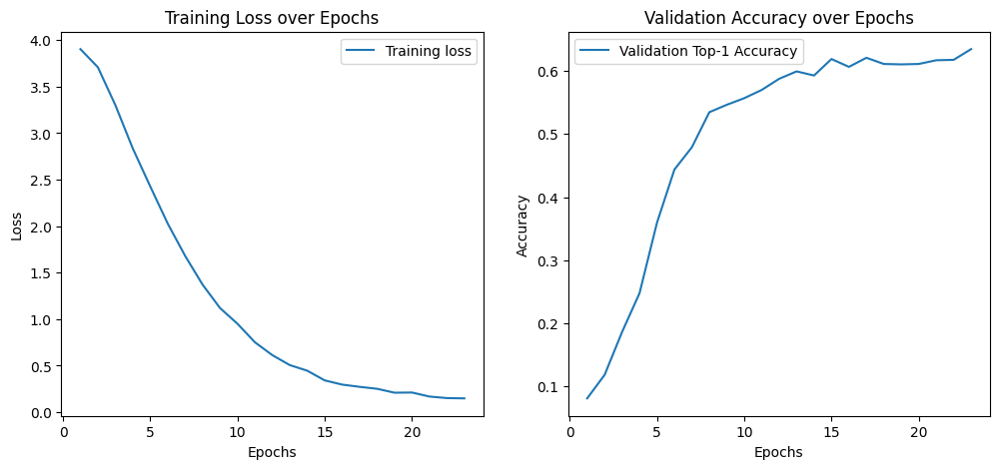

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a3a3c40>


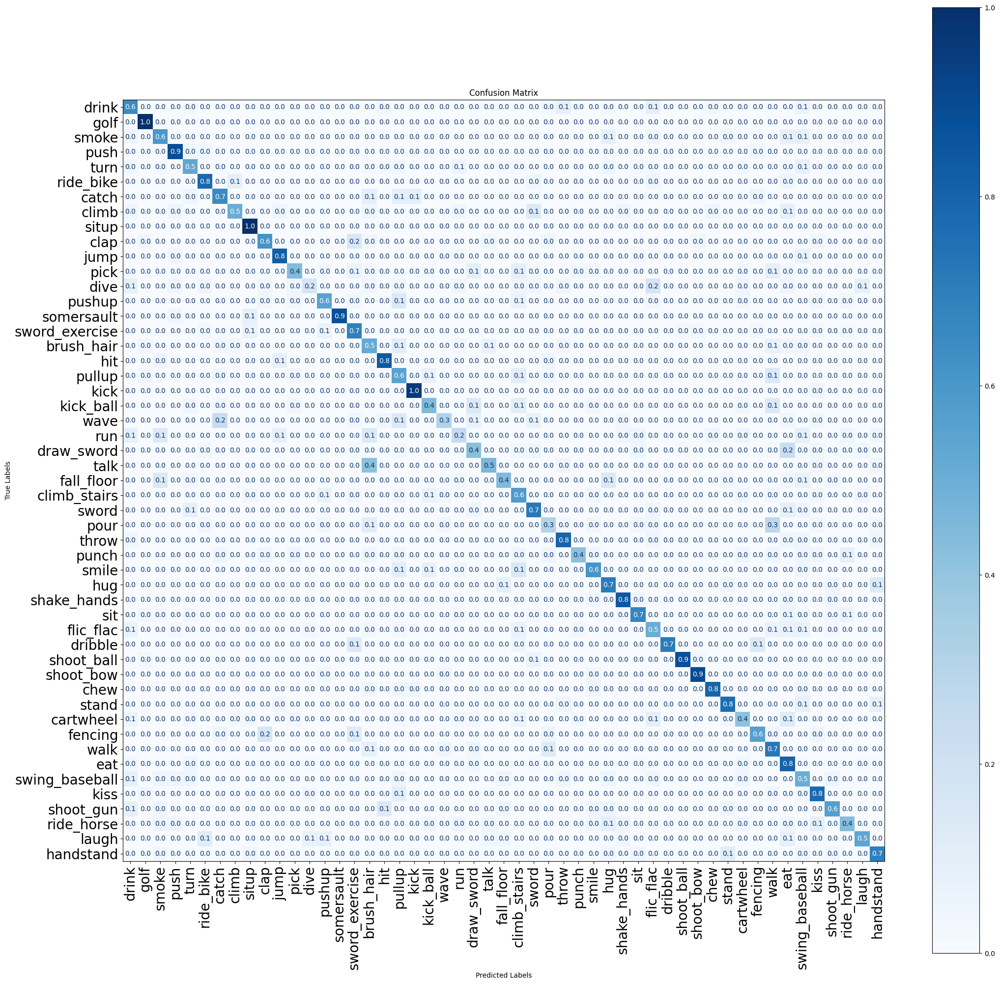

07/23 22:53:56 - mmengine - INFO - Epoch(val) [23][153/153]    acc/top1: 0.6346  acc/top5: 0.8588  acc/mean1: 0.6309  loss/loss: 3.3724  data_time: 4.0567  time: 4.4013
07/23 22:53:56 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_17.pth is removed
07/23 22:53:57 - mmengine - INFO - The best checkpoint with 0.6346 acc/top1 at 23 epoch is saved to best_acc_top1_epoch_23.pth.
07/23 22:57:27 - mmengine - INFO - Epoch(train) [24][ 20/179]  base_lr: 5.0747e-04 lr: 5.0886e-05  eta: 16:34:31  time: 7.9586  data_time: 4.3611  memory: 34294  loss: 0.0992  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0992
07/23 22:59:54 - mmengine - INFO - Epoch(train) [24][ 40/179]  base_lr: 5.0747e-04 lr: 5.0886e-05  eta: 16:32:17  time: 7.0206  data_time: 3.4556  memory: 34294  loss: 0.1021  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.1021
07/23 23:01:42 - mmengine - INFO - Epoch(train) [24][ 60/179]  base_lr: 5.0747e-04 lr: 5.0886e-

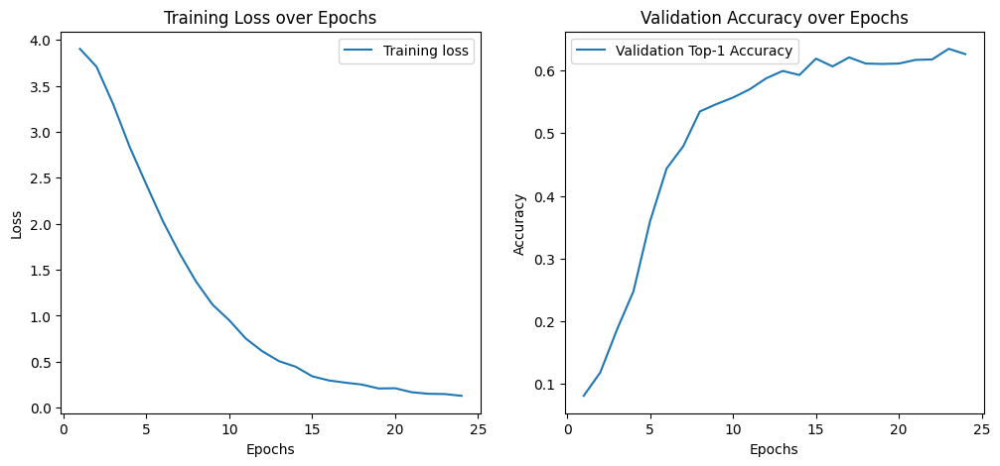

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a663430>


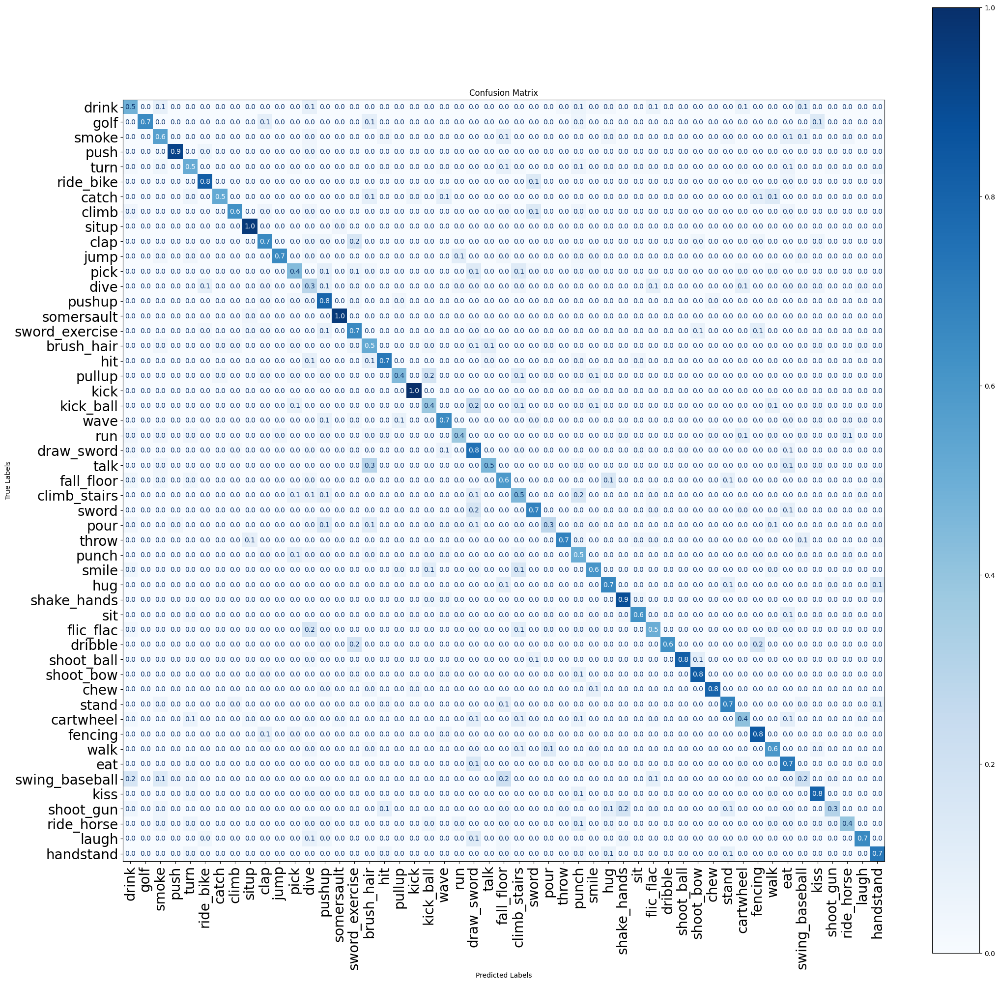

07/23 23:26:21 - mmengine - INFO - Epoch(val) [24][153/153]    acc/top1: 0.6261  acc/top5: 0.8562  acc/mean1: 0.6215  loss/loss: 3.3674  data_time: 4.0752  time: 4.4203
07/23 23:29:43 - mmengine - INFO - Epoch(train) [25][ 20/179]  base_lr: 4.9755e-04 lr: 4.9909e-05  eta: 16:12:28  time: 8.7437  data_time: 5.0682  memory: 34294  loss: 0.0910  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0910
07/23 23:32:10 - mmengine - INFO - Epoch(train) [25][ 40/179]  base_lr: 4.9755e-04 lr: 4.9909e-05  eta: 16:10:14  time: 7.2369  data_time: 3.5469  memory: 34294  loss: 0.1570  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.1570
07/23 23:33:53 - mmengine - INFO - Epoch(train) [25][ 60/179]  base_lr: 4.9755e-04 lr: 4.9909e-05  eta: 16:06:40  time: 3.6171  data_time: 0.0096  memory: 34294  loss: 0.1056  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.1056
07/23 23:36:22 - mmengine - INFO - Epoch(train) [25][ 80/179]  base_lr: 4.9755e-04 lr: 4.9909e-05  eta: 16:04:31  time: 6.8484  data_time: 3.286

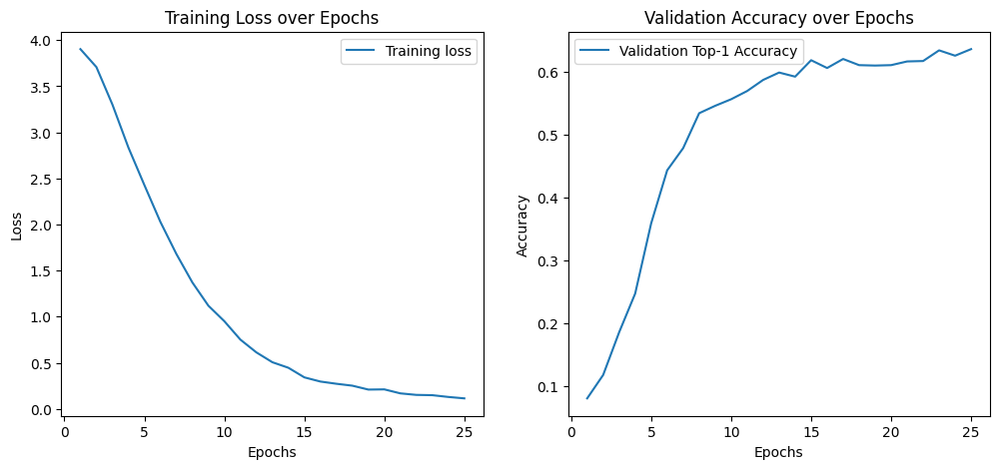

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77187bba90>


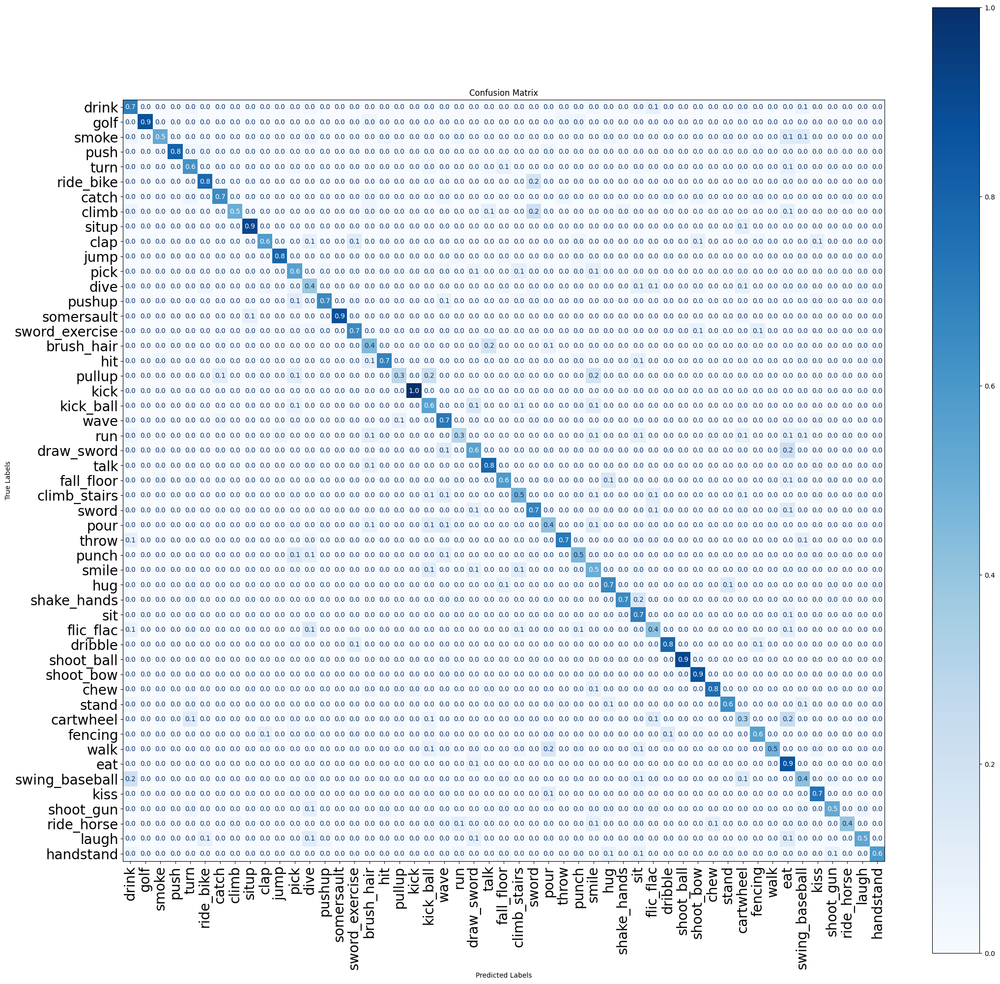

07/23 23:59:03 - mmengine - INFO - Epoch(val) [25][153/153]    acc/top1: 0.6366  acc/top5: 0.8601  acc/mean1: 0.6240  loss/loss: 3.3644  data_time: 4.1453  time: 4.4911
07/23 23:59:03 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_23.pth is removed
07/23 23:59:03 - mmengine - INFO - The best checkpoint with 0.6366 acc/top1 at 25 epoch is saved to best_acc_top1_epoch_25.pth.
07/24 00:02:27 - mmengine - INFO - Epoch(train) [26][ 20/179]  base_lr: 4.8724e-04 lr: 4.8893e-05  eta: 15:51:54  time: 8.7338  data_time: 5.1242  memory: 34294  loss: 0.0778  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0778
07/24 00:05:03 - mmengine - INFO - Epoch(train) [26][ 40/179]  base_lr: 4.8724e-04 lr: 4.8893e-05  eta: 15:49:56  time: 8.4734  data_time: 4.8906  memory: 34294  loss: 0.0846  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0846
07/24 00:06:42 - mmengine - INFO - Epoch(train) [26][ 60/179]  base_lr: 4.8724e-04 lr: 4.8893e-

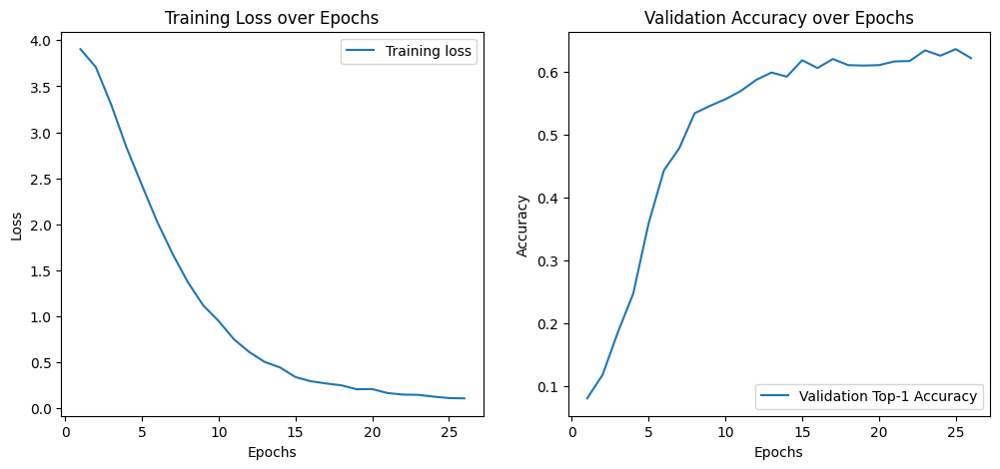

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a3f69a0>


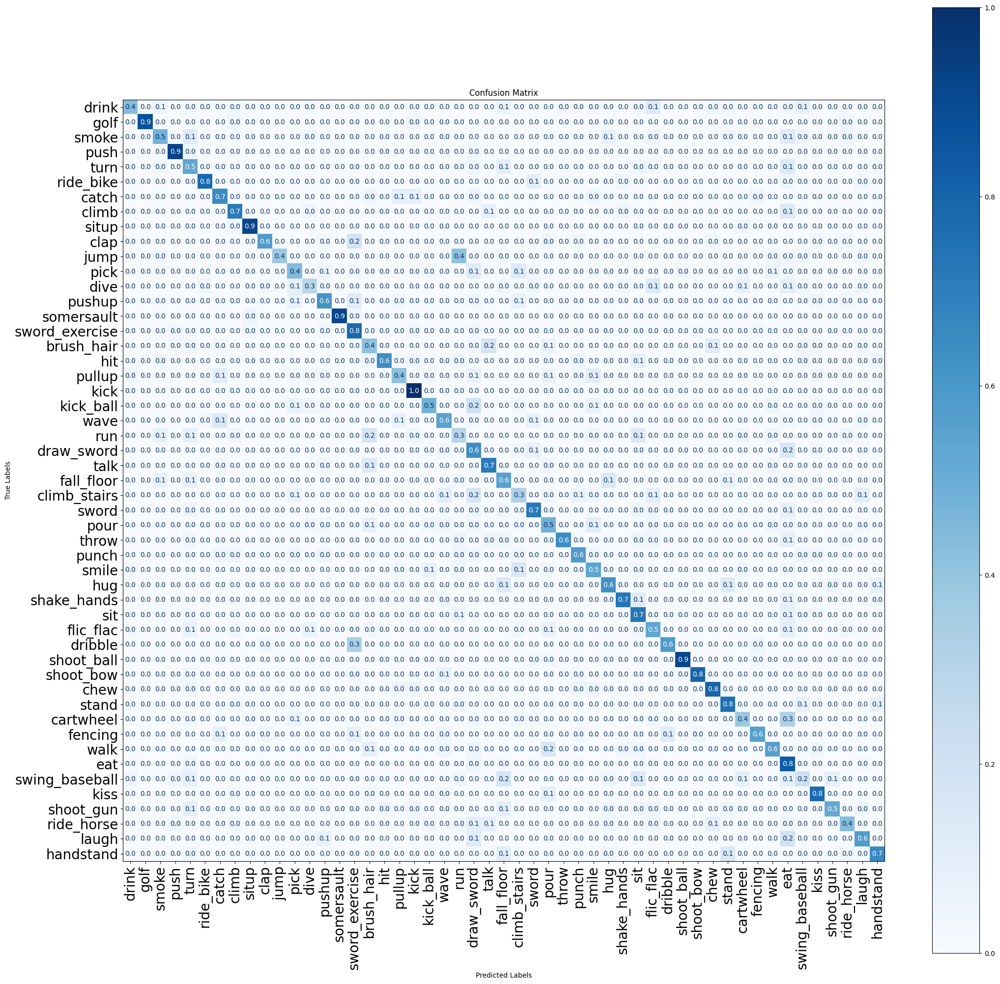

07/24 00:31:15 - mmengine - INFO - Epoch(val) [26][153/153]    acc/top1: 0.6222  acc/top5: 0.8601  acc/mean1: 0.6128  loss/loss: 3.3616  data_time: 3.9789  time: 4.3243
07/24 00:34:38 - mmengine - INFO - Epoch(train) [27][ 20/179]  base_lr: 4.7654e-04 lr: 4.7840e-05  eta: 15:30:20  time: 8.5680  data_time: 4.9985  memory: 34294  loss: 0.0626  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0626
07/24 00:37:24 - mmengine - INFO - Epoch(train) [27][ 40/179]  base_lr: 4.7654e-04 lr: 4.7840e-05  eta: 15:28:37  time: 9.7062  data_time: 6.0757  memory: 34294  loss: 0.0332  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0332
07/24 00:39:26 - mmengine - INFO - Epoch(train) [27][ 60/179]  base_lr: 4.7654e-04 lr: 4.7840e-05  eta: 15:25:42  time: 3.5913  data_time: 0.0052  memory: 34294  loss: 0.1161  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1161
07/24 00:41:39 - mmengine - INFO - Epoch(train) [27][ 80/179]  base_lr: 4.7654e-04 lr: 4.7840e-05  eta: 15:23:05  time: 7.1461  data_time: 3.563

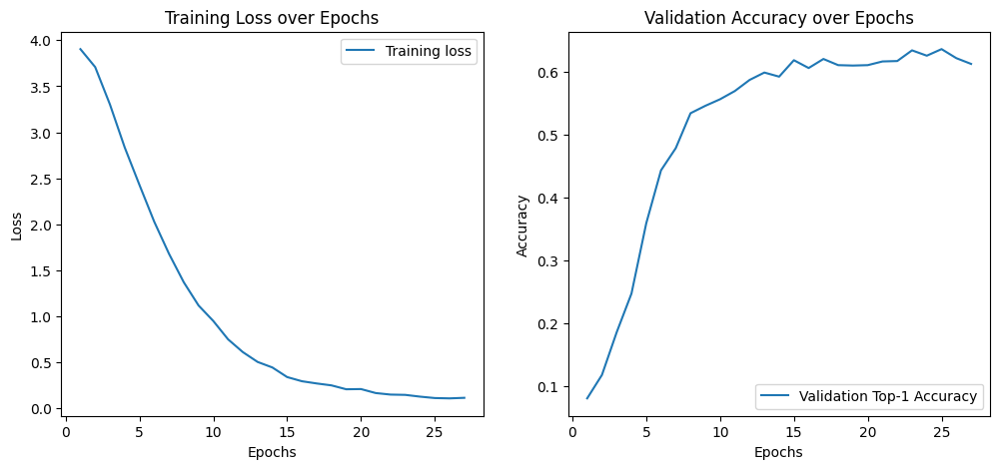

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719621d00>


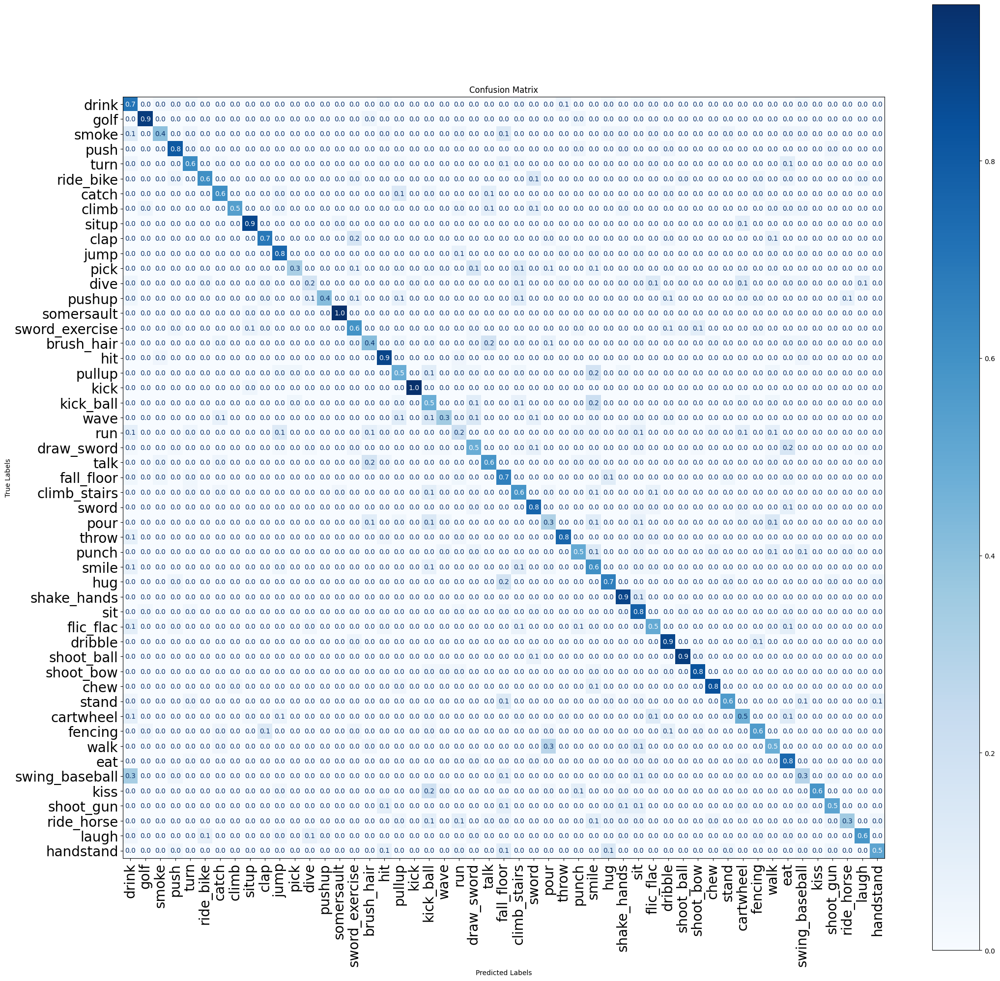

07/24 01:03:59 - mmengine - INFO - Epoch(val) [27][153/153]    acc/top1: 0.6131  acc/top5: 0.8503  acc/mean1: 0.6070  loss/loss: 3.3609  data_time: 3.9274  time: 4.2723
07/24 01:07:10 - mmengine - INFO - Epoch(train) [28][ 20/179]  base_lr: 4.6549e-04 lr: 4.6751e-05  eta: 15:09:27  time: 6.4942  data_time: 2.9188  memory: 34294  loss: 0.1730  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.1730
07/24 01:09:38 - mmengine - INFO - Epoch(train) [28][ 40/179]  base_lr: 4.6549e-04 lr: 4.6751e-05  eta: 15:07:14  time: 7.0086  data_time: 3.4128  memory: 34294  loss: 0.1525  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1525
07/24 01:11:33 - mmengine - INFO - Epoch(train) [28][ 60/179]  base_lr: 4.6549e-04 lr: 4.6751e-05  eta: 15:04:09  time: 4.6674  data_time: 1.0307  memory: 34294  loss: 0.1492  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1492
07/24 01:14:04 - mmengine - INFO - Epoch(train) [28][ 80/179]  base_lr: 4.6549e-04 lr: 4.6751e-05  eta: 15:02:01  time: 6.8901  data_time: 3.277

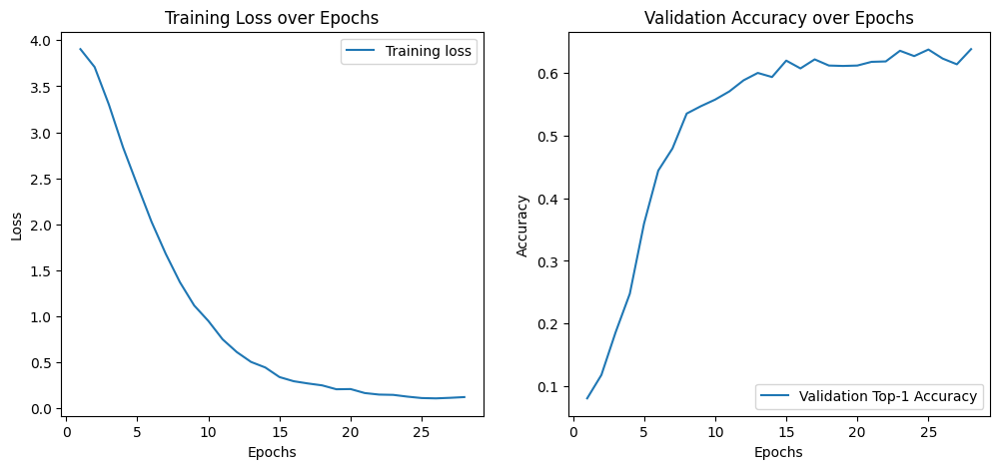

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77196186a0>


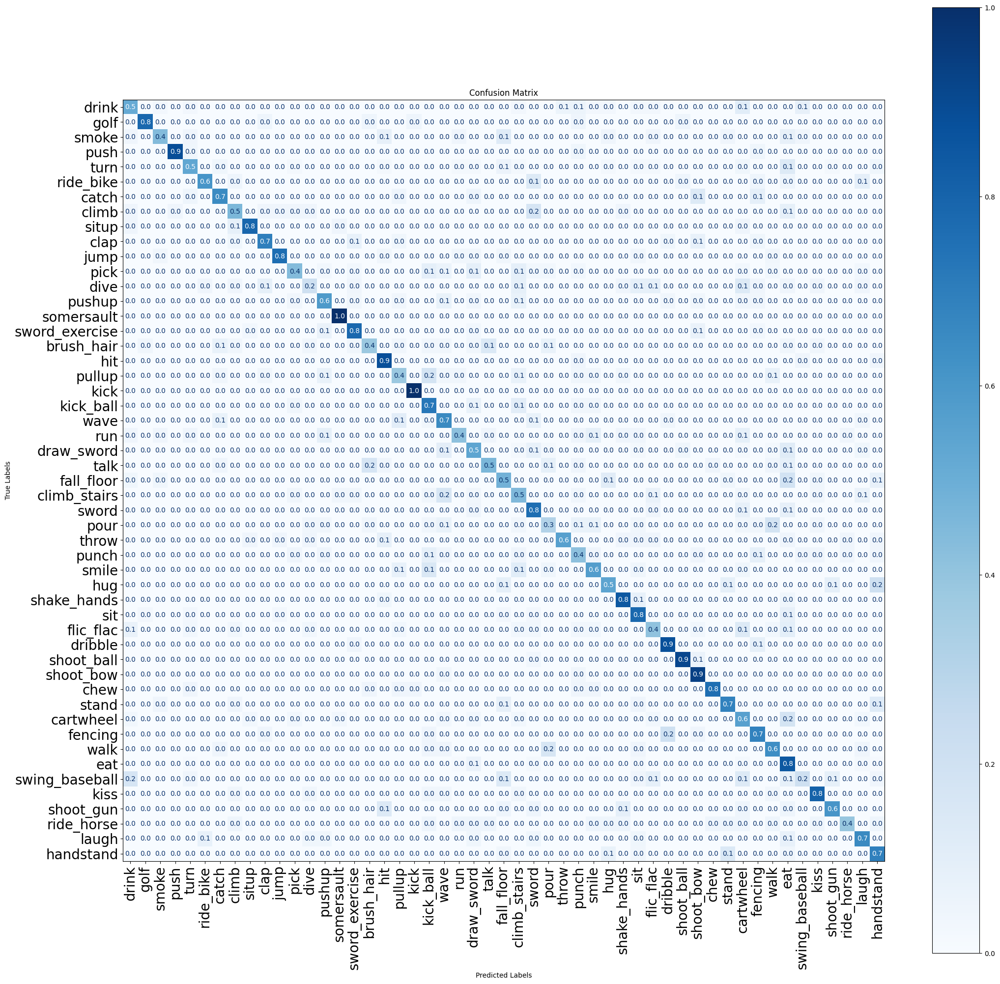

07/24 01:36:28 - mmengine - INFO - Epoch(val) [28][153/153]    acc/top1: 0.6373  acc/top5: 0.8588  acc/mean1: 0.6261  loss/loss: 3.3568  data_time: 4.0646  time: 4.4106
07/24 01:36:28 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_25.pth is removed
07/24 01:36:29 - mmengine - INFO - The best checkpoint with 0.6373 acc/top1 at 28 epoch is saved to best_acc_top1_epoch_28.pth.
07/24 01:40:03 - mmengine - INFO - Epoch(train) [29][ 20/179]  base_lr: 4.5411e-04 lr: 4.5631e-05  eta: 14:48:52  time: 8.2291  data_time: 4.6459  memory: 34294  loss: 0.0873  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0873
07/24 01:42:11 - mmengine - INFO - Epoch(train) [29][ 40/179]  base_lr: 4.5411e-04 lr: 4.5631e-05  eta: 14:46:09  time: 6.2773  data_time: 2.6848  memory: 34294  loss: 0.0773  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0773
07/24 01:44:18 - mmengine - INFO - Epoch(train) [29][ 60/179]  base_lr: 4.5411e-04 lr: 4.5631e-

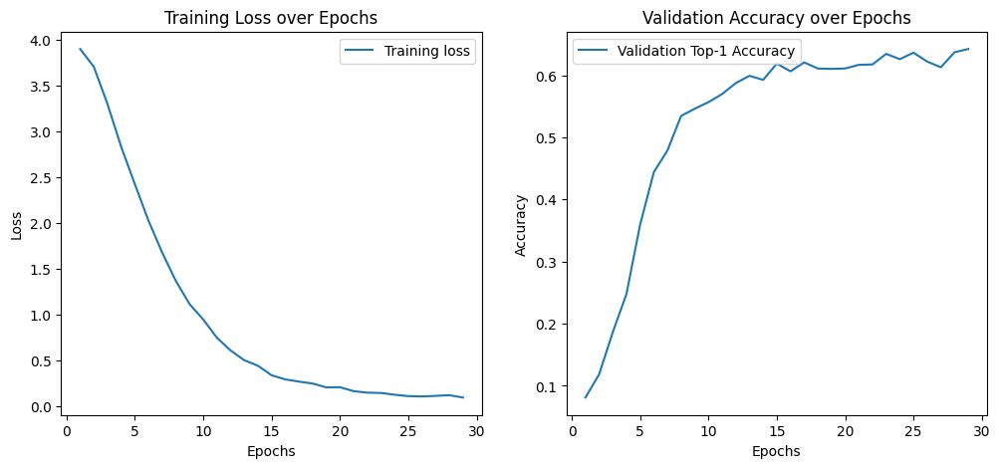

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771ac6f370>


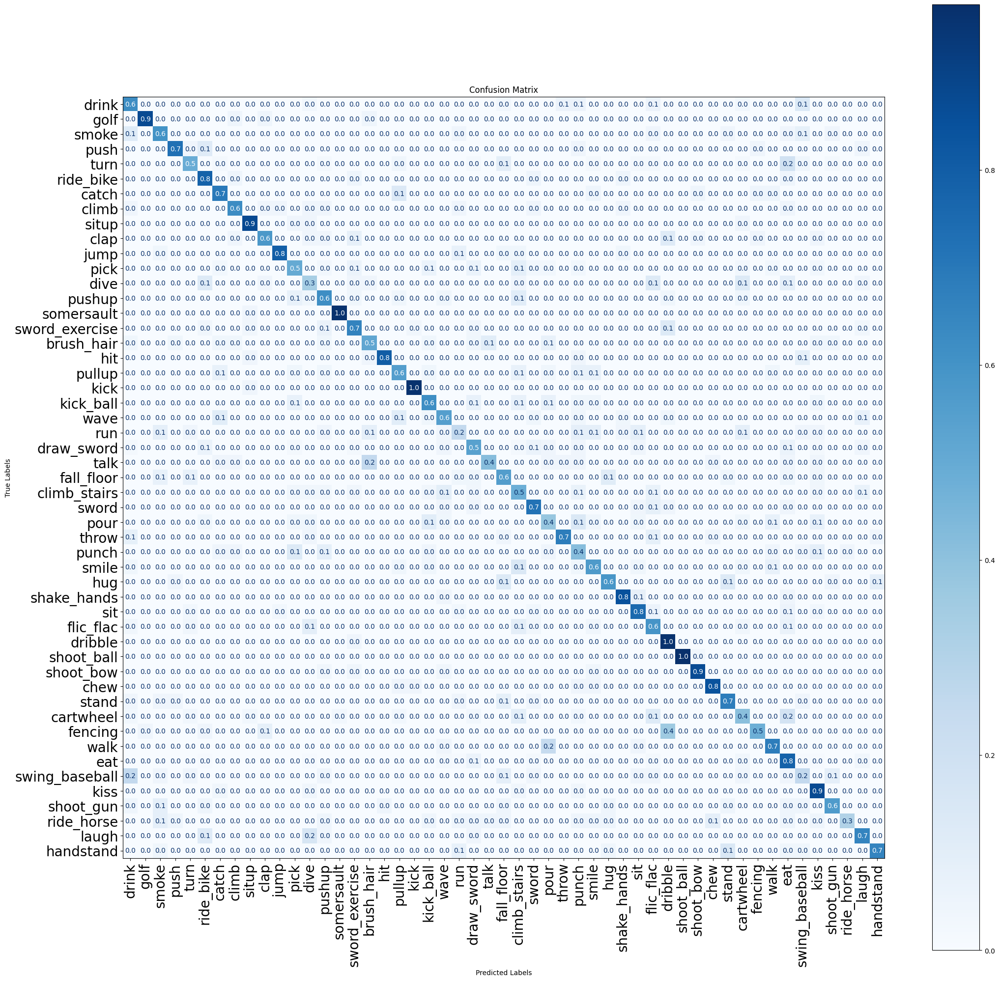

07/24 02:08:39 - mmengine - INFO - Epoch(val) [29][153/153]    acc/top1: 0.6425  acc/top5: 0.8634  acc/mean1: 0.6370  loss/loss: 3.3529  data_time: 3.8366  time: 4.1794
07/24 02:08:39 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_28.pth is removed
07/24 02:08:40 - mmengine - INFO - The best checkpoint with 0.6425 acc/top1 at 29 epoch is saved to best_acc_top1_epoch_29.pth.
07/24 02:11:55 - mmengine - INFO - Epoch(train) [30][ 20/179]  base_lr: 4.4242e-04 lr: 4.4479e-05  eta: 14:27:37  time: 7.5860  data_time: 4.0116  memory: 34294  loss: 0.0874  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0874
07/24 02:14:15 - mmengine - INFO - Epoch(train) [30][ 40/179]  base_lr: 4.4242e-04 lr: 4.4479e-05  eta: 14:25:11  time: 6.9266  data_time: 3.3734  memory: 34294  loss: 0.0865  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0865
07/24 02:16:11 - mmengine - INFO - Epoch(train) [30][ 60/179]  base_lr: 4.4242e-04 lr: 4.4479e-

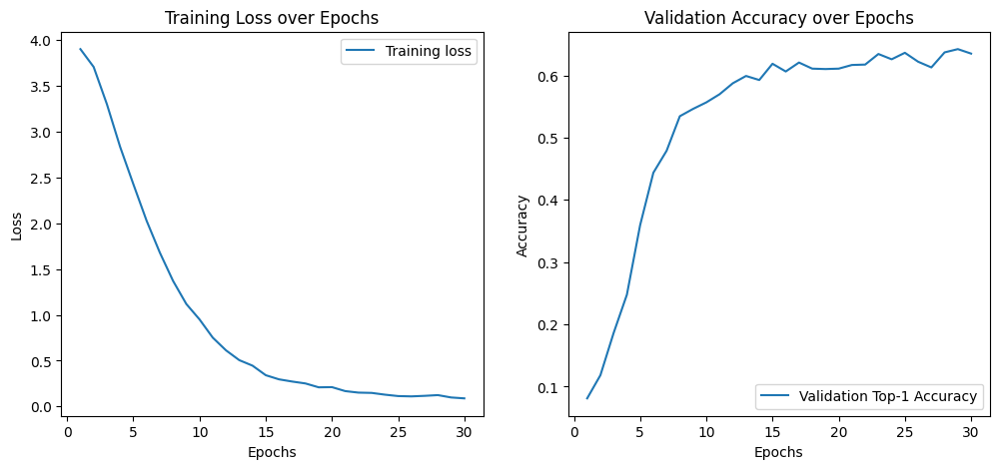

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719e65fd0>


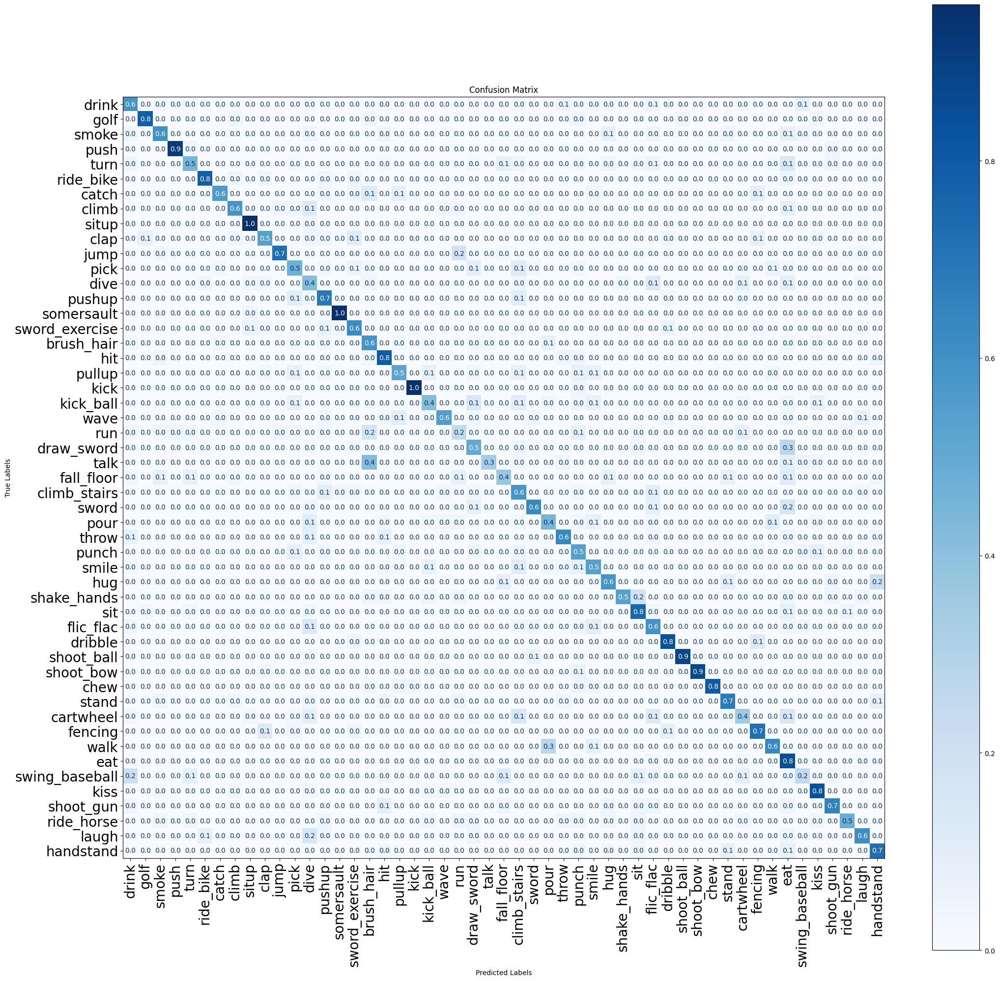

07/24 02:40:55 - mmengine - INFO - Epoch(val) [30][153/153]    acc/top1: 0.6353  acc/top5: 0.8595  acc/mean1: 0.6271  loss/loss: 3.3497  data_time: 3.9282  time: 4.2720
07/24 02:44:12 - mmengine - INFO - Epoch(train) [31][ 20/179]  base_lr: 4.3045e-04 lr: 4.3300e-05  eta: 14:06:27  time: 7.5785  data_time: 4.0190  memory: 34294  loss: 0.0845  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0845
07/24 02:46:43 - mmengine - INFO - Epoch(train) [31][ 40/179]  base_lr: 4.3045e-04 lr: 4.3300e-05  eta: 14:04:17  time: 7.9537  data_time: 4.3785  memory: 34294  loss: 0.0601  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0601
07/24 02:48:32 - mmengine - INFO - Epoch(train) [31][ 60/179]  base_lr: 4.3045e-04 lr: 4.3300e-05  eta: 14:01:11  time: 3.8824  data_time: 0.2904  memory: 34294  loss: 0.0736  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0736
07/24 02:51:15 - mmengine - INFO - Epoch(train) [31][ 80/179]  base_lr: 4.3045e-04 lr: 4.3300e-05  eta: 13:59:16  time: 8.6283  data_time: 5.041

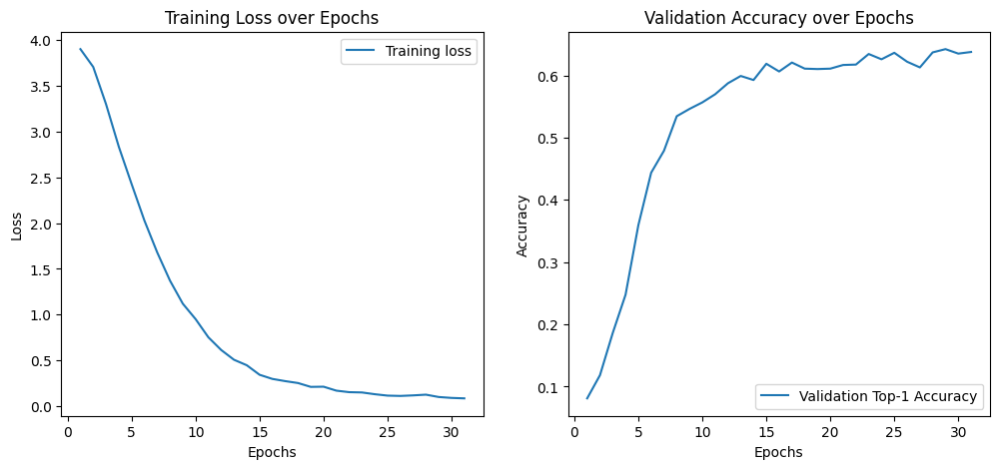

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a0af4c0>


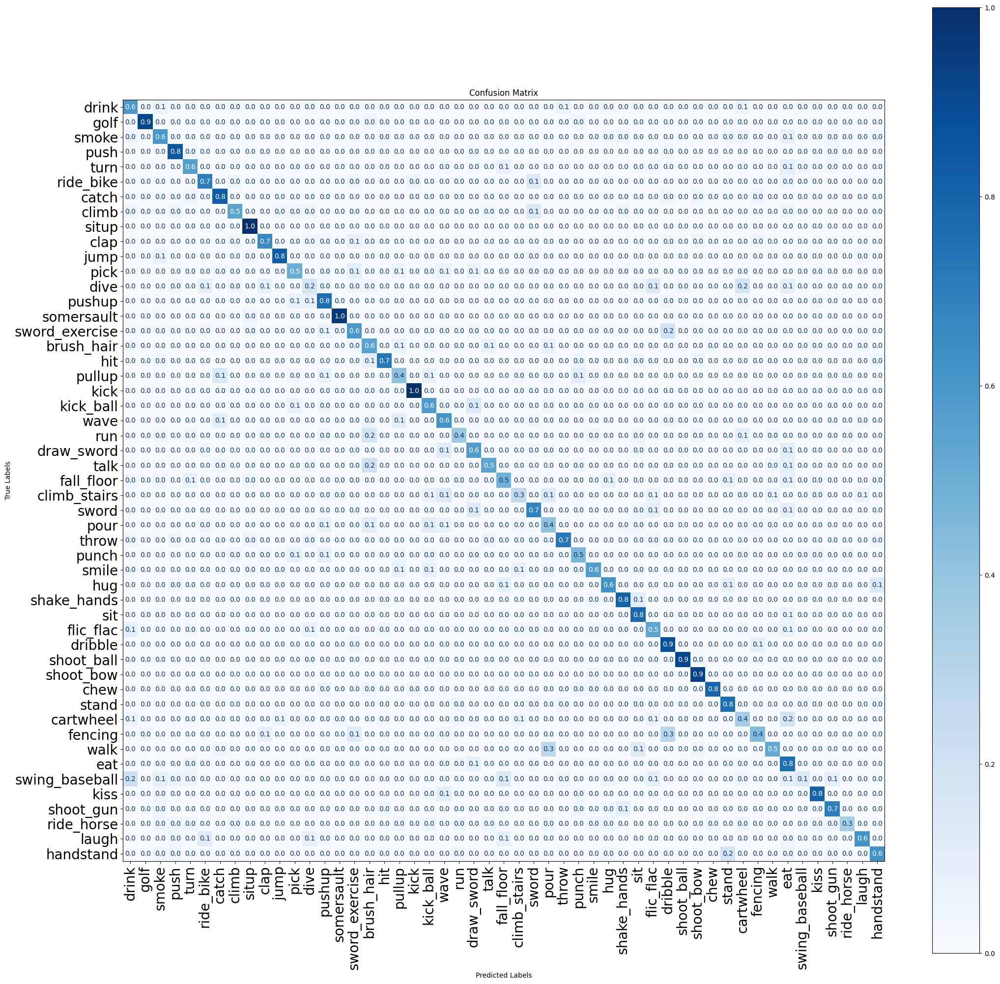

07/24 03:13:58 - mmengine - INFO - Epoch(val) [31][153/153]    acc/top1: 0.6379  acc/top5: 0.8556  acc/mean1: 0.6337  loss/loss: 3.3471  data_time: 4.0598  time: 4.4060
07/24 03:17:21 - mmengine - INFO - Epoch(train) [32][ 20/179]  base_lr: 4.1821e-04 lr: 4.2094e-05  eta: 13:45:54  time: 7.1799  data_time: 3.5855  memory: 34294  loss: 0.0519  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0519
07/24 03:19:58 - mmengine - INFO - Epoch(train) [32][ 40/179]  base_lr: 4.1821e-04 lr: 4.2094e-05  eta: 13:43:50  time: 8.2144  data_time: 4.6533  memory: 34294  loss: 0.1159  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1159
07/24 03:21:47 - mmengine - INFO - Epoch(train) [32][ 60/179]  base_lr: 4.1821e-04 lr: 4.2094e-05  eta: 13:40:47  time: 3.5745  data_time: 0.0061  memory: 34294  loss: 0.0726  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0726
07/24 03:24:17 - mmengine - INFO - Epoch(train) [32][ 80/179]  base_lr: 4.1821e-04 lr: 4.2094e-05  eta: 13:38:33  time: 6.8762  data_time: 3.219

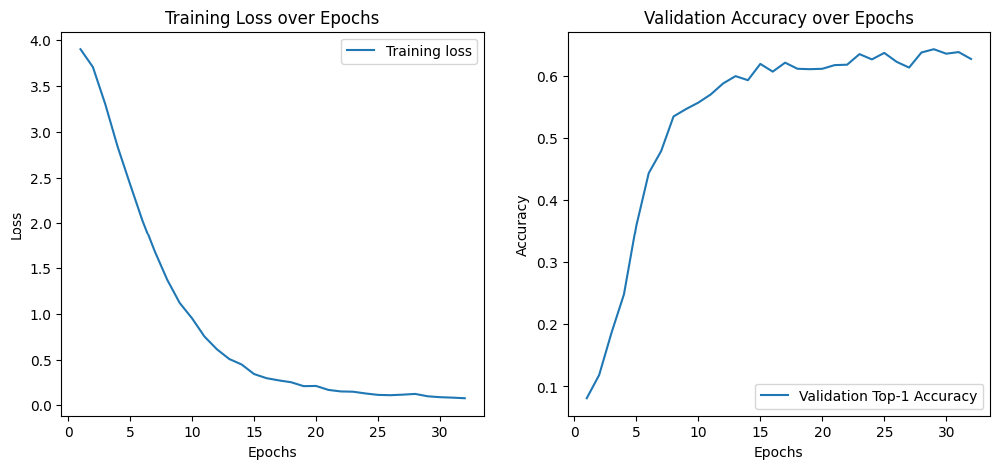

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a64f190>


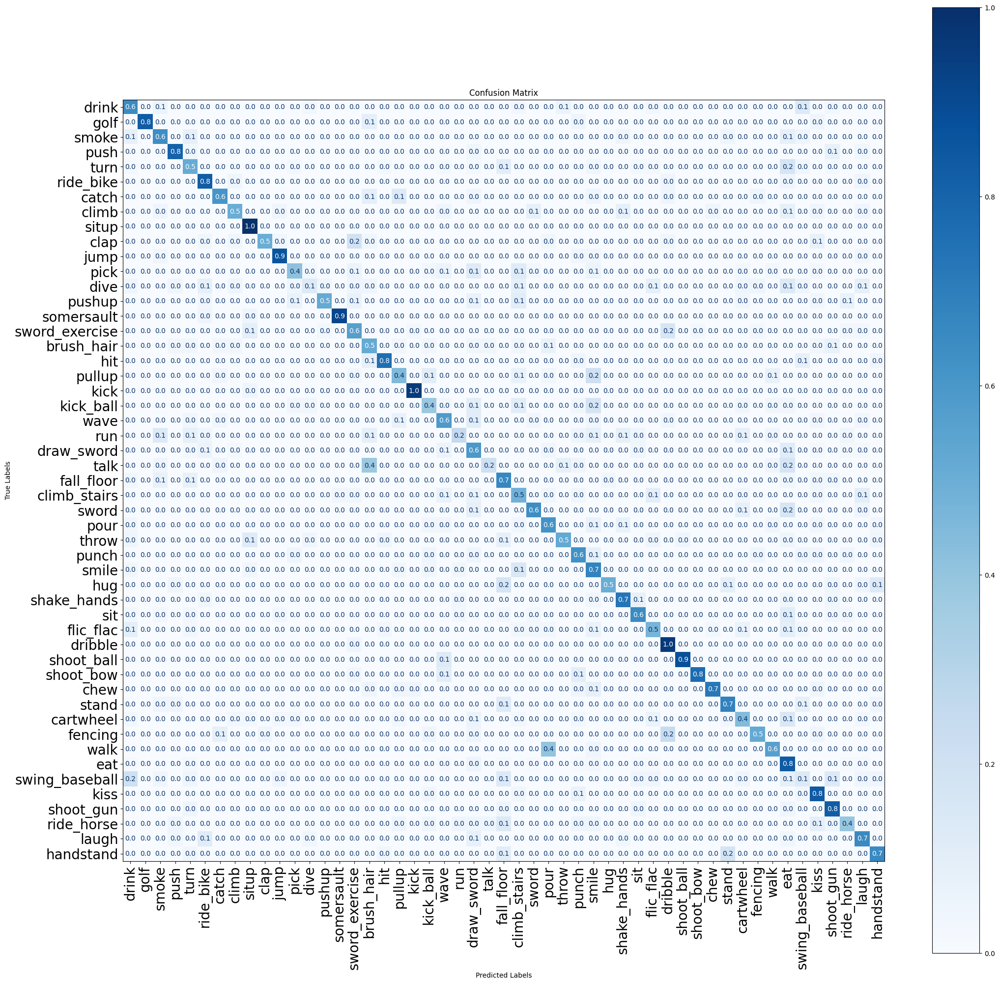

07/24 03:46:04 - mmengine - INFO - Epoch(val) [32][153/153]    acc/top1: 0.6268  acc/top5: 0.8562  acc/mean1: 0.6157  loss/loss: 3.3453  data_time: 3.7849  time: 4.1297
07/24 03:49:20 - mmengine - INFO - Epoch(train) [33][ 20/179]  base_lr: 4.0574e-04 lr: 4.0866e-05  eta: 13:24:41  time: 8.0130  data_time: 4.4078  memory: 34294  loss: 0.0630  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0630
07/24 03:51:54 - mmengine - INFO - Epoch(train) [33][ 40/179]  base_lr: 4.0574e-04 lr: 4.0866e-05  eta: 13:22:33  time: 6.7851  data_time: 3.1824  memory: 34294  loss: 0.1121  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.1121
07/24 03:53:47 - mmengine - INFO - Epoch(train) [33][ 60/179]  base_lr: 4.0574e-04 lr: 4.0866e-05  eta: 13:19:37  time: 3.6124  data_time: 0.0048  memory: 34294  loss: 0.0477  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0477
07/24 03:56:04 - mmengine - INFO - Epoch(train) [33][ 80/179]  base_lr: 4.0574e-04 lr: 4.0866e-05  eta: 13:17:08  time: 6.1248  data_time: 2.465

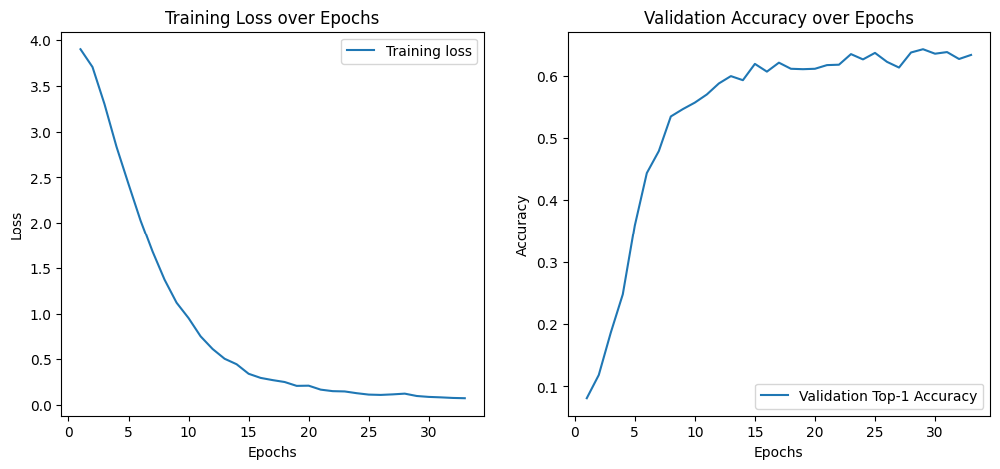

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771aad43a0>


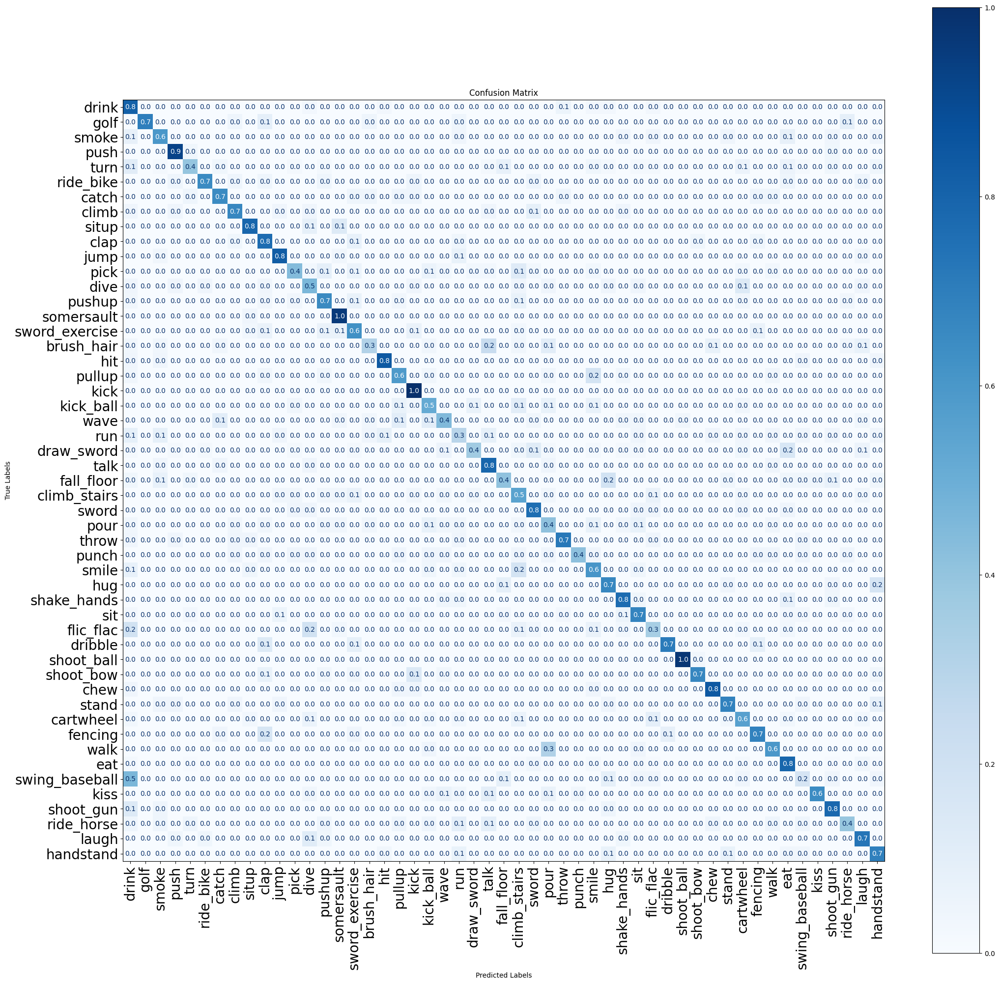

07/24 04:18:29 - mmengine - INFO - Epoch(val) [33][153/153]    acc/top1: 0.6333  acc/top5: 0.8464  acc/mean1: 0.6334  loss/loss: 3.3453  data_time: 3.9377  time: 4.2826
07/24 04:22:02 - mmengine - INFO - Epoch(train) [34][ 20/179]  base_lr: 3.9305e-04 lr: 3.9616e-05  eta: 13:03:51  time: 9.0368  data_time: 5.4374  memory: 34294  loss: 0.0907  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0907
07/24 04:24:51 - mmengine - INFO - Epoch(train) [34][ 40/179]  base_lr: 3.9305e-04 lr: 3.9616e-05  eta: 13:01:58  time: 9.1112  data_time: 5.5481  memory: 34294  loss: 0.0302  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0302
07/24 04:26:49 - mmengine - INFO - Epoch(train) [34][ 60/179]  base_lr: 3.9305e-04 lr: 3.9616e-05  eta: 12:59:07  time: 3.6624  data_time: 0.0087  memory: 34294  loss: 0.0292  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0292
07/24 04:29:30 - mmengine - INFO - Epoch(train) [34][ 80/179]  base_lr: 3.9305e-04 lr: 3.9616e-05  eta: 12:57:05  time: 8.2288  data_time: 4.641

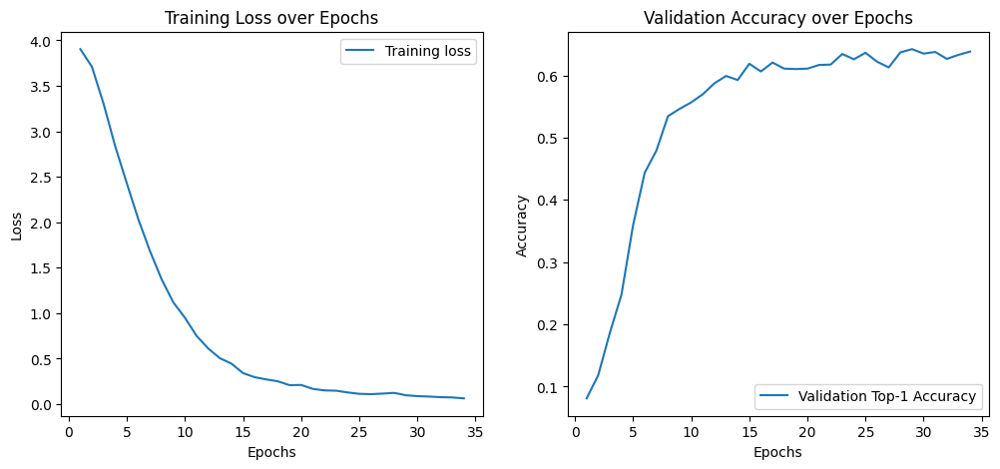

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77191570a0>


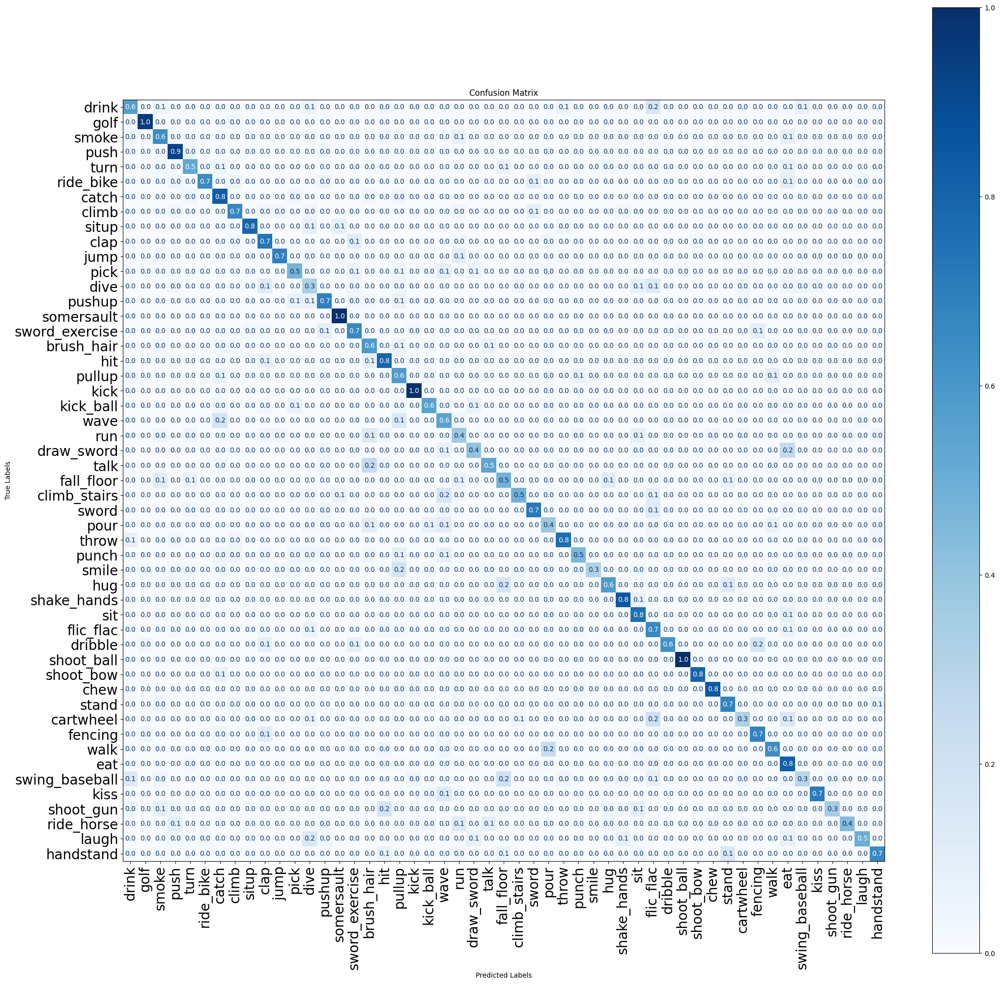

07/24 04:51:23 - mmengine - INFO - Epoch(val) [34][153/153]    acc/top1: 0.6386  acc/top5: 0.8503  acc/mean1: 0.6336  loss/loss: 3.3435  data_time: 3.7958  time: 4.1424
07/24 04:54:27 - mmengine - INFO - Epoch(train) [35][ 20/179]  base_lr: 3.8018e-04 lr: 3.8348e-05  eta: 12:42:51  time: 7.1529  data_time: 3.5754  memory: 34294  loss: 0.0908  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.0908
07/24 04:57:29 - mmengine - INFO - Epoch(train) [35][ 40/179]  base_lr: 3.8018e-04 lr: 3.8348e-05  eta: 12:41:10  time: 8.6516  data_time: 4.9991  memory: 34294  loss: 0.0623  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0623
07/24 04:59:25 - mmengine - INFO - Epoch(train) [35][ 60/179]  base_lr: 3.8018e-04 lr: 3.8348e-05  eta: 12:38:20  time: 6.1307  data_time: 2.4342  memory: 34294  loss: 0.1021  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1021
07/24 05:02:01 - mmengine - INFO - Epoch(train) [35][ 80/179]  base_lr: 3.8018e-04 lr: 3.8348e-05  eta: 12:36:11  time: 6.9087  data_time: 3.281

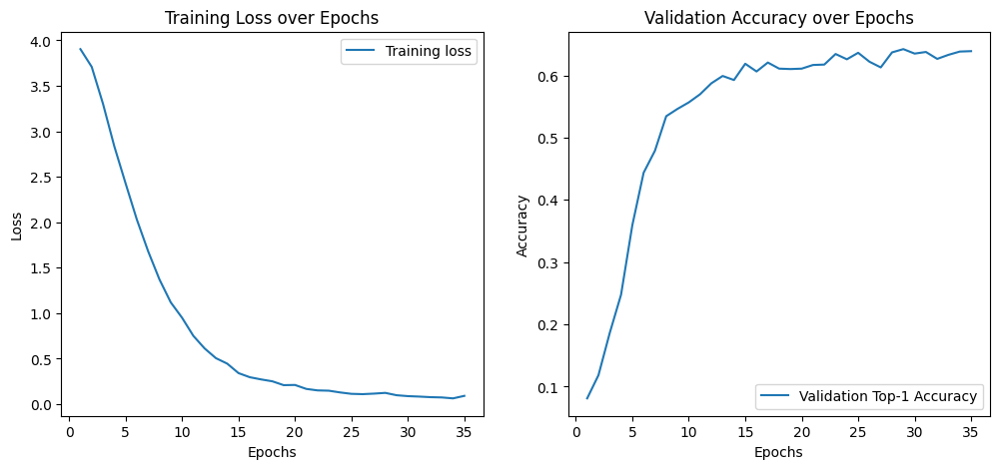

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a520460>


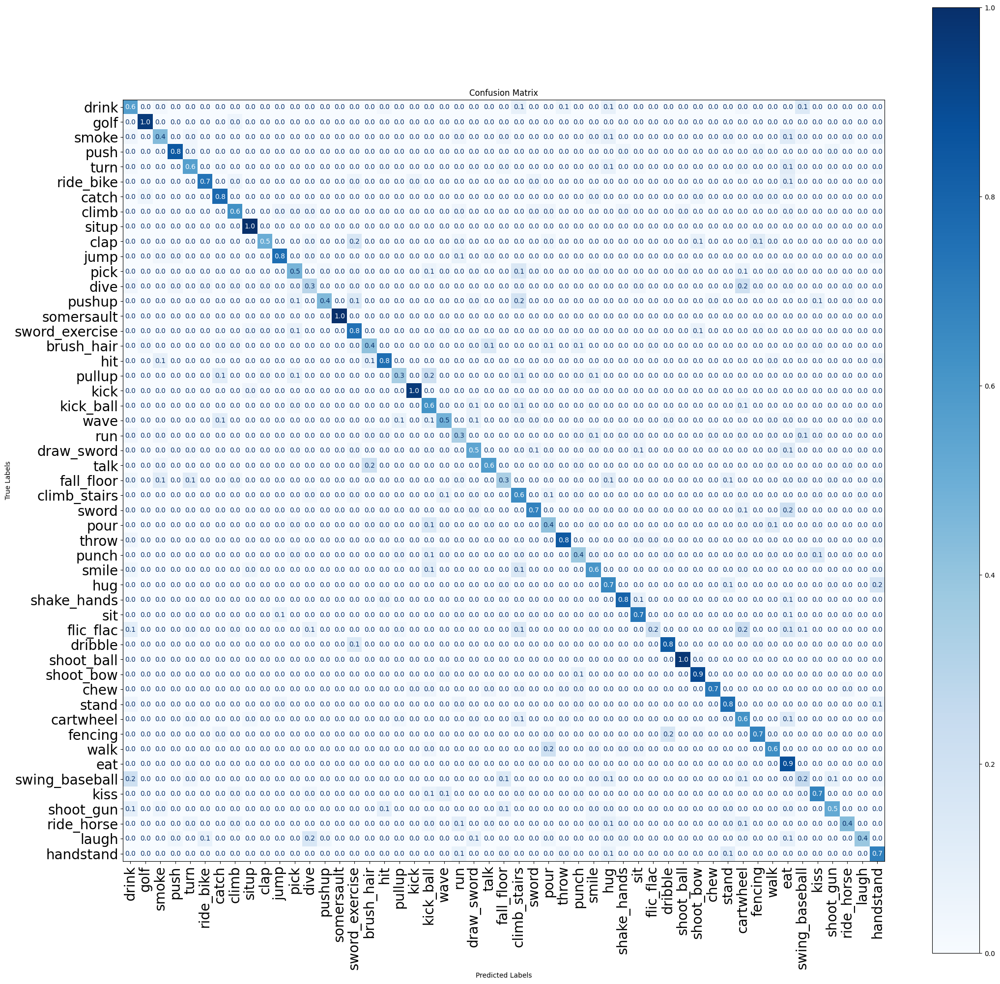

07/24 05:24:26 - mmengine - INFO - Epoch(val) [35][153/153]    acc/top1: 0.6392  acc/top5: 0.8536  acc/mean1: 0.6279  loss/loss: 3.3423  data_time: 3.8203  time: 4.1666
07/24 05:27:37 - mmengine - INFO - Epoch(train) [36][ 20/179]  base_lr: 3.6715e-04 lr: 3.7064e-05  eta: 12:22:42  time: 7.1376  data_time: 3.5676  memory: 34294  loss: 0.0630  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0630
07/24 05:30:11 - mmengine - INFO - Epoch(train) [36][ 40/179]  base_lr: 3.6715e-04 lr: 3.7064e-05  eta: 12:20:31  time: 6.8993  data_time: 3.3325  memory: 34294  loss: 0.0268  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0268
07/24 05:32:05 - mmengine - INFO - Epoch(train) [36][ 60/179]  base_lr: 3.6715e-04 lr: 3.7064e-05  eta: 12:17:40  time: 3.5782  data_time: 0.0118  memory: 34294  loss: 0.0828  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0828
07/24 05:34:56 - mmengine - INFO - Epoch(train) [36][ 80/179]  base_lr: 3.6715e-04 lr: 3.7064e-05  eta: 12:15:45  time: 8.6155  data_time: 4.967

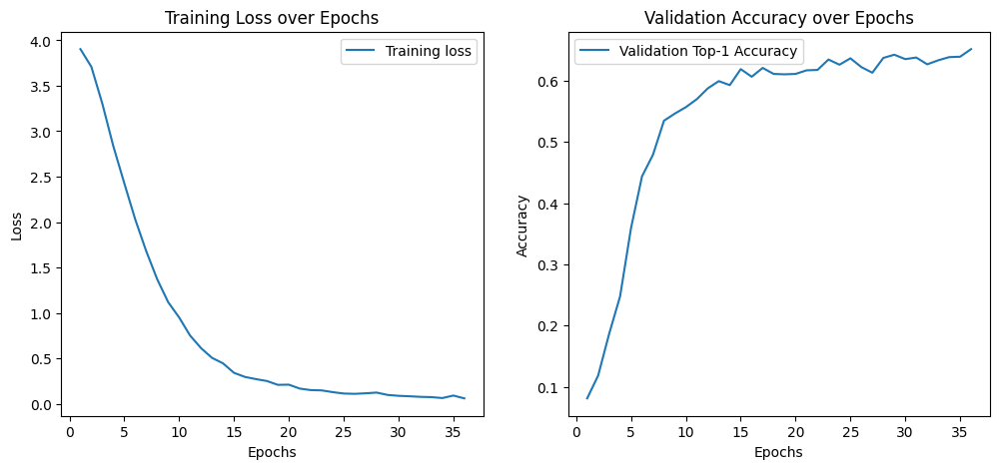

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a0770a0>


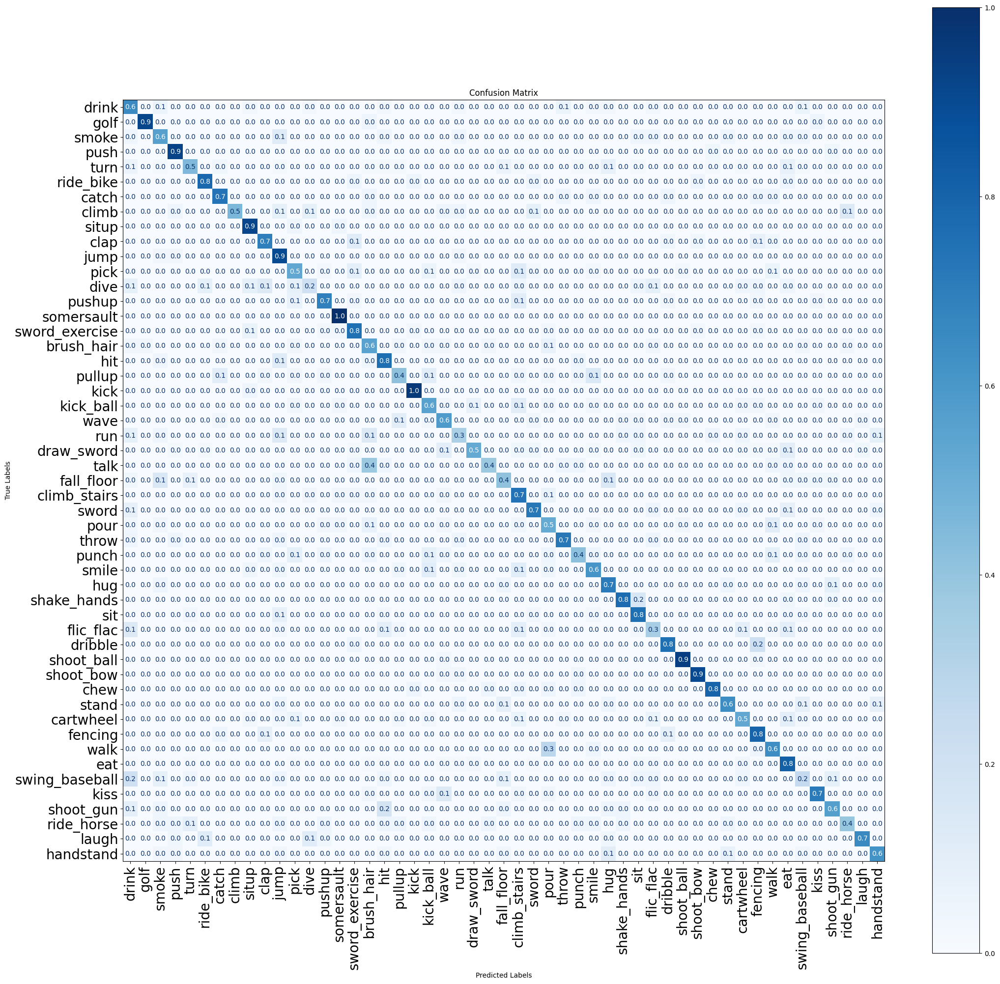

07/24 05:57:33 - mmengine - INFO - Epoch(val) [36][153/153]    acc/top1: 0.6516  acc/top5: 0.8621  acc/mean1: 0.6455  loss/loss: 3.3392  data_time: 4.0205  time: 4.3662
07/24 05:57:33 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_29.pth is removed
07/24 05:57:34 - mmengine - INFO - The best checkpoint with 0.6516 acc/top1 at 36 epoch is saved to best_acc_top1_epoch_36.pth.
07/24 06:00:57 - mmengine - INFO - Epoch(train) [37][ 20/179]  base_lr: 3.5398e-04 lr: 3.5767e-05  eta: 12:02:01  time: 7.7463  data_time: 4.1462  memory: 34294  loss: 0.1114  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.1114
07/24 06:03:28 - mmengine - INFO - Epoch(train) [37][ 40/179]  base_lr: 3.5398e-04 lr: 3.5767e-05  eta: 11:59:45  time: 8.1498  data_time: 4.5355  memory: 34294  loss: 0.0483  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0483
07/24 06:05:23 - mmengine - INFO - Epoch(train) [37][ 60/179]  base_lr: 3.5398e-04 lr: 3.5767e-

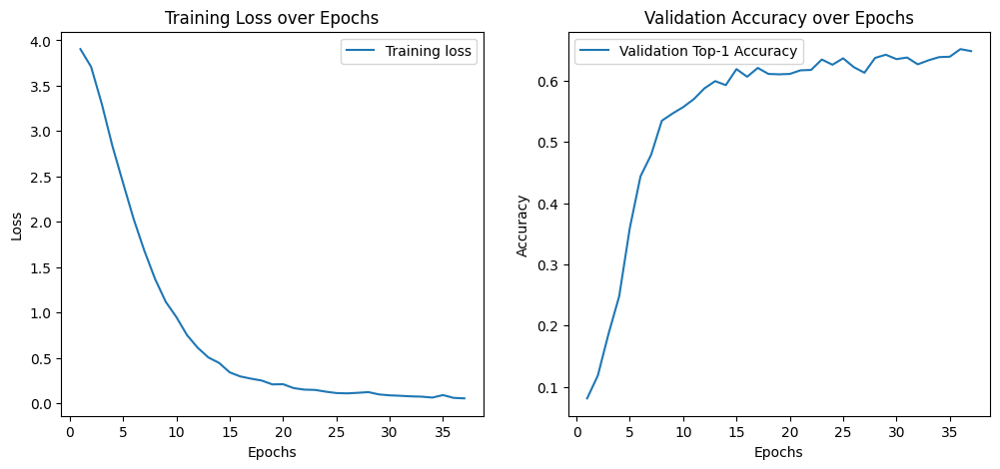

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719faad90>


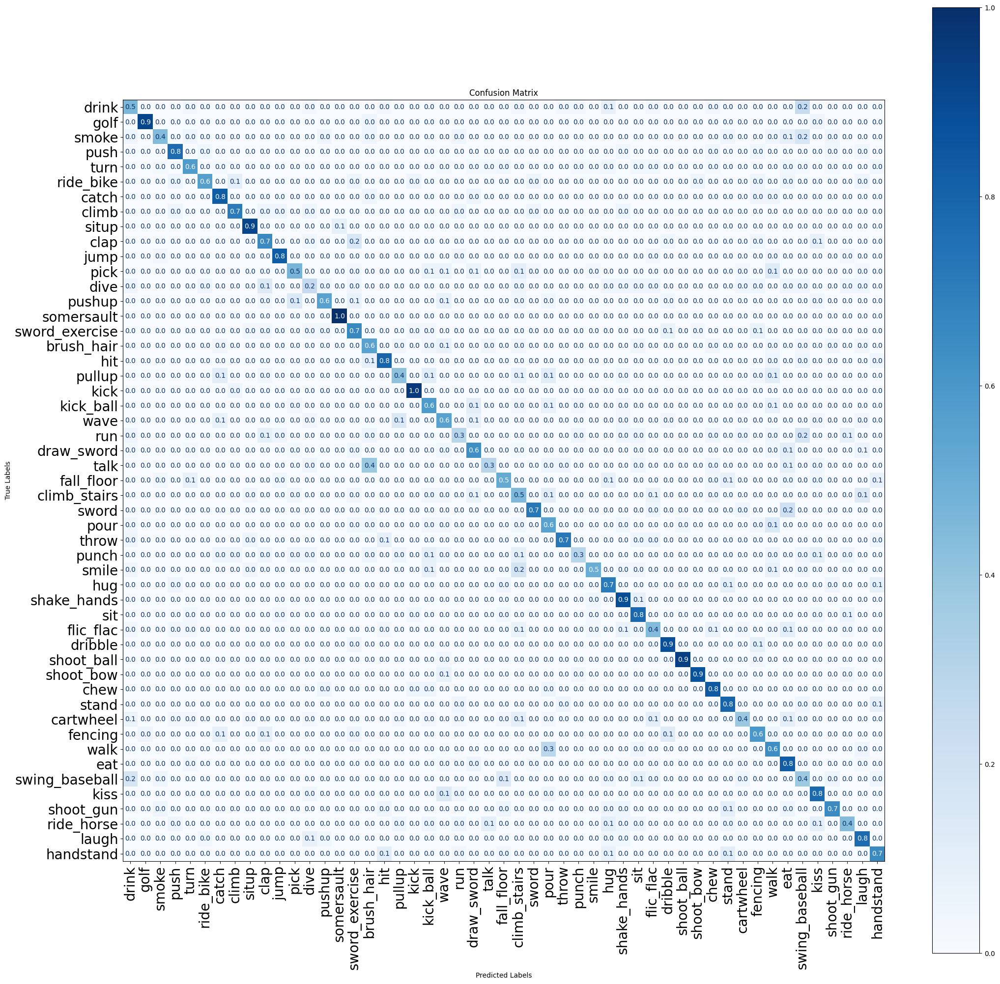

07/24 06:30:52 - mmengine - INFO - Epoch(val) [37][153/153]    acc/top1: 0.6484  acc/top5: 0.8536  acc/mean1: 0.6405  loss/loss: 3.3352  data_time: 4.0001  time: 4.3462
07/24 06:34:23 - mmengine - INFO - Epoch(train) [38][ 20/179]  base_lr: 3.4070e-04 lr: 3.4460e-05  eta: 11:41:43  time: 7.8229  data_time: 4.2583  memory: 34294  loss: 0.0447  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0447
07/24 06:36:58 - mmengine - INFO - Epoch(train) [38][ 40/179]  base_lr: 3.4070e-04 lr: 3.4460e-05  eta: 11:39:30  time: 7.2690  data_time: 3.7070  memory: 34294  loss: 0.0540  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0540
07/24 06:38:54 - mmengine - INFO - Epoch(train) [38][ 60/179]  base_lr: 3.4070e-04 lr: 3.4460e-05  eta: 11:36:44  time: 5.0339  data_time: 1.4543  memory: 34294  loss: 0.0522  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0522
07/24 06:41:21 - mmengine - INFO - Epoch(train) [38][ 80/179]  base_lr: 3.4070e-04 lr: 3.4460e-05  eta: 11:34:24  time: 7.3869  data_time: 3.821

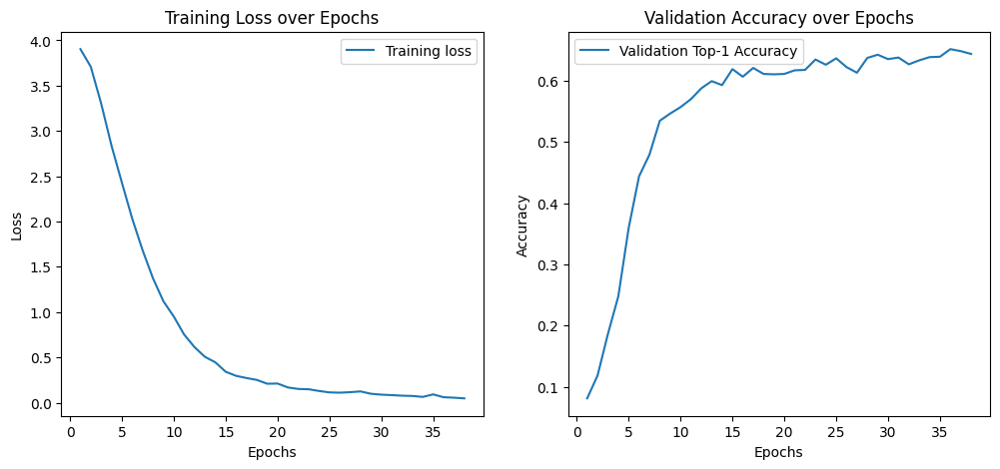

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a5ceb50>


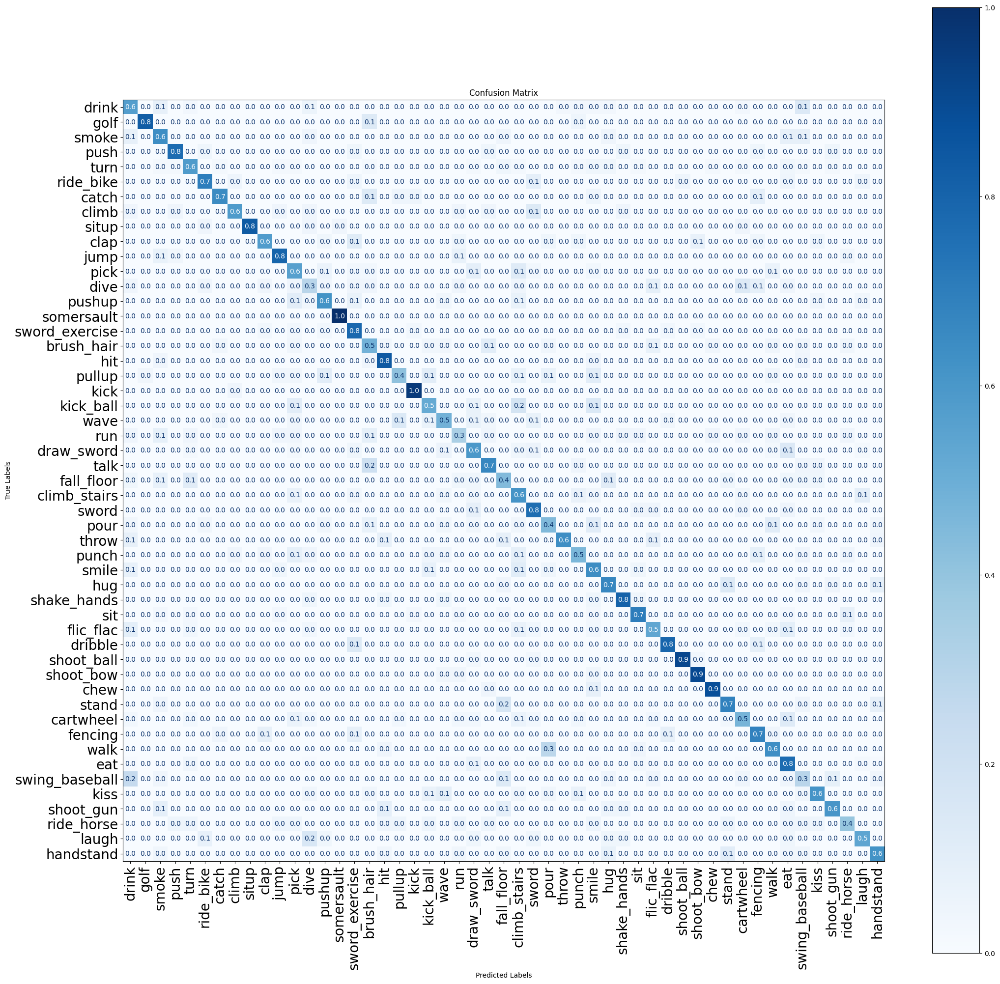

07/24 07:03:27 - mmengine - INFO - Epoch(val) [38][153/153]    acc/top1: 0.6438  acc/top5: 0.8739  acc/mean1: 0.6385  loss/loss: 3.3343  data_time: 3.9661  time: 4.3118
07/24 07:06:43 - mmengine - INFO - Epoch(train) [39][ 20/179]  base_lr: 3.2735e-04 lr: 3.3144e-05  eta: 11:20:15  time: 7.5666  data_time: 4.0132  memory: 34294  loss: 0.0428  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0428
07/24 07:09:54 - mmengine - INFO - Epoch(train) [39][ 40/179]  base_lr: 3.2735e-04 lr: 3.3144e-05  eta: 11:18:32  time: 11.3427  data_time: 7.6026  memory: 34294  loss: 0.0257  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0257
07/24 07:11:34 - mmengine - INFO - Epoch(train) [39][ 60/179]  base_lr: 3.2735e-04 lr: 3.3144e-05  eta: 11:15:32  time: 3.7189  data_time: 0.0091  memory: 34294  loss: 0.0197  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0197
07/24 07:13:58 - mmengine - INFO - Epoch(train) [39][ 80/179]  base_lr: 3.2735e-04 lr: 3.3144e-05  eta: 11:13:11  time: 6.9512  data_time: 3.31

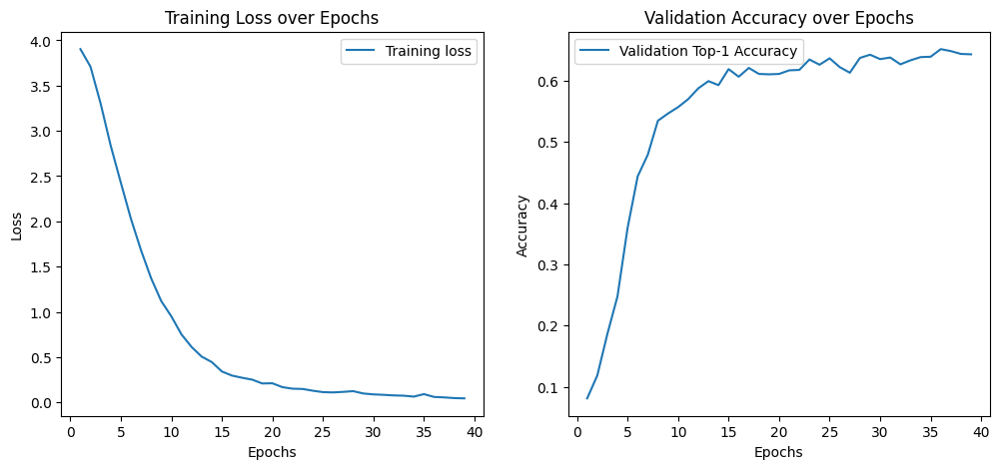

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a367550>


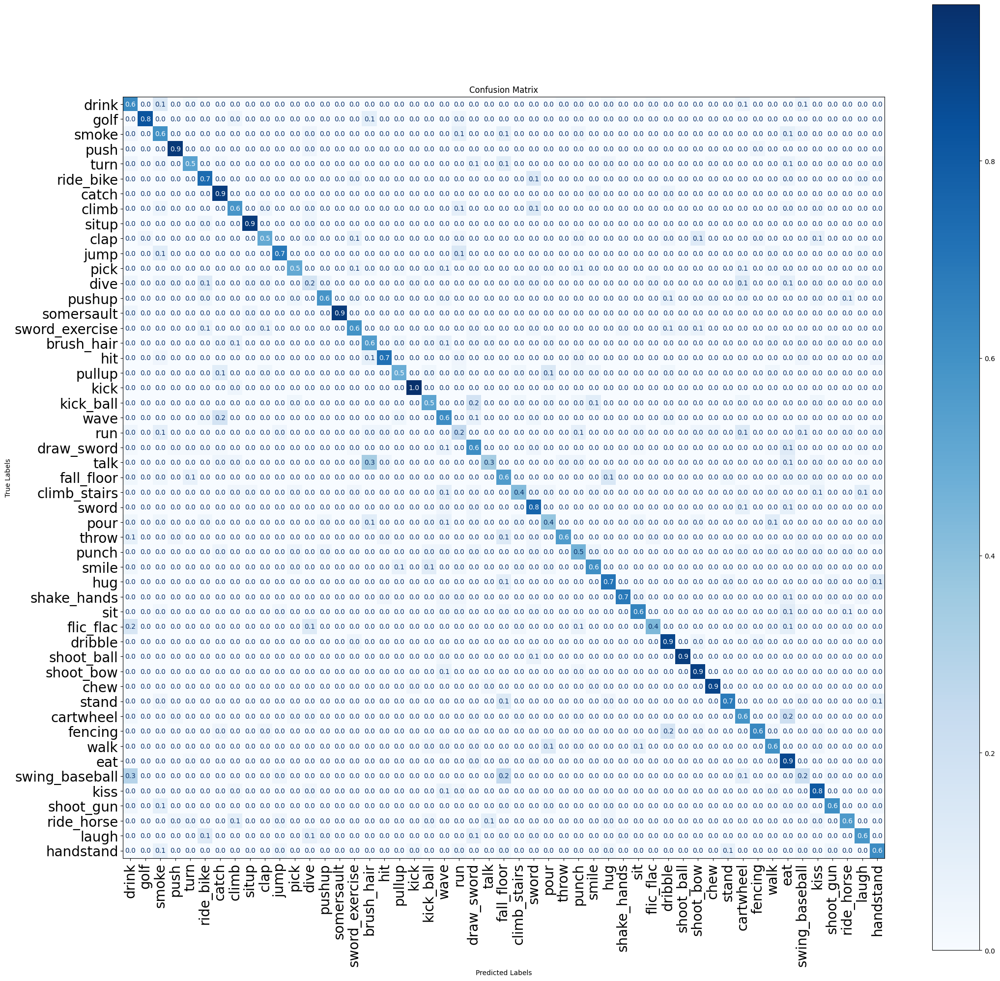

07/24 07:35:50 - mmengine - INFO - Epoch(val) [39][153/153]    acc/top1: 0.6431  acc/top5: 0.8582  acc/mean1: 0.6316  loss/loss: 3.3342  data_time: 3.7844  time: 4.1297
07/24 07:39:16 - mmengine - INFO - Exp name: 20240723_102956
07/24 07:39:20 - mmengine - INFO - Epoch(train) [40][ 20/179]  base_lr: 3.1394e-04 lr: 3.1824e-05  eta: 10:59:20  time: 8.7180  data_time: 5.1424  memory: 34294  loss: 0.0430  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0430
07/24 07:41:37 - mmengine - INFO - Epoch(train) [40][ 40/179]  base_lr: 3.1394e-04 lr: 3.1824e-05  eta: 10:56:52  time: 6.5271  data_time: 2.9532  memory: 34294  loss: 0.0185  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0185
07/24 07:43:29 - mmengine - INFO - Epoch(train) [40][ 60/179]  base_lr: 3.1394e-04 lr: 3.1824e-05  eta: 10:54:05  time: 3.5811  data_time: 0.0063  memory: 34294  loss: 0.0184  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0184
07/24 07:46:14 - mmengine - INFO - Epoch(train) [40][ 80/179]  base_lr: 3.1394e-04 

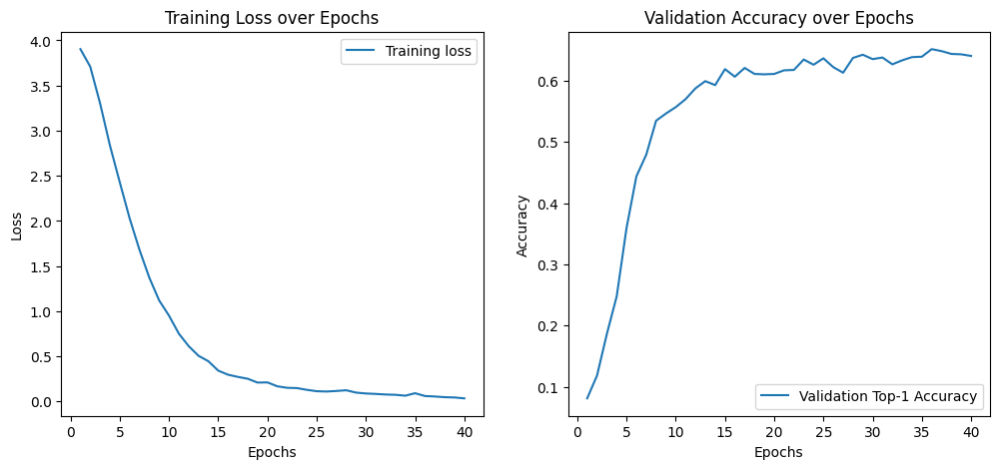

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771e1d4280>


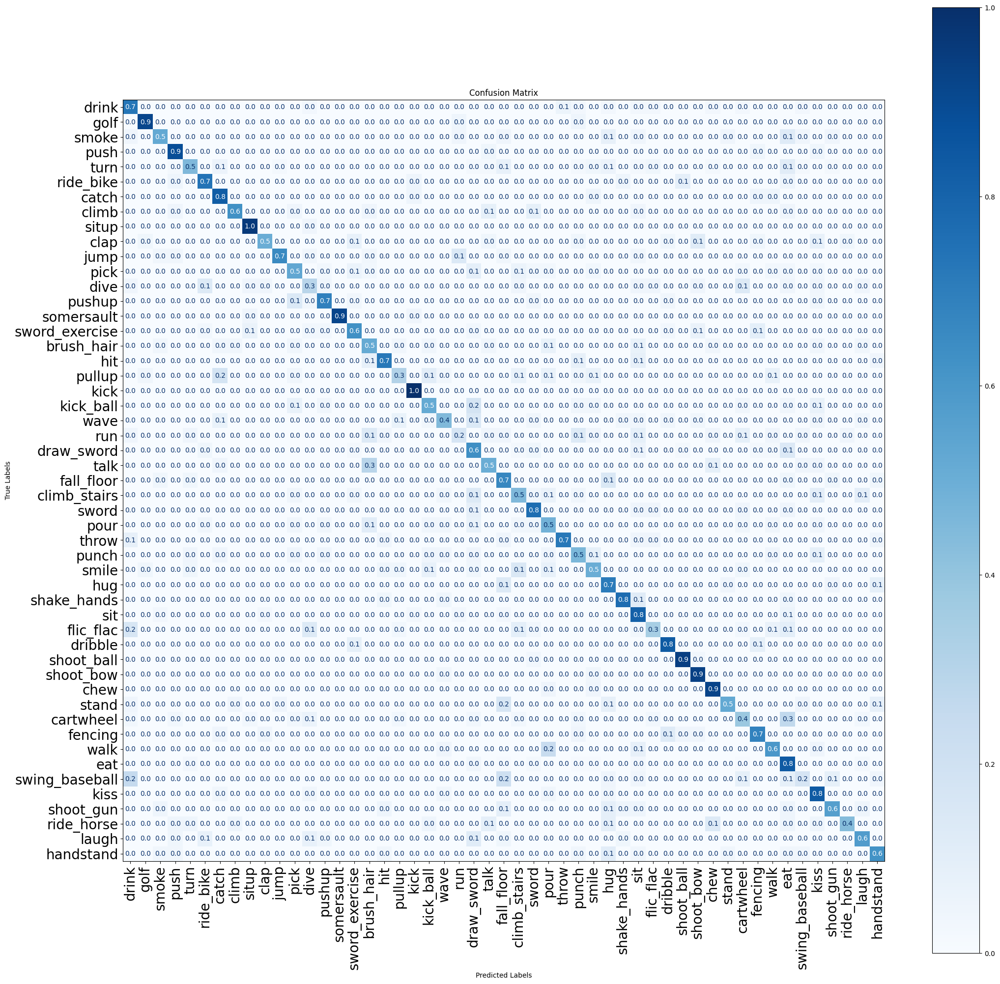

07/24 08:08:42 - mmengine - INFO - Epoch(val) [40][153/153]    acc/top1: 0.6405  acc/top5: 0.8582  acc/mean1: 0.6312  loss/loss: 3.3332  data_time: 3.8365  time: 4.1813
07/24 08:12:01 - mmengine - INFO - Epoch(train) [41][ 20/179]  base_lr: 3.0050e-04 lr: 3.0500e-05  eta: 10:38:22  time: 8.0683  data_time: 4.4957  memory: 34294  loss: 0.0474  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0474
07/24 08:14:26 - mmengine - INFO - Epoch(train) [41][ 40/179]  base_lr: 3.0050e-04 lr: 3.0500e-05  eta: 10:36:01  time: 7.8275  data_time: 4.2217  memory: 34294  loss: 0.0295  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0295
07/24 08:16:18 - mmengine - INFO - Epoch(train) [41][ 60/179]  base_lr: 3.0050e-04 lr: 3.0500e-05  eta: 10:33:14  time: 3.5924  data_time: 0.0054  memory: 34294  loss: 0.0507  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0507
07/24 08:19:03 - mmengine - INFO - Epoch(train) [41][ 80/179]  base_lr: 3.0050e-04 lr: 3.0500e-05  eta: 10:31:07  time: 7.8661  data_time: 4.293

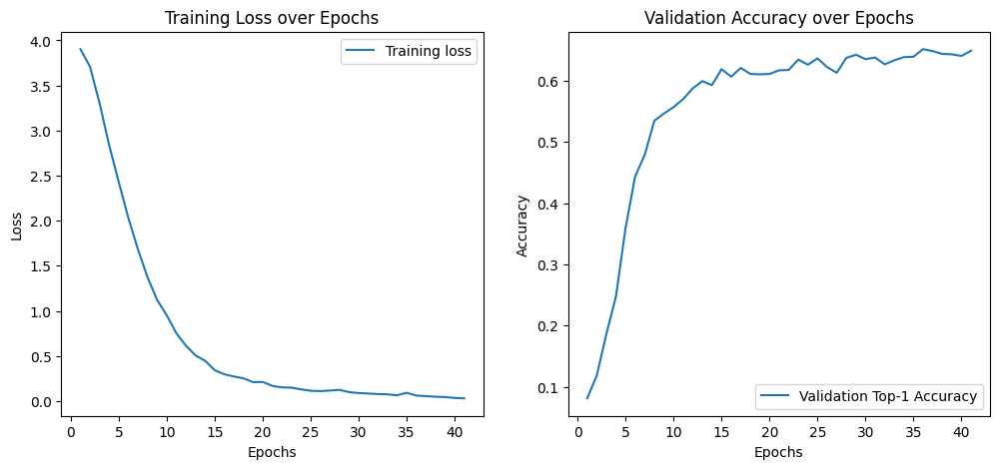

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771adddfa0>


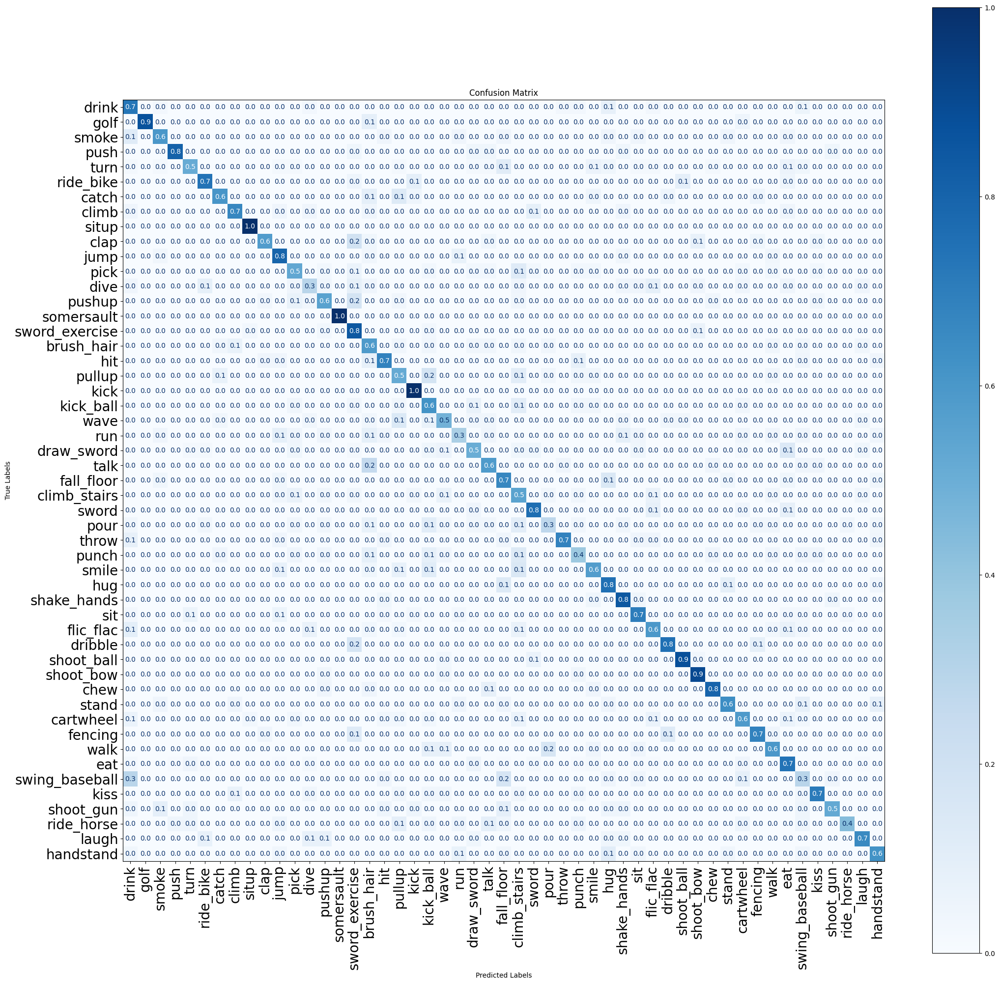

07/24 08:42:10 - mmengine - INFO - Epoch(val) [41][153/153]    acc/top1: 0.6490  acc/top5: 0.8673  acc/mean1: 0.6471  loss/loss: 3.3317  data_time: 3.9900  time: 4.3362
07/24 08:45:11 - mmengine - INFO - Epoch(train) [42][ 20/179]  base_lr: 2.8706e-04 lr: 2.9176e-05  eta: 10:17:19  time: 6.4919  data_time: 2.9383  memory: 34294  loss: 0.0569  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0569
07/24 08:48:01 - mmengine - INFO - Epoch(train) [42][ 40/179]  base_lr: 2.8706e-04 lr: 2.9176e-05  eta: 10:15:15  time: 8.6195  data_time: 4.9779  memory: 34294  loss: 0.0293  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0293
07/24 08:49:57 - mmengine - INFO - Epoch(train) [42][ 60/179]  base_lr: 2.8706e-04 lr: 2.9176e-05  eta: 10:12:32  time: 6.1577  data_time: 2.5551  memory: 34294  loss: 0.0729  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0729
07/24 08:52:35 - mmengine - INFO - Epoch(train) [42][ 80/179]  base_lr: 2.8706e-04 lr: 2.9176e-05  eta: 10:10:19  time: 8.1155  data_time: 4.483

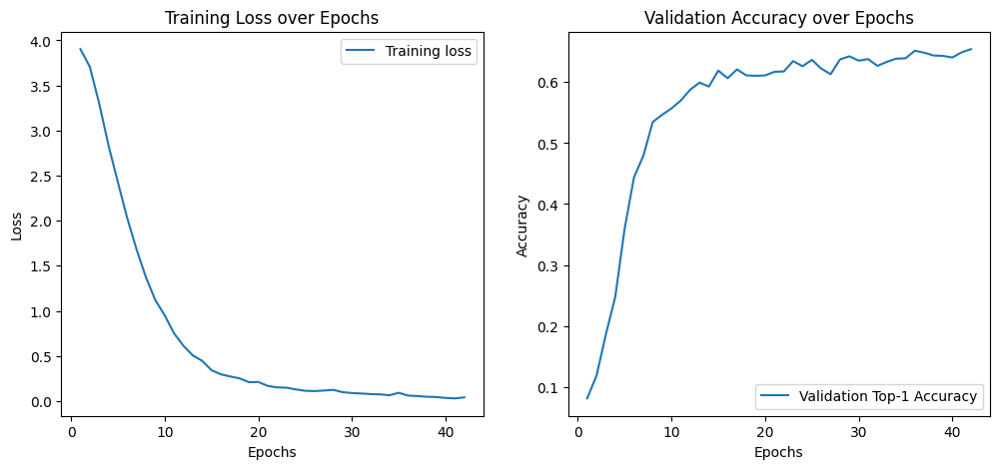

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77195739d0>


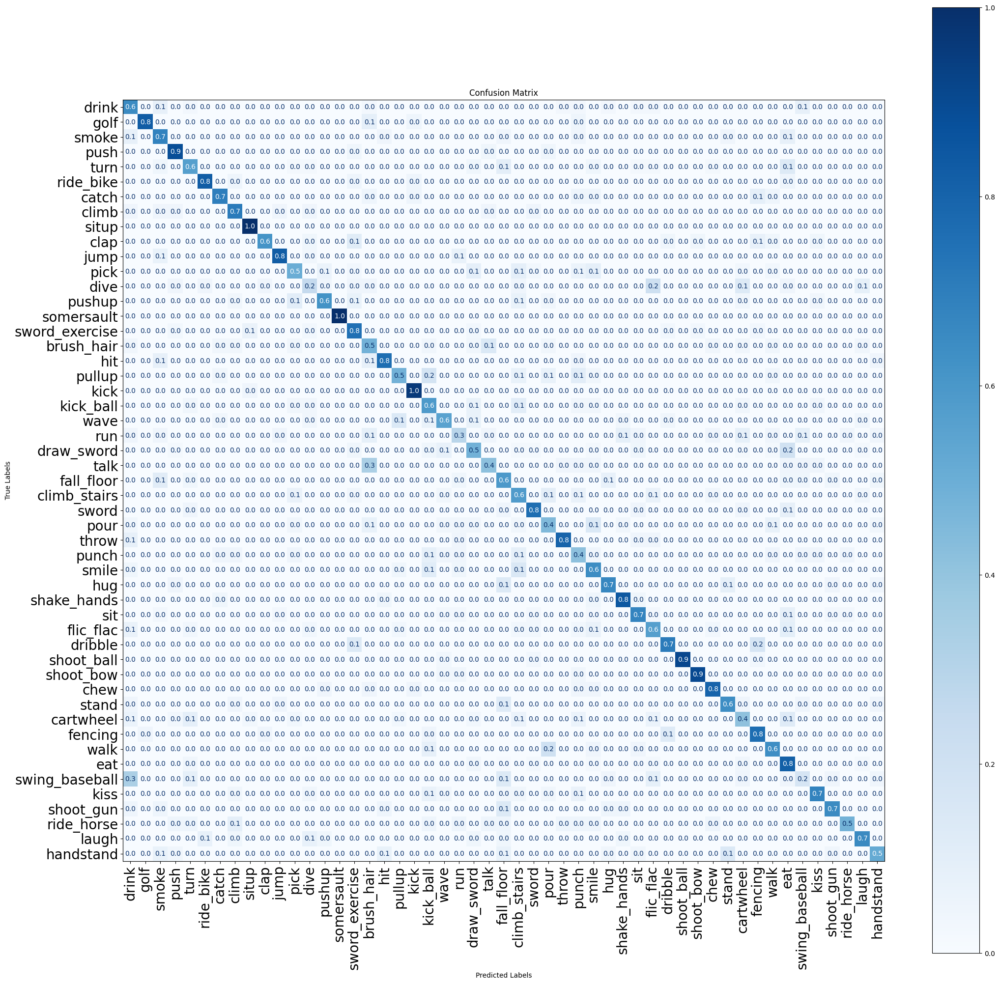

07/24 09:15:18 - mmengine - INFO - Epoch(val) [42][153/153]    acc/top1: 0.6542  acc/top5: 0.8745  acc/mean1: 0.6496  loss/loss: 3.3285  data_time: 3.9667  time: 4.3143
07/24 09:15:18 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_36.pth is removed
07/24 09:15:19 - mmengine - INFO - The best checkpoint with 0.6542 acc/top1 at 42 epoch is saved to best_acc_top1_epoch_42.pth.
07/24 09:18:44 - mmengine - INFO - Epoch(train) [43][ 20/179]  base_lr: 2.7365e-04 lr: 2.7856e-05  eta: 9:56:27  time: 8.6110  data_time: 5.0231  memory: 34294  loss: 0.0246  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0246
07/24 09:21:10 - mmengine - INFO - Epoch(train) [43][ 40/179]  base_lr: 2.7365e-04 lr: 2.7856e-05  eta: 9:54:06  time: 7.0242  data_time: 3.4402  memory: 34294  loss: 0.0353  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0353
07/24 09:22:58 - mmengine - INFO - Epoch(train) [43][ 60/179]  base_lr: 2.7365e-04 lr: 2.7856e-05

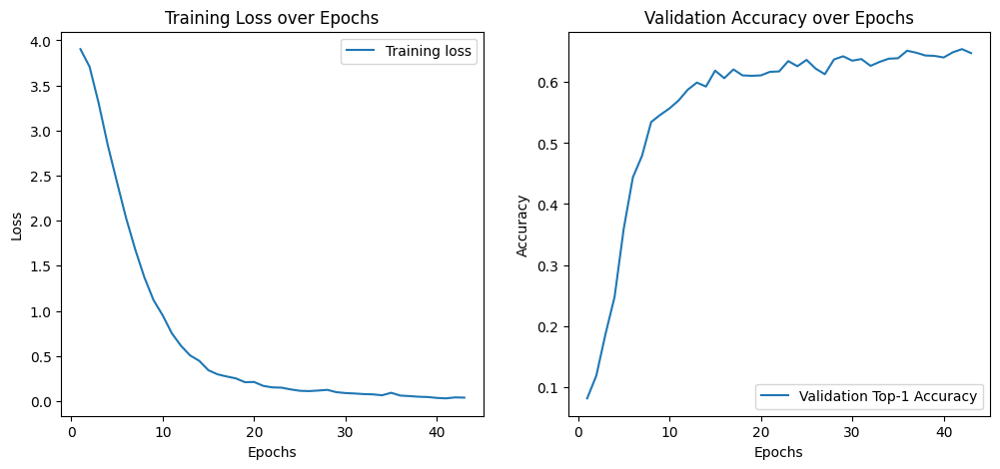

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a719c40>


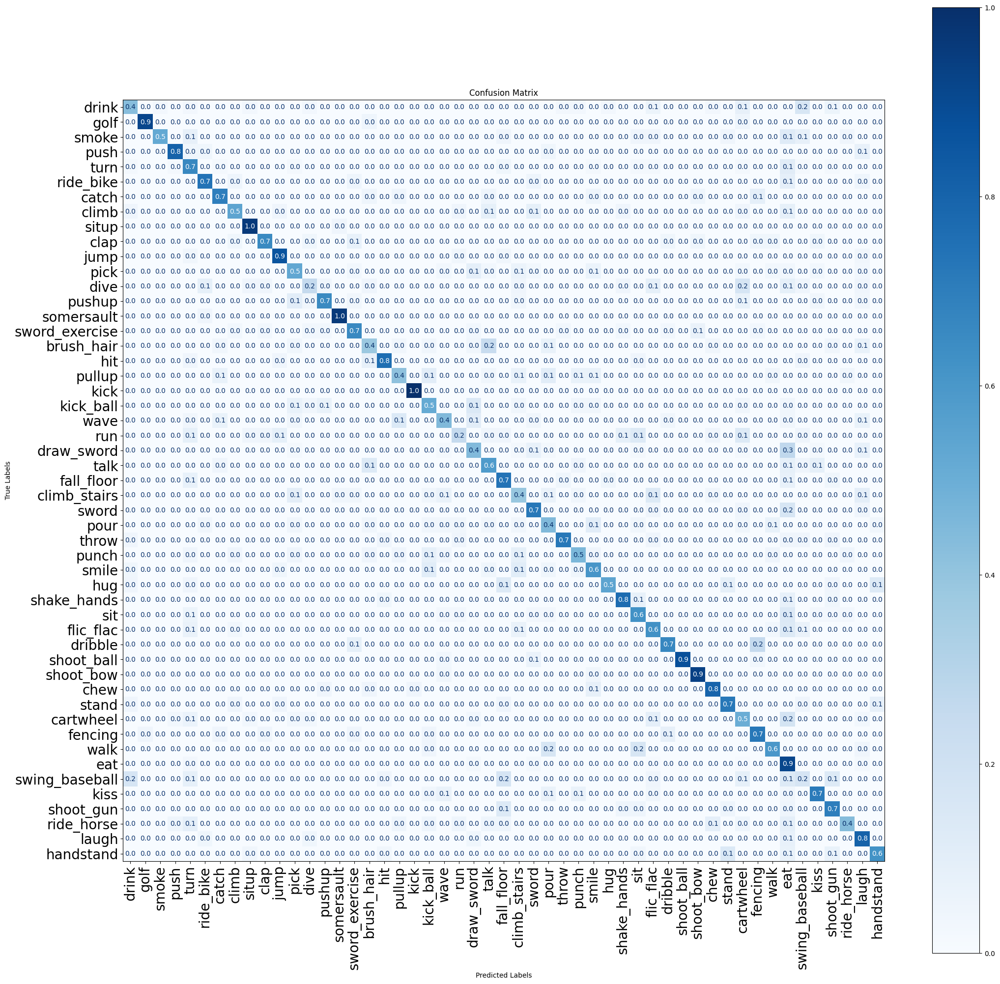

07/24 09:48:07 - mmengine - INFO - Epoch(val) [43][153/153]    acc/top1: 0.6477  acc/top5: 0.8516  acc/mean1: 0.6359  loss/loss: 3.3262  data_time: 4.0227  time: 4.3695
07/24 09:51:29 - mmengine - INFO - Epoch(train) [44][ 20/179]  base_lr: 2.6030e-04 lr: 2.6540e-05  eta: 9:35:06  time: 7.9935  data_time: 4.4178  memory: 34294  loss: 0.0771  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0771
07/24 09:54:02 - mmengine - INFO - Epoch(train) [44][ 40/179]  base_lr: 2.6030e-04 lr: 2.6540e-05  eta: 9:32:49  time: 7.1681  data_time: 3.5881  memory: 34294  loss: 0.1215  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.1215
07/24 09:55:50 - mmengine - INFO - Epoch(train) [44][ 60/179]  base_lr: 2.6030e-04 lr: 2.6540e-05  eta: 9:30:03  time: 3.5805  data_time: 0.0070  memory: 34294  loss: 0.0477  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0477
07/24 09:58:36 - mmengine - INFO - Epoch(train) [44][ 80/179]  base_lr: 2.6030e-04 lr: 2.6540e-05  eta: 9:27:54  time: 8.0517  data_time: 4.4741  m

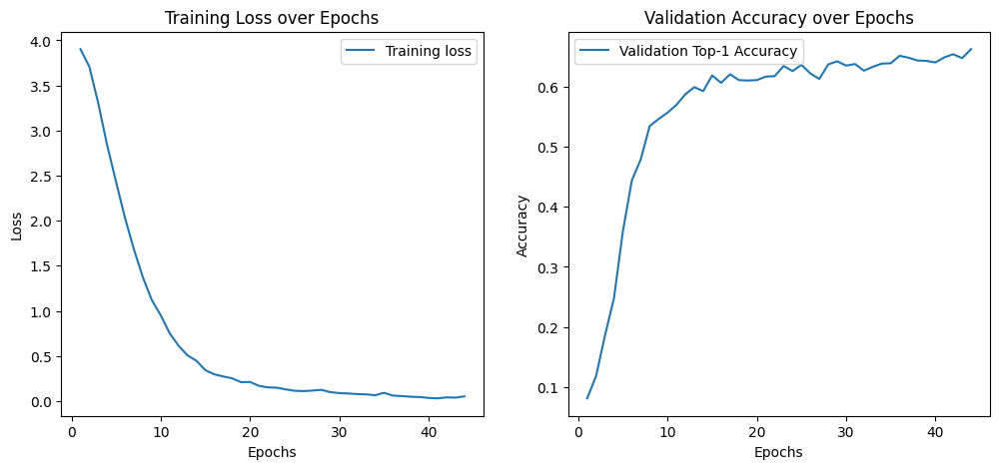

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719539850>


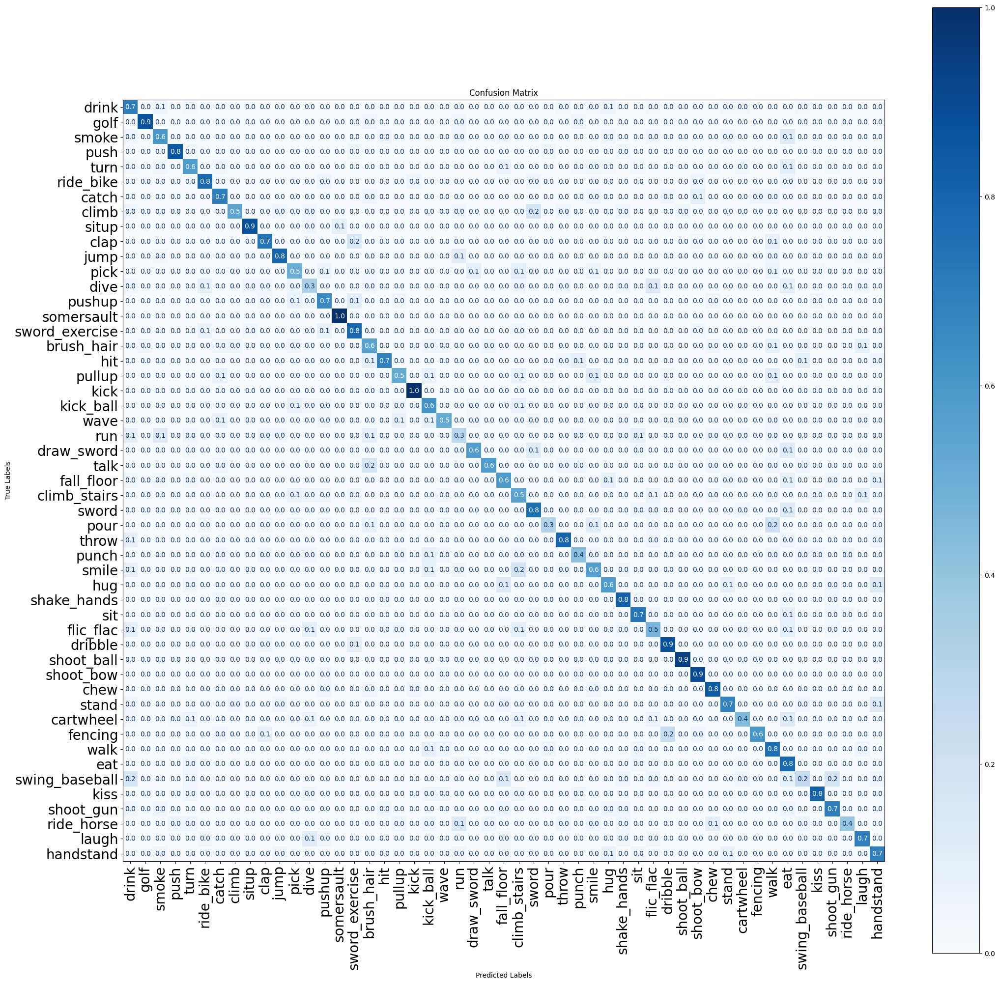

07/24 10:20:53 - mmengine - INFO - Epoch(val) [44][153/153]    acc/top1: 0.6627  acc/top5: 0.8621  acc/mean1: 0.6581  loss/loss: 3.3235  data_time: 3.8766  time: 4.2258
07/24 10:20:53 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_42.pth is removed
07/24 10:20:53 - mmengine - INFO - The best checkpoint with 0.6627 acc/top1 at 44 epoch is saved to best_acc_top1_epoch_44.pth.
07/24 10:24:19 - mmengine - INFO - Epoch(train) [45][ 20/179]  base_lr: 2.4702e-04 lr: 2.5233e-05  eta: 9:13:59  time: 8.1169  data_time: 4.5127  memory: 34294  loss: 0.0487  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0487
07/24 10:26:53 - mmengine - INFO - Epoch(train) [45][ 40/179]  base_lr: 2.4702e-04 lr: 2.5233e-05  eta: 9:11:41  time: 7.4625  data_time: 3.7961  memory: 34294  loss: 0.0398  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0398
07/24 10:28:48 - mmengine - INFO - Epoch(train) [45][ 60/179]  base_lr: 2.4702e-04 lr: 2.5233e-05

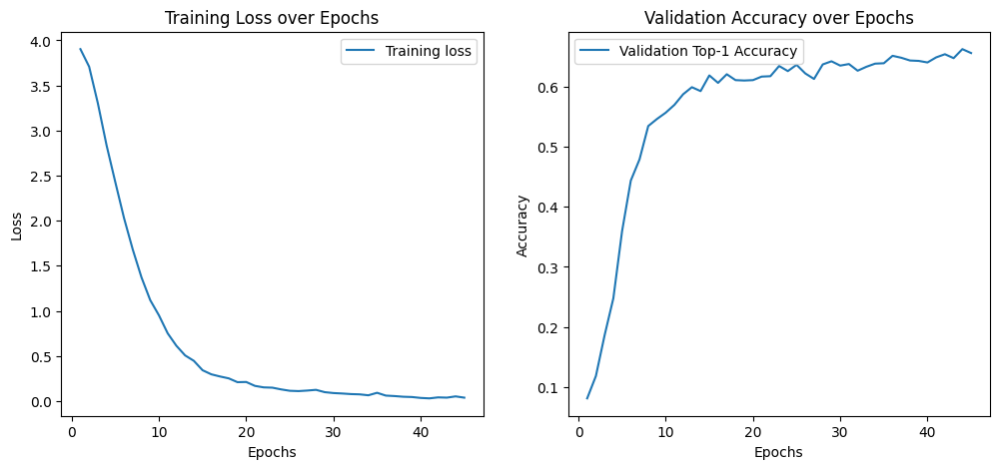

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719ceb460>


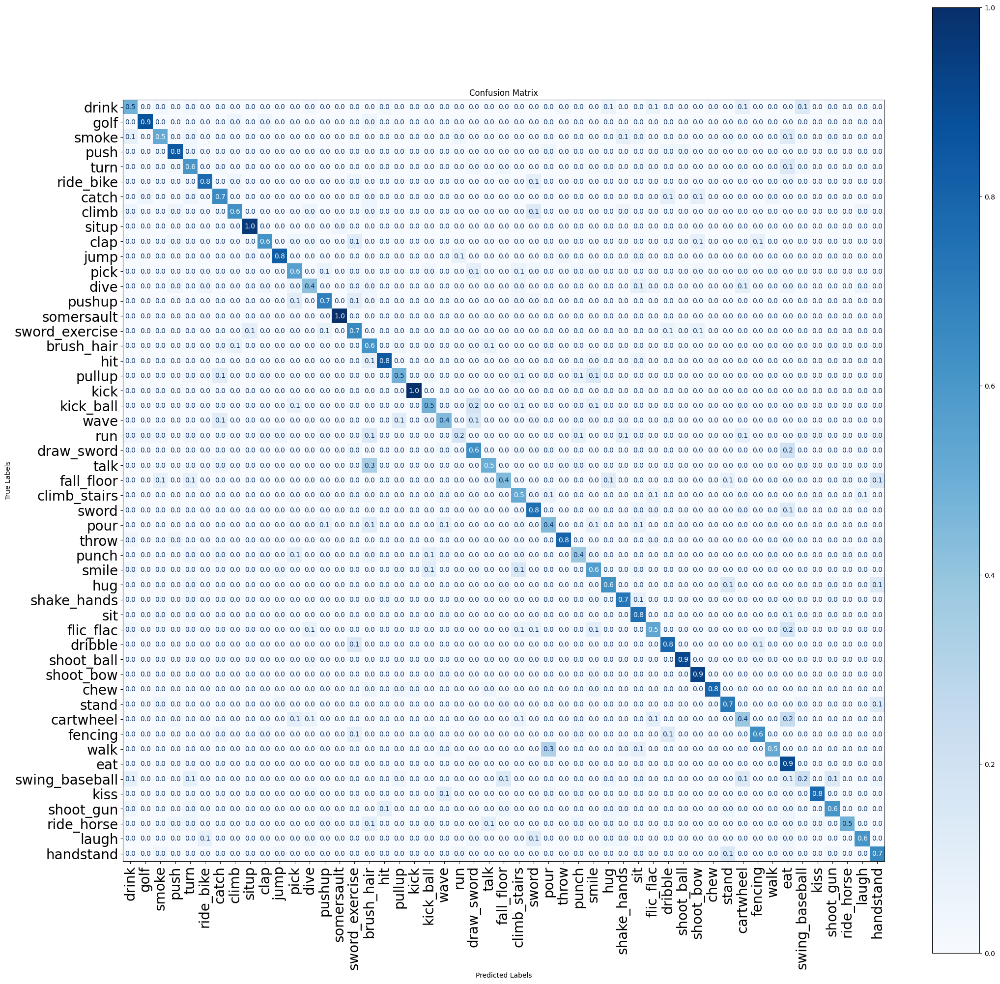

07/24 10:53:44 - mmengine - INFO - Epoch(val) [45][153/153]    acc/top1: 0.6562  acc/top5: 0.8595  acc/mean1: 0.6426  loss/loss: 3.3218  data_time: 3.7706  time: 4.1172
07/24 10:56:51 - mmengine - INFO - Epoch(train) [46][ 20/179]  base_lr: 2.3385e-04 lr: 2.3936e-05  eta: 8:52:48  time: 7.2826  data_time: 3.7238  memory: 34294  loss: 0.0315  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0315
07/24 10:59:39 - mmengine - INFO - Epoch(train) [46][ 40/179]  base_lr: 2.3385e-04 lr: 2.3936e-05  eta: 8:50:38  time: 9.0691  data_time: 5.5101  memory: 34294  loss: 0.0675  top1_acc: 0.9500  top5_acc: 0.9500  loss_cls: 0.0675
07/24 11:01:37 - mmengine - INFO - Epoch(train) [46][ 60/179]  base_lr: 2.3385e-04 lr: 2.3936e-05  eta: 8:48:00  time: 3.5759  data_time: 0.0037  memory: 34294  loss: 0.0151  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0151
07/24 11:04:04 - mmengine - INFO - Epoch(train) [46][ 80/179]  base_lr: 2.3385e-04 lr: 2.3936e-05  eta: 8:45:38  time: 6.8068  data_time: 3.2344  m

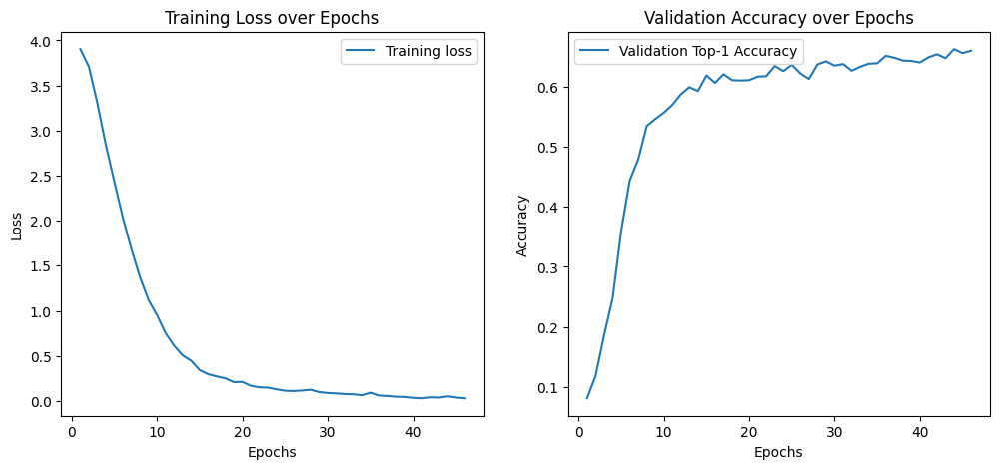

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a3477c0>


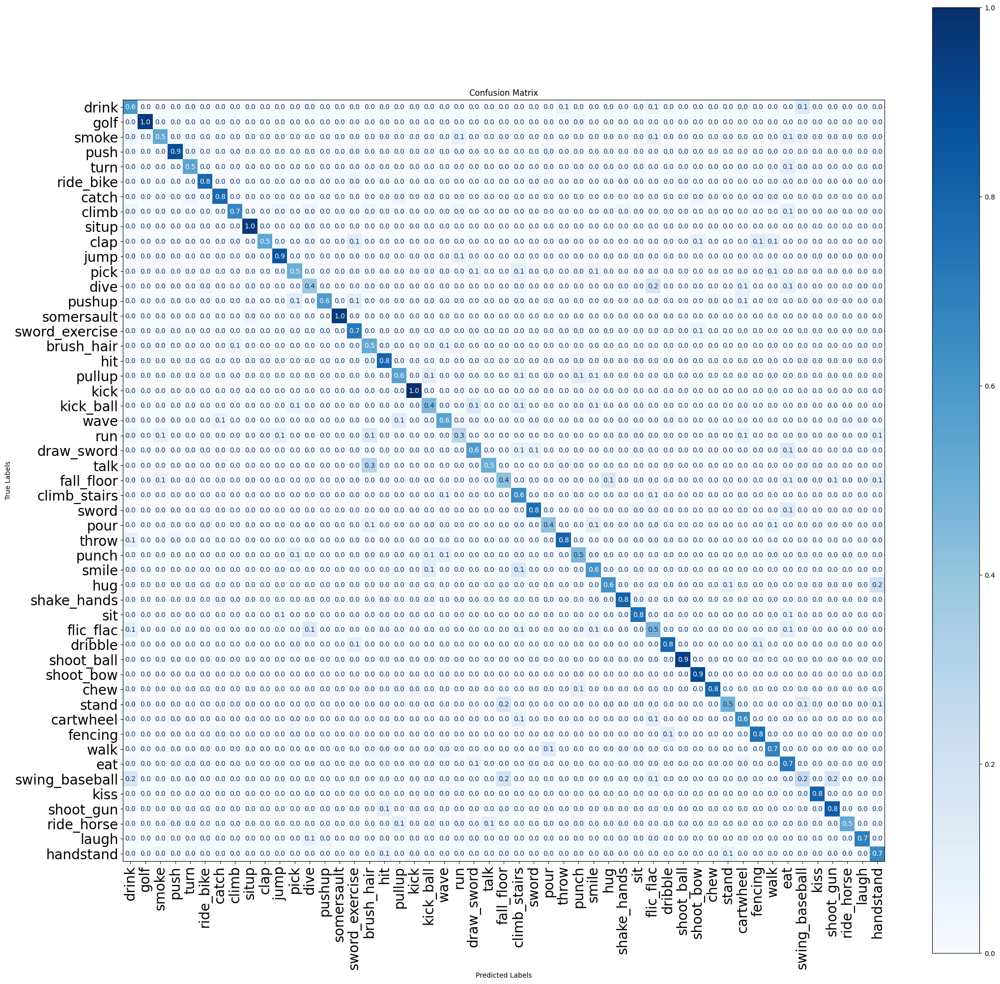

07/24 11:25:54 - mmengine - INFO - Epoch(val) [46][153/153]    acc/top1: 0.6601  acc/top5: 0.8608  acc/mean1: 0.6607  loss/loss: 3.3201  data_time: 3.9822  time: 4.3291
07/24 11:29:15 - mmengine - INFO - Epoch(train) [47][ 20/179]  base_lr: 2.2082e-04 lr: 2.2652e-05  eta: 8:31:20  time: 7.5206  data_time: 3.8962  memory: 34294  loss: 0.0178  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0178
07/24 11:31:54 - mmengine - INFO - Epoch(train) [47][ 40/179]  base_lr: 2.2082e-04 lr: 2.2652e-05  eta: 8:29:05  time: 7.3974  data_time: 3.7881  memory: 34294  loss: 0.0163  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0163
07/24 11:33:59 - mmengine - INFO - Epoch(train) [47][ 60/179]  base_lr: 2.2082e-04 lr: 2.2652e-05  eta: 8:26:32  time: 3.6642  data_time: 0.0092  memory: 34294  loss: 0.0232  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0232
07/24 11:36:29 - mmengine - INFO - Epoch(train) [47][ 80/179]  base_lr: 2.2082e-04 lr: 2.2652e-05  eta: 8:24:12  time: 8.5826  data_time: 4.9407  m

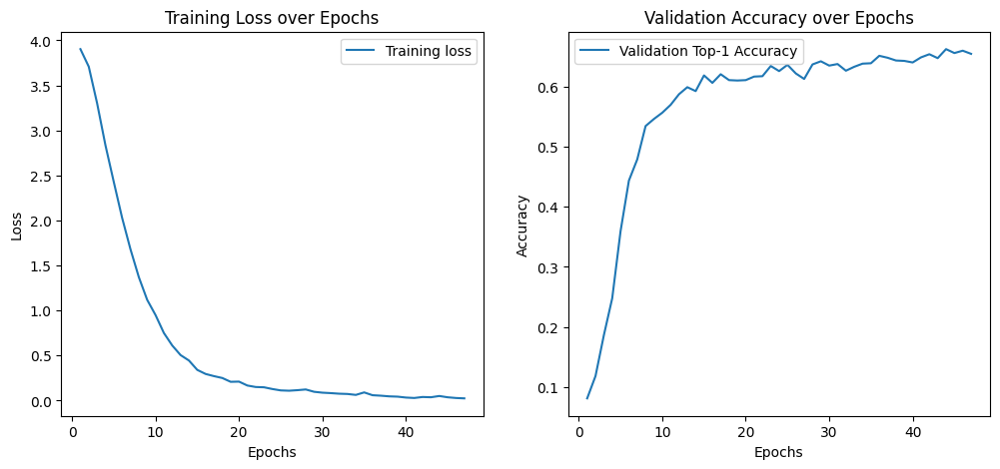

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a11ba60>


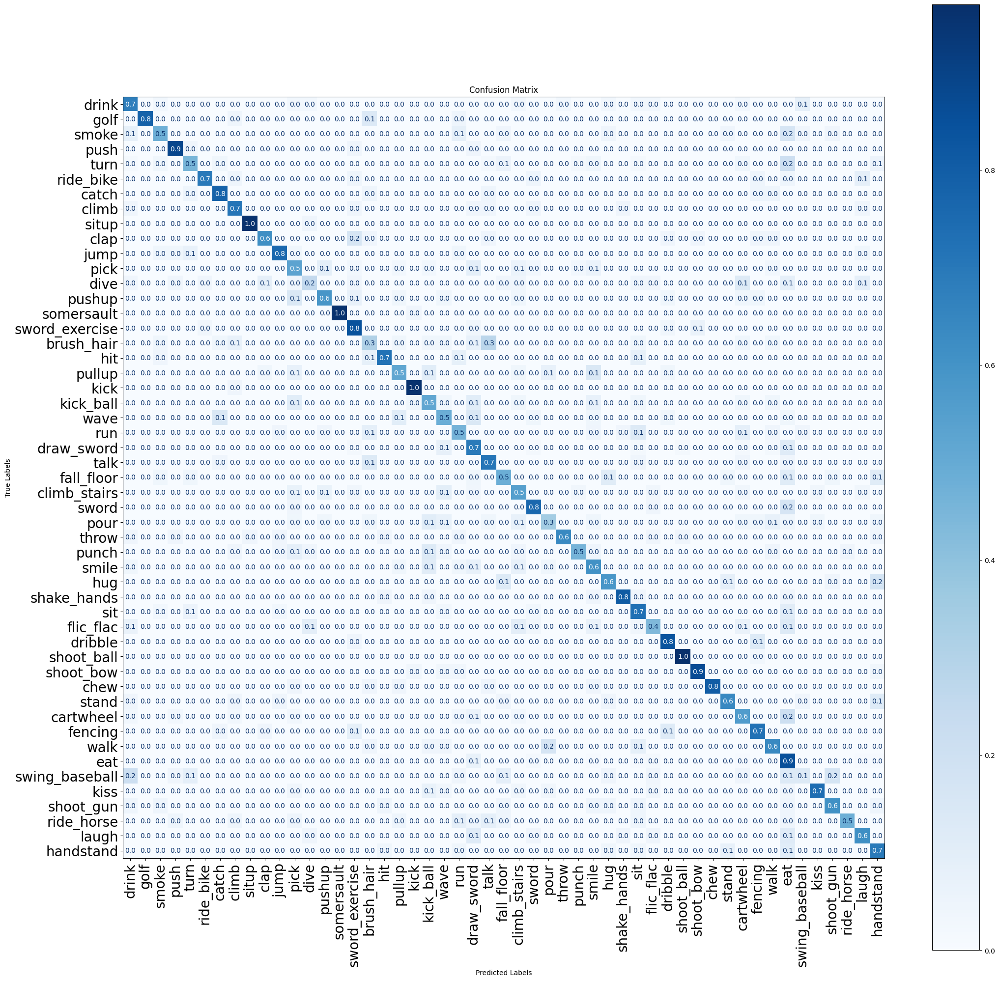

07/24 11:58:18 - mmengine - INFO - Epoch(val) [47][153/153]    acc/top1: 0.6549  acc/top5: 0.8556  acc/mean1: 0.6445  loss/loss: 3.3194  data_time: 3.9168  time: 4.2620
07/24 12:01:45 - mmengine - INFO - Epoch(train) [48][ 20/179]  base_lr: 2.0795e-04 lr: 2.1384e-05  eta: 8:09:59  time: 8.0030  data_time: 4.4392  memory: 34294  loss: 0.0490  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0490
07/24 12:04:19 - mmengine - INFO - Epoch(train) [48][ 40/179]  base_lr: 2.0795e-04 lr: 2.1384e-05  eta: 8:07:40  time: 7.6622  data_time: 4.0804  memory: 34294  loss: 0.0604  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0604
07/24 12:06:10 - mmengine - INFO - Epoch(train) [48][ 60/179]  base_lr: 2.0795e-04 lr: 2.1384e-05  eta: 8:05:01  time: 3.6360  data_time: 0.0072  memory: 34294  loss: 0.0289  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0289
07/24 12:08:30 - mmengine - INFO - Epoch(train) [48][ 80/179]  base_lr: 2.0795e-04 lr: 2.1384e-05  eta: 8:02:36  time: 7.7509  data_time: 4.1184  m

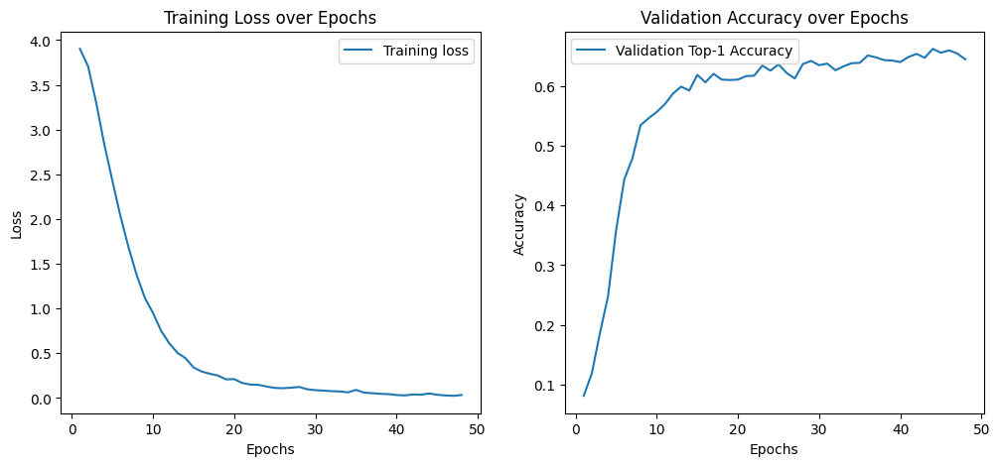

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77194c3a90>


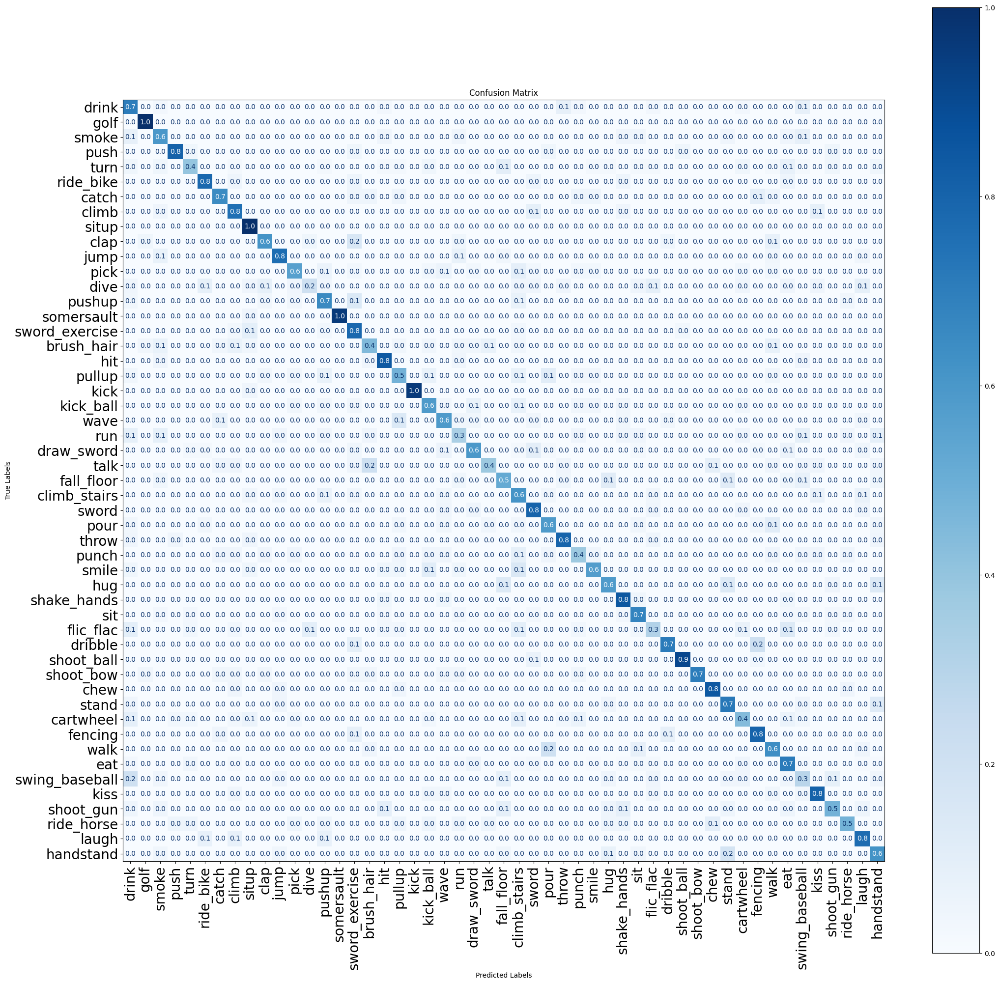

07/24 12:31:24 - mmengine - INFO - Epoch(val) [48][153/153]    acc/top1: 0.6451  acc/top5: 0.8510  acc/mean1: 0.6476  loss/loss: 3.3197  data_time: 3.8484  time: 4.1953
07/24 12:34:31 - mmengine - INFO - Epoch(train) [49][ 20/179]  base_lr: 1.9526e-04 lr: 2.0134e-05  eta: 7:48:47  time: 6.9751  data_time: 3.4031  memory: 34294  loss: 0.0210  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0210
07/24 12:36:56 - mmengine - INFO - Epoch(train) [49][ 40/179]  base_lr: 1.9526e-04 lr: 2.0134e-05  eta: 7:46:24  time: 7.1754  data_time: 3.5575  memory: 34294  loss: 0.0171  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0171
07/24 12:38:53 - mmengine - INFO - Epoch(train) [49][ 60/179]  base_lr: 1.9526e-04 lr: 2.0134e-05  eta: 7:43:48  time: 3.9845  data_time: 0.4179  memory: 34294  loss: 0.0061  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0061
07/24 12:41:14 - mmengine - INFO - Epoch(train) [49][ 80/179]  base_lr: 1.9526e-04 lr: 2.0134e-05  eta: 7:41:24  time: 7.3553  data_time: 3.7723  m

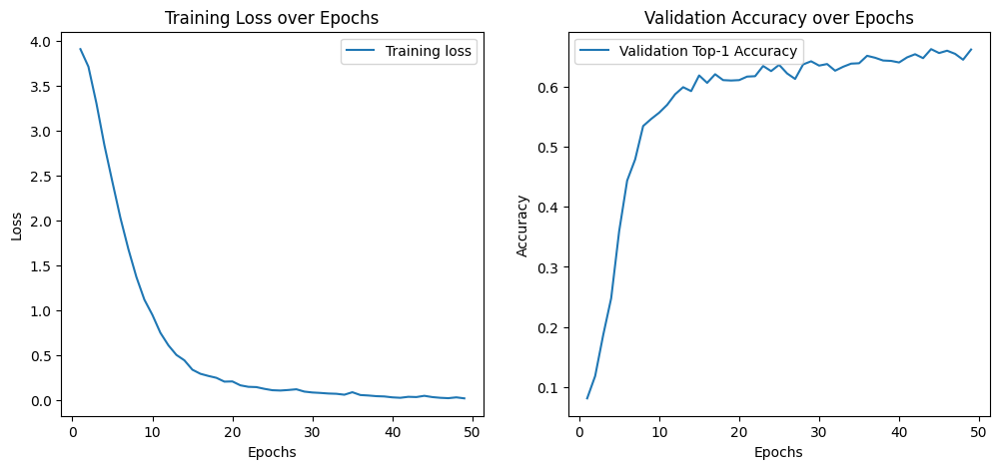

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719cbed00>


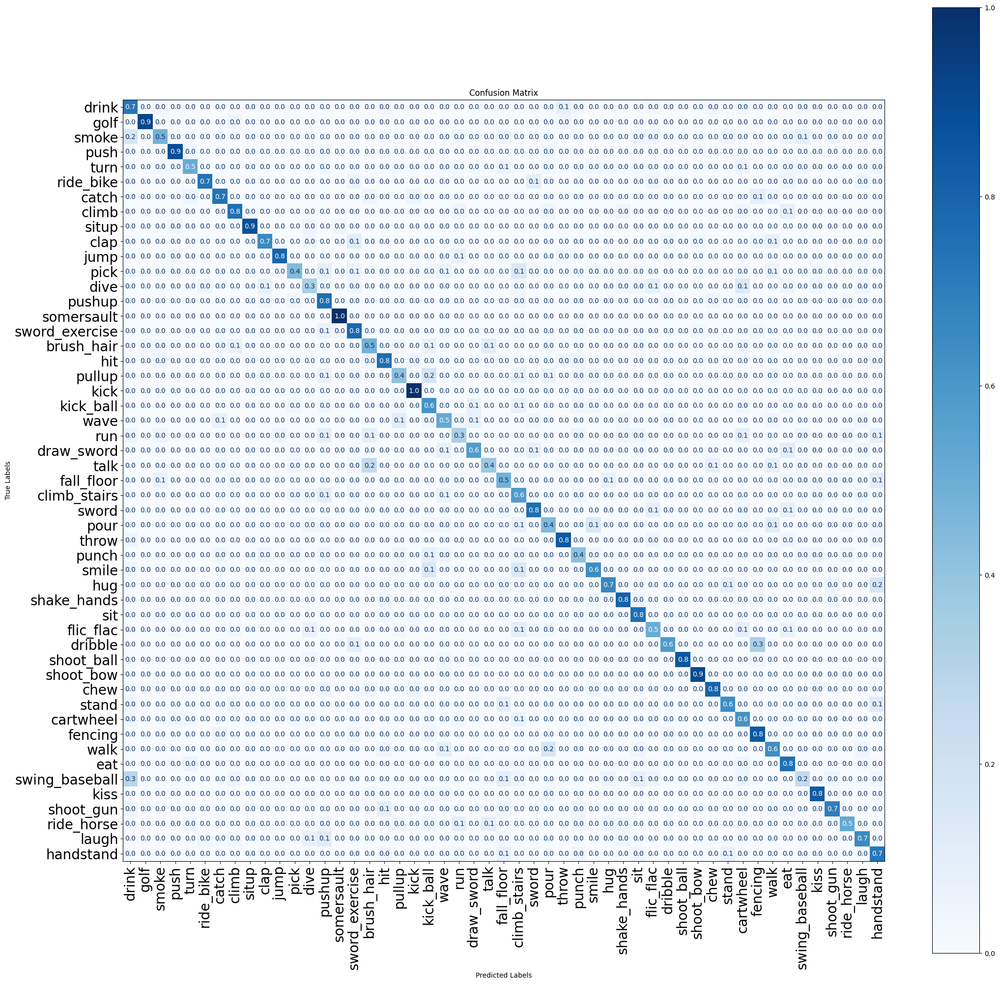

07/24 13:03:28 - mmengine - INFO - Epoch(val) [49][153/153]    acc/top1: 0.6621  acc/top5: 0.8510  acc/mean1: 0.6601  loss/loss: 3.3178  data_time: 3.8364  time: 4.1824
07/24 13:06:44 - mmengine - INFO - Epoch(train) [50][ 20/179]  base_lr: 1.8279e-04 lr: 1.8906e-05  eta: 7:27:19  time: 7.7019  data_time: 4.0942  memory: 34294  loss: 0.0568  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0568
07/24 13:09:02 - mmengine - INFO - Epoch(train) [50][ 40/179]  base_lr: 1.8279e-04 lr: 1.8906e-05  eta: 7:24:53  time: 6.9183  data_time: 3.3117  memory: 34294  loss: 0.0039  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0039
07/24 13:10:59 - mmengine - INFO - Epoch(train) [50][ 60/179]  base_lr: 1.8279e-04 lr: 1.8906e-05  eta: 7:22:18  time: 5.0874  data_time: 1.4426  memory: 34294  loss: 0.0224  top1_acc: 0.9000  top5_acc: 1.0000  loss_cls: 0.0224
07/24 13:13:28 - mmengine - INFO - Epoch(train) [50][ 80/179]  base_lr: 1.8279e-04 lr: 1.8906e-05  eta: 7:19:57  time: 7.8398  data_time: 4.2499  m

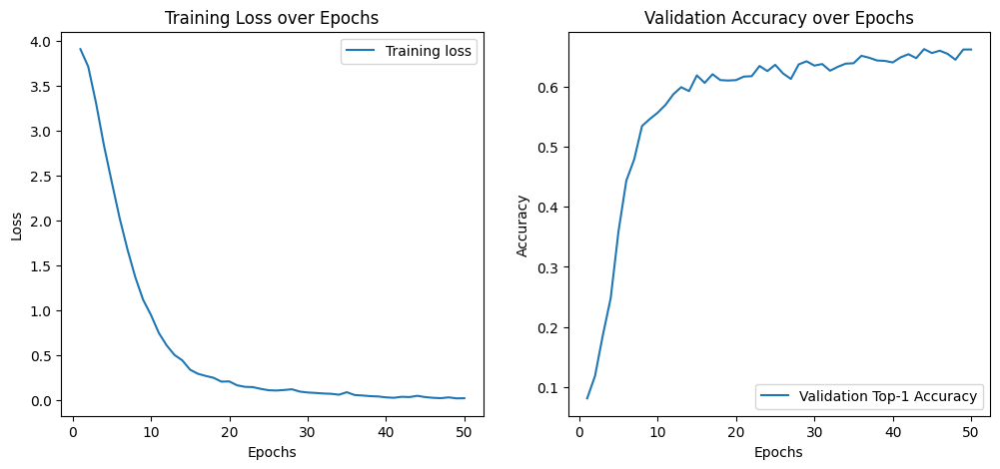

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719159970>


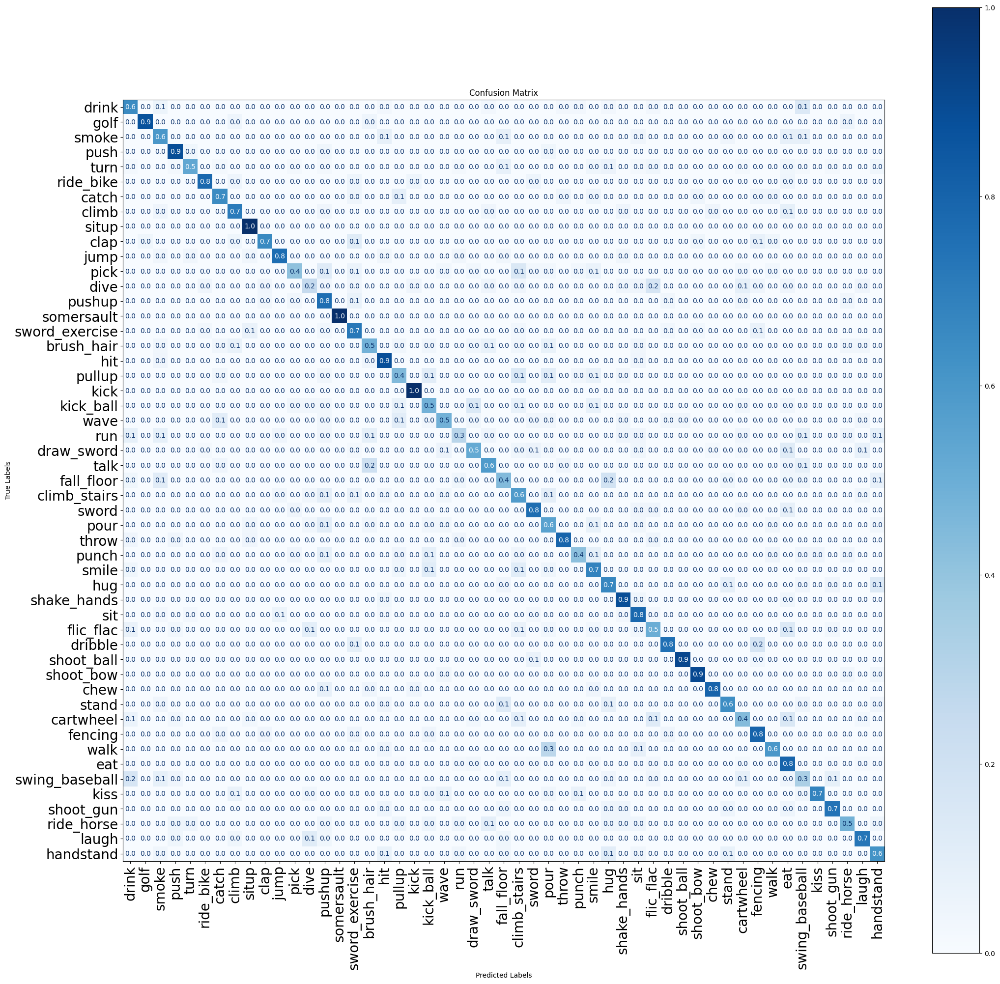

07/24 13:36:40 - mmengine - INFO - Epoch(val) [50][153/153]    acc/top1: 0.6621  acc/top5: 0.8660  acc/mean1: 0.6604  loss/loss: 3.3154  data_time: 3.9092  time: 4.2551
07/24 13:40:07 - mmengine - INFO - Epoch(train) [51][ 20/179]  base_lr: 1.7055e-04 lr: 1.7700e-05  eta: 7:06:14  time: 8.5874  data_time: 4.9515  memory: 34294  loss: 0.0130  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0130
07/24 13:42:46 - mmengine - INFO - Epoch(train) [51][ 40/179]  base_lr: 1.7055e-04 lr: 1.7700e-05  eta: 7:03:57  time: 7.8023  data_time: 4.1479  memory: 34294  loss: 0.0182  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0182
07/24 13:43:58 - mmengine - INFO - Exp name: 20240723_102956
07/24 13:44:40 - mmengine - INFO - Epoch(train) [51][ 60/179]  base_lr: 1.7055e-04 lr: 1.7700e-05  eta: 7:01:21  time: 4.1638  data_time: 0.5224  memory: 34294  loss: 0.0206  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0206
07/24 13:47:11 - mmengine - INFO - Epoch(train) [51][ 80/179]  base_lr: 1.7055e-04 lr:

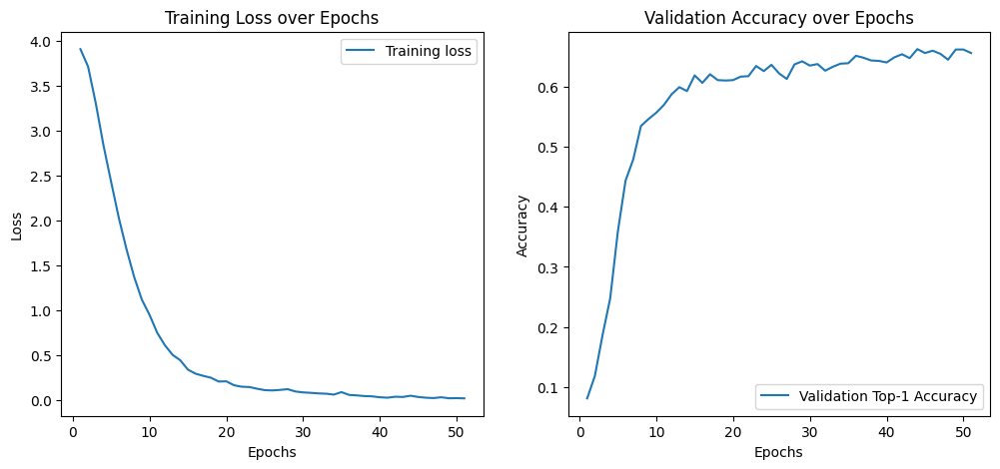

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771ab32220>


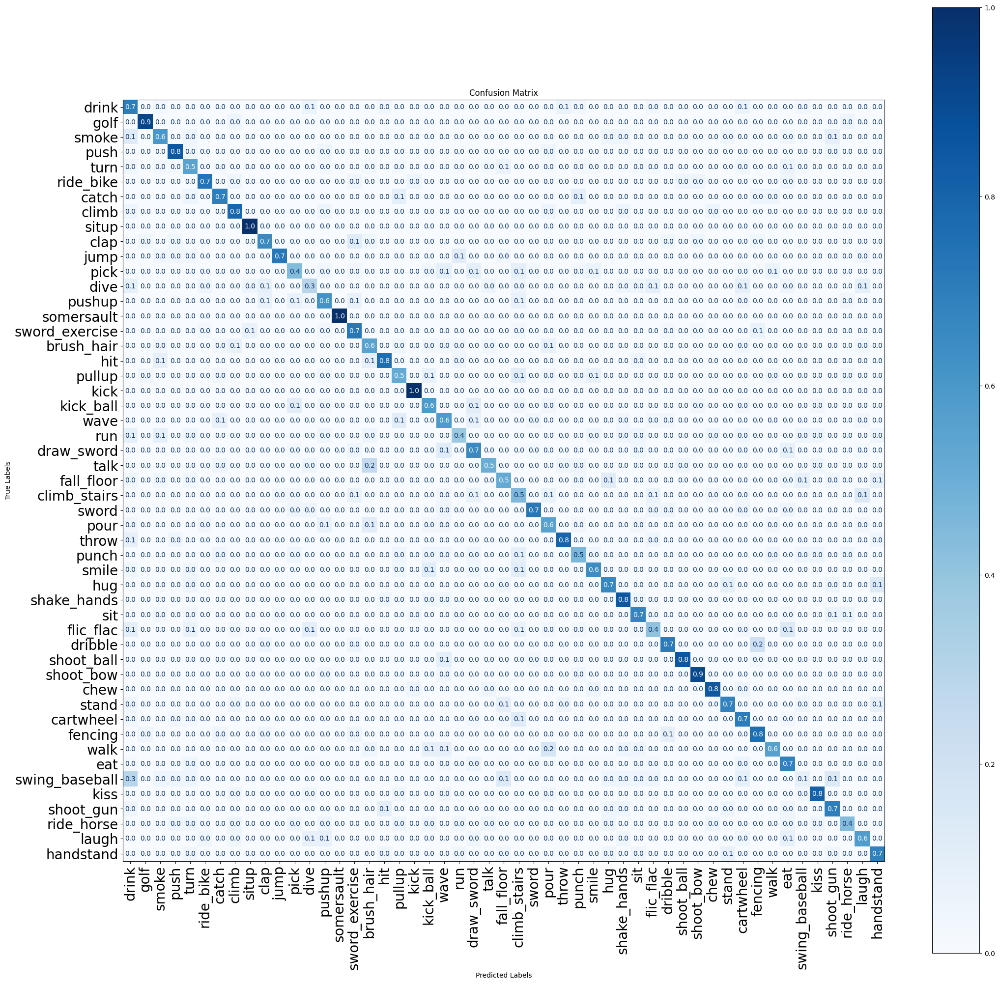

07/24 14:09:43 - mmengine - INFO - Epoch(val) [51][153/153]    acc/top1: 0.6562  acc/top5: 0.8608  acc/mean1: 0.6574  loss/loss: 3.3149  data_time: 4.0099  time: 4.3563
07/24 14:12:51 - mmengine - INFO - Epoch(train) [52][ 20/179]  base_lr: 1.5858e-04 lr: 1.6521e-05  eta: 6:44:50  time: 7.6062  data_time: 4.0375  memory: 34294  loss: 0.0109  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0109
07/24 14:15:15 - mmengine - INFO - Epoch(train) [52][ 40/179]  base_lr: 1.5858e-04 lr: 1.6521e-05  eta: 6:42:27  time: 7.0695  data_time: 3.4776  memory: 34294  loss: 0.0087  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0087
07/24 14:17:14 - mmengine - INFO - Epoch(train) [52][ 60/179]  base_lr: 1.5858e-04 lr: 1.6521e-05  eta: 6:39:54  time: 4.7308  data_time: 1.0966  memory: 34294  loss: 0.0192  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0192
07/24 14:19:32 - mmengine - INFO - Epoch(train) [52][ 80/179]  base_lr: 1.5858e-04 lr: 1.6521e-05  eta: 6:37:28  time: 6.8910  data_time: 3.2505  m

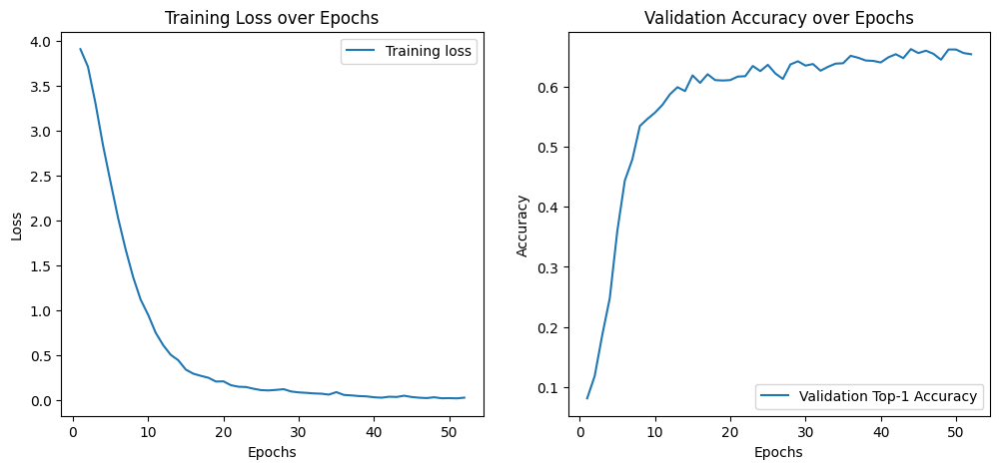

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77193a8130>


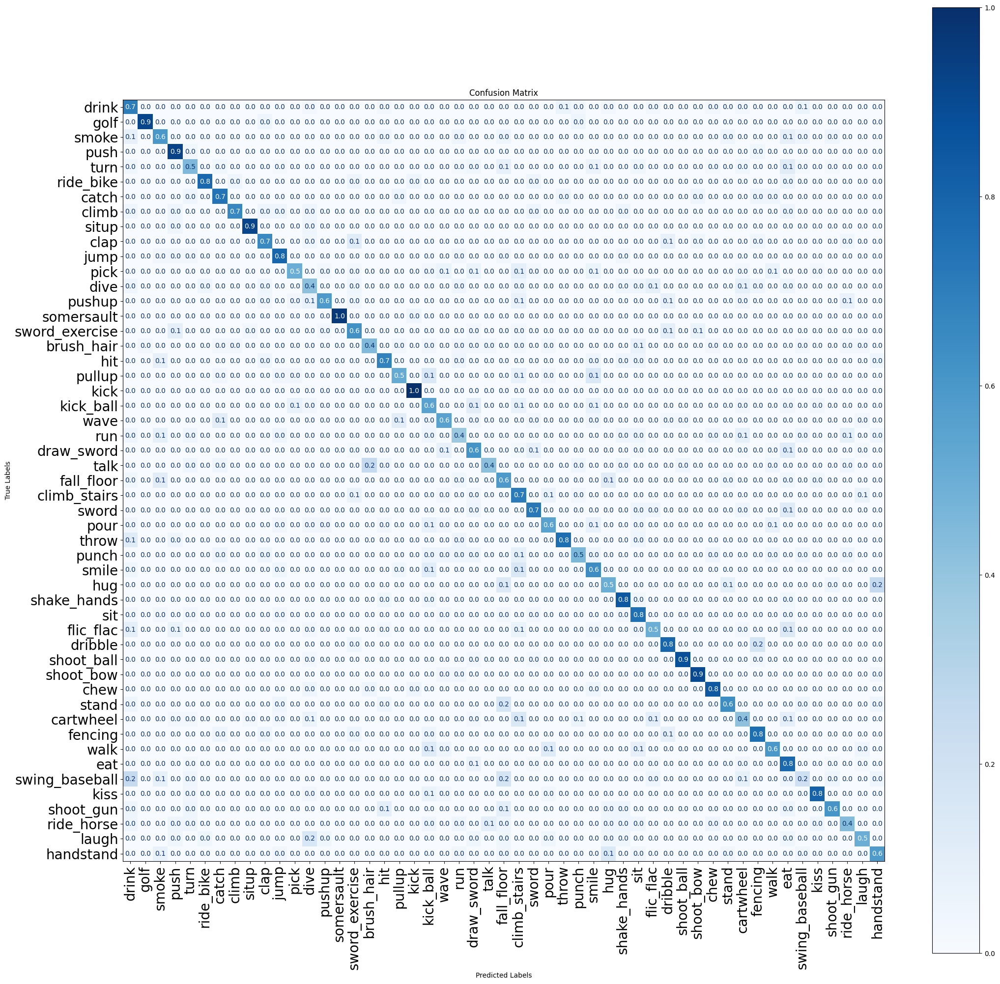

07/24 14:41:13 - mmengine - INFO - Epoch(val) [52][153/153]    acc/top1: 0.6542  acc/top5: 0.8627  acc/mean1: 0.6504  loss/loss: 3.3148  data_time: 3.8168  time: 4.1619
07/24 14:44:18 - mmengine - INFO - Epoch(train) [53][ 20/179]  base_lr: 1.4689e-04 lr: 1.5369e-05  eta: 6:23:08  time: 6.8891  data_time: 3.2513  memory: 34294  loss: 0.0399  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0399
07/24 14:46:45 - mmengine - INFO - Epoch(train) [53][ 40/179]  base_lr: 1.4689e-04 lr: 1.5369e-05  eta: 6:20:46  time: 5.1451  data_time: 1.5123  memory: 34294  loss: 0.0041  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0041
07/24 14:49:13 - mmengine - INFO - Epoch(train) [53][ 60/179]  base_lr: 1.4689e-04 lr: 1.5369e-05  eta: 6:18:23  time: 6.0062  data_time: 2.3790  memory: 34294  loss: 0.0337  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0337
07/24 14:51:30 - mmengine - INFO - Epoch(train) [53][ 80/179]  base_lr: 1.4689e-04 lr: 1.5369e-05  eta: 6:15:57  time: 7.0444  data_time: 3.4142  m

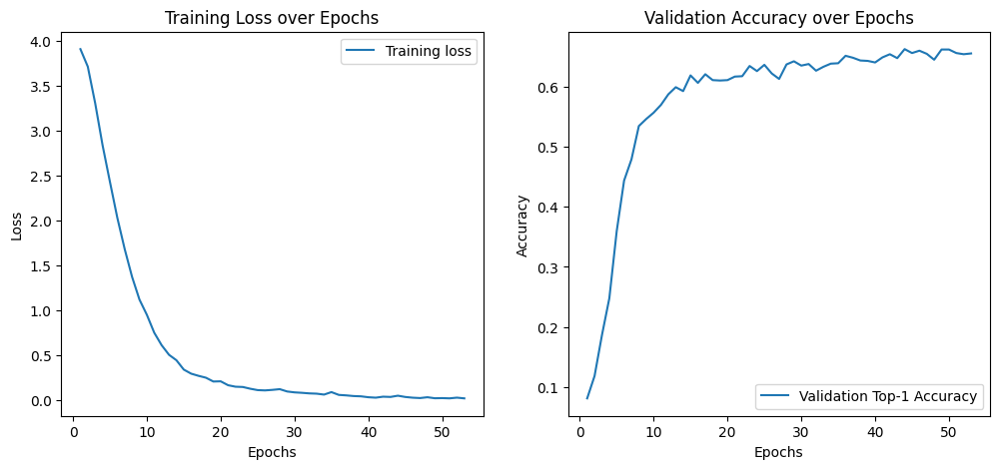

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771a167790>


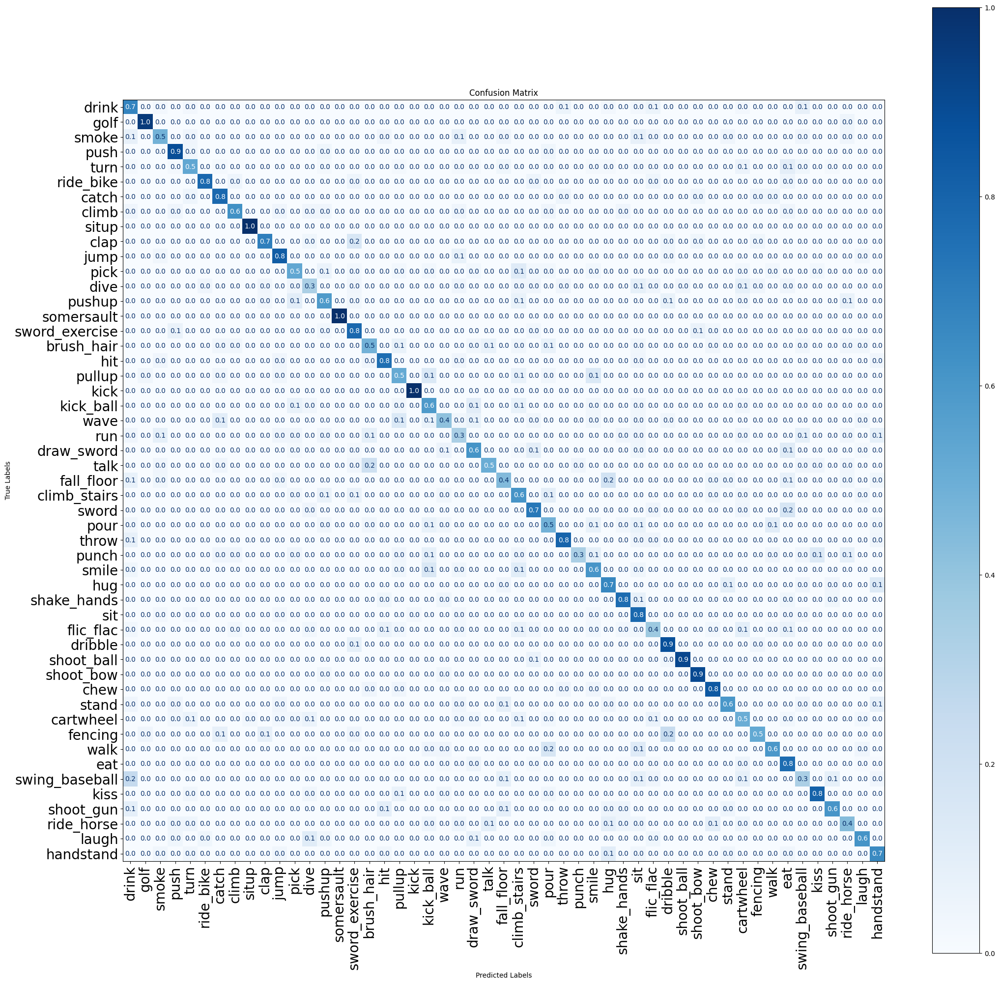

07/24 15:14:54 - mmengine - INFO - Epoch(val) [53][153/153]    acc/top1: 0.6556  acc/top5: 0.8706  acc/mean1: 0.6516  loss/loss: 3.3138  data_time: 3.9575  time: 4.3017
07/24 15:18:13 - mmengine - INFO - Epoch(train) [54][ 20/179]  base_lr: 1.3551e-04 lr: 1.4249e-05  eta: 6:02:08  time: 8.1197  data_time: 4.5564  memory: 34294  loss: 0.0079  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0079
07/24 15:20:42 - mmengine - INFO - Epoch(train) [54][ 40/179]  base_lr: 1.3551e-04 lr: 1.4249e-05  eta: 5:59:46  time: 7.2486  data_time: 3.6821  memory: 34294  loss: 0.0168  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0168
07/24 15:22:35 - mmengine - INFO - Epoch(train) [54][ 60/179]  base_lr: 1.3551e-04 lr: 1.4249e-05  eta: 5:57:13  time: 4.4160  data_time: 0.8457  memory: 34294  loss: 0.0216  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0216
07/24 15:25:06 - mmengine - INFO - Epoch(train) [54][ 80/179]  base_lr: 1.3551e-04 lr: 1.4249e-05  eta: 5:54:51  time: 8.1997  data_time: 4.5767  m

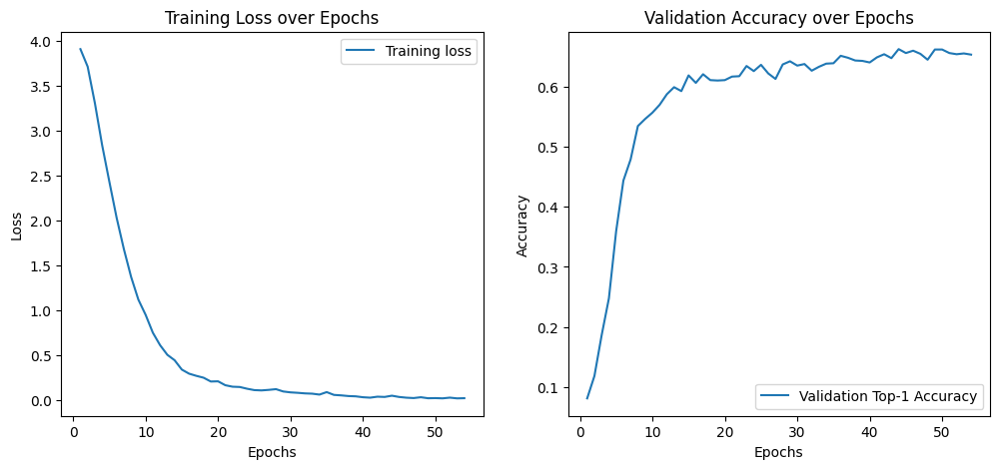

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719550f10>


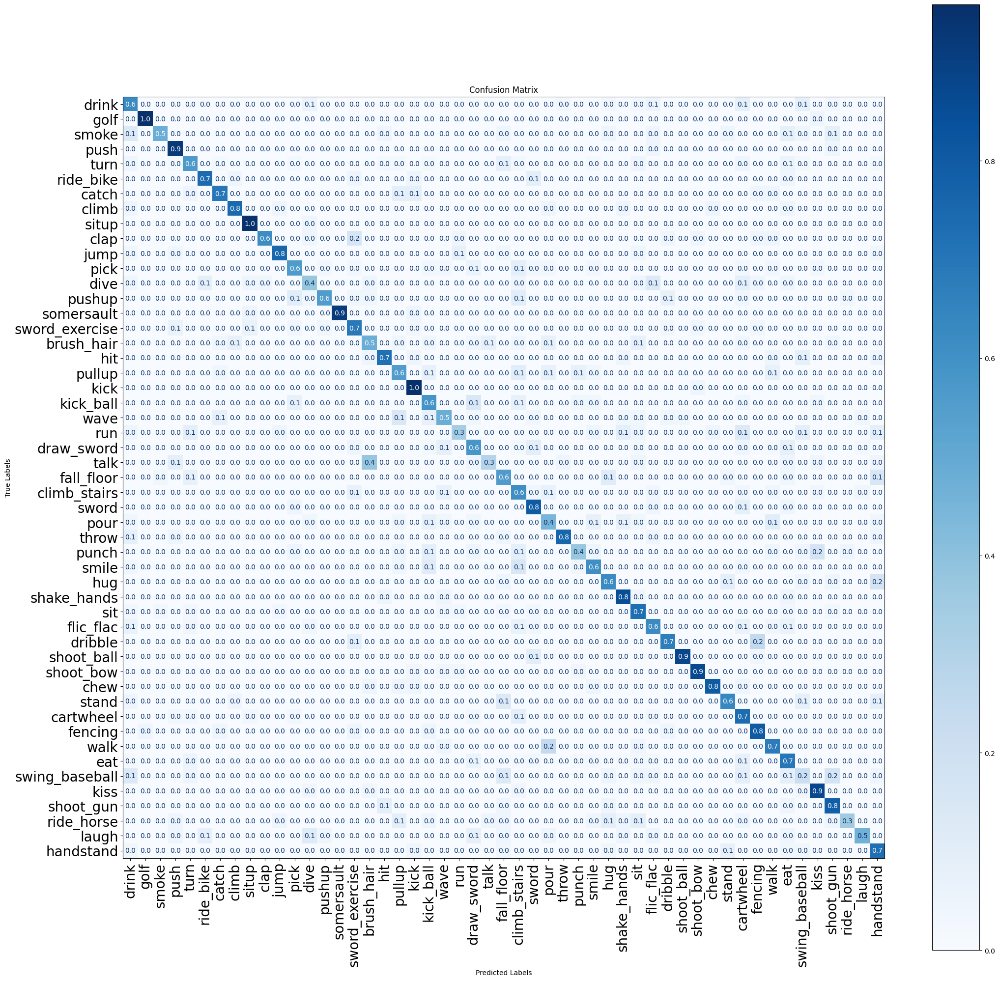

07/24 15:46:49 - mmengine - INFO - Epoch(val) [54][153/153]    acc/top1: 0.6536  acc/top5: 0.8510  acc/mean1: 0.6525  loss/loss: 3.3145  data_time: 3.7909  time: 4.1364
07/24 15:50:13 - mmengine - INFO - Epoch(train) [55][ 20/179]  base_lr: 1.2446e-04 lr: 1.3160e-05  eta: 5:40:42  time: 7.9902  data_time: 4.3935  memory: 34294  loss: 0.0336  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0336
07/24 15:53:11 - mmengine - INFO - Epoch(train) [55][ 40/179]  base_lr: 1.2446e-04 lr: 1.3160e-05  eta: 5:38:28  time: 8.3093  data_time: 4.7422  memory: 34294  loss: 0.0131  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0131
07/24 15:55:03 - mmengine - INFO - Epoch(train) [55][ 60/179]  base_lr: 1.2446e-04 lr: 1.3160e-05  eta: 5:35:55  time: 3.6190  data_time: 0.0035  memory: 34294  loss: 0.0233  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0233
07/24 15:57:58 - mmengine - INFO - Epoch(train) [55][ 80/179]  base_lr: 1.2446e-04 lr: 1.3160e-05  eta: 5:33:40  time: 7.3445  data_time: 3.7790  m

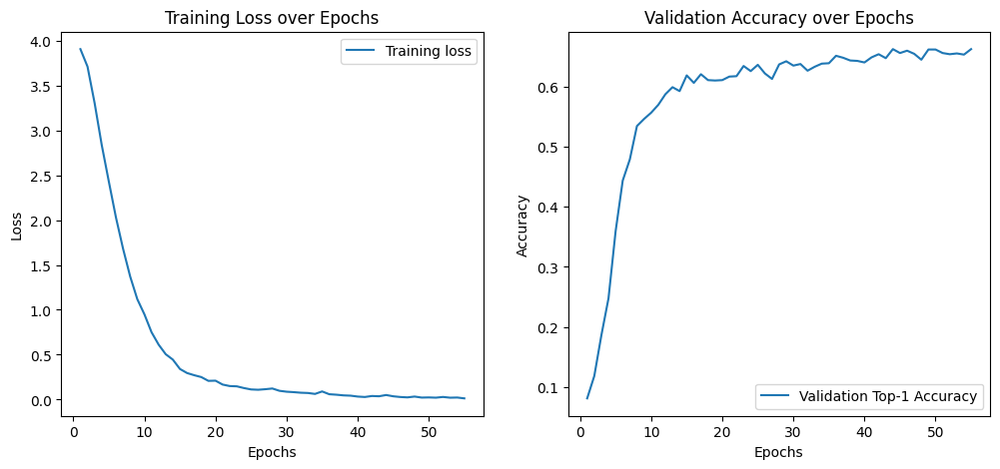

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771961ef40>


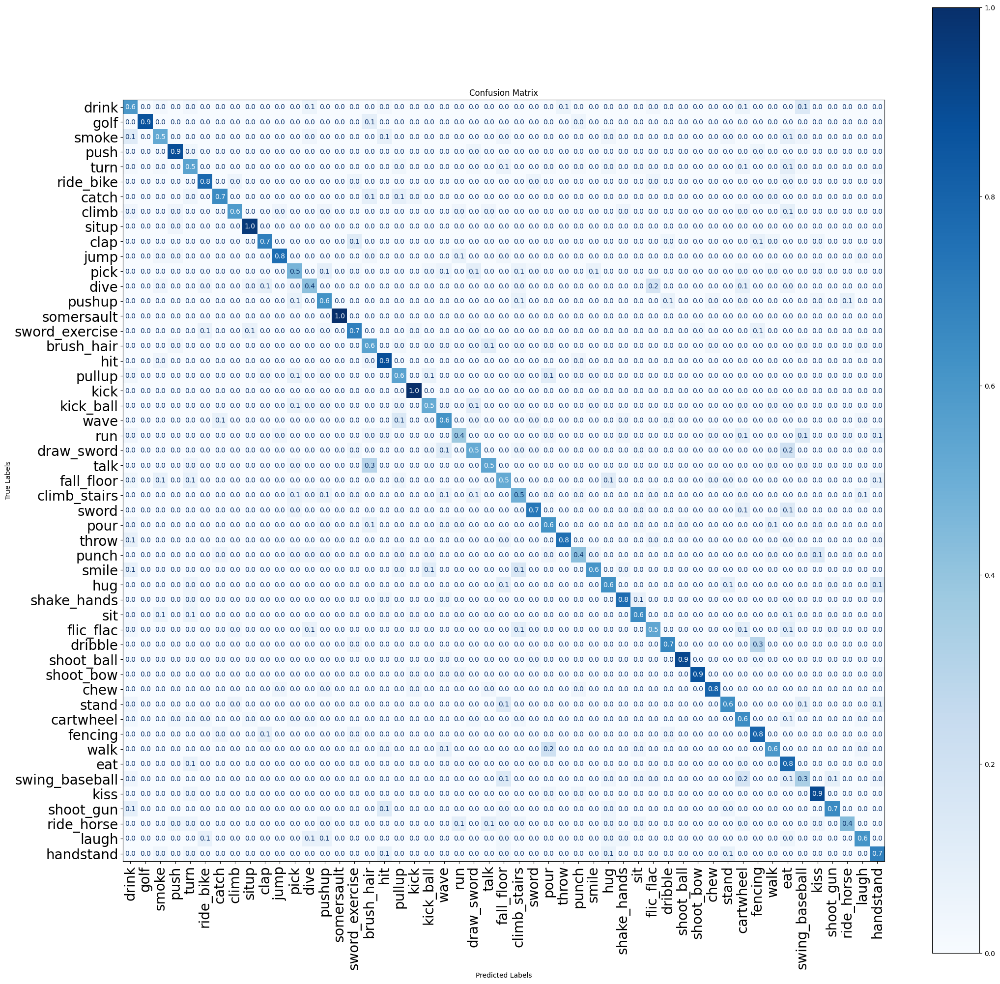

07/24 16:20:57 - mmengine - INFO - Epoch(val) [55][153/153]    acc/top1: 0.6627  acc/top5: 0.8621  acc/mean1: 0.6597  loss/loss: 3.3139  data_time: 4.1333  time: 4.4779
07/24 16:24:35 - mmengine - INFO - Epoch(train) [56][ 20/179]  base_lr: 1.1376e-04 lr: 1.2107e-05  eta: 5:19:36  time: 8.4792  data_time: 4.9227  memory: 34294  loss: 0.0044  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0044
07/24 16:27:09 - mmengine - INFO - Epoch(train) [56][ 40/179]  base_lr: 1.1376e-04 lr: 1.2107e-05  eta: 5:17:15  time: 7.6311  data_time: 4.0469  memory: 34294  loss: 0.0281  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0281
07/24 16:29:02 - mmengine - INFO - Epoch(train) [56][ 60/179]  base_lr: 1.1376e-04 lr: 1.2107e-05  eta: 5:14:43  time: 3.5777  data_time: 0.0033  memory: 34294  loss: 0.0200  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0200
07/24 16:31:32 - mmengine - INFO - Epoch(train) [56][ 80/179]  base_lr: 1.1376e-04 lr: 1.2107e-05  eta: 5:12:21  time: 7.5616  data_time: 3.8539  m

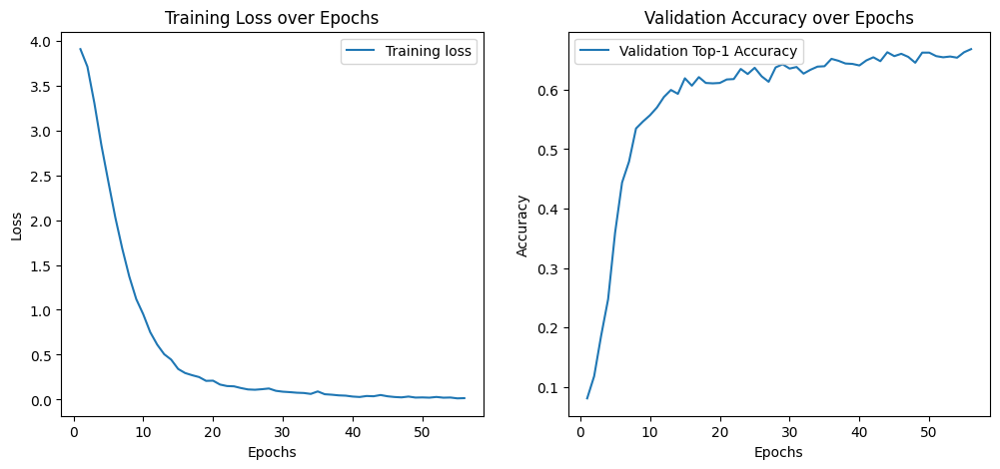

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771ae220d0>


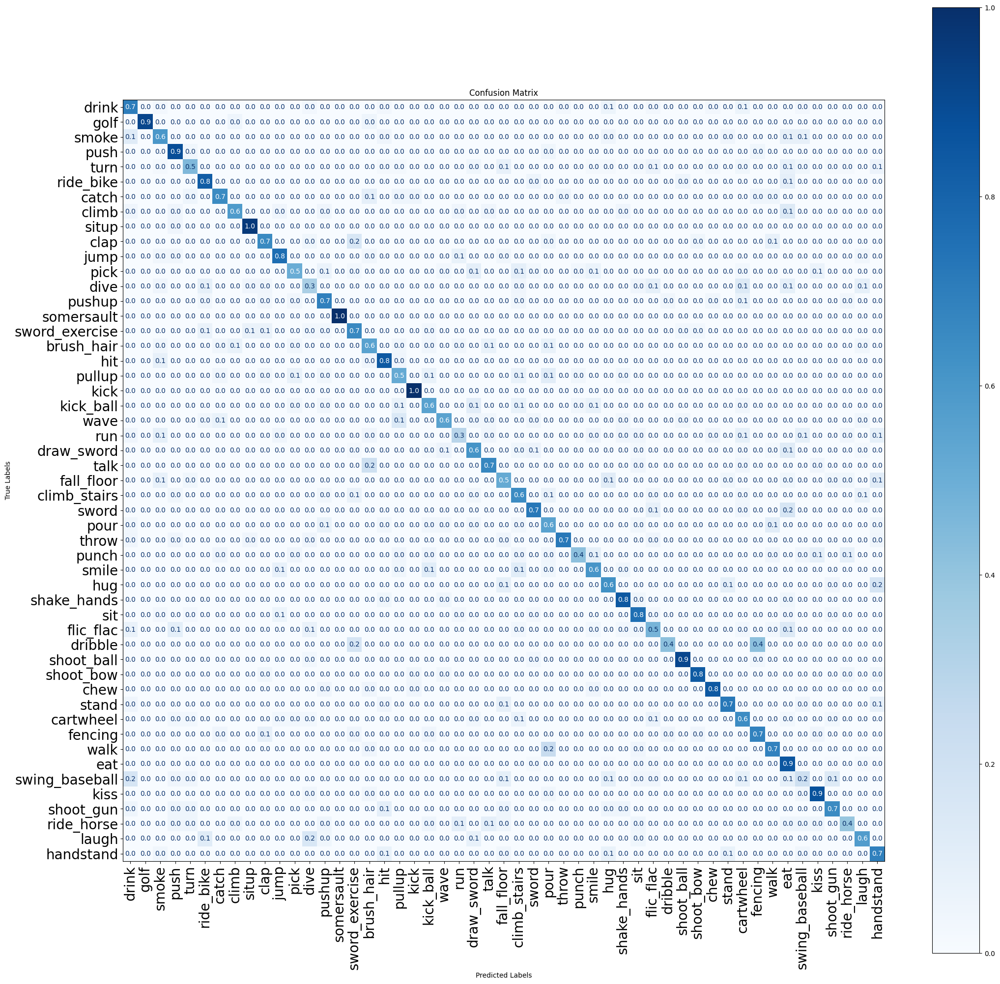

07/24 16:54:05 - mmengine - INFO - Epoch(val) [56][153/153]    acc/top1: 0.6680  acc/top5: 0.8516  acc/mean1: 0.6588  loss/loss: 3.3130  data_time: 3.9115  time: 4.2569
07/24 16:54:05 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_44.pth is removed
07/24 16:54:06 - mmengine - INFO - The best checkpoint with 0.6680 acc/top1 at 56 epoch is saved to best_acc_top1_epoch_56.pth.
07/24 16:57:21 - mmengine - INFO - Epoch(train) [57][ 20/179]  base_lr: 1.0345e-04 lr: 1.1091e-05  eta: 4:58:10  time: 7.9108  data_time: 4.2891  memory: 34294  loss: 0.0072  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0072
07/24 17:00:05 - mmengine - INFO - Epoch(train) [57][ 40/179]  base_lr: 1.0345e-04 lr: 1.1091e-05  eta: 4:55:51  time: 7.6729  data_time: 4.0856  memory: 34294  loss: 0.0062  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0062
07/24 17:01:57 - mmengine - INFO - Epoch(train) [57][ 60/179]  base_lr: 1.0345e-04 lr: 1.1091e-05

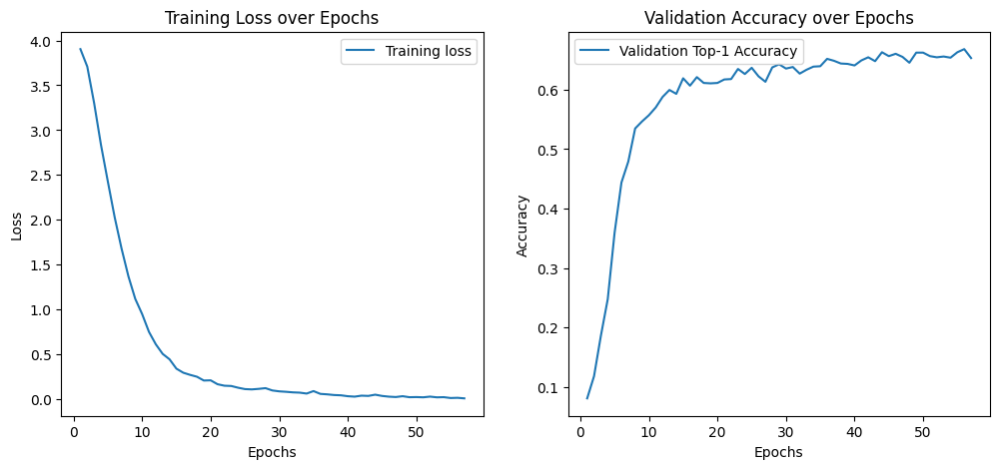

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771ad3be50>


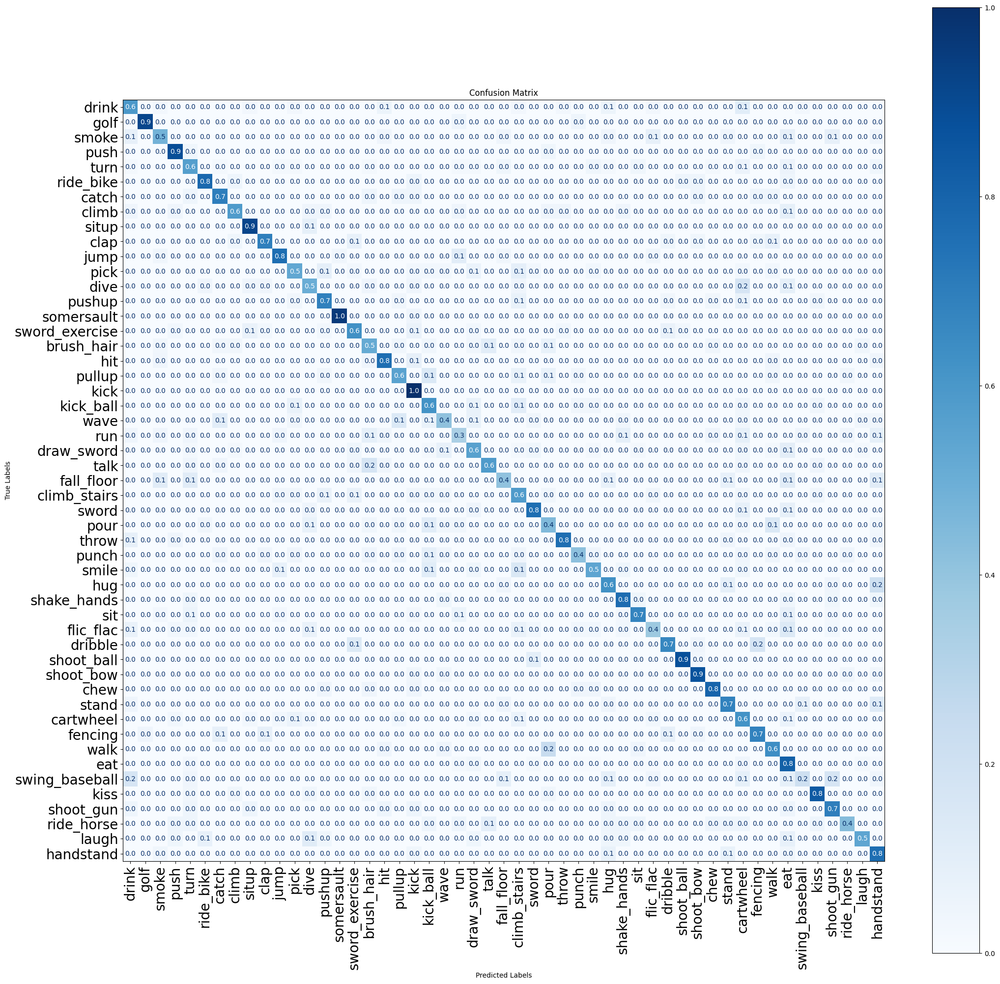

07/24 17:28:20 - mmengine - INFO - Epoch(val) [57][153/153]    acc/top1: 0.6529  acc/top5: 0.8542  acc/mean1: 0.6467  loss/loss: 3.3126  data_time: 4.1346  time: 4.4799
07/24 17:31:49 - mmengine - INFO - Epoch(train) [58][ 20/179]  base_lr: 9.3527e-05 lr: 1.0114e-05  eta: 4:37:01  time: 8.2183  data_time: 4.6565  memory: 34294  loss: 0.0236  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0236
07/24 17:34:06 - mmengine - INFO - Epoch(train) [58][ 40/179]  base_lr: 9.3527e-05 lr: 1.0114e-05  eta: 4:34:35  time: 6.4018  data_time: 2.8361  memory: 34294  loss: 0.0129  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0129
07/24 17:36:01 - mmengine - INFO - Epoch(train) [58][ 60/179]  base_lr: 9.3527e-05 lr: 1.0114e-05  eta: 4:32:05  time: 3.6044  data_time: 0.0045  memory: 34294  loss: 0.0157  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0157
07/24 17:38:28 - mmengine - INFO - Epoch(train) [58][ 80/179]  base_lr: 9.3527e-05 lr: 1.0114e-05  eta: 4:29:41  time: 6.7286  data_time: 3.1542  m

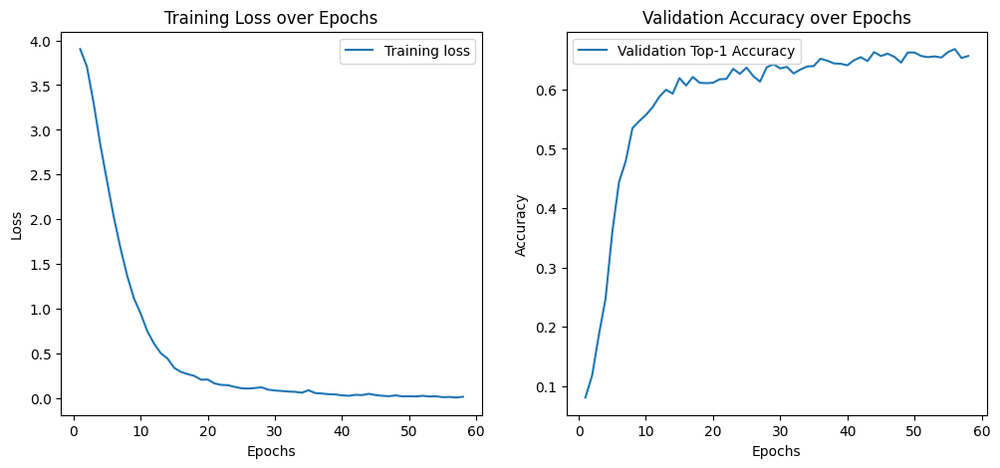

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77195393d0>


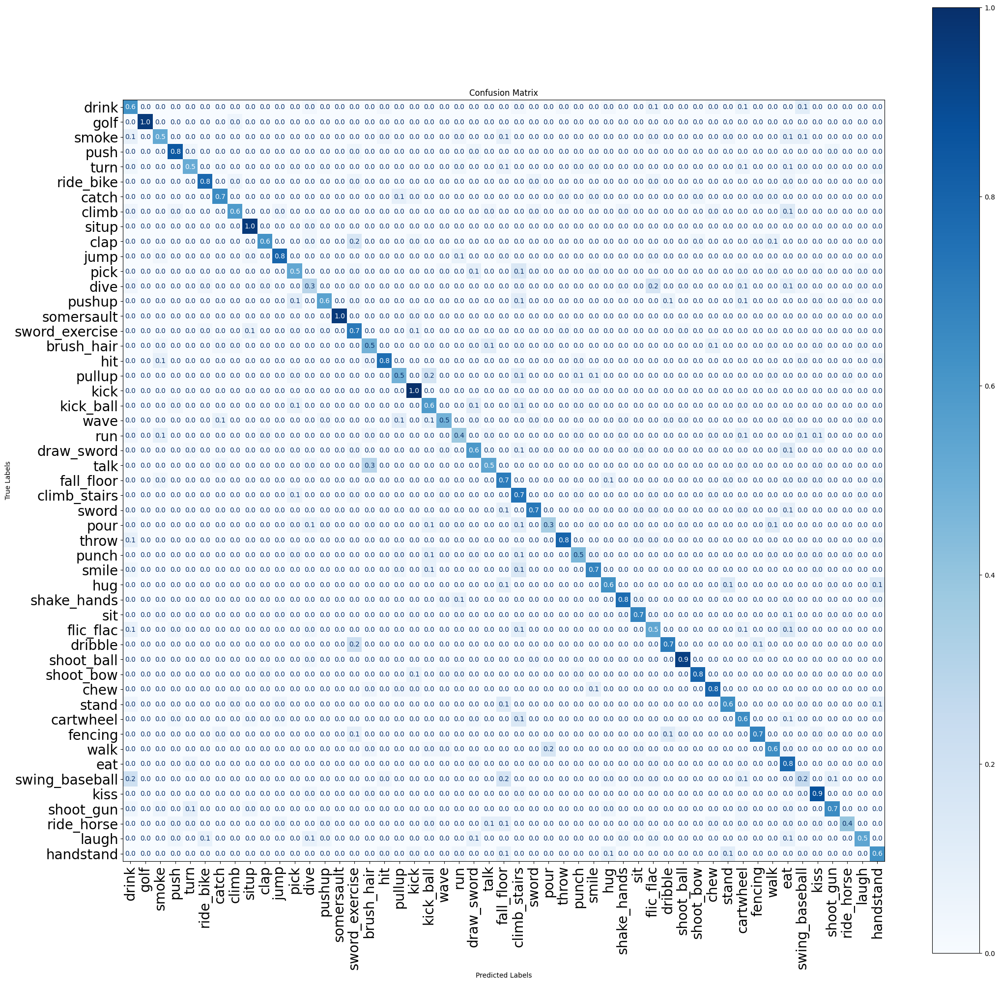

07/24 18:00:14 - mmengine - INFO - Epoch(val) [58][153/153]    acc/top1: 0.6562  acc/top5: 0.8542  acc/mean1: 0.6511  loss/loss: 3.3107  data_time: 3.8212  time: 4.1692
07/24 18:03:35 - mmengine - INFO - Epoch(train) [59][ 20/179]  base_lr: 8.4023e-05 lr: 9.1776e-06  eta: 4:15:25  time: 8.1992  data_time: 4.6044  memory: 34294  loss: 0.0079  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0079
07/24 18:05:53 - mmengine - INFO - Epoch(train) [59][ 40/179]  base_lr: 8.4023e-05 lr: 9.1776e-06  eta: 4:13:00  time: 6.7818  data_time: 3.1644  memory: 34294  loss: 0.0071  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0071
07/24 18:08:06 - mmengine - INFO - Epoch(train) [59][ 60/179]  base_lr: 8.4023e-05 lr: 9.1776e-06  eta: 4:10:34  time: 6.6744  data_time: 3.0991  memory: 34294  loss: 0.0144  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0144
07/24 18:10:53 - mmengine - INFO - Epoch(train) [59][ 80/179]  base_lr: 8.4023e-05 lr: 9.1776e-06  eta: 4:08:14  time: 8.8573  data_time: 5.2390  m

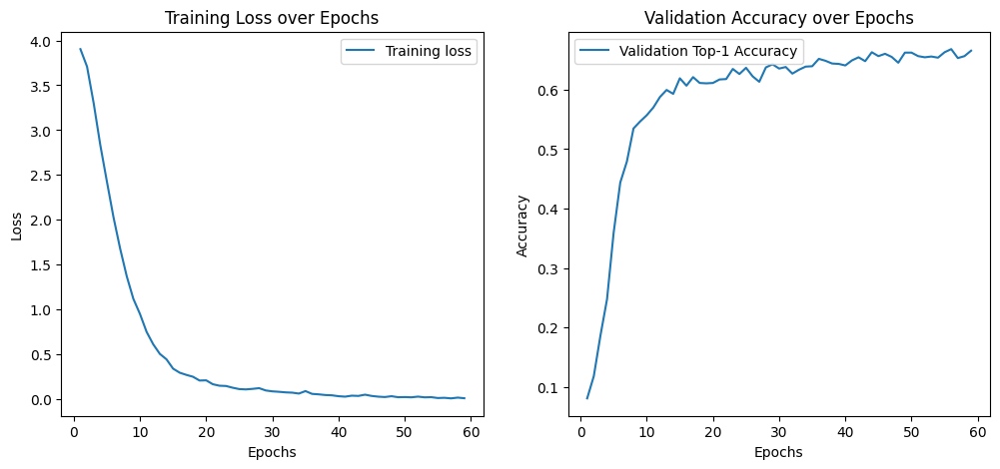

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771e0625b0>


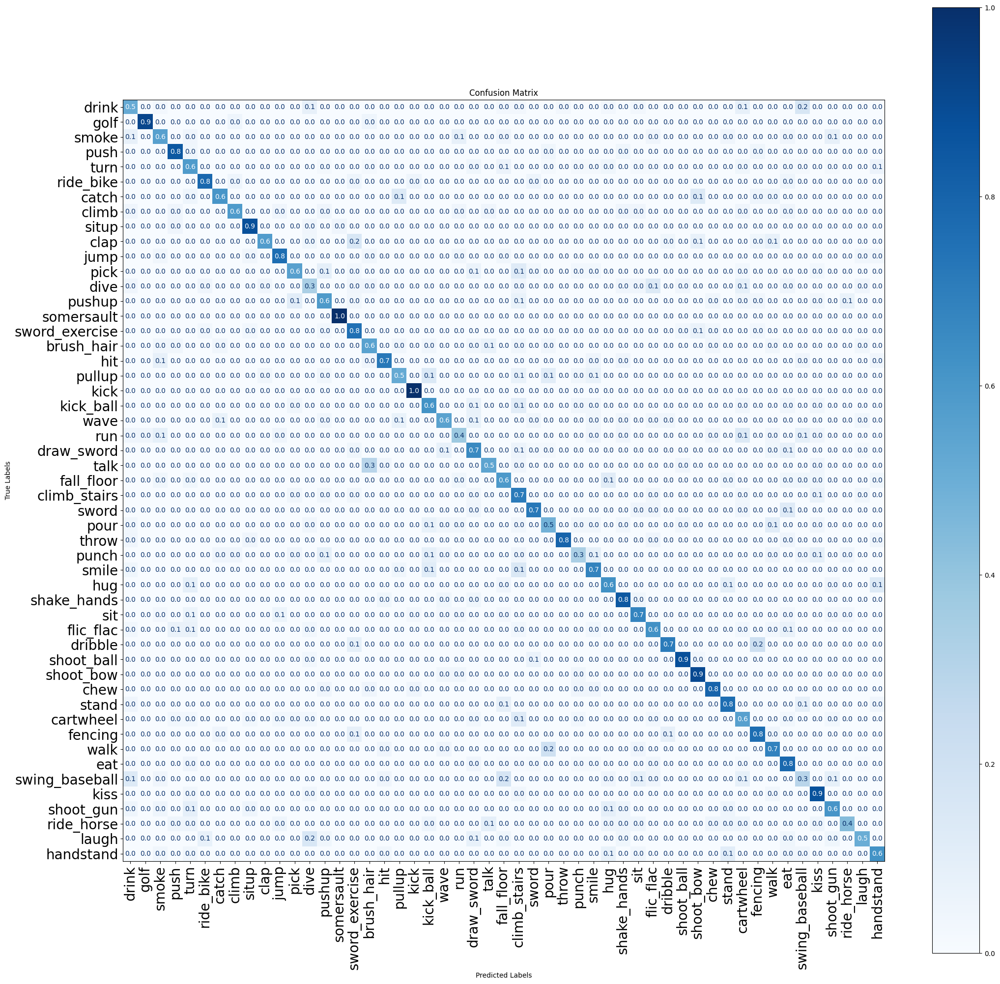

07/24 18:33:39 - mmengine - INFO - Epoch(val) [59][153/153]    acc/top1: 0.6654  acc/top5: 0.8641  acc/mean1: 0.6590  loss/loss: 3.3099  data_time: 4.1453  time: 4.4903
07/24 18:37:08 - mmengine - INFO - Epoch(train) [60][ 20/179]  base_lr: 7.4955e-05 lr: 8.2844e-06  eta: 3:53:59  time: 8.1288  data_time: 4.5459  memory: 34294  loss: 0.0076  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0076
07/24 18:39:40 - mmengine - INFO - Epoch(train) [60][ 40/179]  base_lr: 7.4955e-05 lr: 8.2844e-06  eta: 3:51:36  time: 8.1578  data_time: 4.5755  memory: 34294  loss: 0.0051  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0051
07/24 18:41:30 - mmengine - INFO - Epoch(train) [60][ 60/179]  base_lr: 7.4955e-05 lr: 8.2844e-06  eta: 3:49:06  time: 3.8131  data_time: 0.2216  memory: 34294  loss: 0.0112  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0112
07/24 18:44:05 - mmengine - INFO - Epoch(train) [60][ 80/179]  base_lr: 7.4955e-05 lr: 8.2844e-06  eta: 3:46:44  time: 6.7969  data_time: 3.1888  m

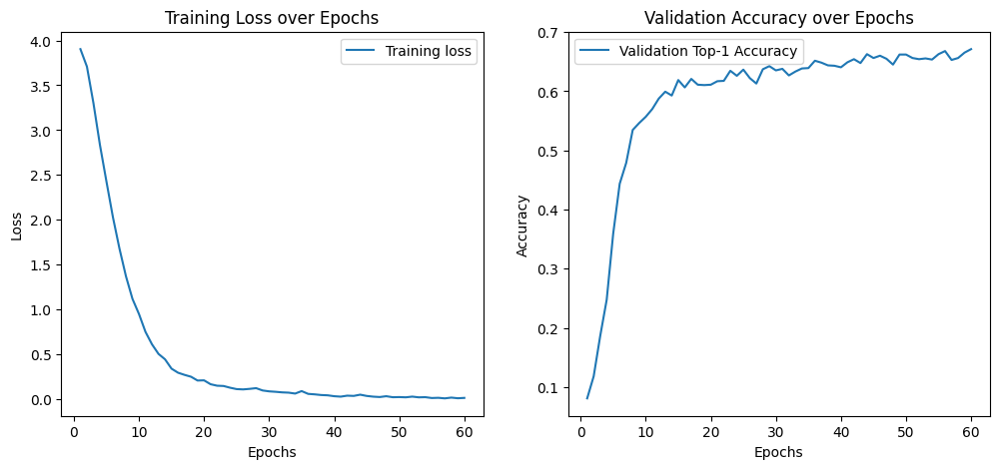

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771e2171f0>


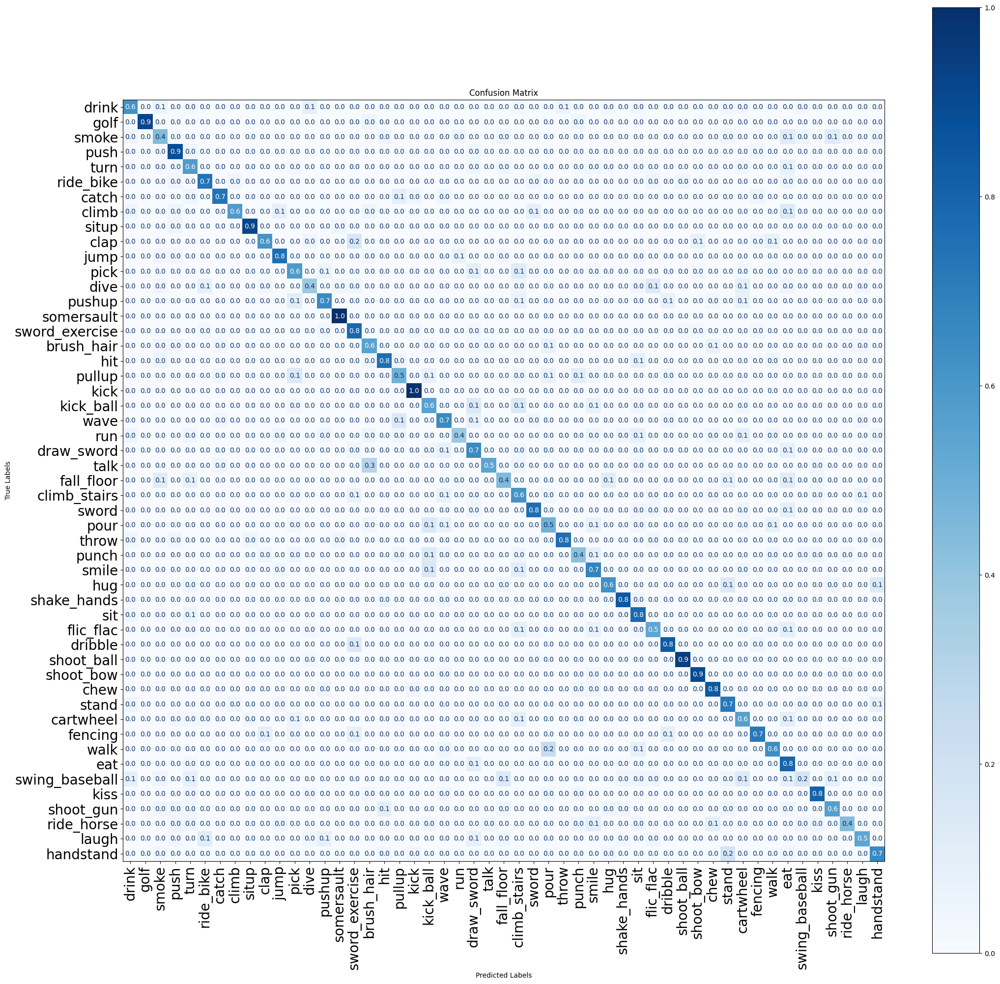

07/24 19:06:19 - mmengine - INFO - Epoch(val) [60][153/153]    acc/top1: 0.6712  acc/top5: 0.8438  acc/mean1: 0.6633  loss/loss: 3.3092  data_time: 3.7605  time: 4.1057
07/24 19:06:19 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_56.pth is removed
07/24 19:06:20 - mmengine - INFO - The best checkpoint with 0.6712 acc/top1 at 60 epoch is saved to best_acc_top1_epoch_60.pth.
07/24 19:09:50 - mmengine - INFO - Epoch(train) [61][ 20/179]  base_lr: 6.6341e-05 lr: 7.4360e-06  eta: 3:32:34  time: 8.8631  data_time: 5.2873  memory: 34294  loss: 0.0293  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0293
07/24 19:12:27 - mmengine - INFO - Epoch(train) [61][ 40/179]  base_lr: 6.6341e-05 lr: 7.4360e-06  eta: 3:30:12  time: 8.3682  data_time: 4.7978  memory: 34294  loss: 0.0121  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0121
07/24 19:14:18 - mmengine - INFO - Epoch(train) [61][ 60/179]  base_lr: 6.6341e-05 lr: 7.4360e-06

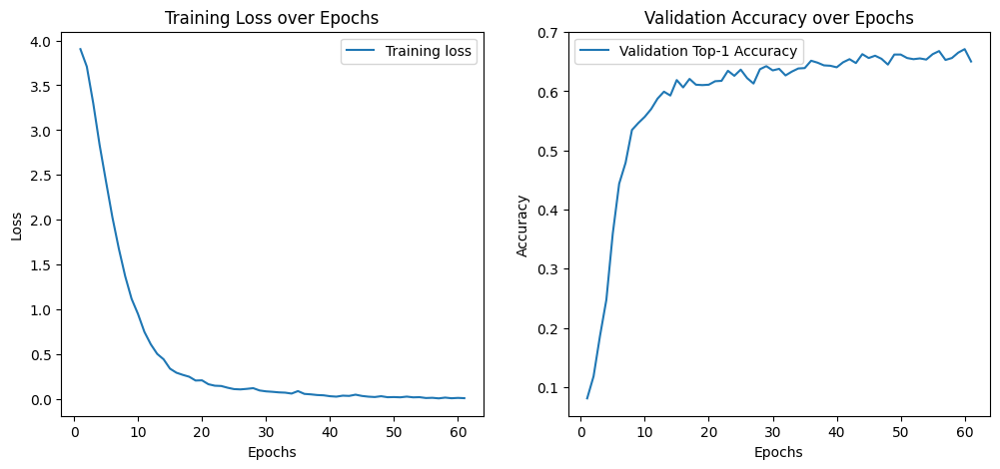

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771e1d4820>


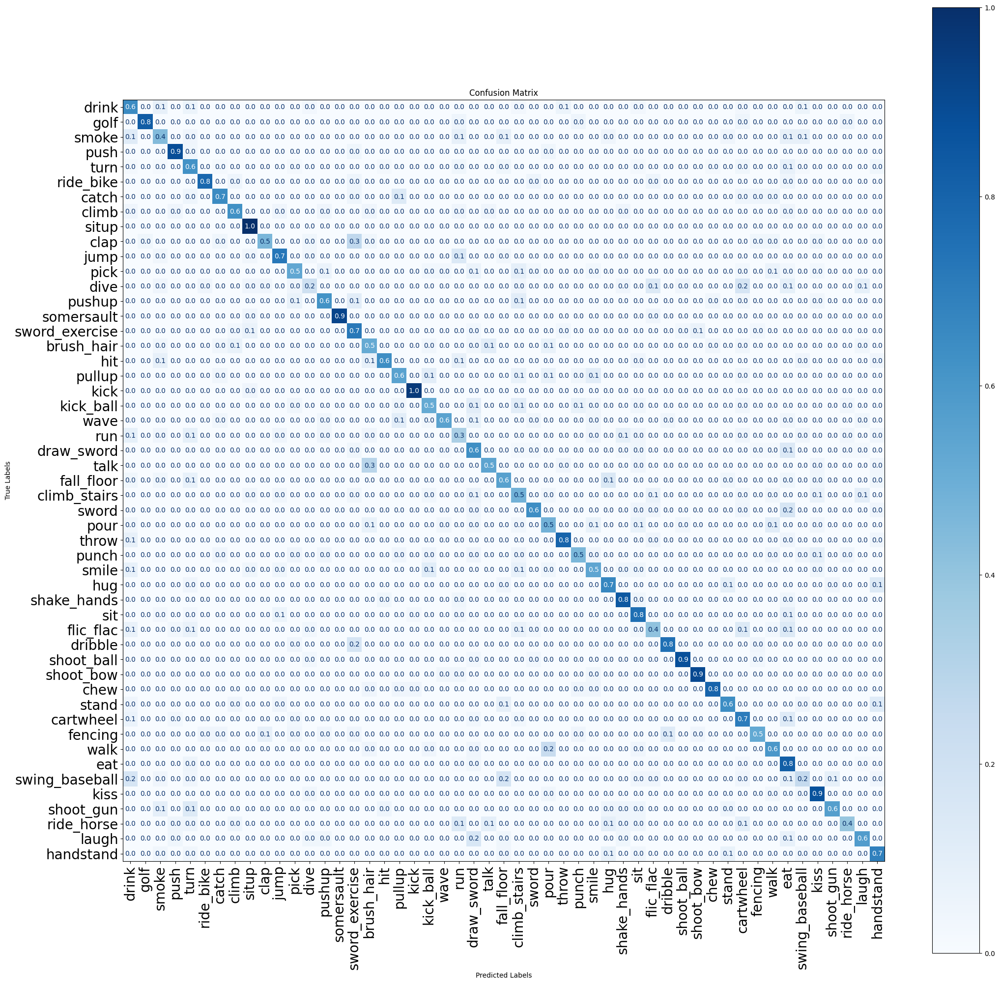

07/24 19:39:07 - mmengine - INFO - Epoch(val) [61][153/153]    acc/top1: 0.6503  acc/top5: 0.8654  acc/mean1: 0.6373  loss/loss: 3.3093  data_time: 3.9805  time: 4.3254
07/24 19:42:23 - mmengine - INFO - Epoch(train) [62][ 20/179]  base_lr: 5.8199e-05 lr: 6.6340e-06  eta: 3:11:03  time: 6.8827  data_time: 3.3032  memory: 34294  loss: 0.0084  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0084
07/24 19:45:04 - mmengine - INFO - Epoch(train) [62][ 40/179]  base_lr: 5.8199e-05 lr: 6.6340e-06  eta: 3:08:41  time: 7.7056  data_time: 4.1131  memory: 34294  loss: 0.0024  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0024
07/24 19:46:48 - mmengine - INFO - Epoch(train) [62][ 60/179]  base_lr: 5.8199e-05 lr: 6.6340e-06  eta: 3:06:11  time: 3.5838  data_time: 0.0054  memory: 34294  loss: 0.0361  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0361
07/24 19:49:26 - mmengine - INFO - Epoch(train) [62][ 80/179]  base_lr: 5.8199e-05 lr: 6.6340e-06  eta: 3:03:49  time: 7.8424  data_time: 4.2855  m

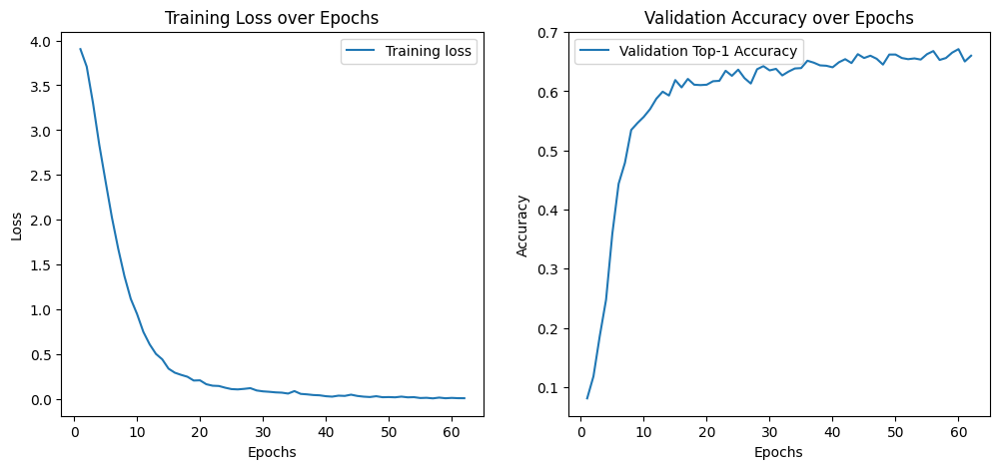

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719db7160>


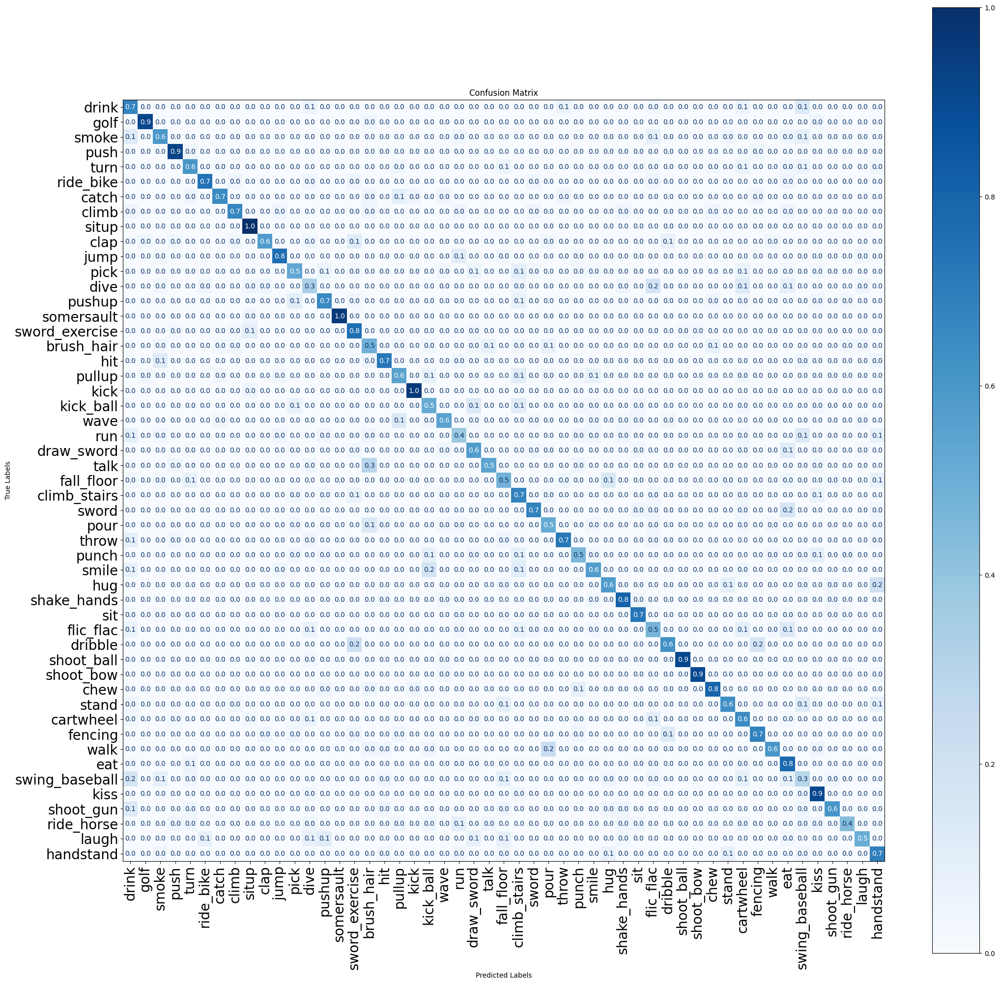

07/24 20:11:48 - mmengine - INFO - Epoch(val) [62][153/153]    acc/top1: 0.6601  acc/top5: 0.8569  acc/mean1: 0.6531  loss/loss: 3.3082  data_time: 3.8187  time: 4.1644
07/24 20:15:12 - mmengine - INFO - Epoch(train) [63][ 20/179]  base_lr: 5.0545e-05 lr: 5.8801e-06  eta: 2:49:37  time: 7.5585  data_time: 3.9987  memory: 34294  loss: 0.0110  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0110
07/24 20:18:05 - mmengine - INFO - Epoch(train) [63][ 40/179]  base_lr: 5.0545e-05 lr: 5.8801e-06  eta: 2:47:17  time: 9.2518  data_time: 5.6811  memory: 34294  loss: 0.0468  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0468
07/24 20:19:55 - mmengine - INFO - Epoch(train) [63][ 60/179]  base_lr: 5.0545e-05 lr: 5.8801e-06  eta: 2:44:48  time: 3.6161  data_time: 0.0050  memory: 34294  loss: 0.0103  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0103
07/24 20:22:32 - mmengine - INFO - Epoch(train) [63][ 80/179]  base_lr: 5.0545e-05 lr: 5.8801e-06  eta: 2:42:26  time: 6.7270  data_time: 3.0845  m

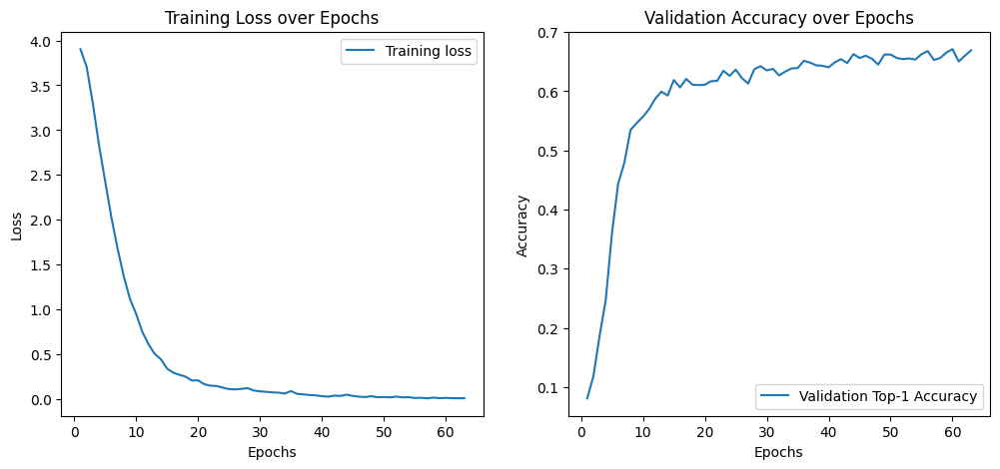

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771e1fe7f0>


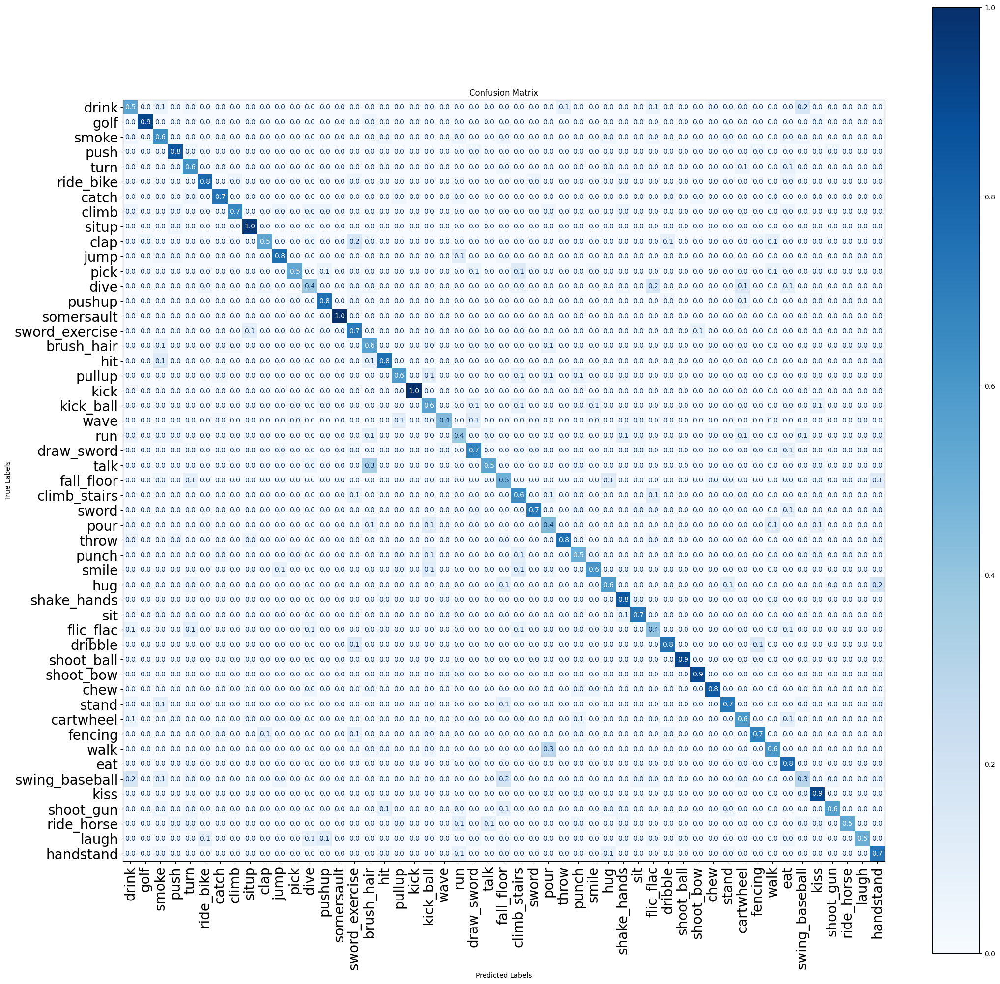

07/24 20:44:47 - mmengine - INFO - Epoch(val) [63][153/153]    acc/top1: 0.6693  acc/top5: 0.8562  acc/mean1: 0.6641  loss/loss: 3.3074  data_time: 3.9412  time: 4.2877
07/24 20:47:59 - mmengine - INFO - Epoch(train) [64][ 20/179]  base_lr: 4.3395e-05 lr: 5.1758e-06  eta: 2:28:08  time: 6.1890  data_time: 2.6279  memory: 34294  loss: 0.0409  top1_acc: 0.9500  top5_acc: 1.0000  loss_cls: 0.0409
07/24 20:50:44 - mmengine - INFO - Epoch(train) [64][ 40/179]  base_lr: 4.3395e-05 lr: 5.1758e-06  eta: 2:25:46  time: 7.9331  data_time: 4.3578  memory: 34294  loss: 0.0037  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0037
07/24 20:52:36 - mmengine - INFO - Epoch(train) [64][ 60/179]  base_lr: 4.3395e-05 lr: 5.1758e-06  eta: 2:23:18  time: 3.5794  data_time: 0.0061  memory: 34294  loss: 0.0045  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0045
07/24 20:55:14 - mmengine - INFO - Epoch(train) [64][ 80/179]  base_lr: 4.3395e-05 lr: 5.1758e-06  eta: 2:20:56  time: 8.5600  data_time: 4.9018  m

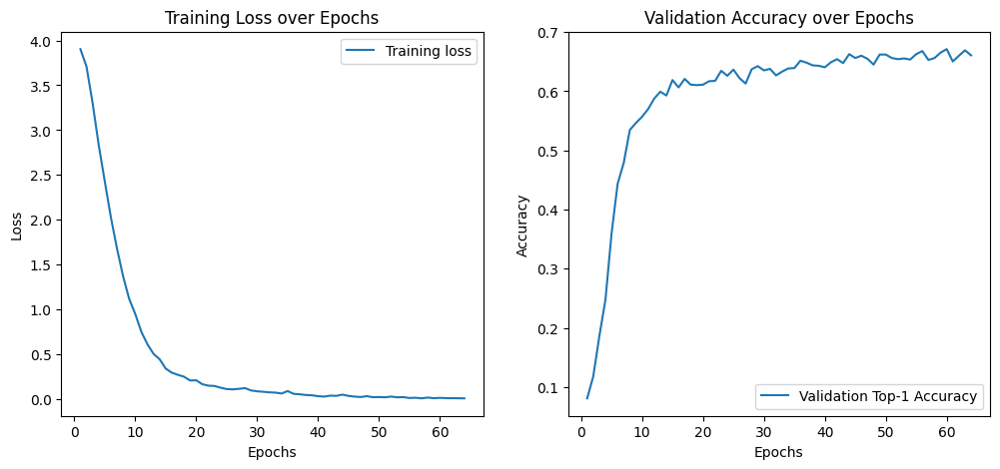

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f77195684f0>


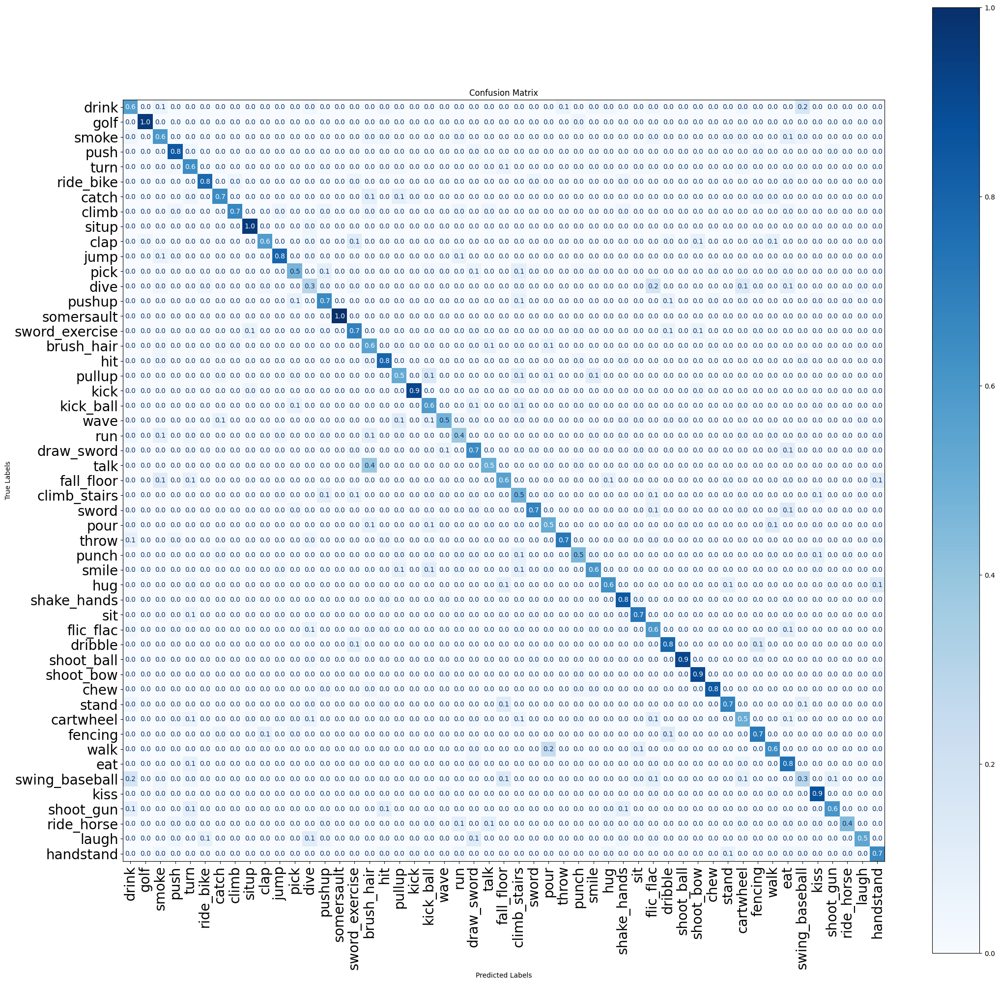

07/24 21:17:37 - mmengine - INFO - Epoch(val) [64][153/153]    acc/top1: 0.6608  acc/top5: 0.8549  acc/mean1: 0.6564  loss/loss: 3.3066  data_time: 3.8209  time: 4.1664
07/24 21:20:49 - mmengine - INFO - Epoch(train) [65][ 20/179]  base_lr: 3.6762e-05 lr: 4.5224e-06  eta: 2:06:40  time: 7.2254  data_time: 3.6679  memory: 34294  loss: 0.0214  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0214
07/24 21:23:29 - mmengine - INFO - Epoch(train) [65][ 40/179]  base_lr: 3.6762e-05 lr: 4.5224e-06  eta: 2:04:17  time: 8.1100  data_time: 4.4359  memory: 34294  loss: 0.0020  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0020
07/24 21:26:02 - mmengine - INFO - Epoch(train) [65][ 60/179]  base_lr: 3.6762e-05 lr: 4.5224e-06  eta: 2:01:53  time: 7.7191  data_time: 4.0864  memory: 34294  loss: 0.0114  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0114
07/24 21:28:03 - mmengine - INFO - Epoch(train) [65][ 80/179]  base_lr: 3.6762e-05 lr: 4.5224e-06  eta: 1:59:27  time: 3.8804  data_time: 0.2628  m

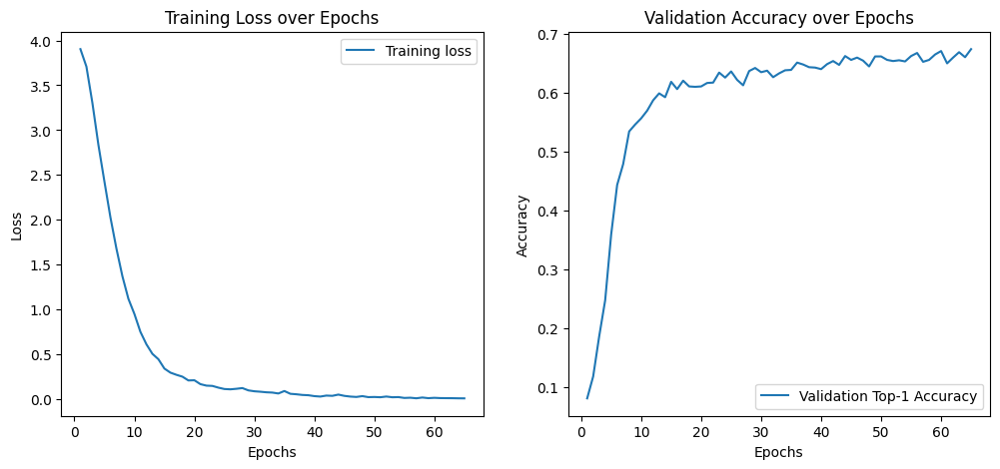

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719bd53a0>


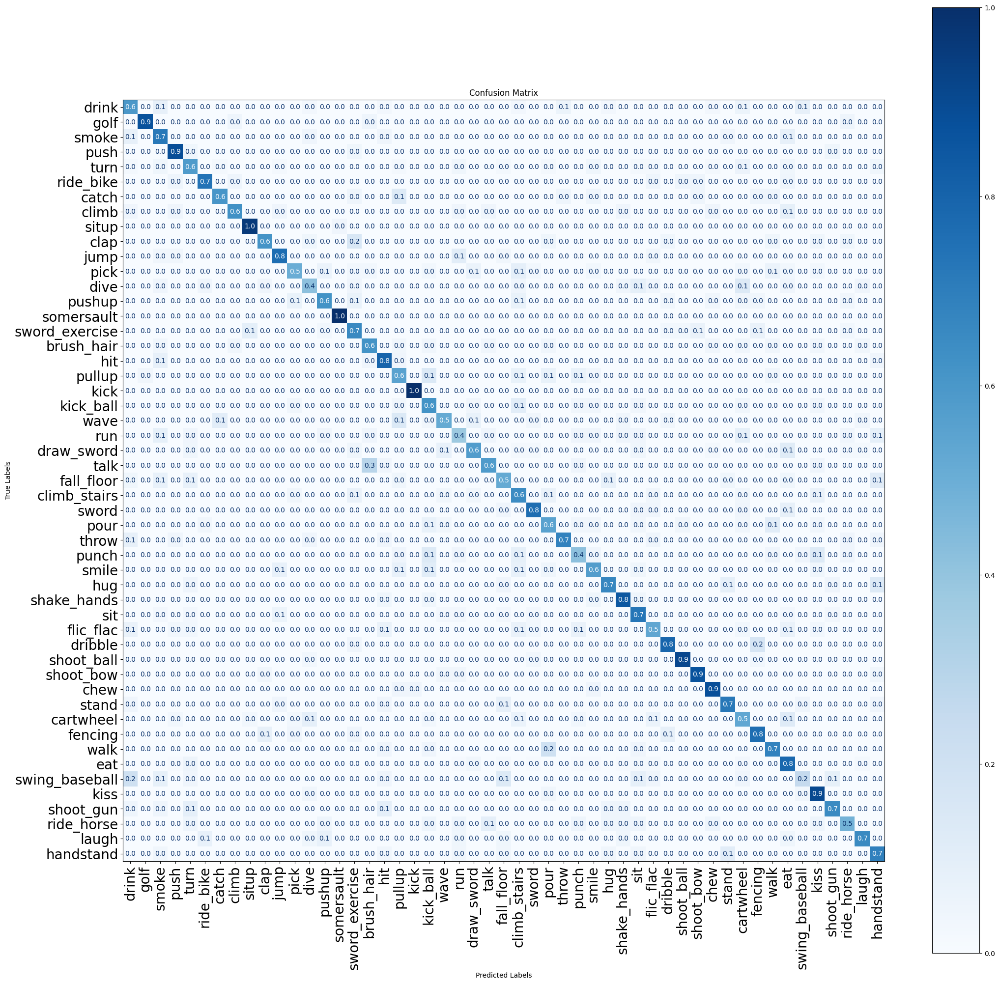

07/24 21:50:59 - mmengine - INFO - Epoch(val) [65][153/153]    acc/top1: 0.6745  acc/top5: 0.8601  acc/mean1: 0.6718  loss/loss: 3.3058  data_time: 3.9630  time: 4.3107
07/24 21:50:59 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_60.pth is removed
07/24 21:51:00 - mmengine - INFO - The best checkpoint with 0.6745 acc/top1 at 65 epoch is saved to best_acc_top1_epoch_65.pth.
07/24 21:54:12 - mmengine - INFO - Epoch(train) [66][ 20/179]  base_lr: 3.0660e-05 lr: 3.9214e-06  eta: 1:45:12  time: 7.4704  data_time: 3.9056  memory: 34294  loss: 0.0067  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0067
07/24 21:56:35 - mmengine - INFO - Epoch(train) [66][ 40/179]  base_lr: 3.0660e-05 lr: 3.9214e-06  eta: 1:42:48  time: 7.5999  data_time: 4.0472  memory: 34294  loss: 0.0024  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0024
07/24 21:58:22 - mmengine - INFO - Epoch(train) [66][ 60/179]  base_lr: 3.0660e-05 lr: 3.9214e-06

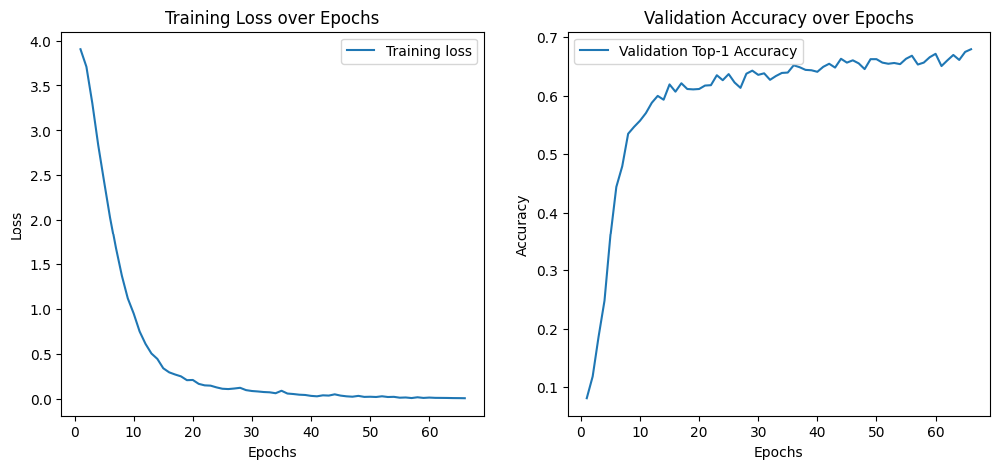

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719fc4f10>


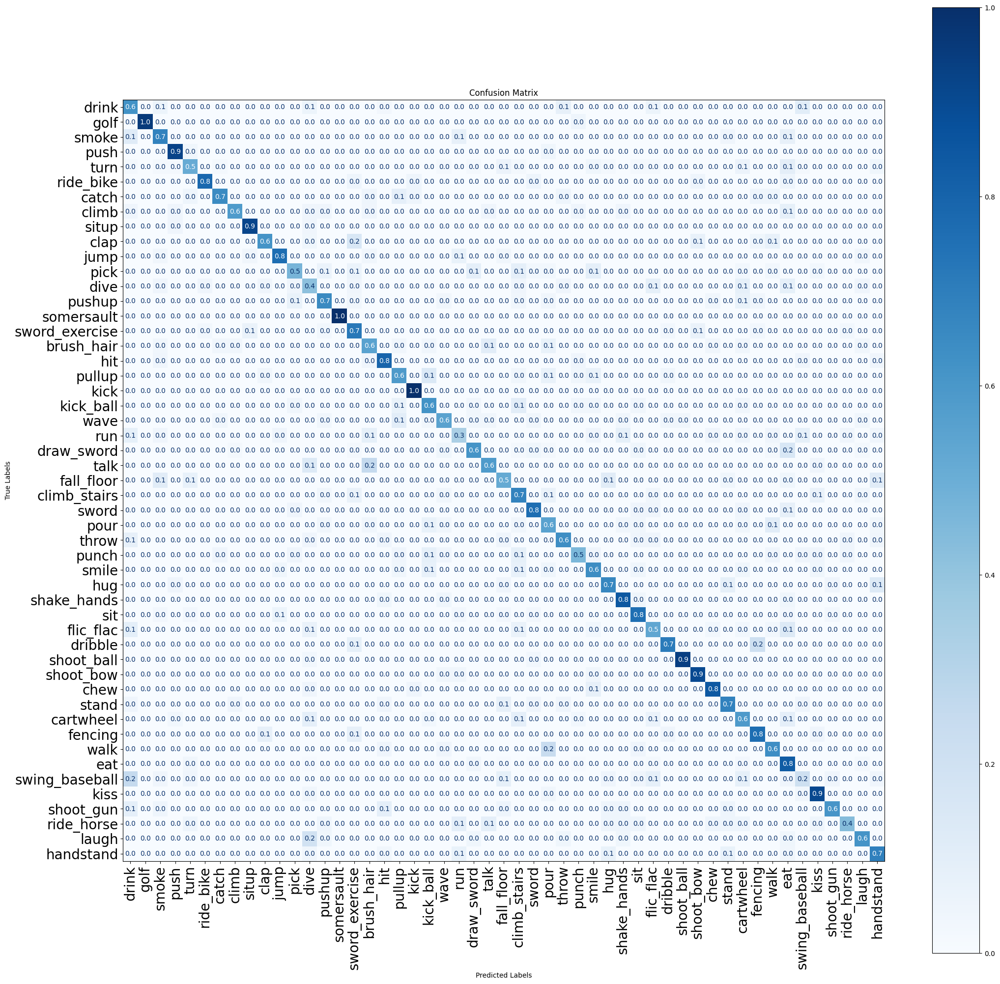

07/24 22:23:18 - mmengine - INFO - Epoch(val) [66][153/153]    acc/top1: 0.6791  acc/top5: 0.8595  acc/mean1: 0.6725  loss/loss: 3.3047  data_time: 3.8532  time: 4.1985
07/24 22:23:18 - mmengine - INFO - The previous best checkpoint /home/jovyan/mamba/work_dirs/hmdbdvs_experiment/best_acc_top1_epoch_65.pth is removed
07/24 22:23:20 - mmengine - INFO - The best checkpoint with 0.6791 acc/top1 at 66 epoch is saved to best_acc_top1_epoch_66.pth.
07/24 22:26:35 - mmengine - INFO - Epoch(train) [67][ 20/179]  base_lr: 2.5101e-05 lr: 3.3739e-06  eta: 1:23:40  time: 6.7583  data_time: 3.1695  memory: 34294  loss: 0.0069  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0069
07/24 22:29:15 - mmengine - INFO - Epoch(train) [67][ 40/179]  base_lr: 2.5101e-05 lr: 3.3739e-06  eta: 1:21:17  time: 7.3669  data_time: 3.7637  memory: 34294  loss: 0.0276  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0276
07/24 22:31:04 - mmengine - INFO - Epoch(train) [67][ 60/179]  base_lr: 2.5101e-05 lr: 3.3739e-06

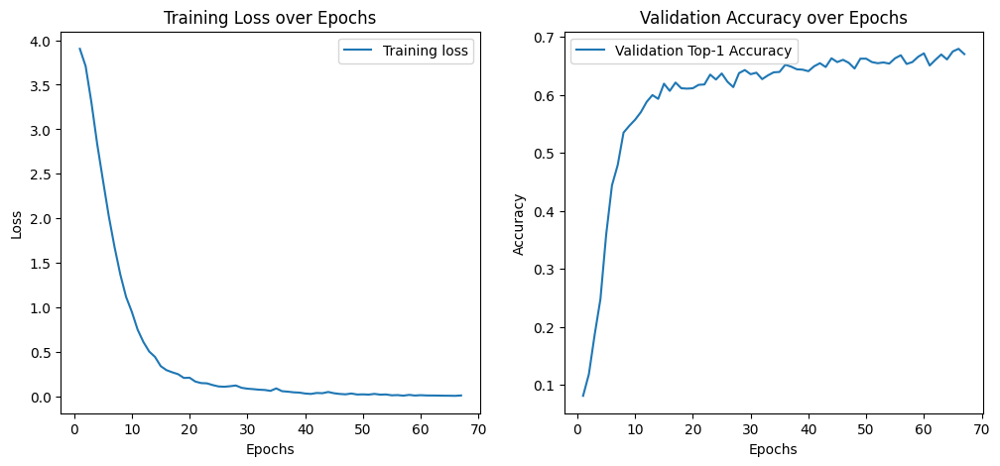

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771939abe0>


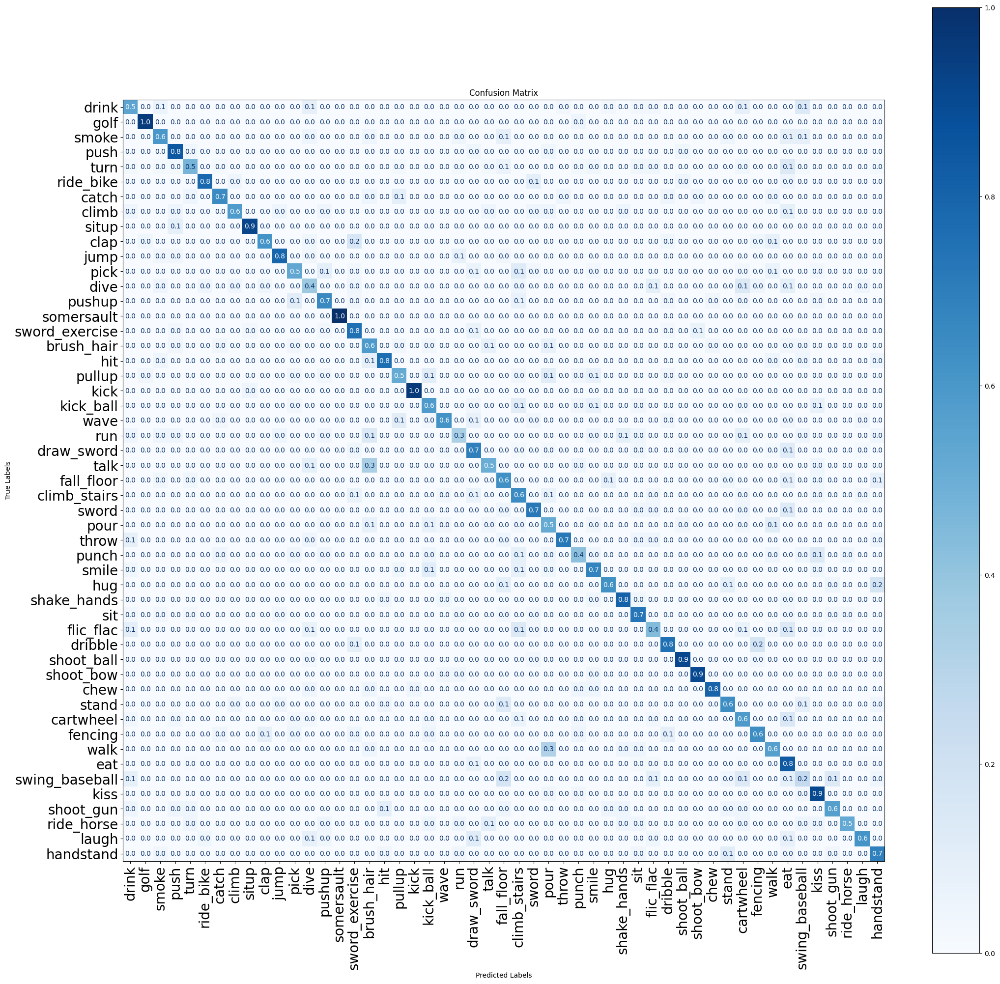

07/24 22:57:06 - mmengine - INFO - Epoch(val) [67][153/153]    acc/top1: 0.6699  acc/top5: 0.8516  acc/mean1: 0.6612  loss/loss: 3.3035  data_time: 4.2058  time: 4.5504
07/24 22:58:53 - mmengine - INFO - Exp name: 20240723_102956
07/24 23:00:25 - mmengine - INFO - Epoch(train) [68][ 20/179]  base_lr: 2.0098e-05 lr: 2.8811e-06  eta: 1:02:10  time: 8.1039  data_time: 4.5387  memory: 34294  loss: 0.0120  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0120
07/24 23:02:44 - mmengine - INFO - Epoch(train) [68][ 40/179]  base_lr: 2.0098e-05 lr: 2.8811e-06  eta: 0:59:46  time: 6.5434  data_time: 2.9856  memory: 34294  loss: 0.0101  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0101
07/24 23:04:52 - mmengine - INFO - Epoch(train) [68][ 60/179]  base_lr: 2.0098e-05 lr: 2.8811e-06  eta: 0:57:21  time: 3.5581  data_time: 0.0037  memory: 34294  loss: 0.0029  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0029
07/24 23:07:27 - mmengine - INFO - Epoch(train) [68][ 80/179]  base_lr: 2.0098e-05 lr:

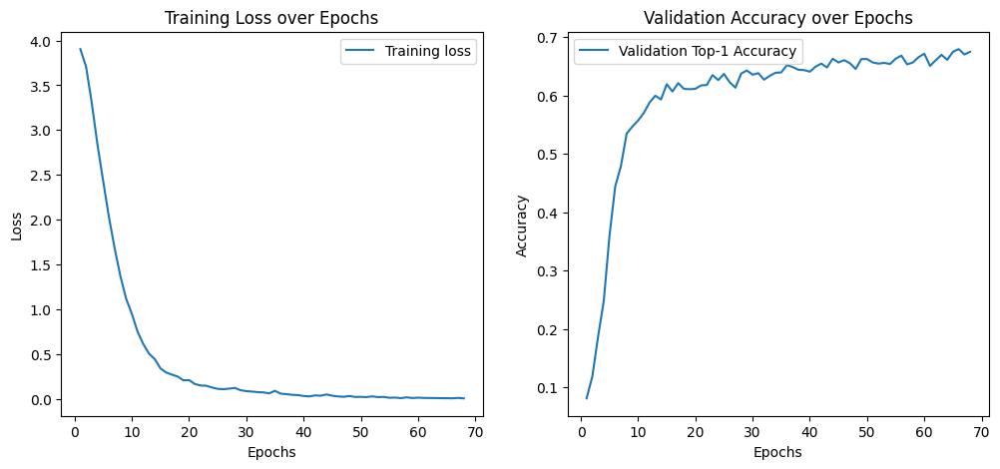

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f771e176dc0>


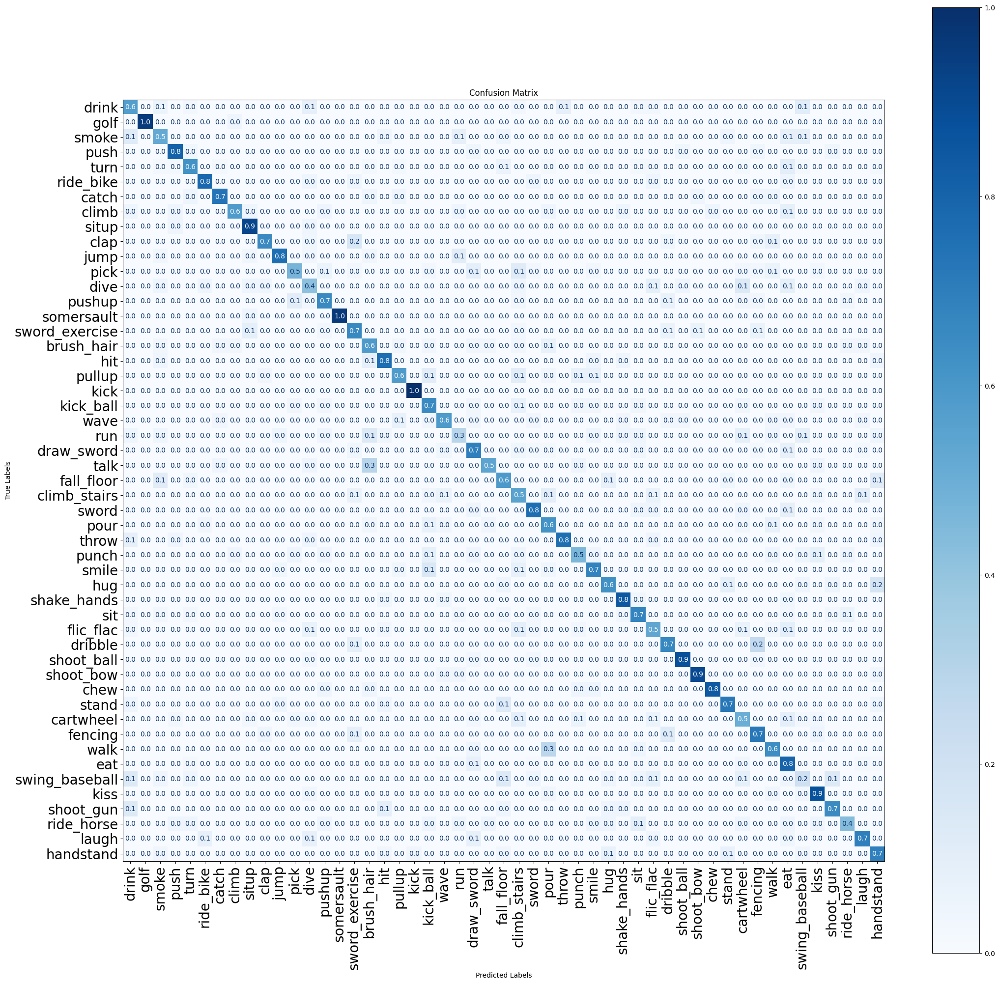

07/24 23:29:54 - mmengine - INFO - Epoch(val) [68][153/153]    acc/top1: 0.6745  acc/top5: 0.8608  acc/mean1: 0.6681  loss/loss: 3.3015  data_time: 3.8210  time: 4.1680
07/24 23:33:30 - mmengine - INFO - Epoch(train) [69][ 20/179]  base_lr: 1.5659e-05 lr: 2.4438e-06  eta: 0:40:40  time: 9.3750  data_time: 5.8056  memory: 34294  loss: 0.0015  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0015
07/24 23:35:57 - mmengine - INFO - Epoch(train) [69][ 40/179]  base_lr: 1.5659e-05 lr: 2.4438e-06  eta: 0:38:15  time: 6.5974  data_time: 3.0003  memory: 34294  loss: 0.0089  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0089
07/24 23:38:01 - mmengine - INFO - Epoch(train) [69][ 60/179]  base_lr: 1.5659e-05 lr: 2.4438e-06  eta: 0:35:51  time: 5.2057  data_time: 1.5843  memory: 34294  loss: 0.0065  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0065
07/24 23:40:46 - mmengine - INFO - Epoch(train) [69][ 80/179]  base_lr: 1.5659e-05 lr: 2.4438e-06  eta: 0:33:27  time: 7.0134  data_time: 3.3747  m

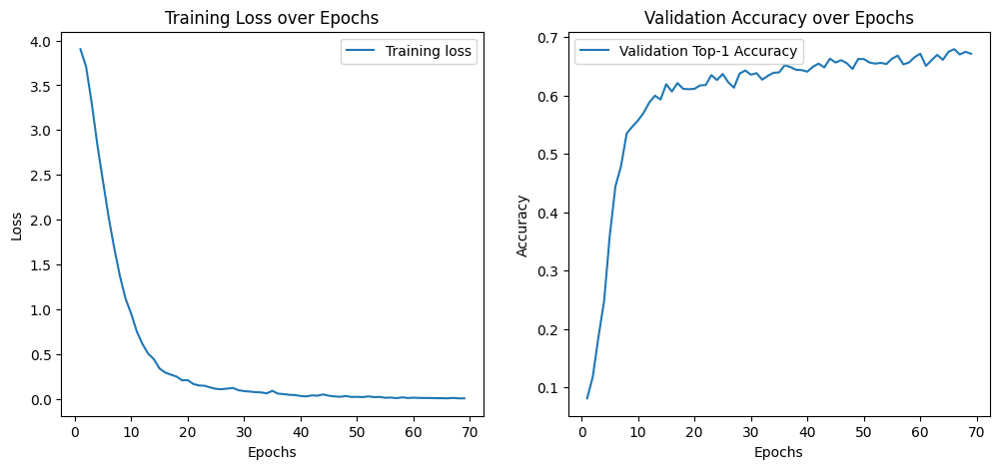

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f7719618f40>


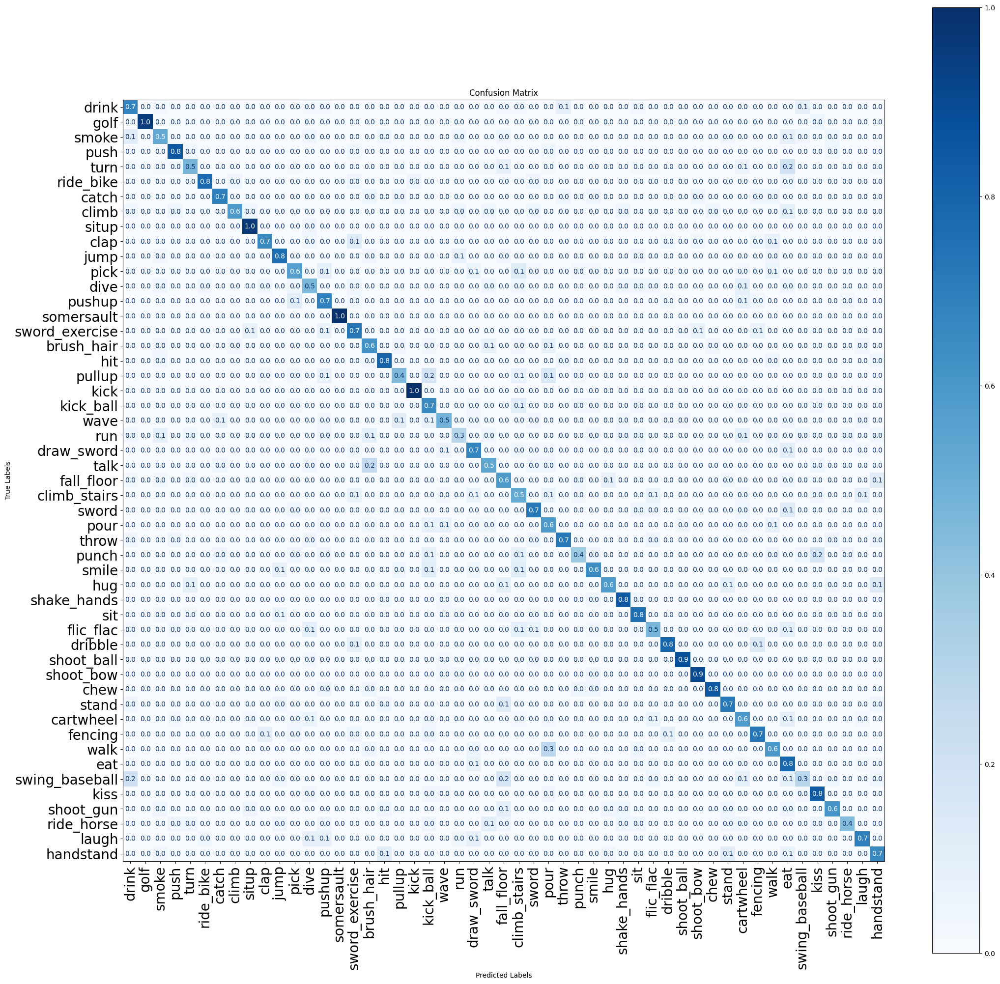

07/25 00:03:17 - mmengine - INFO - Epoch(val) [69][153/153]    acc/top1: 0.6712  acc/top5: 0.8601  acc/mean1: 0.6667  loss/loss: 3.3008  data_time: 4.0294  time: 4.3749
07/25 00:06:30 - mmengine - INFO - Epoch(train) [70][ 20/179]  base_lr: 1.1793e-05 lr: 2.0631e-06  eta: 0:19:08  time: 7.6823  data_time: 4.1176  memory: 34294  loss: 0.0042  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0042
07/25 00:09:17 - mmengine - INFO - Epoch(train) [70][ 40/179]  base_lr: 1.1793e-05 lr: 2.0631e-06  eta: 0:16:43  time: 8.2666  data_time: 4.7138  memory: 34294  loss: 0.0143  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0143
07/25 00:11:19 - mmengine - INFO - Epoch(train) [70][ 60/179]  base_lr: 1.1793e-05 lr: 2.0631e-06  eta: 0:14:19  time: 3.5860  data_time: 0.0041  memory: 34294  loss: 0.0062  top1_acc: 1.0000  top5_acc: 1.0000  loss_cls: 0.0062
07/25 00:13:42 - mmengine - INFO - Epoch(train) [70][ 80/179]  base_lr: 1.1793e-05 lr: 2.0631e-06  eta: 0:11:54  time: 7.2697  data_time: 3.6595  m

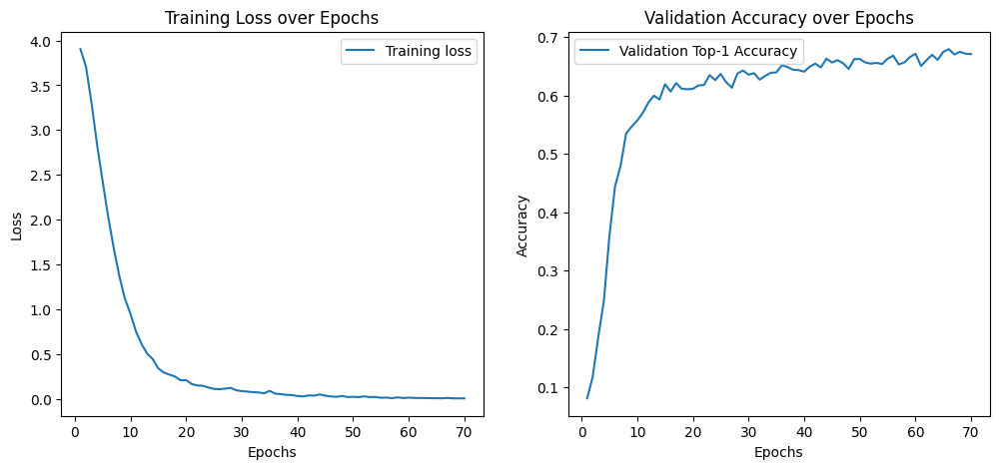

DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7f778af13040>


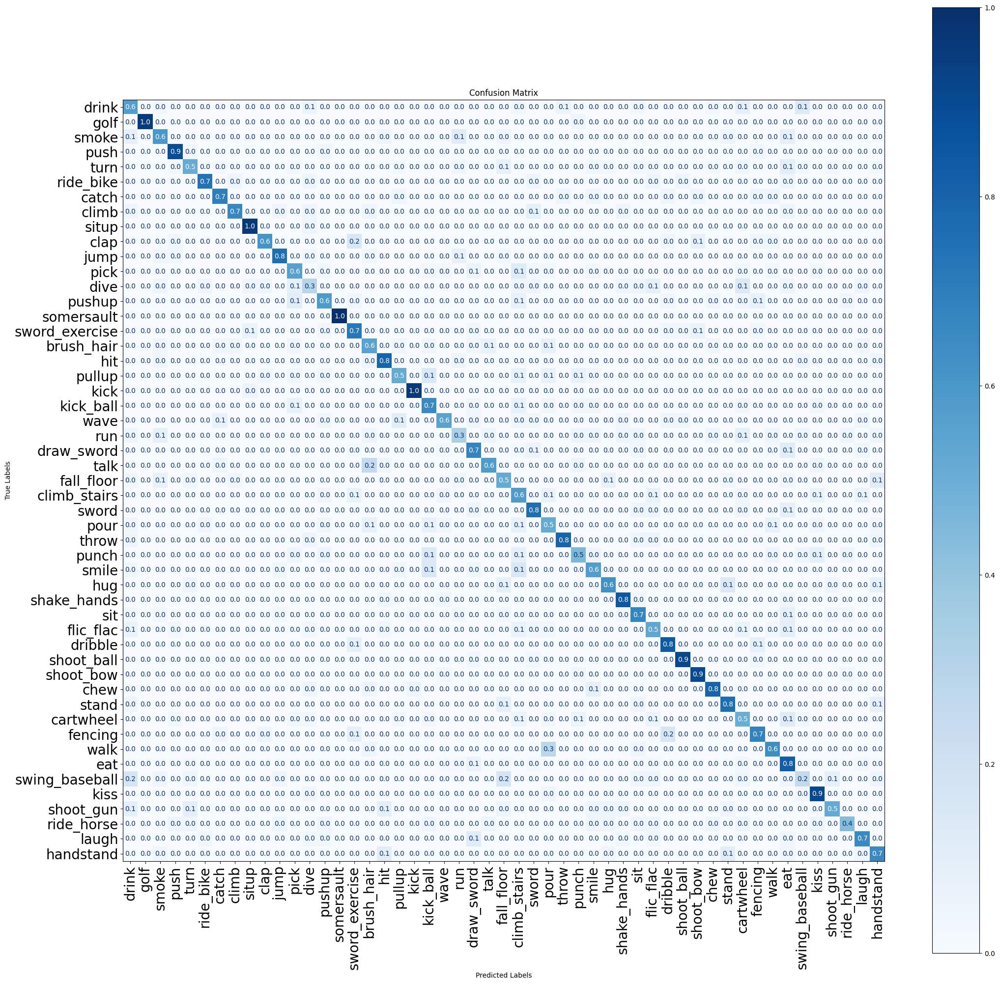

07/25 00:36:29 - mmengine - INFO - Epoch(val) [70][153/153]    acc/top1: 0.6706  acc/top5: 0.8621  acc/mean1: 0.6643  loss/loss: 3.3006  data_time: 3.9088  time: 4.2560


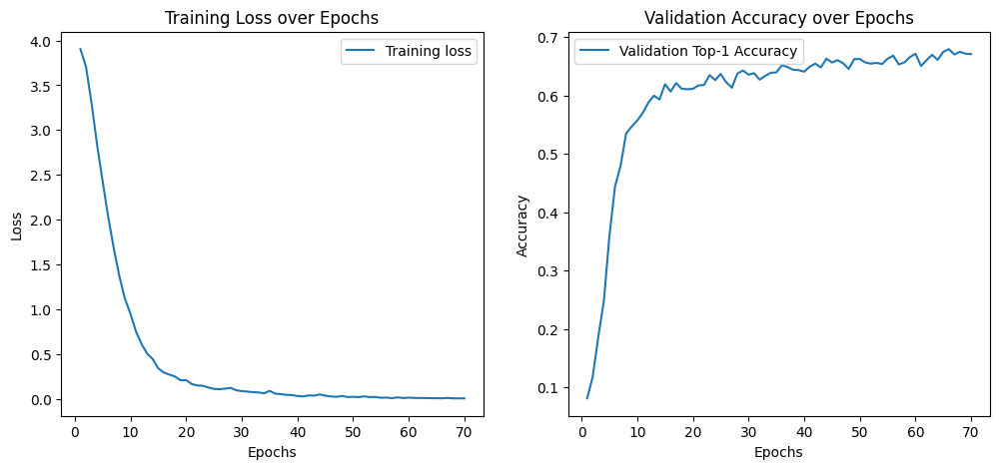

In [20]:
import torch
from torch.utils.data import DataLoader
from mmengine.config import Config
from mmengine.registry import RUNNERS
from mmengine.runner import Runner
import logging
import tonic
import random

logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)


# Définir la configuration directement
cfg_dict = {
    'auto_scale_lr': dict(base_batch_size=32, enable=False),
    'dataset_type': 'RawframeDataset',
    'default_hooks': dict(
        checkpoint=dict(interval=3, max_keep_ckpts=5, save_best='auto', type='CheckpointHook'),
        logger=dict(ignore_last=False, interval=20, type='LoggerHook'),
        param_scheduler=dict(type='ParamSchedulerHook'),
        runtime_info=dict(type='RuntimeInfoHook'),
        sampler_seed=dict(type='DistSamplerSeedHook'),
        sync_buffers=dict(type='SyncBuffersHook'),
        timer=dict(type='IterTimerHook')),
    'default_scope': 'mmaction',
    'env_cfg': dict(cudnn_benchmark=False,dist_cfg=dict(backend='nccl'),mp_cfg=dict(mp_start_method='fork', opencv_num_threads=0)),
    'file_client_args': dict(io_backend='disk'),
    'launcher': 'pytorch',
    'log_level': 'INFO',
    'log_processor': dict(by_epoch=True, type='LogProcessor', window_size=20),
    'magnitude': 9,
    'model': dict(
        backbone=dict(
            type='Mamba3DModel',
            arch='small',
            d_state=16,
            drop_path_rate=0.1,
            drop_rate=0.1,
            final_norm=False,
            force_a2=False,
            fused_add_norm=False,
            img_size=224,
            inflate_len=True,
            is_2d=False,
            num_frames=32,
            out_type='featmap',
            patch_size=16,
            patch_size_temporal=2,
            pretrained='/mamba_2d_s_16_pretrained.pth',
            use_mlp=False,
            use_nd=False,
            use_v2=False,
            with_cls_token=False),
        
        cls_head=dict(
            average_clips='prob',
            dropout_ratio=0.4,
            in_channels=384,
            num_classes=51,
            spatial_type='avg',
            type='I3DHead'),
        
        data_preprocessor=dict(
            format_shape='NCTHW',
            # mean=[
            #     114.75,
            #     114.75,
            #     114.75,
            # ],
            # std=[
            #     57.375,
            #     57.375,
            #     57.375,
            # ],
            type='ActionDataPreprocessor'),
        
        type='Recognizer3D'),
    

    'optim_wrapper': dict(
        constructor='SwinOptimWrapperConstructor',
        optimizer=dict(betas=(0.9,0.999), lr=0.0006, type='AdamW', weight_decay=0.02),
        paramwise_cfg=dict(absolute_pos_embed=dict(decay_mult=0.0),backbone=dict(lr_mult=0.1),norm=dict(decay_mult=0.0),relative_position_bias_table=dict(decay_mult=0.0)),type='AmpOptimWrapper'
    ),
    'param_scheduler': [
        dict(
            begin=0,
            by_epoch=True,
            convert_to_iter_based=True,
            end=5,
            start_factor=0.1,
            type='LinearLR'),
        dict(
            T_max=70,
            begin=5,
            by_epoch=True,
            end=70,
            eta_min=1e-06,
            type='CosineAnnealingLR'),
    ],

    
    'rand_aug': '9,4',
    'randomness': dict(deterministic=False, diff_rank_seed=False, seed=None),
    'resume': False,
    
    'test_cfg': dict(type='TestLoop'),

    'train_cfg': dict(max_epochs=70, type='EpochBasedTrainLoop', val_begin=1, val_interval=1),

    'use_rand_erasing': False,

    'val_cfg': dict(type='ValLoop'),

    'val_evaluator': [dict(type='AccMetric'), dict(type='LossValMetric')],

    'vis_backends': [dict(type='LocalVisBackend')],

    'visualizer': dict(type='ActionVisualizer',vis_backends=[dict(type='LocalVisBackend')]),

    'work_dir': './work_dirs/hmdbdvs_experiment',
}

cfg = Config(cfg_dict)

# Affichage des configurations
print("Train dataloader:", train_dataloader)
print("Validation dataloader:",val_dataloader)
print("Validation evaluator:", cfg.val_evaluator)

# Simuler les arguments d'entrée
class Args:
    work_dir = None  
    resume = None  
    amp = True  
    no_validate = False
    auto_scale_lr = False
    seed = 42
    diff_rank_seed = False
    deterministic = False
    cfg_options = None
    launcher = 'none'
    local_rank = 0

args = Args()

def merge_args(cfg, args):
    """Merge CLI arguments to config."""
    if args.no_validate:
        cfg.val_cfg = None
        cfg.val_dataloader = None
        cfg.val_evaluator = None

    cfg.launcher = args.launcher

    if args.work_dir is not None:
        cfg.work_dir = args.work_dir
    elif cfg.get('work_dir', None) is None:
        cfg.work_dir = os.path.join('./work_dirs', 'hmdbdvs_experiment')

    if args.amp:
        cfg.optim_wrapper.type = 'AmpOptimWrapper'
        cfg.optim_wrapper.setdefault('loss_scale', 'dynamic')

    if args.resume == 'auto':
        cfg.resume = True
        cfg.load_from = None
    elif args.resume is not None:
        cfg.resume = True
        cfg.load_from = args.resume

    if args.auto_scale_lr:
        cfg.auto_scale_lr.enable = True

    if args.cfg_options is not None:
        cfg.merge_from_dict(args.cfg_options)

    return cfg

# Merging args with the configuration
cfg = merge_args(cfg, args)

# Initialisation du hook personnalisé
metric_logger_hook = MetricLoggerHook()

# Initialisation du Runner
runner = Runner(
    model=cfg.model,
    work_dir=cfg.work_dir,
    train_dataloader=train_dataloader,
    val_dataloader=val_dataloader,
    test_dataloader=val_dataloader,  # Assuming test and val dataloaders are the same
    train_cfg=cfg.train_cfg,
    val_cfg=cfg.val_cfg,
    test_cfg=cfg.test_cfg,
    auto_scale_lr=cfg.auto_scale_lr,
    optim_wrapper=cfg.optim_wrapper,
    param_scheduler=cfg.param_scheduler,
    val_evaluator=cfg.val_evaluator,
    test_evaluator=cfg.val_evaluator,
    default_hooks=cfg.default_hooks,
    custom_hooks=[metric_logger_hook],
    resume=cfg.resume,
    launcher=cfg.launcher,
    env_cfg=cfg.env_cfg,
    log_level=cfg.log_level,
    visualizer=cfg.visualizer,
    default_scope=cfg.default_scope,
    randomness=cfg.randomness,
    cfg=cfg
)


# Affichez des échantillons du jeu d'entraînement
print("Training Samples:")
show_samples(runner.train_dataloader, num_samples=1, mode='train')

# Affichez des échantillons du jeu de validation
print("Validation Samples:")
show_samples(runner.val_dataloader, num_samples=1, mode='val')


# Commencer l'entraînement
logger.info("Starting training...")

runner.train()

# Après l'entraînement, tracer les courbes
metric_logger_hook.plot_metrics()

